# Redoing Inez and Mara's TCR Analysis (5/12/23)

In [1]:
import os
import warnings

import scanpy as sc
import pandas as pd
import numpy as np

from numba.core.errors import NumbaDeprecationWarning
from pathlib import Path

warnings.filterwarnings("ignore", category=NumbaDeprecationWarning)

sc.logging.print_header()

scanpy==1.9.3 anndata==0.9.2 umap==0.5.3 numpy==1.24.4 scipy==1.11.1 pandas==1.5.3 scikit-learn==1.3.0 statsmodels==0.14.0 python-igraph==0.10.6 pynndescent==0.5.10


In [2]:
import dandelion as ddl

ddl.logging.print_header()

dandelion==0.3.3.dev41 pandas==1.5.3 numpy==1.24.4 matplotlib==3.7.2 networkx==3.1 scipy==1.11.1


In [3]:
FILEPATH = Path("/Users/uqssoon/Documents/Projects/InezMara/transfer_3137871_files_bbccc5c2/")

In [4]:
#import pandas as pd

#tcr_files = []
#for sample in samples:
#    file_location = (
#        sample + "/dandelion/" + sample + "_t_filtered_contig_dandelion.tsv"
#    )
#    tcr_files.append(pd.read_csv(file_location, sep="\t"))
#tcr = pd.concat(tcr_files, ignore_index=True)
#tcr.reset_index(inplace=True, drop=True)
#tcr

bcr = []
for x in ["TCR_Control", "TCR_KO"]:
    bcr.append(
        ddl.load_data(
            FILEPATH
            / x
            / "dandelion"
            / "tmp"
            / "all_contig_igblast_db-all.tsv"
        )
    )

In [5]:
bcr = pd.concat(bcr)
#bcr.reset_index(inplace=True, drop=True)
#bcr

In [6]:
adatas = []
for x in ["Control", "KO"]:
    adatas.append(sc.read_h5ad(FILEPATH / ("TCR_" + x) / (x + "Filt_forVDJ.h5ad")))

In [7]:
adata = adatas[0].concatenate(adatas[1], index_unique=None)
adata

/Users/uqssoon/anaconda3/envs/Jaz2023_env/lib/python3.11/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html


AnnData object with n_obs × n_vars = 15401 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch'
    var: 'gene_ids-Control', 'feature_types-Control', 'genome-Control', 'n_cells-Control', 'n_counts-Control', 'mito-Control', 'hemo-Control', 'ribo-Control', 'n_cells_by_counts-Control', 'mean_counts-Control', 'pct_dropout_by_counts-Control', 'total_counts-Control', 'gene_ids-Krt76-/-', 'feature_types-Krt76-/-', 'genome-Krt76-/-', 'n_cells-Krt76-/-', 'n_counts-Krt76-/-', 'mito-Krt76-/-', 'hemo-Krt76-/-', 'ribo-Krt76-/-', 'n_cells_by_counts-Krt76-/-', 'mean_counts-Krt76-/-', 'pct_dropout_by_counts-Krt76-/-', 'total_counts-Krt76-/-', 'n_cells', 'n_counts', 'mito', 'hemo', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',

In [8]:
adata.obs

,n_genes,n_counts,n_genes_by_counts,total_counts,total_counts_mito,pct_counts_mito,total_counts_hemo,pct_counts_hemo,total_counts_ribo,pct_counts_ribo,doublet_score,predicted_doublet,Sample,S_score,G2M_score,phase,leiden,batch
AAACCTGAGAGAACAG-1-Control,3862,13554.0,3862,13554.0,102.0,0.752545,0.0,0.0,3427.0,25.284048,0.060215,False,Control,0.086254,0.043081,S,2 DN4,0
AAACCTGAGCCATCGC-1-Control,3860,14011.0,3859,14010.0,43.0,0.306924,0.0,0.0,3580.0,25.553175,0.043403,False,Control,0.458782,-0.124787,S,2 DN4,0
AAACCTGAGGTGCAAC-1-Control,3118,8308.0,3116,8306.0,77.0,0.927041,0.0,0.0,1745.0,21.008909,0.042290,False,Control,0.329019,-0.108075,S,11 NKT / NK / Tregs,0
AAACCTGAGTCCATAC-1-Control,1705,3342.0,1705,3342.0,69.0,2.064632,0.0,0.0,827.0,24.745661,0.179161,False,Control,-0.058477,-0.192327,G1,0 DN3a,0
AAACCTGAGTTAAGTG-1-Control,1738,3108.0,1737,3107.0,42.0,1.351786,0.0,0.0,472.0,15.191503,0.012745,False,Control,-0.300573,-0.230566,G1,3 DP 1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCAGTCACCTAA-1-Krt76-/-,2958,6684.0,2958,6684.0,102.0,1.526032,0.0,0.0,1168.0,17.474566,0.185714,False,Krt76-/-,-0.329045,-0.248736,G1,4 DN2b 2,1
TTTGTCAGTCTAGAGG-1-Krt76-/-,1336,2274.0,1336,2274.0,37.0,1.627089,0.0,0.0,323.0,14.204046,0.057406,False,Krt76-/-,-0.304134,-0.187642,G1,3 DP 1,1
TTTGTCAGTGGGTCAA-1-Krt76-/-,2642,5939.0,2642,5939.0,104.0,1.751137,0.0,0.0,1212.0,20.407476,0.023177,False,Krt76-/-,-0.259422,-0.212850,G1,0 DN3a,1
TTTGTCATCCCAAGTA-1-Krt76-/-,1325,2397.0,1325,2397.0,49.0,2.044222,0.0,0.0,594.0,24.780977,0.033571,False,Krt76-/-,-0.347187,-0.182622,G1,0 DN3a,1


In [9]:
bcr

,sequence_id,sequence,rev_comp,productive,v_call,d_call,j_call,sequence_alignment,germline_alignment,junction,...,sequence_alignment_aa,v_sequence_alignment_aa,d_sequence_alignment_aa,j_sequence_alignment_aa,complete_vdj,j_call_multimappers,j_call_multiplicity,j_call_sequence_start_multimappers,j_call_sequence_end_multimappers,j_call_support_multimappers
sequence_id,,,,,,,,,,,,,,,,,,,,,
AAACCTGAGAAAGTGG-1-Control_contig_1,AAACCTGAGAAAGTGG-1-Control_contig_1,AATACCCGTCTGGAGCCTGATTCCACCATGAGCTGCAGGCTTCTCC...,F,T,TRBV5*01,NaN,TRBJ1-1*01,AACACTAAAATTACTCAGTCACCAAGATATCTAATCCTG...GGAA...,AACACTAAAATTACTCAGTCACCAAGATATCTAATCCTG...GGAA...,TGTGCCAGCAGCCAAGTGGGGGGGGCAAACACAGAAGTCTTCTTT,...,NTKITQSPRYLILGRANKSLECEQHLGHNAMYWYKQSAEKPPELMF...,NTKITQSPRYLILGRANKSLECEQHLGHNAMYWYKQSAEKPPELMF...,NaN,NTEVFFGKGTRLTVV,NaN,TRBJ1-1*01,1.0,377,424,2.0600000000000002e-21
AAACCTGAGAAAGTGG-1-Control_contig_2,AAACCTGAGAAAGTGG-1-Control_contig_2,GGAGTCTGTAAGCACAAGTGTGTCTGGGCACAAGACACCCTTCAGA...,F,T,"TRAV4D-4*03,TRAV4N-4*01",NaN,TRAJ40*01,GGAGATCAGGTGGAGCAGAGTCCT...TCAGCCCTGAGCCTCCACG...,GGAGATCAGGTGGAGCAGAGTCCT...TCAGCCCTGAGCCTCCACG...,TGTGCTGCTTCTAATACAGGAAACTACAAATACGTCTTT,...,NaN,NaN,NaN,NaN,NaN,TRAJ40*01,1.0,413,471,1.6900000000000003e-27
AAACCTGAGAAAGTGG-1-Control_contig_5,AAACCTGAGAAAGTGG-1-Control_contig_5,GGTGACAAAGAGGAGGAAACCCAGTGATATAGATGTTCTCCCAGAG...,NaN,F,NaN,TRBD2*01,TRBJ2-3*01,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,F,TRBJ2-3*01,1.0,284,332,4.8e-22
AAACCTGAGAAAGTGG-1-Control_contig_4,AAACCTGAGAAAGTGG-1-Control_contig_4,GGGGAGAATCCCCAGTGGAGAGAGATAAAGAGCAAATGATGAAATC...,F,F,TRAV7-5*03,NaN,"TRAJ26*01,TRAJ41*01,TRAJ46*01",CAGCAGAAGGTGCAGCAGAGCCCA...GAATCCCTCACTGTCTCAG...,CAGCAGAAGGTGCAGCAGAGCCCA...GAATCCCTCACTGTCTCAG...,TGTGCAGACATCCAGAACCCAGAACCTGCTGTGTACCAGTTAAAAG...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AAACCTGAGAAAGTGG-1-Control_contig_3,AAACCTGAGAAAGTGG-1-Control_contig_3,GAAAAAGAAGAACAGGGGGTAAAGAGGAAACCCCTGCATTAGCTCG...,NaN,F,NaN,NaN,TRBJ1-4*02,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,F,TRBJ1-4*02,1.0,216,261,2.24e-20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCAGTCTAGAGG-1-Krt76-/-_contig_2,TTTGTCAGTCTAGAGG-1-Krt76-/-_contig_2,TGGGCTGTAAGCCCAAGTGTGTCTGGGCACAAGACACCCTTCAGAG...,F,T,TRAV4-4/DV10*02,NaN,TRAJ40*01,GGAGATCAGGTGGAGCAGAGTCCT...TCAGCCCTGAGCCTCCACG...,GGAGATCAGGTGGAGCAGAGTCCT...TCAGCCCTGAGCCTCCACG...,TGTGCTGCTGAGGACTACAAATACGTCTTT,...,NaN,NaN,NaN,NaN,NaN,TRAJ40*01,1.0,413,460,2.16e-21
TTTGTCAGTCTAGAGG-1-Krt76-/-_contig_3,TTTGTCAGTCTAGAGG-1-Krt76-/-_contig_3,GAGCTTCTTGGCAACTGCAGCGGGGAGTTCTGGGGCTTCTGGCGTC...,NaN,F,NaN,NaN,TRBJ2-7*01,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,F,TRBJ2-7*01,1.0,168,214,4.45e-21
TTTGTCATCGGAATCT-1-Krt76-/-_contig_1,TTTGTCATCGGAATCT-1-Krt76-/-_contig_1,TCTCGTGCTTACGTGGAGTTTCTATGAGTGAAGCCACTGCCTCATC...,F,T,TRBV16*01,TRBD2*01,TRBJ2-5*01,AATGCTGGTGTCATCCAAACACCTAGGCACAAGGTGACAGGGAAGG...,AATGCTGGTGTCATCCAAACACCTAGGCACAAGGTGACAGGGAAGG...,AAGTGGACTGGGGGTGGCCAAGACACCCAGTACTTT,...,NAGVIQTPRHKVTGKGQEATLWCEPISGHSAVFWYRQTIVQGLEFL...,NAGVIQTPRHKVTGKGQEATLWCEPISGHSAVFWYRQTIVQGLEFL...,TGG,QDTQYFGPGTRLLVL,NaN,TRBJ2-5*01,1.0,399,445,7.700000000000001e-21


In [10]:
vdj, adatax = ddl.pp.check_contigs(bcr, adata, productive_only=False)


Preparing data: 31039it [00:03, 9713.44it/s] 
Scanning for poor quality/ambiguous contigs: 100%|██████████| 11141/11141 [00:17<00:00, 649.01it/s]


In [11]:
vdj.data

,sequence_id,sequence,rev_comp,productive,v_call,d_call,j_call,sequence_alignment,germline_alignment,junction,...,d_sequence_alignment_aa,j_sequence_alignment_aa,complete_vdj,j_call_multimappers,j_call_multiplicity,j_call_sequence_start_multimappers,j_call_sequence_end_multimappers,j_call_support_multimappers,ambiguous,rearrangement_status
sequence_id,,,,,,,,,,,,,,,,,,,,,
AAACCTGAGAGAACAG-1-Control_contig_1,AAACCTGAGAGAACAG-1-Control_contig_1,CAAATATTCCTTTCCTGTTCTGGACCATCCATGGATCCTAGACTTC...,F,T,TRBV17*01,NaN,TRBJ2-5*01,GATACTACGGTTAAGCAGAACCCAAGATACAAGCTTGCAAGAGTTG...,GATACTACGGTTAAGCAGAACCCAAGATACAAGCTTGCAAGAGTTG...,TGTGCTAGCAGTAGAGCTTGGGGGACACCTCAAGACACCCAGTACTTT,...,NaN,QDTQYFGPGTRLLVL,NaN,TRBJ2-5*01,1.0,388,433,2.71e-20,F,standard
AAACCTGAGAGTCGGT-1-Krt76-/-_contig_1,AAACCTGAGAGTCGGT-1-Krt76-/-_contig_1,GTCACATCAGTGCTCATCCCACTATGGGCATCCAGACCCTCTGTTG...,F,T,TRBV15*01,NaN,TRBJ2-1*01,GATGCTGGAGTTACCCAGACACCCAGACATGAGGTGGCAGAGAAAG...,GATGCTGGAGTTACCCAGACACCCAGACATGAGGTGGCAGAGAAAG...,TGTGCCAGCAGTTTCTGGGGTAACTATGCTGAGCAGTTCTTC,...,NaN,NYAEQFFGPGTRLTVL,NaN,TRBJ2-1*01,1.0,374,423,1.59e-22,F,standard
AAACCTGAGAGTCGGT-1-Krt76-/-_contig_3,AAACCTGAGAGTCGGT-1-Krt76-/-_contig_3,ATTCTAGTCATCATAGTTAGCCAGGTGGAGCCCCTGCATAGCGCGT...,F,T,"TRBV19*01,TRBV19*03",NaN,TRBJ2-5*01,.................................................,GGTGGCATCATTACTCAGACACCCAAATTCCTGATTGGTCAGGAAG...,TGTGCCCCCCCGCGGGGGGATAACCAAGACACCCAGTACTTT,...,NaN,NQDTQYFGPGTRLLVL,NaN,TRBJ2-5*01,1.0,330,378,5.2e-22,F,standard
AAACCTGAGAGTCGGT-1-Krt76-/-_contig_2,AAACCTGAGAGTCGGT-1-Krt76-/-_contig_2,GAGACTGATTCTTTTTCTTTTCCAGAGACCACACATGGTGATGGTG...,F,T,TRBV19*01,NaN,TRBJ2-5*01,GGTGGCATCATTACTCAGACACCCAAATTCCTGATTGGTCAGGAAG...,GGTGGCATCATTACTCAGACACCCAAATTCCTGATTGGTCAGGAAG...,TGTGCCCCCCCGCGGGGGGATAACCAAGACACCCAGTACTTT,...,NaN,NQDTQYFGPGTRLLVL,NaN,TRBJ2-5*01,1.0,334,382,5.24e-22,F,standard
AAACCTGAGAGTCGGT-1-Krt76-/-_contig_4,AAACCTGAGAGTCGGT-1-Krt76-/-_contig_4,GGGGTTTCTCTTGGGAGTCACAGGGTTGTGCAGCCCTTGCCCTGAC...,NaN,F,NaN,NaN,TRBJ2-6*01,NaN,NaN,NaN,...,NaN,NaN,F,TRBJ2-6*01;TRBJ2-7*01,2.0,31;243,78;289,1.5500000000000001e-21;5.5700000000000004e-21,F,unknown
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCATCCTTAATC-1-Control_contig_2,TTTGTCATCCTTAATC-1-Control_contig_2,GAGACAAACCTCTCTGCCACCTGGTCTCCCTGCCCCTGCCCAGGCT...,NaN,F,NaN,NaN,TRBJ2-4*01,NaN,NaN,NaN,...,NaN,NaN,F,TRBJ2-4*01;TRBJ2-5*01;TRBJ2-6*01;TRBJ2-7*01,4.0,113;203;348;560,160;251;395;606,2.79e-21;7.76e-22;2.79e-21;1e-20,F,unknown
TTTGTCATCGGAATCT-1-Krt76-/-_contig_1,TTTGTCATCGGAATCT-1-Krt76-/-_contig_1,TCTCGTGCTTACGTGGAGTTTCTATGAGTGAAGCCACTGCCTCATC...,F,T,TRBV16*01,TRBD2*01,TRBJ2-5*01,AATGCTGGTGTCATCCAAACACCTAGGCACAAGGTGACAGGGAAGG...,AATGCTGGTGTCATCCAAACACCTAGGCACAAGGTGACAGGGAAGG...,AAGTGGACTGGGGGTGGCCAAGACACCCAGTACTTT,...,TGG,QDTQYFGPGTRLLVL,NaN,TRBJ2-5*01,1.0,399,445,7.700000000000001e-21,F,standard
TTTGTCATCTTCCTTC-1-Control_contig_1,TTTGTCATCTTCCTTC-1-Control_contig_1,TGGGGAGACCTCTCTTAAGCGAAGGTGGTGTGAAGTCAACACTGAA...,F,T,TRBV20*01,NaN,TRBJ1-6*01,GGAGCACTCGTCTATCAATATCCCAGAAGAACCATCTGTAAGAGTG...,GGAGCACTCGTCTATCAATATCCCAGAAGAACCATCTGTAAGAGTG...,TGTGGTGCTAGTGGCAGGGGATATAATTCGCCCCTCTACTTT,...,NaN,YNSPLYFAAGTRLTVT,NaN,TRBJ1-6*01,1.0,390,438,5.87e-22,F,standard


In [653]:
# Saving objects
#vdj.write_h5ddl("adata_tcr_InezMara_MS_051223.h5ddl")
#adatax.write_h5ad("adata_tcr_InezMara_MS_051223.h5ad")

## FIRST THING FIRST... 
1. Need to subset to productive vs non-productive
2. Look at V/J gene usage within each subsets for Control and KO separately.. 

In [12]:
vdj_P = vdj[vdj.data.productive == "T"].copy()
vdj_NP = vdj[vdj.data.productive == "F"].copy()

In [13]:
adata_P = adata.copy()
adata_NP = adata.copy()

ddl.tl.transfer(adata_P, vdj_P)
ddl.tl.transfer(adata_NP, vdj_NP)

In [14]:
vdj_P.data

,sequence_id,sequence,rev_comp,productive,v_call,d_call,j_call,sequence_alignment,germline_alignment,junction,...,d_sequence_alignment_aa,j_sequence_alignment_aa,complete_vdj,j_call_multimappers,j_call_multiplicity,j_call_sequence_start_multimappers,j_call_sequence_end_multimappers,j_call_support_multimappers,ambiguous,rearrangement_status
sequence_id,,,,,,,,,,,,,,,,,,,,,
AAACCTGAGAGAACAG-1-Control_contig_1,AAACCTGAGAGAACAG-1-Control_contig_1,CAAATATTCCTTTCCTGTTCTGGACCATCCATGGATCCTAGACTTC...,F,T,TRBV17*01,NaN,TRBJ2-5*01,GATACTACGGTTAAGCAGAACCCAAGATACAAGCTTGCAAGAGTTG...,GATACTACGGTTAAGCAGAACCCAAGATACAAGCTTGCAAGAGTTG...,TGTGCTAGCAGTAGAGCTTGGGGGACACCTCAAGACACCCAGTACTTT,...,NaN,QDTQYFGPGTRLLVL,NaN,TRBJ2-5*01,1.0,388,433,2.71e-20,F,standard
AAACCTGAGAGTCGGT-1-Krt76-/-_contig_1,AAACCTGAGAGTCGGT-1-Krt76-/-_contig_1,GTCACATCAGTGCTCATCCCACTATGGGCATCCAGACCCTCTGTTG...,F,T,TRBV15*01,NaN,TRBJ2-1*01,GATGCTGGAGTTACCCAGACACCCAGACATGAGGTGGCAGAGAAAG...,GATGCTGGAGTTACCCAGACACCCAGACATGAGGTGGCAGAGAAAG...,TGTGCCAGCAGTTTCTGGGGTAACTATGCTGAGCAGTTCTTC,...,NaN,NYAEQFFGPGTRLTVL,NaN,TRBJ2-1*01,1.0,374,423,1.59e-22,F,standard
AAACCTGAGAGTCGGT-1-Krt76-/-_contig_3,AAACCTGAGAGTCGGT-1-Krt76-/-_contig_3,ATTCTAGTCATCATAGTTAGCCAGGTGGAGCCCCTGCATAGCGCGT...,F,T,"TRBV19*01,TRBV19*03",NaN,TRBJ2-5*01,.................................................,GGTGGCATCATTACTCAGACACCCAAATTCCTGATTGGTCAGGAAG...,TGTGCCCCCCCGCGGGGGGATAACCAAGACACCCAGTACTTT,...,NaN,NQDTQYFGPGTRLLVL,NaN,TRBJ2-5*01,1.0,330,378,5.2e-22,F,standard
AAACCTGAGAGTCGGT-1-Krt76-/-_contig_2,AAACCTGAGAGTCGGT-1-Krt76-/-_contig_2,GAGACTGATTCTTTTTCTTTTCCAGAGACCACACATGGTGATGGTG...,F,T,TRBV19*01,NaN,TRBJ2-5*01,GGTGGCATCATTACTCAGACACCCAAATTCCTGATTGGTCAGGAAG...,GGTGGCATCATTACTCAGACACCCAAATTCCTGATTGGTCAGGAAG...,TGTGCCCCCCCGCGGGGGGATAACCAAGACACCCAGTACTTT,...,NaN,NQDTQYFGPGTRLLVL,NaN,TRBJ2-5*01,1.0,334,382,5.24e-22,F,standard
AAACCTGAGGACCACA-1-Krt76-/-_contig_1,AAACCTGAGGACCACA-1-Krt76-/-_contig_1,GGGCTCTCTTAAGCGAAGGTGGTGTGAAGTCAACACTGAAGATGTT...,F,T,TRBV20*01,NaN,TRBJ1-5*01,GGAGCACTCGTCTATCAATATCCCAGAAGAACCATCTGTAAGAGTG...,GGAGCACTCGTCTATCAATATCCCAGAAGAACCATCTGTAAGAGTG...,TGTGGTGCGCGGGACAGTAACAACCAGGCTCCGCTTTTT,...,NaN,NNQAPLFGEGTRLSVL,NaN,TRBJ1-5*01,1.0,380,429,1.6000000000000002e-22,F,standard
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCATCCATGCTC-1-Control_contig_1,TTTGTCATCCATGCTC-1-Control_contig_1,TCTGATAGCTGCAGTAGGTAGGGCTTATTTGCCCTGCCTTGACCCA...,F,T,TRBV4*01,TRBD2*01,TRBJ2-4*01,GAGACGGCTGTTTTCCAGACTCCAAACTATCATGTCACACAGGTGG...,GAGACGGCTGTTTTCCAGACTCCAAACTATCATGTCACACAGGTGG...,TGTGCCAGCAGCTCGACTGGGGGGGTTAGTCAAAACACCTTGTACTTT,...,TGG,SQNTLYFGAGTRLSVL,NaN,TRBJ2-4*01,1.0,404,452,6.03e-22,F,standard
TTTGTCATCCGCATCT-1-Control_contig_1,TTTGTCATCCGCATCT-1-Control_contig_1,GGATTCTCTTCTCTTGCCTGATGCCCTGCATGCCCCACAGAGATAG...,F,T,TRBV1*01,TRBD2*01,TRBJ2-5*01,GTGACTTTGCTGGAGCAAAACCCAAGGTGGCGTCTGGTACCACGTG...,GTGACTTTGCTGGAGCAAAACCCAAGGTGGCGTCTGGTACCACGTG...,TGCACCTGCAGTGCCCACTGGGGGGCCTTTAACCAAGACACCCAGT...,...,WG,NQDTQYFGPGTRLLVL,NaN,TRBJ2-5*01,1.0,431,479,6.33e-22,F,standard
TTTGTCATCCTTAATC-1-Control_contig_1,TTTGTCATCCTTAATC-1-Control_contig_1,TGGGGACCAAGAGGACCAGCATCCTGAGAAGAAGCATGTCTAACAC...,F,T,TRBV12-1*01,NaN,TRBJ1-1*01,GATTCTGGGGTTGTCCAGTCTCCAAGACACATAATCAAAGAAAAGG...,GATTCTGGGGTTGTCCAGTCTCCAAGACACATAATCAAAGAAAAGG...,TGTGCCAGCTCTCTCGGAGAAAACACAGAAGTCTTCTTT,...,NaN,NTEVFFGKGTRLTVV,NaN,TRBJ1-1*01,1.0,413,459,7.9e-21,F,standard


In [15]:
adata_P

AnnData object with n_obs × n_vars = 15401 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 'c_ca

In [16]:
vdj_NP.data

,sequence_id,sequence,rev_comp,productive,v_call,d_call,j_call,sequence_alignment,germline_alignment,junction,...,d_sequence_alignment_aa,j_sequence_alignment_aa,complete_vdj,j_call_multimappers,j_call_multiplicity,j_call_sequence_start_multimappers,j_call_sequence_end_multimappers,j_call_support_multimappers,ambiguous,rearrangement_status
sequence_id,,,,,,,,,,,,,,,,,,,,,
AAACCTGAGAGTCGGT-1-Krt76-/-_contig_4,AAACCTGAGAGTCGGT-1-Krt76-/-_contig_4,GGGGTTTCTCTTGGGAGTCACAGGGTTGTGCAGCCCTTGCCCTGAC...,NaN,F,NaN,NaN,TRBJ2-6*01,NaN,NaN,NaN,...,NaN,NaN,F,TRBJ2-6*01;TRBJ2-7*01,2.0,31;243,78;289,1.5500000000000001e-21;5.5700000000000004e-21,F,unknown
AAACCTGAGGACCACA-1-Krt76-/-_contig_3,AAACCTGAGGACCACA-1-Krt76-/-_contig_3,GGCACTTTGTCAAACCCTGAGTGAATAGATGGATATCCGTTCCCAA...,NaN,F,NaN,NaN,TRBJ2-1*01,NaN,NaN,NaN,...,NaN,NaN,F,TRBJ2-1*01,1.0,207,256,1.09e-22,F,unknown
AAACCTGAGGACCACA-1-Krt76-/-_contig_5,AAACCTGAGGACCACA-1-Krt76-/-_contig_5,TGGGGATCCTCTTGGACTGAGCTTATCTGCCAGAGCAGAAGGATTT...,NaN,F,NaN,NaN,TRBJ2-3*01,NaN,NaN,NaN,...,NaN,NaN,F,TRBJ2-3*01,1.0,160,208,3.3700000000000003e-22,F,unknown
AAACCTGAGGACCACA-1-Krt76-/-_contig_2,AAACCTGAGGACCACA-1-Krt76-/-_contig_2,GCTGATATGGGGGTCTCTCTCCTGTGACATGCCTCATGGTATTACT...,NaN,F,NaN,NaN,TRBJ1-6*01,NaN,NaN,NaN,...,NaN,NaN,F,TRBJ1-6*01,1.0,164,216,2.07e-24,F,unknown
AAACCTGAGGACCACA-1-Krt76-/-_contig_6,AAACCTGAGGACCACA-1-Krt76-/-_contig_6,TGGGGGATTGGCAGCCGATTGAACAGCCTATGCGAGCTTCTTGGCA...,NaN,F,NaN,NaN,TRBJ2-6*01,NaN,NaN,NaN,...,NaN,NaN,F,TRBJ2-6*01;TRBJ2-7*01,2.0,6;201,36;247,3.87e-12;4.9400000000000004e-21,F,unknown
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCATCCTCGCAT-1-Control_contig_2,TTTGTCATCCTCGCAT-1-Control_contig_2,GCCTTGCCCTGACTGATTGGCAGCCGATTGAACAGCCTATGCGAGC...,NaN,F,NaN,NaN,TRBJ2-6*01,NaN,NaN,NaN,...,NaN,NaN,F,TRBJ2-6*01;TRBJ2-7*01,2.0,2;210,45;256,2.36e-19;5.08e-21,F,unknown
TTTGTCATCCTTAATC-1-Control_contig_3,TTTGTCATCCTTAATC-1-Control_contig_3,GCATTTCAATGACACCCAGCGCCAAGAAAAAAGAACATTCAAAAGA...,NaN,F,NaN,NaN,TRBJ2-5*01,NaN,NaN,NaN,...,NaN,NaN,F,TRBJ2-5*01;TRBJ2-6*01;TRBJ2-7*01,3.0,253;398;610,301;445;656,8.3300000000000015e-22;2.9900000000000004e-21;...,F,unknown
TTTGTCATCCTTAATC-1-Control_contig_2,TTTGTCATCCTTAATC-1-Control_contig_2,GAGACAAACCTCTCTGCCACCTGGTCTCCCTGCCCCTGCCCAGGCT...,NaN,F,NaN,NaN,TRBJ2-4*01,NaN,NaN,NaN,...,NaN,NaN,F,TRBJ2-4*01;TRBJ2-5*01;TRBJ2-6*01;TRBJ2-7*01,4.0,113;203;348;560,160;251;395;606,2.79e-21;7.76e-22;2.79e-21;1e-20,F,unknown


In [17]:
adata_NP

AnnData object with n_obs × n_vars = 15401 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 'c_ca

In [148]:
adata_P.write_h5ad("adata_tcr_InezMara_MS__Productiveonly_111223.h5ad")

# Look at Productive first

In [3]:
adata_P = sc.read_h5ad("/Users/uqssoon/Documents/Projects/InezMara/adata_tcr_InezMara_MS__Productiveonly_111223.h5ad")

In [4]:
adata_P.obs["Sample"].value_counts()

Control     9832
Krt76-/-    5569
Name: Sample, dtype: int64

/Users/uqssoon/anaconda3/envs/Jaz2023_env/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
/Users/uqssoon/anaconda3/envs/Jaz2023_env/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


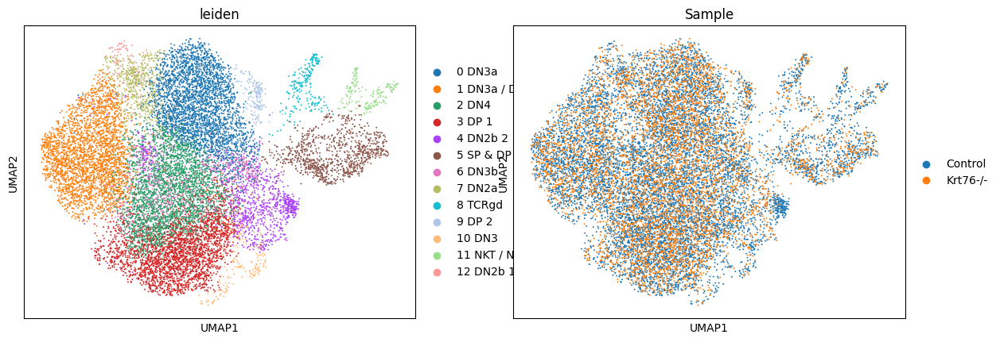

In [5]:
sc.pl.umap(adata_P, color=["leiden", "Sample"])

/Users/uqssoon/anaconda3/envs/Jaz2023_env/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


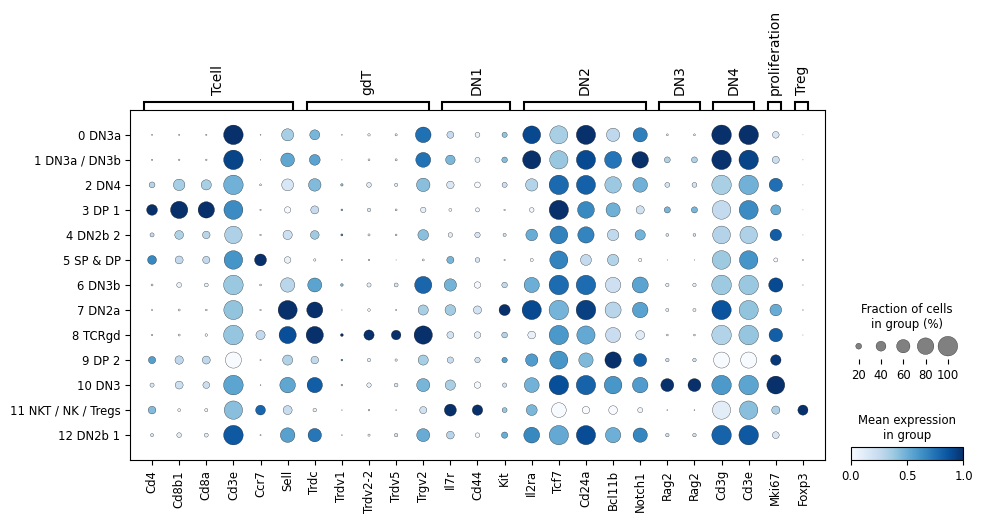

In [6]:
sc.pl.dotplot(
    adata_P,
    {
        "Tcell": [
            "Cd4",
            "Cd8b1",
            "Cd8a",
            "Cd3e",
            "Ccr7",
            "Sell",
        ],
        "gdT": [
            "Trdc",
            "Trdv1",
            "Trdv2-2",
            "Trdv5",
            "Trgv2",
        ],
        "DN1": [
            "Il7r",
            "Cd44",
            "Kit",
        ],
        "DN2": [
            "Il2ra",
            "Tcf7",
            "Cd24a",
            "Bcl11b",
            "Notch1",
        ],
        "DN3": [
            "Rag2",
            "Rag2",
        ],
        "DN4": [
            "Cd3g",
            "Cd3e",
        ],
        "proliferation": [
            "Mki67",
        ],
        "Treg": [
            "Foxp3",
        ],
    },
    groupby="leiden",
    standard_scale="var",
    color_map="Blues",
)

In [7]:
#### If you have done up scanpy's plotting defaults, you can reset it before going forward further.

import matplotlib.pyplot as plt

plt.rcParams.update(plt.rcParamsDefault)
%matplotlib inline

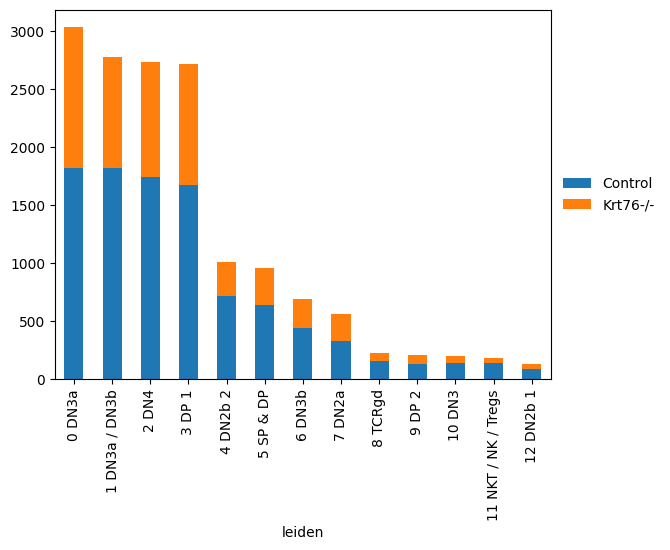

In [8]:
pd.crosstab(
    adata_P.obs["leiden"],
    adata_P.obs["Sample"],
).plot.bar(stacked=True)
plt.legend(bbox_to_anchor=(1, 0.5), loc="center left", frameon=False)

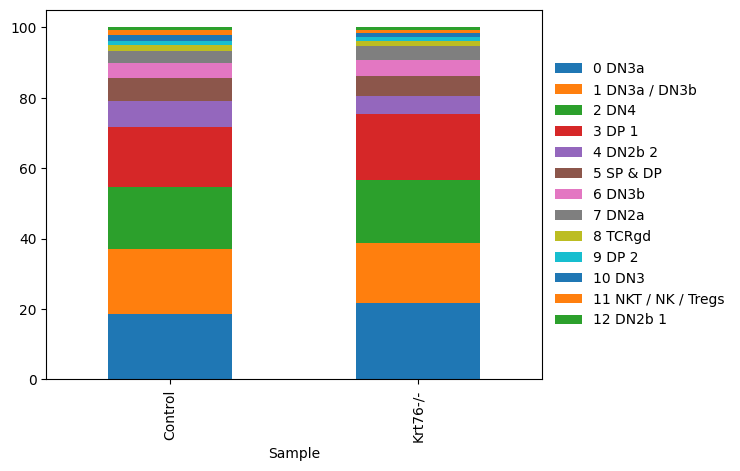

In [9]:
pd.crosstab(adata_P.obs["Sample"], adata_P.obs["leiden"]).apply(lambda r: r/r.sum()*100,axis = 1).plot.bar(stacked=True)
plt.legend(bbox_to_anchor=(1,.5), loc = "center left", frameon=False)

In [10]:
import pandas as pd

pd.crosstab(adata_P.obs["leiden"], adata_P.obs["productive_VDJ"])

productive_VDJ,F,F|F,F|F|F,F|F|F|F,F|F|F|F|F,F|F|F|F|F|F,F|F|F|F|F|F|F,No_contig,None,T,...,T|T|F,T|T|F|F,T|T|F|F|F,T|T|F|F|F|F,T|T|F|F|F|F|F,T|T|F|F|F|F|F|F,T|T|T,T|T|T|F,T|T|T|F|F,T|T|T|F|F|F|F|F
leiden,,,,,,,,,,,,,,,,,,,,,
0 DN3a,4,5,1,0,0,0,0,2408,1,105,...,7,1,4,2,0,0,1,0,0,0
1 DN3a / DN3b,1,4,2,0,0,0,0,2455,1,50,...,4,0,0,0,0,0,0,0,0,0
2 DN4,19,33,22,9,5,0,1,577,11,240,...,31,44,23,22,2,4,0,0,0,1
3 DP 1,33,15,3,2,0,0,0,256,19,586,...,32,26,8,5,1,0,1,2,1,0
4 DN2b 2,17,8,6,7,2,1,0,417,6,172,...,11,8,4,2,2,0,3,1,0,0
5 SP & DP,21,6,2,1,0,0,0,60,28,356,...,13,14,3,0,1,0,0,0,1,0
6 DN3b,8,5,1,2,0,0,0,80,1,73,...,10,7,2,2,0,0,0,0,1,0
7 DN2a,0,0,1,0,0,0,0,505,0,0,...,0,0,1,0,0,0,0,0,0,0
8 TCRgd,0,1,0,1,0,0,0,167,1,8,...,1,2,1,0,0,0,0,0,0,0


/Users/uqssoon/anaconda3/envs/Jaz2023_env/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


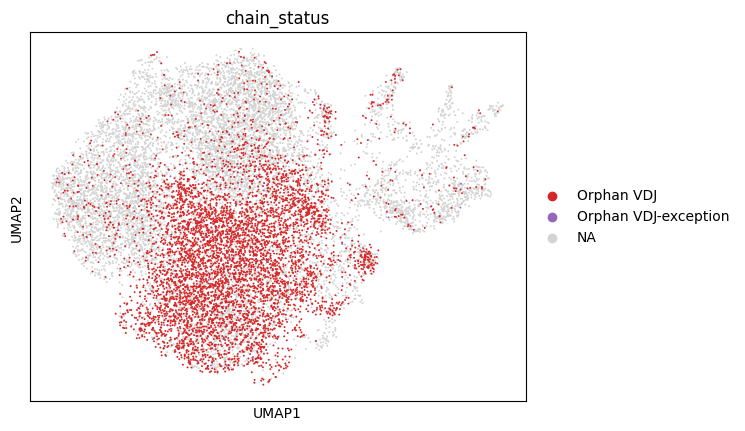

In [12]:
sc.pl.umap(adata_P, color="chain_status", groups=["Orphan VDJ", "Orphan VDJ-exception"])

In [13]:
adata_P.obs["chain_status"].value_counts()

No_contig               7233
Orphan VDJ              5543
Extra pair              1879
Single pair              637
Orphan VJ                 73
Orphan VDJ-exception      30
Extra pair-exception       6
Name: chain_status, dtype: int64

/Users/uqssoon/anaconda3/envs/Jaz2023_env/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


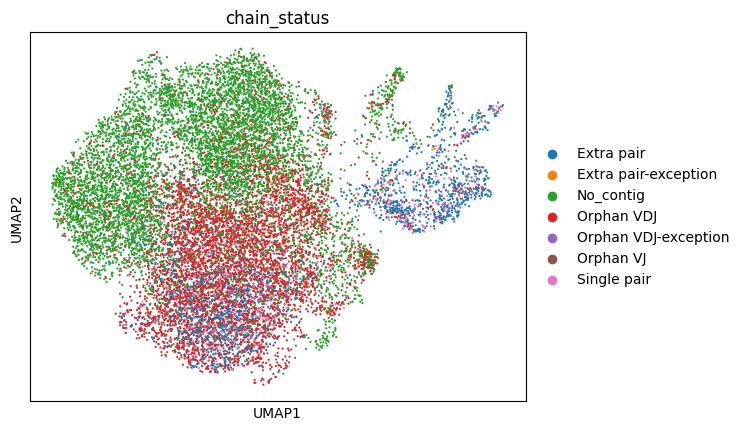

In [14]:
sc.pl.umap(adata_P, color=["chain_status"], size = 10)

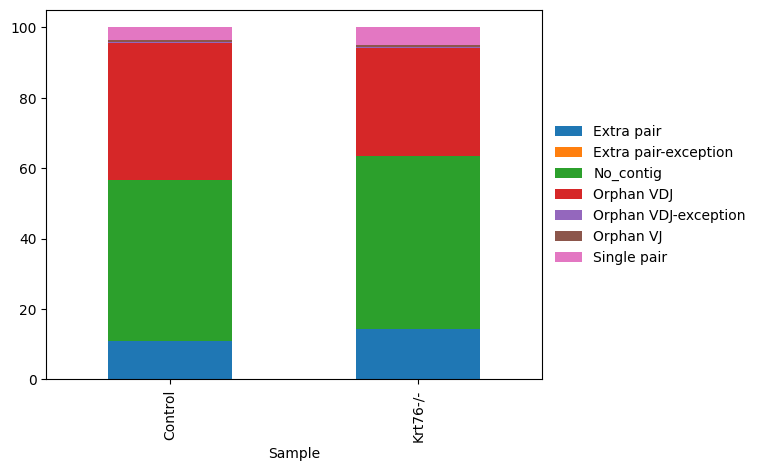

In [15]:
pd.crosstab(
    adata_P.obs["Sample"],
    adata_P.obs["chain_status"],
).apply(
    lambda r: r / r.sum() * 100, axis=1
).plot.bar(stacked=True)
plt.legend(bbox_to_anchor=(1, 0.5), loc="center left", frameon=False)

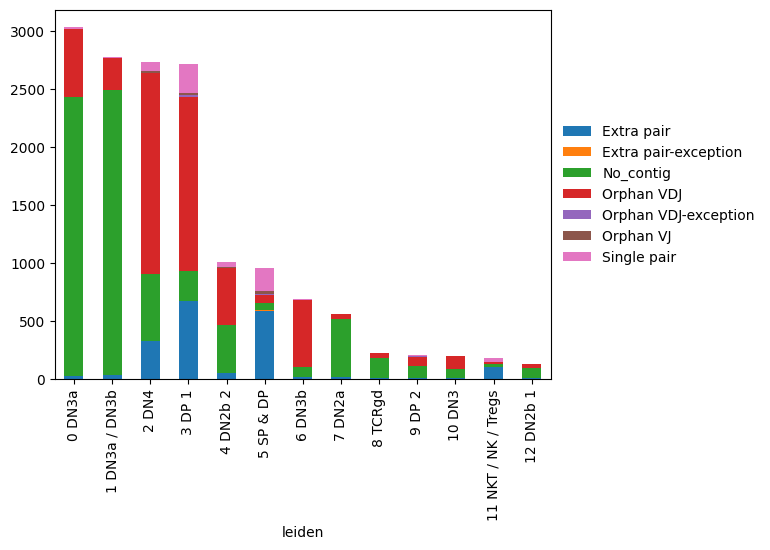

In [16]:
pd.crosstab(
    adata_P.obs["leiden"],
    adata_P.obs["chain_status"],
).plot.bar(stacked=True)
plt.legend(bbox_to_anchor=(1, 0.5), loc="center left", frameon=False)

## V/J gene usage 

### V gene Beta Chain (ALL Samples)

In [16]:
adata_PF = adata_P[adata_P.obs["v_call_abT_VDJ_main"] != "None"]
adata_PF = adata_PF[adata_PF.obs["v_call_abT_VDJ_main"] != "No_contig"]

In [17]:
adata_PF

View of AnnData object with n_obs × n_vars = 7896 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [18]:
adata_PF.obs.groupby(["leiden"]).apply(len)

leiden
0 DN3a                  611
1 DN3a / DN3b           313
2 DN4                  2076
3 DP 1                 2398
4 DN2b 2                558
5 SP & DP               841
6 DN3b                  594
7 DN2a                   52
8 TCRgd                  60
9 DP 2                   94
10 DN3                  120
11 NKT / NK / Tregs     141
12 DN2b 1                38
dtype: int64

In [19]:
pd.crosstab(adata_PF.obs['Sample'], adata_PF.obs['leiden'])

leiden,0 DN3a,1 DN3a / DN3b,2 DN4,3 DP 1,4 DN2b 2,5 SP & DP,6 DN3b,7 DN2a,8 TCRgd,9 DP 2,10 DN3,11 NKT / NK / Tregs,12 DN2b 1
Sample,,,,,,,,,,,,,
Control,401,229,1348,1448,414,558,379,40,43,62,85,106,28
Krt76-/-,210,84,728,950,144,283,215,12,17,32,35,35,10


In [20]:
working_df = pd.DataFrame(adata_PF.obs.groupby("leiden")["v_call_abT_VDJ_main"].value_counts())
working_df

v_call_abT_VDJ_main
leiden    v_call_abT_VDJ_main                     
0 DN3a    TRBV13-2                              52
          TRBV5                                 47
          TRBV13-1                              46
          TRBV15                                45
          TRBV19                                43
...                                            ...
12 DN2b 1 TRBV19                                 0
          TRBV10                                 0
          TRBV21                                 0
          TRBV23                                 0
          TRBV24                                 0

[312 rows x 1 columns]

In [21]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,leiden,v_call_abT_VDJ_main,counts
0,0 DN3a,TRBV13-2,52
1,0 DN3a,TRBV5,47
2,0 DN3a,TRBV13-1,46
3,0 DN3a,TRBV15,45
4,0 DN3a,TRBV19,43
...,...,...,...
307,12 DN2b 1,TRBV19,0
308,12 DN2b 1,TRBV10,0
309,12 DN2b 1,TRBV21,0
310,12 DN2b 1,TRBV23,0


In [22]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.leiden.unique():
    tmp = working_df[working_df["leiden"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'0 DN3a': 611,
 '1 DN3a / DN3b': 313,
 '2 DN4': 2076,
 '3 DP 1': 2398,
 '4 DN2b 2': 558,
 '5 SP & DP': 841,
 '6 DN3b': 594,
 '7 DN2a': 52,
 '8 TCRgd': 60,
 '9 DP 2': 94,
 '10 DN3': 120,
 '11 NKT / NK / Tregs': 141,
 '12 DN2b 1': 38}

In [23]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["leiden"]]
    except:
        pass

In [24]:
working_df

,leiden,v_call_abT_VDJ_main,counts,proportion
0,0 DN3a,TRBV13-2,52,0.085106
1,0 DN3a,TRBV5,47,0.076923
2,0 DN3a,TRBV13-1,46,0.075286
3,0 DN3a,TRBV15,45,0.073650
4,0 DN3a,TRBV19,43,0.070376
...,...,...,...,...
307,12 DN2b 1,TRBV19,0,0.000000
308,12 DN2b 1,TRBV10,0,0.000000
309,12 DN2b 1,TRBV21,0,0.000000
310,12 DN2b 1,TRBV23,0,0.000000


In [25]:
## Reordering
working_df["leiden"] = working_df[
    "leiden"
].cat.reorder_categories(
    [
        "7 DN2a",
        "12 DN2b 1",
        "4 DN2b 2",
        "10 DN3",
        "0 DN3a",
        "1 DN3a / DN3b",
        "6 DN3b",
        "2 DN4",
        "3 DP 1",
        "9 DP 2",
        "5 SP & DP",
        "8 TCRgd",
        "11 NKT / NK / Tregs",
    ]
)

In [26]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [27]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

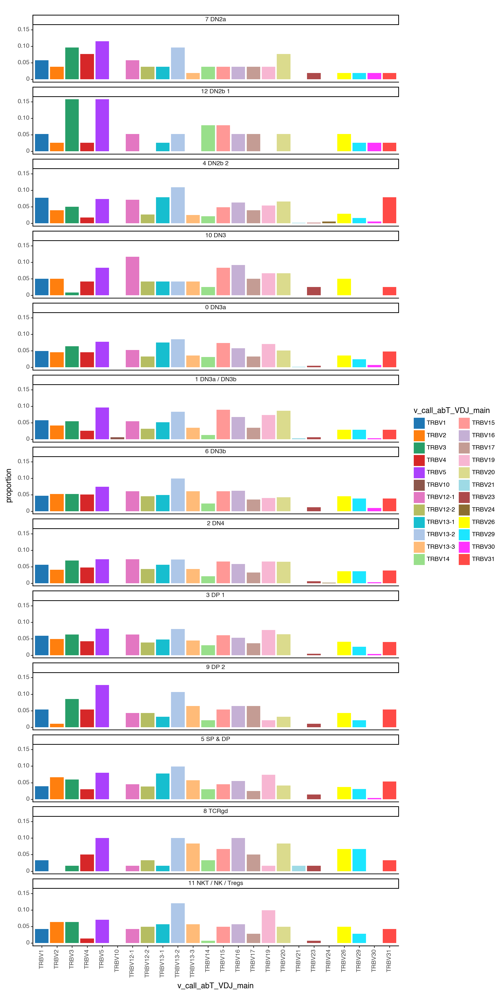

<Figure Size: (1000 x 2000)>

In [28]:
options.figure_size = (10, 20)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VDJ_main", y="proportion", fill="v_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~leiden", ncol=1)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### J gene Beta Chain (ALL SAMPLES)

In [29]:
adata_PF = adata_P[adata_P.obs["j_call_abT_VDJ_main"] != "None"]
adata_PF = adata_PF[adata_PF.obs["j_call_abT_VDJ_main"] != "No_contig"]

In [30]:
adata_PF

View of AnnData object with n_obs × n_vars = 8094 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [31]:
working_df = pd.DataFrame(adata_PF.obs.groupby("leiden")["j_call_abT_VDJ_main"].value_counts())
working_df

j_call_abT_VDJ_main
leiden    j_call_abT_VDJ_main                         
0 DN3a    TRBJ2-7                                   90
          TRBJ2-5                                   86
          TRBJ2-4                                   80
          TRBJ1-1                                   65
          TRBJ2-1                                   60
...                                                ...
12 DN2b 1 TRBJ1-5,TRBJ2-2                            0
          TRBJ1-6,TRBJ2-2,TRBJ2-7                    0
          TRBJ2-3,TRBJ2-4                            0
          TRBJ2-5,TRBJ2-4                            0
          TRBJ2-6                                    0

[221 rows x 1 columns]

In [32]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,leiden,j_call_abT_VDJ_main,counts
0,0 DN3a,TRBJ2-7,90
1,0 DN3a,TRBJ2-5,86
2,0 DN3a,TRBJ2-4,80
3,0 DN3a,TRBJ1-1,65
4,0 DN3a,TRBJ2-1,60
...,...,...,...
216,12 DN2b 1,"TRBJ1-5,TRBJ2-2",0
217,12 DN2b 1,"TRBJ1-6,TRBJ2-2,TRBJ2-7",0
218,12 DN2b 1,"TRBJ2-3,TRBJ2-4",0
219,12 DN2b 1,"TRBJ2-5,TRBJ2-4",0


In [33]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.leiden.unique():
    tmp = working_df[working_df["leiden"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'0 DN3a': 621,
 '1 DN3a / DN3b': 320,
 '2 DN4': 2139,
 '3 DP 1': 2440,
 '4 DN2b 2': 584,
 '5 SP & DP': 865,
 '6 DN3b': 608,
 '7 DN2a': 53,
 '8 TCRgd': 62,
 '9 DP 2': 96,
 '10 DN3': 121,
 '11 NKT / NK / Tregs': 147,
 '12 DN2b 1': 38}

In [34]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["leiden"]]
    except:
        pass

In [35]:
working_df

,leiden,j_call_abT_VDJ_main,counts,proportion
0,0 DN3a,TRBJ2-7,90,0.144928
1,0 DN3a,TRBJ2-5,86,0.138486
2,0 DN3a,TRBJ2-4,80,0.128824
3,0 DN3a,TRBJ1-1,65,0.104670
4,0 DN3a,TRBJ2-1,60,0.096618
...,...,...,...,...
216,12 DN2b 1,"TRBJ1-5,TRBJ2-2",0,0.000000
217,12 DN2b 1,"TRBJ1-6,TRBJ2-2,TRBJ2-7",0,0.000000
218,12 DN2b 1,"TRBJ2-3,TRBJ2-4",0,0.000000
219,12 DN2b 1,"TRBJ2-5,TRBJ2-4",0,0.000000


In [36]:
## Reordering
working_df["leiden"] = working_df[
    "leiden"
].cat.reorder_categories(
    [
        "7 DN2a",
        "12 DN2b 1",
        "4 DN2b 2",
        "10 DN3",
        "0 DN3a",
        "1 DN3a / DN3b",
        "6 DN3b",
        "2 DN4",
        "3 DP 1",
        "9 DP 2",
        "5 SP & DP",
        "8 TCRgd",
        "11 NKT / NK / Tregs",
    ]
)

In [37]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [38]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

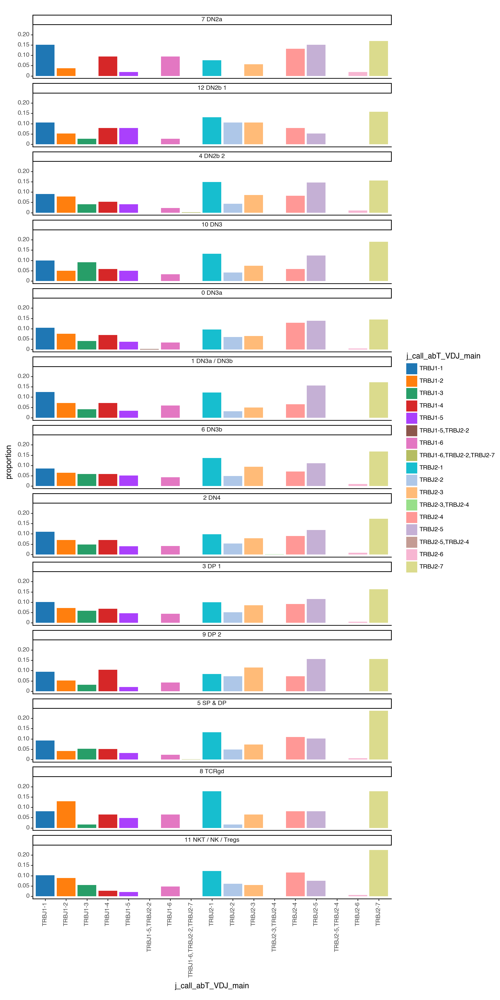

<Figure Size: (1000 x 2000)>

In [39]:
options.figure_size = (10, 20)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VDJ_main", y="proportion", fill="j_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~leiden", ncol=1)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### V gene Alpha Chain (ALL SAMPLES)

In [115]:
adata_PF = adata_P[adata_P.obs["v_call_abT_VJ_main"] != "None"]
adata_PF = adata_PF[adata_PF.obs["v_call_abT_VJ_main"] != "No_contig"]

In [116]:
adata_PF

View of AnnData object with n_obs × n_vars = 2530 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [117]:
working_df = pd.DataFrame(adata_PF.obs.groupby("leiden")["v_call_abT_VJ_main"].value_counts())
working_df

v_call_abT_VJ_main
leiden    v_call_abT_VJ_main                     
0 DN3a    TRAV13-1                              3
          TRAV10N                               2
          TRAV13-2                              2
          TRAV4D-3,TRAV4-3                      2
          TRAV6D-7,TRAV6N-7                     2
...                                           ...
12 DN2b 1 TRAV13-4/DV7                          1
          TRAV14-2                              1
          TRAV16,TRAV16D/DV11                   1
          TRAV4-4/DV10                          1
          TRAV9N-4                              1

[521 rows x 1 columns]

In [118]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,leiden,v_call_abT_VJ_main,counts
0,0 DN3a,TRAV13-1,3
1,0 DN3a,TRAV10N,2
2,0 DN3a,TRAV13-2,2
3,0 DN3a,"TRAV4D-3,TRAV4-3",2
4,0 DN3a,"TRAV6D-7,TRAV6N-7",2
...,...,...,...
516,12 DN2b 1,TRAV13-4/DV7,1
517,12 DN2b 1,TRAV14-2,1
518,12 DN2b 1,"TRAV16,TRAV16D/DV11",1
519,12 DN2b 1,TRAV4-4/DV10,1


In [119]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.leiden.unique():
    tmp = working_df[working_df["leiden"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'0 DN3a': 35,
 '1 DN3a / DN3b': 43,
 '2 DN4': 393,
 '3 DP 1': 923,
 '4 DN2b 2': 95,
 '5 SP & DP': 812,
 '6 DN3b': 27,
 '7 DN2a': 17,
 '8 TCRgd': 13,
 '9 DP 2': 17,
 '10 DN3': 8,
 '11 NKT / NK / Tregs': 139,
 '12 DN2b 1': 8}

In [120]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["leiden"]]
    except:
        pass

In [121]:
working_df

,leiden,v_call_abT_VJ_main,counts,proportion
0,0 DN3a,TRAV13-1,3,0.085714
1,0 DN3a,TRAV10N,2,0.057143
2,0 DN3a,TRAV13-2,2,0.057143
3,0 DN3a,"TRAV4D-3,TRAV4-3",2,0.057143
4,0 DN3a,"TRAV6D-7,TRAV6N-7",2,0.057143
...,...,...,...,...
516,12 DN2b 1,TRAV13-4/DV7,1,0.125000
517,12 DN2b 1,TRAV14-2,1,0.125000
518,12 DN2b 1,"TRAV16,TRAV16D/DV11",1,0.125000
519,12 DN2b 1,TRAV4-4/DV10,1,0.125000


In [122]:
## Reordering
working_df["leiden"] = working_df[
    "leiden"
].cat.reorder_categories(
    [
        "7 DN2a",
        "12 DN2b 1",
        "4 DN2b 2",
        "10 DN3",
        "0 DN3a",
        "1 DN3a / DN3b",
        "6 DN3b",
        "2 DN4",
        "3 DP 1",
        "9 DP 2",
        "5 SP & DP",
        "8 TCRgd",
        "11 NKT / NK / Tregs",
    ]
)

In [123]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [124]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

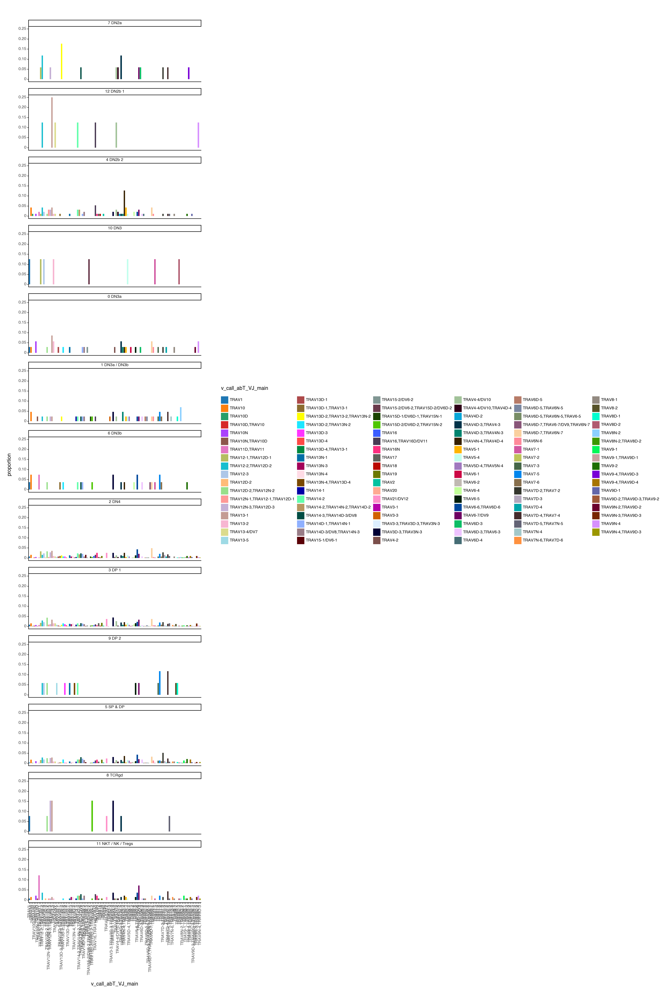

<Figure Size: (2000 x 3000)>

In [125]:
options.figure_size = (20, 30)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VJ_main", y="proportion", fill="v_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~leiden", ncol=1)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### J gene Alpha Chain (ALL samples)

In [126]:
adata_PF = adata_P[adata_P.obs["j_call_abT_VJ_main"] != "None"]
adata_PF = adata_PF[adata_PF.obs["j_call_abT_VJ_main"] != "No_contig"]

In [127]:
adata_PF

View of AnnData object with n_obs × n_vars = 2595 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [128]:
working_df = pd.DataFrame(adata_PF.obs.groupby("leiden")["j_call_abT_VJ_main"].value_counts())
working_df

j_call_abT_VJ_main
leiden    j_call_abT_VJ_main                    
0 DN3a    TRAJ12                               3
          TRAJ13                               3
          TRAJ15                               3
          TRAJ40                               3
          TRAJ17                               2
...                                          ...
12 DN2b 1 TRAJ42                               2
          TRAJ22                               1
          TRAJ40                               1
          TRAJ45                               1
          TRAJ6                                1

[335 rows x 1 columns]

In [129]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,leiden,j_call_abT_VJ_main,counts
0,0 DN3a,TRAJ12,3
1,0 DN3a,TRAJ13,3
2,0 DN3a,TRAJ15,3
3,0 DN3a,TRAJ40,3
4,0 DN3a,TRAJ17,2
...,...,...,...
330,12 DN2b 1,TRAJ42,2
331,12 DN2b 1,TRAJ22,1
332,12 DN2b 1,TRAJ40,1
333,12 DN2b 1,TRAJ45,1


In [130]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.leiden.unique():
    tmp = working_df[working_df["leiden"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'0 DN3a': 36,
 '1 DN3a / DN3b': 44,
 '2 DN4': 418,
 '3 DP 1': 944,
 '4 DN2b 2': 103,
 '5 SP & DP': 816,
 '6 DN3b': 28,
 '7 DN2a': 17,
 '8 TCRgd': 14,
 '9 DP 2': 17,
 '10 DN3': 11,
 '11 NKT / NK / Tregs': 139,
 '12 DN2b 1': 8}

In [131]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["leiden"]]
    except:
        pass

In [132]:
working_df

,leiden,j_call_abT_VJ_main,counts,proportion
0,0 DN3a,TRAJ12,3,0.083333
1,0 DN3a,TRAJ13,3,0.083333
2,0 DN3a,TRAJ15,3,0.083333
3,0 DN3a,TRAJ40,3,0.083333
4,0 DN3a,TRAJ17,2,0.055556
...,...,...,...,...
330,12 DN2b 1,TRAJ42,2,0.250000
331,12 DN2b 1,TRAJ22,1,0.125000
332,12 DN2b 1,TRAJ40,1,0.125000
333,12 DN2b 1,TRAJ45,1,0.125000


In [133]:
## Reordering
working_df["leiden"] = working_df[
    "leiden"
].cat.reorder_categories(
    [
        "7 DN2a",
        "12 DN2b 1",
        "4 DN2b 2",
        "10 DN3",
        "0 DN3a",
        "1 DN3a / DN3b",
        "6 DN3b",
        "2 DN4",
        "3 DP 1",
        "9 DP 2",
        "5 SP & DP",
        "8 TCRgd",
        "11 NKT / NK / Tregs",
    ]
)

In [134]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [135]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

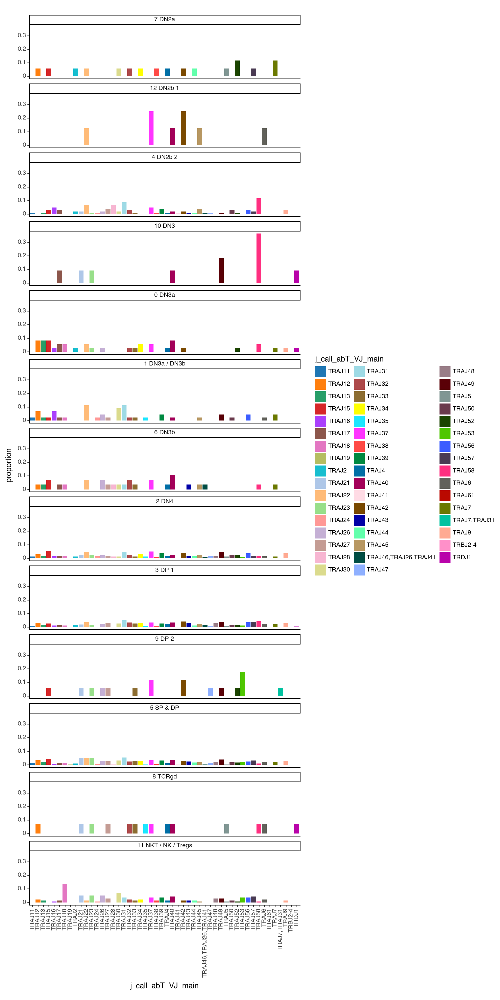

<Figure Size: (1000 x 2000)>

In [136]:
options.figure_size = (10, 20)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VJ_main", y="proportion", fill="j_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~leiden", ncol=1)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

## PRODUCTIVE  -  Split between control vs KO?? V GENE BETA CHAIN

In [137]:
adata_PF = adata_P[adata_P.obs["v_call_abT_VDJ_main"] != "None"]
adata_PF = adata_PF[adata_PF.obs["v_call_abT_VDJ_main"] != "No_contig"]

### DN2a - V gene beta chain

In [138]:
adata_PF_DN2a = adata_PF[adata_PF.obs["leiden"] == "7 DN2a"]

In [139]:
adata_PF_DN2a

View of AnnData object with n_obs × n_vars = 52 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [140]:
working_df = pd.DataFrame(adata_PF_DN2a.obs.groupby("Sample")["v_call_abT_VDJ_main"].value_counts())
working_df

v_call_abT_VDJ_main
Sample   v_call_abT_VDJ_main                     
Control  TRBV5                                  5
         TRBV13-2                               4
         TRBV4                                  4
         TRBV12-1                               3
         TRBV20                                 3
         TRBV3                                  3
         TRBV1                                  2
         TRBV12-2                               2
         TRBV16                                 2
         TRBV19                                 2
         TRBV2                                  2
         TRBV13-1                               1
         TRBV14                                 1
         TRBV15                                 1
         TRBV17                                 1
         TRBV23                                 1
         TRBV26                                 1
         TRBV29                                 1
         TRBV31                                 1
Krt76-/- TRBV3                                  2
         TRBV1                                  1
         TRBV13-1                               1
         TRBV13-2                               1
         TRBV13-3                               1
         TRBV14                                 1
         TRBV15                                 1
         TRBV17                                 1
         TRBV20                                 1
         TRBV30                                 1
         TRBV5                                  1

In [141]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VDJ_main,counts
0,Control,TRBV5,5
1,Control,TRBV13-2,4
2,Control,TRBV4,4
3,Control,TRBV12-1,3
4,Control,TRBV20,3
5,Control,TRBV3,3
6,Control,TRBV1,2
7,Control,TRBV12-2,2
8,Control,TRBV16,2
9,Control,TRBV19,2


In [142]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 40, 'Krt76-/-': 12}

In [143]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [144]:
working_df

,Sample,v_call_abT_VDJ_main,counts,proportion
0,Control,TRBV5,5,0.125000
1,Control,TRBV13-2,4,0.100000
2,Control,TRBV4,4,0.100000
3,Control,TRBV12-1,3,0.075000
4,Control,TRBV20,3,0.075000
5,Control,TRBV3,3,0.075000
6,Control,TRBV1,2,0.050000
7,Control,TRBV12-2,2,0.050000
8,Control,TRBV16,2,0.050000
9,Control,TRBV19,2,0.050000


In [145]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [146]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

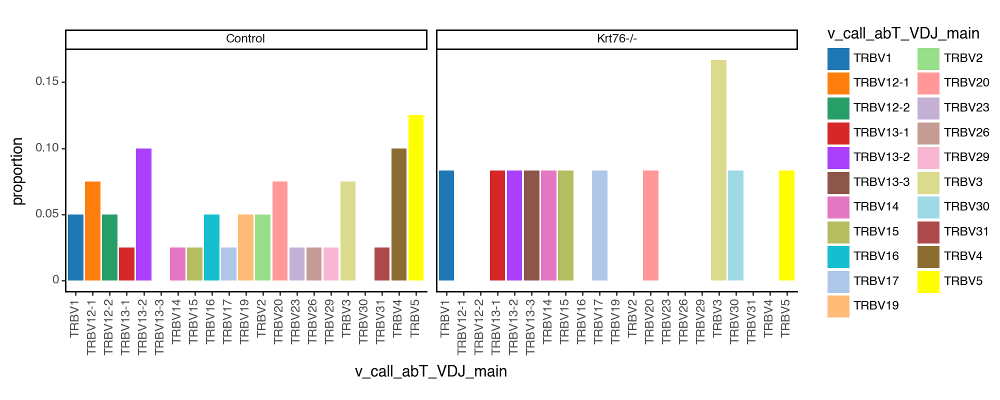

<Figure Size: (1000 x 400)>

In [147]:
options.figure_size = (10, 4)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VDJ_main", y="proportion", fill="v_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

In [727]:
###

### DN2b 1 - V gene Beta Chain

In [728]:
adata_PF_DN2b1 = adata_PF[adata_PF.obs["leiden"] == "12 DN2b 1"]

In [729]:
adata_PF_DN2b1

View of AnnData object with n_obs × n_vars = 38 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [730]:
working_df = pd.DataFrame(adata_PF_DN2b1.obs.groupby("Sample")["v_call_abT_VDJ_main"].value_counts())
working_df

v_call_abT_VDJ_main
Sample   v_call_abT_VDJ_main                     
Control  TRBV5                                  5
         TRBV3                                  3
         TRBV15                                 3
         TRBV1                                  2
         TRBV12-1                               2
         TRBV26                                 2
         TRBV17                                 2
         TRBV16                                 1
         TRBV29                                 1
         TRBV20                                 1
         TRBV14                                 1
         TRBV2                                  1
         TRBV13-2                               1
         TRBV13-1                               1
         TRBV4                                  1
         TRBV31                                 1
         TRBV30                                 0
Krt76-/- TRBV3                                  3
         TRBV14                                 2
         TRBV16                                 1
         TRBV30                                 1
         TRBV5                                  1
         TRBV13-2                               1
         TRBV20                                 1
         TRBV29                                 0
         TRBV26                                 0
         TRBV17                                 0
         TRBV1                                  0
         TRBV15                                 0
         TRBV2                                  0
         TRBV13-1                               0
         TRBV12-1                               0
         TRBV4                                  0
         TRBV31                                 0

In [731]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VDJ_main,counts
0,Control,TRBV5,5
1,Control,TRBV3,3
2,Control,TRBV15,3
3,Control,TRBV1,2
4,Control,TRBV12-1,2
5,Control,TRBV26,2
6,Control,TRBV17,2
7,Control,TRBV16,1
8,Control,TRBV29,1
9,Control,TRBV20,1


In [732]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 28, 'Krt76-/-': 10}

In [733]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [734]:
working_df

,Sample,v_call_abT_VDJ_main,counts,proportion
0,Control,TRBV5,5,0.178571
1,Control,TRBV3,3,0.107143
2,Control,TRBV15,3,0.107143
3,Control,TRBV1,2,0.071429
4,Control,TRBV12-1,2,0.071429
5,Control,TRBV26,2,0.071429
6,Control,TRBV17,2,0.071429
7,Control,TRBV16,1,0.035714
8,Control,TRBV29,1,0.035714
9,Control,TRBV20,1,0.035714


In [735]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [736]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

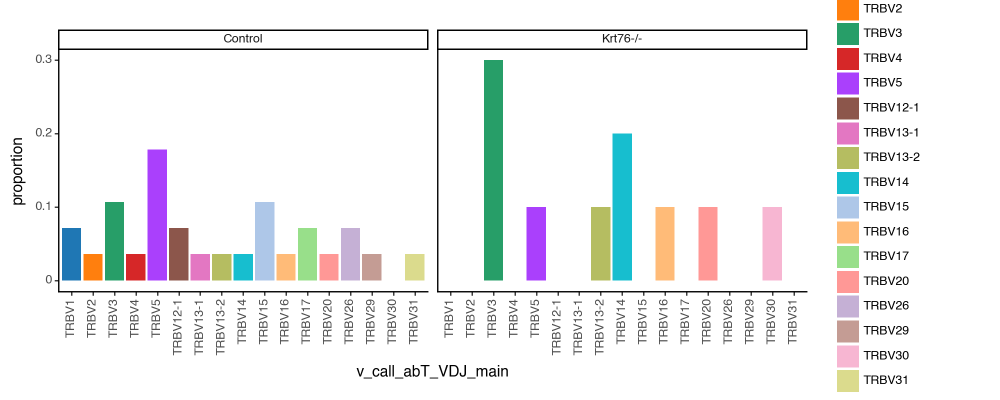

<Figure Size: (1000 x 400)>

In [737]:
options.figure_size = (10, 4)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VDJ_main", y="proportion", fill="v_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN2b2 - V gene Beta Chain

In [738]:
adata_PF_DN2b2 = adata_PF[adata_PF.obs["leiden"] == "4 DN2b 2"]

In [739]:
adata_PF_DN2b2

View of AnnData object with n_obs × n_vars = 558 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [740]:
working_df = pd.DataFrame(adata_PF_DN2b2.obs.groupby("Sample")["v_call_abT_VDJ_main"].value_counts())
working_df

v_call_abT_VDJ_main
Sample   v_call_abT_VDJ_main                     
Control  TRBV13-2                              44
         TRBV31                                36
         TRBV13-1                              34
         TRBV5                                 32
         TRBV20                                31
         TRBV12-1                              30
         TRBV1                                 27
         TRBV19                                25
         TRBV15                                24
         TRBV16                                22
         TRBV3                                 19
         TRBV2                                 17
         TRBV17                                15
         TRBV12-2                              11
         TRBV26                                10
         TRBV4                                  9
         TRBV13-3                               9
         TRBV14                                 8
         TRBV29                                 6
         TRBV24                                 3
         TRBV21                                 1
         TRBV23                                 1
         TRBV30                                 0
Krt76-/- TRBV13-2                              17
         TRBV1                                 16
         TRBV16                                13
         TRBV13-1                              10
         TRBV12-1                              10
         TRBV3                                  9
         TRBV5                                  9
         TRBV31                                 8
         TRBV17                                 7
         TRBV20                                 6
         TRBV26                                 6
         TRBV13-3                               5
         TRBV2                                  5
         TRBV19                                 5
         TRBV12-2                               4
         TRBV14                                 4
         TRBV29                                 3
         TRBV30                                 3
         TRBV15                                 3
         TRBV4                                  1
         TRBV21                                 0
         TRBV23                                 0
         TRBV24                                 0

In [741]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VDJ_main,counts
0,Control,TRBV13-2,44
1,Control,TRBV31,36
2,Control,TRBV13-1,34
3,Control,TRBV5,32
4,Control,TRBV20,31
5,Control,TRBV12-1,30
6,Control,TRBV1,27
7,Control,TRBV19,25
8,Control,TRBV15,24
9,Control,TRBV16,22


In [742]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 414, 'Krt76-/-': 144}

In [743]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [744]:
working_df

,Sample,v_call_abT_VDJ_main,counts,proportion
0,Control,TRBV13-2,44,0.106280
1,Control,TRBV31,36,0.086957
2,Control,TRBV13-1,34,0.082126
3,Control,TRBV5,32,0.077295
4,Control,TRBV20,31,0.074879
5,Control,TRBV12-1,30,0.072464
6,Control,TRBV1,27,0.065217
7,Control,TRBV19,25,0.060386
8,Control,TRBV15,24,0.057971
9,Control,TRBV16,22,0.053140


In [745]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [746]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

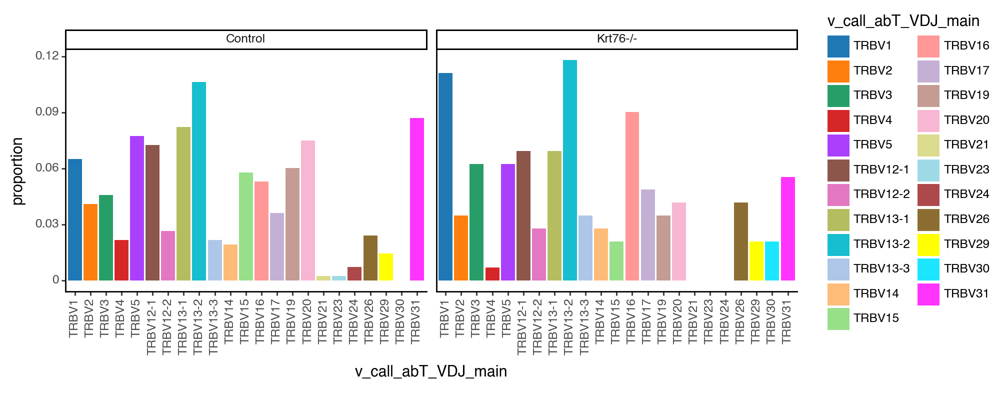

<Figure Size: (1000 x 400)>

In [747]:
options.figure_size = (10, 4)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VDJ_main", y="proportion", fill="v_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN3 - V gene Beta Chain

In [748]:
adata_PF_DN3 = adata_PF[adata_PF.obs["leiden"] == "10 DN3"]

In [749]:
adata_PF_DN3

View of AnnData object with n_obs × n_vars = 120 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [750]:
working_df = pd.DataFrame(adata_PF_DN3.obs.groupby("Sample")["v_call_abT_VDJ_main"].value_counts())
working_df

v_call_abT_VDJ_main
Sample   v_call_abT_VDJ_main                     
Control  TRBV12-1                              10
         TRBV16                                10
         TRBV5                                  7
         TRBV2                                  6
         TRBV1                                  5
         TRBV26                                 5
         TRBV19                                 5
         TRBV15                                 5
         TRBV17                                 4
         TRBV4                                  4
         TRBV12-2                               4
         TRBV20                                 4
         TRBV13-2                               4
         TRBV13-3                               3
         TRBV14                                 3
         TRBV13-1                               3
         TRBV23                                 2
         TRBV3                                  1
         TRBV31                                 0
Krt76-/- TRBV15                                 5
         TRBV20                                 4
         TRBV12-1                               4
         TRBV31                                 3
         TRBV19                                 3
         TRBV5                                  3
         TRBV17                                 2
         TRBV13-3                               2
         TRBV13-1                               2
         TRBV13-2                               1
         TRBV16                                 1
         TRBV12-2                               1
         TRBV4                                  1
         TRBV23                                 1
         TRBV26                                 1
         TRBV1                                  1
         TRBV2                                  0
         TRBV14                                 0
         TRBV3                                  0

In [751]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VDJ_main,counts
0,Control,TRBV12-1,10
1,Control,TRBV16,10
2,Control,TRBV5,7
3,Control,TRBV2,6
4,Control,TRBV1,5
5,Control,TRBV26,5
6,Control,TRBV19,5
7,Control,TRBV15,5
8,Control,TRBV17,4
9,Control,TRBV4,4


In [752]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 85, 'Krt76-/-': 35}

In [753]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [754]:
working_df

,Sample,v_call_abT_VDJ_main,counts,proportion
0,Control,TRBV12-1,10,0.117647
1,Control,TRBV16,10,0.117647
2,Control,TRBV5,7,0.082353
3,Control,TRBV2,6,0.070588
4,Control,TRBV1,5,0.058824
5,Control,TRBV26,5,0.058824
6,Control,TRBV19,5,0.058824
7,Control,TRBV15,5,0.058824
8,Control,TRBV17,4,0.047059
9,Control,TRBV4,4,0.047059


In [755]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [756]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

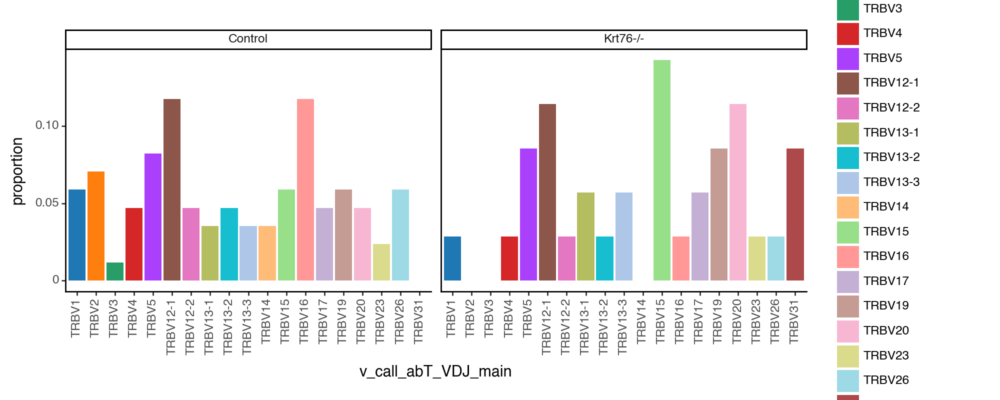

<Figure Size: (1000 x 400)>

In [757]:
options.figure_size = (10, 4)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VDJ_main", y="proportion", fill="v_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN3a - V gene Beta chain

In [758]:
adata_PF_DN3a = adata_PF[adata_PF.obs["leiden"] == "0 DN3a"]

In [759]:
adata_PF_DN3a

View of AnnData object with n_obs × n_vars = 611 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [760]:
working_df = pd.DataFrame(adata_PF_DN3a.obs.groupby("Sample")["v_call_abT_VDJ_main"].value_counts())
working_df

v_call_abT_VDJ_main
Sample   v_call_abT_VDJ_main                     
Control  TRBV13-2                              33
         TRBV15                                30
         TRBV13-1                              30
         TRBV5                                 27
         TRBV3                                 24
         TRBV12-1                              24
         TRBV19                                24
         TRBV16                                23
         TRBV4                                 23
         TRBV20                                20
         TRBV1                                 19
         TRBV31                                19
         TRBV2                                 18
         TRBV14                                16
         TRBV13-3                              15
         TRBV26                                14
         TRBV12-2                              13
         TRBV29                                12
         TRBV17                                11
         TRBV30                                 3
         TRBV23                                 2
         TRBV21                                 1
Krt76-/- TRBV5                                 20
         TRBV13-2                              19
         TRBV19                                19
         TRBV13-1                              16
         TRBV15                                15
         TRBV3                                 15
         TRBV16                                12
         TRBV20                                11
         TRBV1                                 11
         TRBV2                                 10
         TRBV31                                10
         TRBV17                                 9
         TRBV12-1                               8
         TRBV26                                 8
         TRBV13-3                               7
         TRBV12-2                               7
         TRBV4                                  5
         TRBV14                                 3
         TRBV29                                 3
         TRBV23                                 1
         TRBV30                                 1
         TRBV21                                 0

In [761]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VDJ_main,counts
0,Control,TRBV13-2,33
1,Control,TRBV15,30
2,Control,TRBV13-1,30
3,Control,TRBV5,27
4,Control,TRBV3,24
5,Control,TRBV12-1,24
6,Control,TRBV19,24
7,Control,TRBV16,23
8,Control,TRBV4,23
9,Control,TRBV20,20


In [762]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 401, 'Krt76-/-': 210}

In [763]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [764]:
working_df

,Sample,v_call_abT_VDJ_main,counts,proportion
0,Control,TRBV13-2,33,0.082294
1,Control,TRBV15,30,0.074813
2,Control,TRBV13-1,30,0.074813
3,Control,TRBV5,27,0.067332
4,Control,TRBV3,24,0.059850
5,Control,TRBV12-1,24,0.059850
6,Control,TRBV19,24,0.059850
7,Control,TRBV16,23,0.057357
8,Control,TRBV4,23,0.057357
9,Control,TRBV20,20,0.049875


In [765]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [766]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

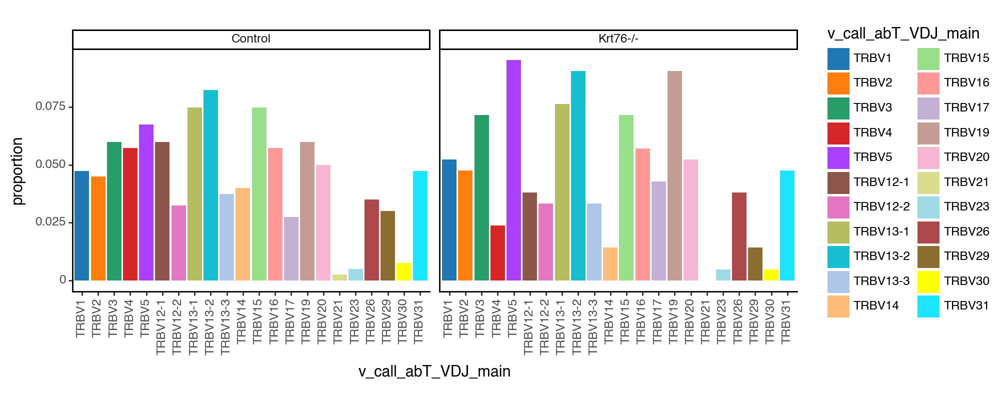

<Figure Size: (1000 x 400)>

In [767]:
options.figure_size = (10, 4)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VDJ_main", y="proportion", fill="v_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN3a/DN3b - V gene Beta Chain

In [768]:
adata_PF_DN3ab = adata_PF[adata_PF.obs["leiden"] == "1 DN3a / DN3b"]

In [769]:
adata_PF_DN3ab

View of AnnData object with n_obs × n_vars = 313 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [770]:
working_df = pd.DataFrame(adata_PF_DN3ab.obs.groupby("Sample")["v_call_abT_VDJ_main"].value_counts())
working_df

v_call_abT_VDJ_main
Sample   v_call_abT_VDJ_main                     
Control  TRBV5                                 22
         TRBV15                                22
         TRBV20                                19
         TRBV19                                19
         TRBV13-2                              19
         TRBV16                                16
         TRBV12-1                              13
         TRBV1                                 11
         TRBV2                                 11
         TRBV13-1                              10
         TRBV13-3                              10
         TRBV31                                 9
         TRBV3                                  9
         TRBV12-2                               7
         TRBV29                                 7
         TRBV17                                 6
         TRBV26                                 6
         TRBV4                                  5
         TRBV14                                 3
         TRBV10                                 2
         TRBV23                                 2
         TRBV21                                 1
         TRBV30                                 0
Krt76-/- TRBV20                                 8
         TRBV5                                  8
         TRBV3                                  8
         TRBV13-2                               7
         TRBV1                                  7
         TRBV15                                 6
         TRBV13-1                               6
         TRBV16                                 5
         TRBV17                                 5
         TRBV12-1                               4
         TRBV19                                 4
         TRBV12-2                               3
         TRBV26                                 3
         TRBV4                                  3
         TRBV29                                 2
         TRBV2                                  2
         TRBV30                                 1
         TRBV14                                 1
         TRBV13-3                               1
         TRBV23                                 0
         TRBV21                                 0
         TRBV10                                 0
         TRBV31                                 0

In [771]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VDJ_main,counts
0,Control,TRBV5,22
1,Control,TRBV15,22
2,Control,TRBV20,19
3,Control,TRBV19,19
4,Control,TRBV13-2,19
5,Control,TRBV16,16
6,Control,TRBV12-1,13
7,Control,TRBV1,11
8,Control,TRBV2,11
9,Control,TRBV13-1,10


In [772]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 229, 'Krt76-/-': 84}

In [773]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [774]:
working_df

,Sample,v_call_abT_VDJ_main,counts,proportion
0,Control,TRBV5,22,0.096070
1,Control,TRBV15,22,0.096070
2,Control,TRBV20,19,0.082969
3,Control,TRBV19,19,0.082969
4,Control,TRBV13-2,19,0.082969
5,Control,TRBV16,16,0.069869
6,Control,TRBV12-1,13,0.056769
7,Control,TRBV1,11,0.048035
8,Control,TRBV2,11,0.048035
9,Control,TRBV13-1,10,0.043668


In [775]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [776]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

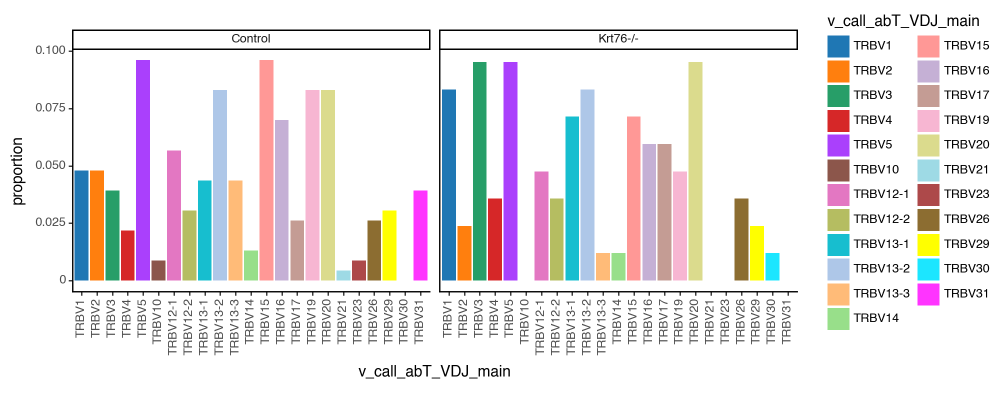

<Figure Size: (1000 x 400)>

In [777]:
options.figure_size = (10, 4)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VDJ_main", y="proportion", fill="v_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN3b - V gene Beta Chain

In [778]:
adata_PF_DN3b = adata_PF[adata_PF.obs["leiden"] == "6 DN3b"]

In [779]:
adata_PF_DN3b

View of AnnData object with n_obs × n_vars = 594 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [780]:
working_df = pd.DataFrame(adata_PF_DN3b.obs.groupby("Sample")["v_call_abT_VDJ_main"].value_counts())
working_df

v_call_abT_VDJ_main
Sample   v_call_abT_VDJ_main                     
Control  TRBV13-2                              35
         TRBV5                                 29
         TRBV16                                29
         TRBV15                                25
         TRBV12-1                              25
         TRBV4                                 20
         TRBV13-1                              20
         TRBV13-3                              20
         TRBV1                                 19
         TRBV26                                19
         TRBV19                                17
         TRBV31                                17
         TRBV2                                 17
         TRBV3                                 17
         TRBV12-2                              16
         TRBV17                                13
         TRBV20                                13
         TRBV29                                13
         TRBV14                                 6
         TRBV23                                 5
         TRBV30                                 4
Krt76-/- TRBV13-2                              24
         TRBV13-3                              16
         TRBV5                                 15
         TRBV3                                 14
         TRBV2                                 14
         TRBV20                                12
         TRBV12-1                              11
         TRBV12-2                              11
         TRBV15                                11
         TRBV4                                 10
         TRBV29                                10
         TRBV1                                  9
         TRBV13-1                               9
         TRBV26                                 8
         TRBV14                                 8
         TRBV17                                 8
         TRBV16                                 8
         TRBV19                                 7
         TRBV31                                 6
         TRBV23                                 2
         TRBV30                                 2

In [781]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VDJ_main,counts
0,Control,TRBV13-2,35
1,Control,TRBV5,29
2,Control,TRBV16,29
3,Control,TRBV15,25
4,Control,TRBV12-1,25
5,Control,TRBV4,20
6,Control,TRBV13-1,20
7,Control,TRBV13-3,20
8,Control,TRBV1,19
9,Control,TRBV26,19


In [782]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 379, 'Krt76-/-': 215}

In [783]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [784]:
working_df

,Sample,v_call_abT_VDJ_main,counts,proportion
0,Control,TRBV13-2,35,0.092348
1,Control,TRBV5,29,0.076517
2,Control,TRBV16,29,0.076517
3,Control,TRBV15,25,0.065963
4,Control,TRBV12-1,25,0.065963
5,Control,TRBV4,20,0.052770
6,Control,TRBV13-1,20,0.052770
7,Control,TRBV13-3,20,0.052770
8,Control,TRBV1,19,0.050132
9,Control,TRBV26,19,0.050132


In [785]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [786]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

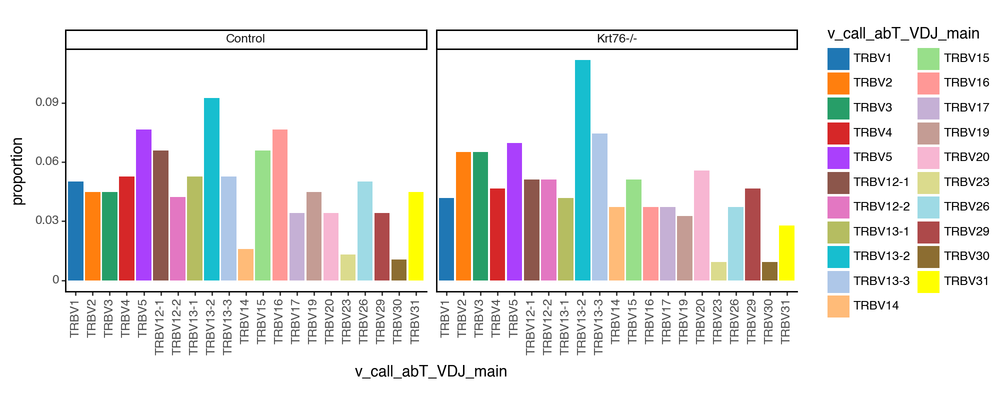

<Figure Size: (1000 x 400)>

In [787]:
options.figure_size = (10, 4)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VDJ_main", y="proportion", fill="v_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN4 - V gene Beta Chain

In [788]:
adata_PF_DN4 = adata_PF[adata_PF.obs["leiden"] == "2 DN4"]

In [789]:
adata_PF_DN4

View of AnnData object with n_obs × n_vars = 2076 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [790]:
working_df = pd.DataFrame(adata_PF_DN4.obs.groupby("Sample")["v_call_abT_VDJ_main"].value_counts())
working_df

v_call_abT_VDJ_main
Sample   v_call_abT_VDJ_main                     
Control  TRBV3                                103
         TRBV5                                103
         TRBV13-2                              98
         TRBV12-1                              91
         TRBV15                                90
         TRBV19                                87
         TRBV20                                82
         TRBV1                                 82
         TRBV16                                77
         TRBV13-1                              73
         TRBV4                                 61
         TRBV13-3                              60
         TRBV2                                 56
         TRBV12-2                              56
         TRBV29                                47
         TRBV31                                46
         TRBV26                                45
         TRBV17                                41
         TRBV14                                30
         TRBV23                                12
         TRBV30                                 5
         TRBV24                                 3
Krt76-/- TRBV12-1                              59
         TRBV20                                53
         TRBV13-2                              51
         TRBV19                                49
         TRBV5                                 48
         TRBV15                                46
         TRBV16                                43
         TRBV13-1                              43
         TRBV3                                 40
         TRBV4                                 37
         TRBV1                                 34
         TRBV31                                34
         TRBV12-2                              33
         TRBV26                                30
         TRBV13-3                              29
         TRBV29                                29
         TRBV2                                 28
         TRBV17                                26
         TRBV14                                14
         TRBV23                                 1
         TRBV30                                 1
         TRBV24                                 0

In [791]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VDJ_main,counts
0,Control,TRBV3,103
1,Control,TRBV5,103
2,Control,TRBV13-2,98
3,Control,TRBV12-1,91
4,Control,TRBV15,90
5,Control,TRBV19,87
6,Control,TRBV20,82
7,Control,TRBV1,82
8,Control,TRBV16,77
9,Control,TRBV13-1,73


In [792]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 1348, 'Krt76-/-': 728}

In [793]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [794]:
working_df

,Sample,v_call_abT_VDJ_main,counts,proportion
0,Control,TRBV3,103,0.076409
1,Control,TRBV5,103,0.076409
2,Control,TRBV13-2,98,0.072700
3,Control,TRBV12-1,91,0.067507
4,Control,TRBV15,90,0.066766
5,Control,TRBV19,87,0.064540
6,Control,TRBV20,82,0.060831
7,Control,TRBV1,82,0.060831
8,Control,TRBV16,77,0.057122
9,Control,TRBV13-1,73,0.054154


In [795]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [796]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

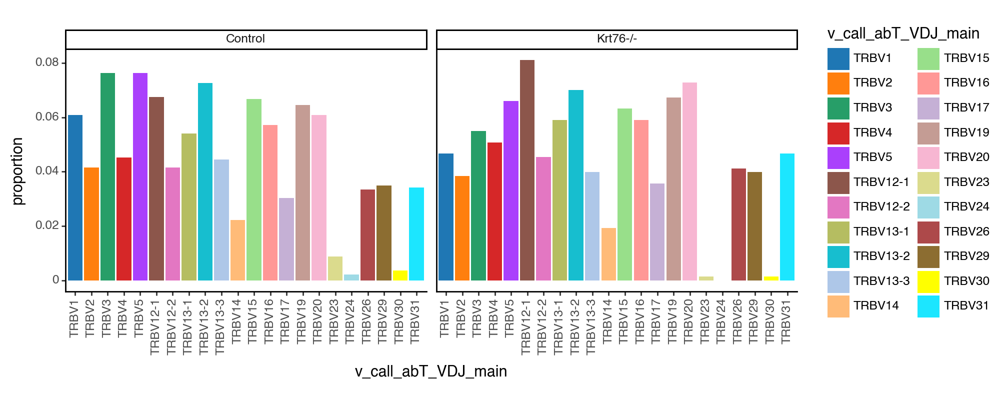

<Figure Size: (1000 x 400)>

In [797]:
options.figure_size = (10, 4)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VDJ_main", y="proportion", fill="v_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### ALL DNs combined- V gene Beta Chain

In [798]:
#adatax_single2 = adatax_single[adatax_single.obs['clone_id_size_max_3'].isin (['1','2'])]
#adata_PF_DN3ab = adata_PF[adata_PF.obs["leiden"] == "1 DN3a / DN3b"]
adatax_PF_DNall = adata_PF[adata_PF.obs['leiden'].isin (['7 DN2a', '12 DN2b 1', '4 DN2b 2', '10 DN3', '0 DN3a', '1 DN3a / DN3b', '6 DN3b', '2 DN4'])]

In [799]:
adatax_PF_DNall.obs['leiden'].value_counts()

2 DN4            2076
0 DN3a            611
6 DN3b            594
4 DN2b 2          558
1 DN3a / DN3b     313
10 DN3            120
7 DN2a             52
12 DN2b 1          38
Name: leiden, dtype: int64

In [800]:
working_df = pd.DataFrame(adatax_PF_DNall.obs.groupby("Sample")["v_call_abT_VDJ_main"].value_counts())
working_df

v_call_abT_VDJ_main
Sample   v_call_abT_VDJ_main                     
Control  TRBV13-2                             238
         TRBV5                                230
         TRBV15                               200
         TRBV12-1                             198
         TRBV16                               180
         TRBV3                                179
         TRBV19                               179
         TRBV20                               173
         TRBV13-1                             172
         TRBV1                                167
         TRBV31                               129
         TRBV2                                128
         TRBV4                                127
         TRBV13-3                             117
         TRBV12-2                             109
         TRBV26                               102
         TRBV17                                93
         TRBV29                                87
         TRBV14                                68
         TRBV23                                25
         TRBV30                                12
         TRBV24                                 6
         TRBV21                                 3
         TRBV10                                 2
Krt76-/- TRBV13-2                             121
         TRBV5                                105
         TRBV20                                96
         TRBV12-1                              96
         TRBV3                                 91
         TRBV15                                87
         TRBV19                                87
         TRBV13-1                              87
         TRBV16                                83
         TRBV1                                 79
         TRBV13-3                              61
         TRBV31                                61
         TRBV2                                 59
         TRBV12-2                              59
         TRBV17                                58
         TRBV4                                 57
         TRBV26                                56
         TRBV29                                47
         TRBV14                                33
         TRBV30                                10
         TRBV23                                 5
         TRBV10                                 0
         TRBV21                                 0
         TRBV24                                 0

In [801]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VDJ_main,counts
0,Control,TRBV13-2,238
1,Control,TRBV5,230
2,Control,TRBV15,200
3,Control,TRBV12-1,198
4,Control,TRBV16,180
5,Control,TRBV3,179
6,Control,TRBV19,179
7,Control,TRBV20,173
8,Control,TRBV13-1,172
9,Control,TRBV1,167


In [802]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 2924, 'Krt76-/-': 1438}

In [803]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [804]:
working_df

,Sample,v_call_abT_VDJ_main,counts,proportion
0,Control,TRBV13-2,238,0.081395
1,Control,TRBV5,230,0.078659
2,Control,TRBV15,200,0.068399
3,Control,TRBV12-1,198,0.067715
4,Control,TRBV16,180,0.061560
5,Control,TRBV3,179,0.061218
6,Control,TRBV19,179,0.061218
7,Control,TRBV20,173,0.059166
8,Control,TRBV13-1,172,0.058824
9,Control,TRBV1,167,0.057114


In [805]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [806]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

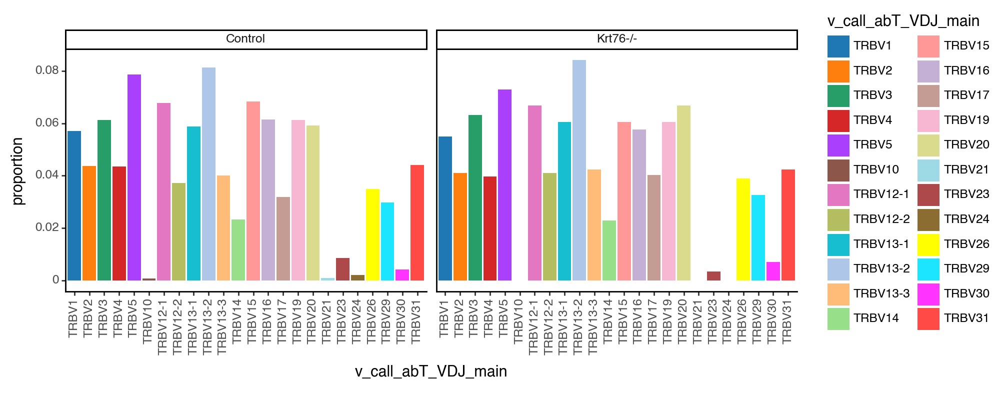

<Figure Size: (1000 x 400)>

In [807]:
options.figure_size = (10, 4)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VDJ_main", y="proportion", fill="v_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DP1 - V gene Beta Chain

In [808]:
adata_PF_DP1 = adata_PF[adata_PF.obs["leiden"] == "3 DP 1"]

In [809]:
adata_PF_DP1

View of AnnData object with n_obs × n_vars = 2398 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [810]:
working_df = pd.DataFrame(adata_PF_DP1.obs.groupby("Sample")["v_call_abT_VDJ_main"].value_counts())
working_df

v_call_abT_VDJ_main
Sample   v_call_abT_VDJ_main                     
Control  TRBV13-2                             125
         TRBV5                                119
         TRBV19                               103
         TRBV20                                94
         TRBV3                                 90
         TRBV15                                89
         TRBV12-1                              87
         TRBV1                                 79
         TRBV16                                75
         TRBV2                                 71
         TRBV26                                66
         TRBV13-3                              66
         TRBV4                                 63
         TRBV31                                61
         TRBV12-2                              60
         TRBV13-1                              58
         TRBV17                                50
         TRBV14                                43
         TRBV29                                37
         TRBV23                                 7
         TRBV30                                 5
Krt76-/- TRBV19                                80
         TRBV5                                 73
         TRBV13-2                              65
         TRBV12-1                              64
         TRBV1                                 62
         TRBV3                                 61
         TRBV20                                58
         TRBV13-1                              56
         TRBV15                                56
         TRBV16                                51
         TRBV2                                 46
         TRBV13-3                              41
         TRBV4                                 39
         TRBV17                                36
         TRBV31                                34
         TRBV12-2                              33
         TRBV26                                32
         TRBV14                                30
         TRBV29                                25
         TRBV23                                 4
         TRBV30                                 4

In [811]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VDJ_main,counts
0,Control,TRBV13-2,125
1,Control,TRBV5,119
2,Control,TRBV19,103
3,Control,TRBV20,94
4,Control,TRBV3,90
5,Control,TRBV15,89
6,Control,TRBV12-1,87
7,Control,TRBV1,79
8,Control,TRBV16,75
9,Control,TRBV2,71


In [812]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 1448, 'Krt76-/-': 950}

In [813]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [814]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [815]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

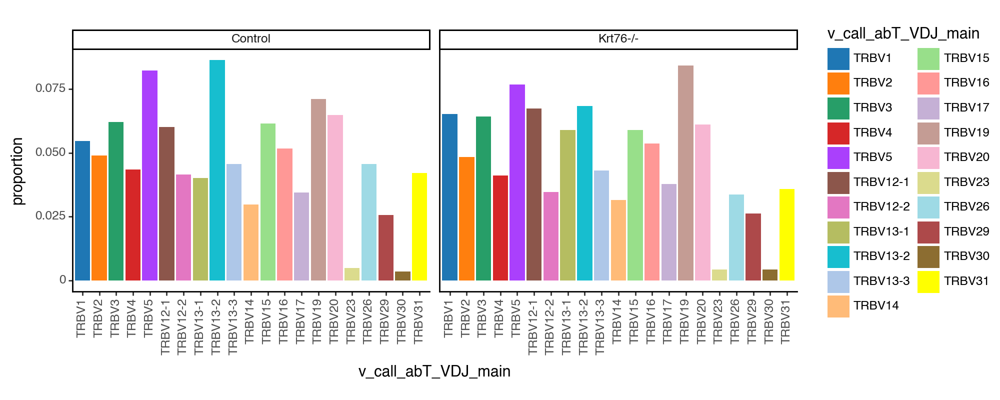

<Figure Size: (1000 x 400)>

In [816]:
options.figure_size = (10, 4)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VDJ_main", y="proportion", fill="v_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DP2 - V gene Beta Chain

In [817]:
adata_PF_DP2 = adata_PF[adata_PF.obs["leiden"] == "9 DP 2"]

In [818]:
adata_PF_DP2

View of AnnData object with n_obs × n_vars = 94 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [819]:
working_df = pd.DataFrame(adata_PF_DP1.obs.groupby("Sample")["v_call_abT_VDJ_main"].value_counts())
working_df

v_call_abT_VDJ_main
Sample   v_call_abT_VDJ_main                     
Control  TRBV13-2                             125
         TRBV5                                119
         TRBV19                               103
         TRBV20                                94
         TRBV3                                 90
         TRBV15                                89
         TRBV12-1                              87
         TRBV1                                 79
         TRBV16                                75
         TRBV2                                 71
         TRBV26                                66
         TRBV13-3                              66
         TRBV4                                 63
         TRBV31                                61
         TRBV12-2                              60
         TRBV13-1                              58
         TRBV17                                50
         TRBV14                                43
         TRBV29                                37
         TRBV23                                 7
         TRBV30                                 5
Krt76-/- TRBV19                                80
         TRBV5                                 73
         TRBV13-2                              65
         TRBV12-1                              64
         TRBV1                                 62
         TRBV3                                 61
         TRBV20                                58
         TRBV13-1                              56
         TRBV15                                56
         TRBV16                                51
         TRBV2                                 46
         TRBV13-3                              41
         TRBV4                                 39
         TRBV17                                36
         TRBV31                                34
         TRBV12-2                              33
         TRBV26                                32
         TRBV14                                30
         TRBV29                                25
         TRBV23                                 4
         TRBV30                                 4

In [820]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VDJ_main,counts
0,Control,TRBV13-2,125
1,Control,TRBV5,119
2,Control,TRBV19,103
3,Control,TRBV20,94
4,Control,TRBV3,90
5,Control,TRBV15,89
6,Control,TRBV12-1,87
7,Control,TRBV1,79
8,Control,TRBV16,75
9,Control,TRBV2,71


In [821]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 1448, 'Krt76-/-': 950}

In [822]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [823]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [824]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

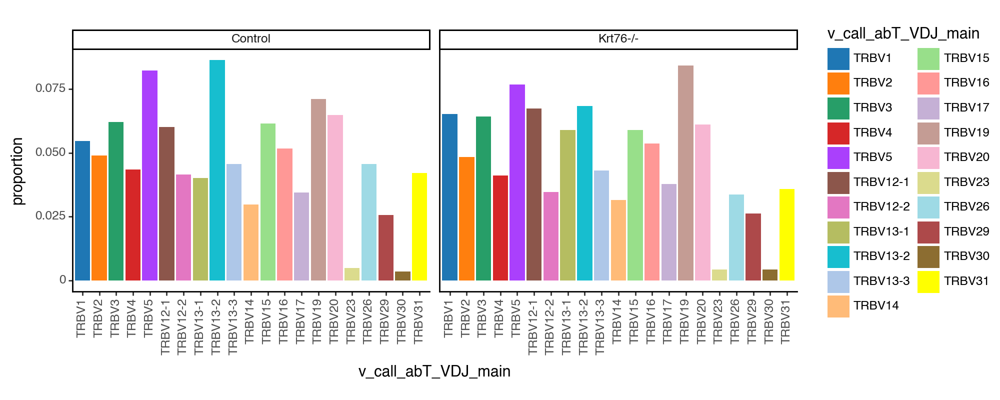

<Figure Size: (1000 x 400)>

In [825]:
options.figure_size = (10, 4)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VDJ_main", y="proportion", fill="v_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### SPDP - V gene Beta Chain

In [826]:
adata_PF_SPDP = adata_PF[adata_PF.obs["leiden"] == "5 SP & DP"]

In [827]:
adata_PF_SPDP

View of AnnData object with n_obs × n_vars = 841 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [828]:
working_df = pd.DataFrame(adata_PF_SPDP.obs.groupby("Sample")["v_call_abT_VDJ_main"].value_counts())
working_df

v_call_abT_VDJ_main
Sample   v_call_abT_VDJ_main                     
Control  TRBV13-2                              54
         TRBV13-1                              45
         TRBV5                                 44
         TRBV19                                39
         TRBV3                                 34
         TRBV16                                32
         TRBV2                                 29
         TRBV31                                28
         TRBV13-3                              27
         TRBV15                                27
         TRBV12-1                              26
         TRBV26                                25
         TRBV20                                23
         TRBV1                                 23
         TRBV12-2                              21
         TRBV14                                19
         TRBV17                                18
         TRBV4                                 18
         TRBV29                                17
         TRBV23                                 8
         TRBV30                                 1
Krt76-/- TRBV13-2                              29
         TRBV2                                 27
         TRBV19                                23
         TRBV5                                 23
         TRBV13-3                              21
         TRBV13-1                              20
         TRBV31                                17
         TRBV3                                 16
         TRBV16                                14
         TRBV20                                12
         TRBV12-1                              12
         TRBV12-2                              11
         TRBV15                                11
         TRBV1                                 10
         TRBV29                                 9
         TRBV4                                  7
         TRBV26                                 6
         TRBV14                                 6
         TRBV23                                 4
         TRBV17                                 3
         TRBV30                                 2

In [829]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VDJ_main,counts
0,Control,TRBV13-2,54
1,Control,TRBV13-1,45
2,Control,TRBV5,44
3,Control,TRBV19,39
4,Control,TRBV3,34
5,Control,TRBV16,32
6,Control,TRBV2,29
7,Control,TRBV31,28
8,Control,TRBV13-3,27
9,Control,TRBV15,27


In [830]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 558, 'Krt76-/-': 283}

In [831]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [832]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [833]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

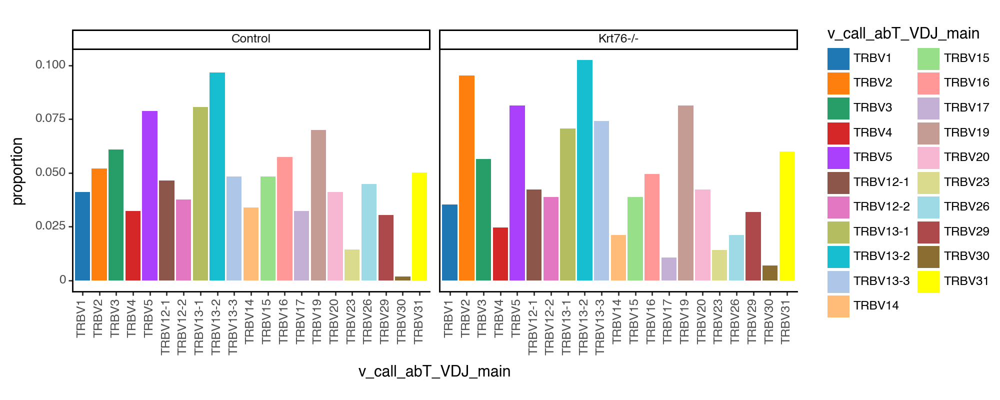

<Figure Size: (1000 x 400)>

In [834]:
options.figure_size = (10, 4)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VDJ_main", y="proportion", fill="v_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### TCRgD - V gene Beta Chain

In [835]:
adata_PF_gd = adata_PF[adata_PF.obs["leiden"] == "8 TCRgd"]

In [836]:
adata_PF_gd

View of AnnData object with n_obs × n_vars = 60 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [837]:
working_df = pd.DataFrame(adata_PF_gd.obs.groupby("Sample")["v_call_abT_VDJ_main"].value_counts())
working_df

v_call_abT_VDJ_main
Sample   v_call_abT_VDJ_main                     
Control  TRBV5                                  5
         TRBV13-2                               5
         TRBV13-3                               5
         TRBV15                                 3
         TRBV20                                 3
         TRBV4                                  3
         TRBV16                                 3
         TRBV17                                 3
         TRBV29                                 2
         TRBV12-2                               2
         TRBV26                                 2
         TRBV23                                 1
         TRBV21                                 1
         TRBV1                                  1
         TRBV3                                  1
         TRBV13-1                               1
         TRBV12-1                               1
         TRBV31                                 1
         TRBV19                                 0
         TRBV14                                 0
Krt76-/- TRBV16                                 3
         TRBV14                                 2
         TRBV29                                 2
         TRBV26                                 2
         TRBV20                                 2
         TRBV1                                  1
         TRBV19                                 1
         TRBV15                                 1
         TRBV13-2                               1
         TRBV5                                  1
         TRBV31                                 1
         TRBV13-3                               0
         TRBV3                                  0
         TRBV13-1                               0
         TRBV17                                 0
         TRBV12-2                               0
         TRBV12-1                               0
         TRBV21                                 0
         TRBV23                                 0
         TRBV4                                  0

In [838]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VDJ_main,counts
0,Control,TRBV5,5
1,Control,TRBV13-2,5
2,Control,TRBV13-3,5
3,Control,TRBV15,3
4,Control,TRBV20,3
5,Control,TRBV4,3
6,Control,TRBV16,3
7,Control,TRBV17,3
8,Control,TRBV29,2
9,Control,TRBV12-2,2


In [839]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 43, 'Krt76-/-': 17}

In [840]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [841]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [842]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

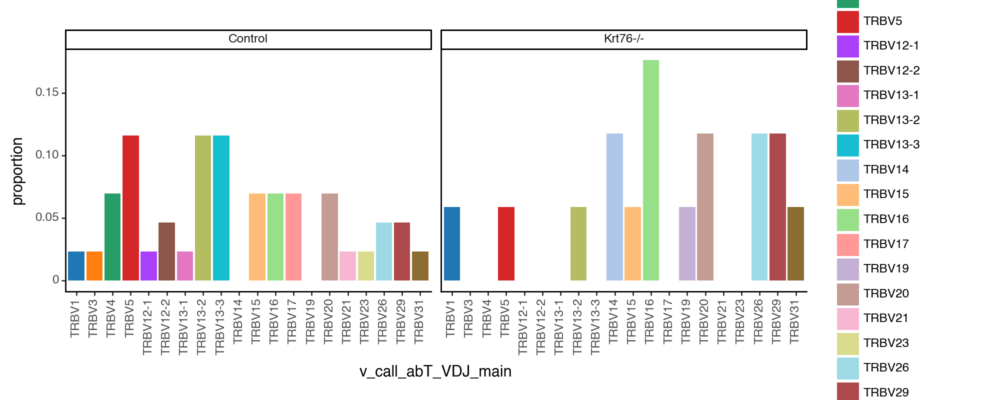

<Figure Size: (1000 x 400)>

In [843]:
options.figure_size = (10, 4)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VDJ_main", y="proportion", fill="v_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### NKT/NK/Tregs - V gene beta Chain

In [844]:
adata_PF_NK = adata_PF[adata_PF.obs["leiden"] == "11 NKT / NK / Tregs"]

In [845]:
adata_PF_NK

View of AnnData object with n_obs × n_vars = 141 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [846]:
working_df = pd.DataFrame(adata_PF_NK.obs.groupby("Sample")["v_call_abT_VDJ_main"].value_counts())
working_df

v_call_abT_VDJ_main
Sample   v_call_abT_VDJ_main                     
Control  TRBV19                                11
         TRBV3                                  8
         TRBV13-2                               8
         TRBV26                                 7
         TRBV5                                  7
         TRBV12-2                               7
         TRBV13-3                               7
         TRBV13-1                               6
         TRBV2                                  6
         TRBV15                                 6
         TRBV1                                  5
         TRBV16                                 5
         TRBV31                                 5
         TRBV12-1                               4
         TRBV29                                 4
         TRBV17                                 3
         TRBV20                                 3
         TRBV4                                  2
         TRBV23                                 1
         TRBV14                                 1
Krt76-/- TRBV13-2                               9
         TRBV20                                 4
         TRBV19                                 3
         TRBV5                                  3
         TRBV16                                 3
         TRBV2                                  3
         TRBV12-1                               2
         TRBV13-1                               2
         TRBV1                                  1
         TRBV15                                 1
         TRBV17                                 1
         TRBV31                                 1
         TRBV13-3                               1
         TRBV3                                  1
         TRBV12-2                               0
         TRBV4                                  0
         TRBV23                                 0
         TRBV26                                 0
         TRBV29                                 0
         TRBV14                                 0

In [847]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VDJ_main,counts
0,Control,TRBV19,11
1,Control,TRBV3,8
2,Control,TRBV13-2,8
3,Control,TRBV26,7
4,Control,TRBV5,7
5,Control,TRBV12-2,7
6,Control,TRBV13-3,7
7,Control,TRBV13-1,6
8,Control,TRBV2,6
9,Control,TRBV15,6


In [848]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 106, 'Krt76-/-': 35}

In [849]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [850]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [851]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

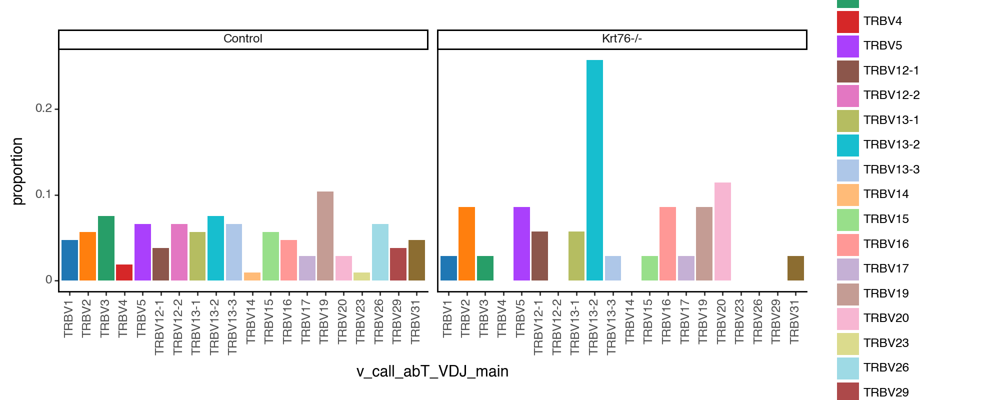

<Figure Size: (1000 x 400)>

In [852]:
options.figure_size = (10, 4)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VDJ_main", y="proportion", fill="v_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

## PRODUCTIVE  -  Split between control vs KO?? J GENE BETA CHAIN

In [1303]:
adata_PF = adata_P[adata_P.obs["j_call_abT_VDJ_main"] != "None"]
adata_PF = adata_PF[adata_PF.obs["j_call_abT_VDJ_main"] != "No_contig"]

In [1304]:
pd.crosstab(adata_PF.obs['Sample'], adata_PF.obs['leiden'])

leiden,0 DN3a,1 DN3a / DN3b,2 DN4,3 DP 1,4 DN2b 2,5 SP & DP,6 DN3b,7 DN2a,8 TCRgd,9 DP 2,10 DN3,11 NKT / NK / Tregs,12 DN2b 1
Sample,,,,,,,,,,,,,
Control,406,235,1396,1476,435,577,389,41,43,64,85,112,28
Krt76-/-,215,85,743,964,149,288,219,12,19,32,36,35,10


### DN2a - J gene beta chain

In [854]:
adata_PF_DN2a = adata_PF[adata_PF.obs["leiden"] == "7 DN2a"]

In [855]:
adata_PF_DN2a

View of AnnData object with n_obs × n_vars = 53 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [856]:
working_df = pd.DataFrame(adata_PF_DN2a.obs.groupby("Sample")["j_call_abT_VDJ_main"].value_counts())
working_df

j_call_abT_VDJ_main
Sample   j_call_abT_VDJ_main                     
Control  TRBJ2-5                                7
         TRBJ1-1                                6
         TRBJ2-4                                6
         TRBJ2-7                                6
         TRBJ1-4                                4
         TRBJ1-6                                3
         TRBJ2-1                                3
         TRBJ1-2                                2
         TRBJ2-3                                2
         TRBJ1-5                                1
         TRBJ2-6                                1
Krt76-/- TRBJ2-7                                3
         TRBJ1-1                                2
         TRBJ1-6                                2
         TRBJ1-4                                1
         TRBJ2-1                                1
         TRBJ2-3                                1
         TRBJ2-4                                1
         TRBJ2-5                                1
         TRBJ1-2                                0
         TRBJ1-5                                0
         TRBJ2-6                                0

In [857]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VDJ_main,counts
0,Control,TRBJ2-5,7
1,Control,TRBJ1-1,6
2,Control,TRBJ2-4,6
3,Control,TRBJ2-7,6
4,Control,TRBJ1-4,4
5,Control,TRBJ1-6,3
6,Control,TRBJ2-1,3
7,Control,TRBJ1-2,2
8,Control,TRBJ2-3,2
9,Control,TRBJ1-5,1


In [858]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 41, 'Krt76-/-': 12}

In [859]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [860]:
working_df

,Sample,j_call_abT_VDJ_main,counts,proportion
0,Control,TRBJ2-5,7,0.170732
1,Control,TRBJ1-1,6,0.146341
2,Control,TRBJ2-4,6,0.146341
3,Control,TRBJ2-7,6,0.146341
4,Control,TRBJ1-4,4,0.097561
5,Control,TRBJ1-6,3,0.073171
6,Control,TRBJ2-1,3,0.073171
7,Control,TRBJ1-2,2,0.048780
8,Control,TRBJ2-3,2,0.048780
9,Control,TRBJ1-5,1,0.024390


In [861]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [862]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

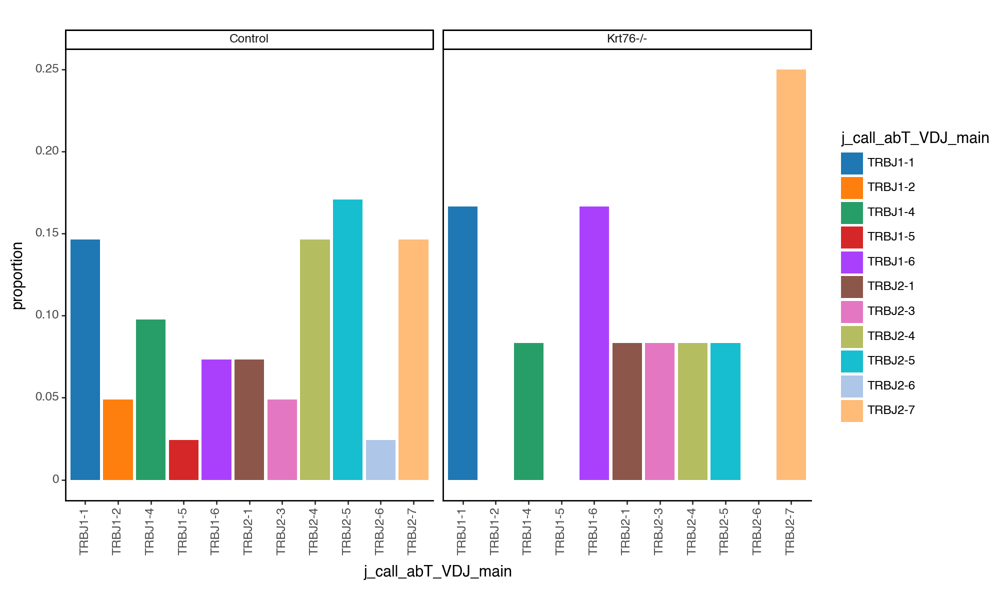

<Figure Size: (1000 x 600)>

In [863]:
options.figure_size = (10, 6)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VDJ_main", y="proportion", fill="j_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN2b1 - J gene beta chain

In [864]:
adata_PF_DN2b1 = adata_PF[adata_PF.obs["leiden"] == "12 DN2b 1"]

In [865]:
adata_PF_DN2b1

View of AnnData object with n_obs × n_vars = 38 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [866]:
working_df = pd.DataFrame(adata_PF_DN2b1.obs.groupby("Sample")["j_call_abT_VDJ_main"].value_counts())
working_df

j_call_abT_VDJ_main
Sample   j_call_abT_VDJ_main                     
Control  TRBJ2-7                                5
         TRBJ2-2                                4
         TRBJ1-1                                3
         TRBJ1-4                                3
         TRBJ2-3                                3
         TRBJ1-2                                2
         TRBJ1-5                                2
         TRBJ2-1                                2
         TRBJ2-5                                2
         TRBJ1-3                                1
         TRBJ2-4                                1
         TRBJ1-6                                0
Krt76-/- TRBJ2-1                                3
         TRBJ2-4                                2
         TRBJ1-1                                1
         TRBJ1-5                                1
         TRBJ1-6                                1
         TRBJ2-3                                1
         TRBJ2-7                                1
         TRBJ1-2                                0
         TRBJ1-3                                0
         TRBJ1-4                                0
         TRBJ2-2                                0
         TRBJ2-5                                0

In [867]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VDJ_main,counts
0,Control,TRBJ2-7,5
1,Control,TRBJ2-2,4
2,Control,TRBJ1-1,3
3,Control,TRBJ1-4,3
4,Control,TRBJ2-3,3
5,Control,TRBJ1-2,2
6,Control,TRBJ1-5,2
7,Control,TRBJ2-1,2
8,Control,TRBJ2-5,2
9,Control,TRBJ1-3,1


In [868]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 28, 'Krt76-/-': 10}

In [869]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [870]:
working_df

,Sample,j_call_abT_VDJ_main,counts,proportion
0,Control,TRBJ2-7,5,0.178571
1,Control,TRBJ2-2,4,0.142857
2,Control,TRBJ1-1,3,0.107143
3,Control,TRBJ1-4,3,0.107143
4,Control,TRBJ2-3,3,0.107143
5,Control,TRBJ1-2,2,0.071429
6,Control,TRBJ1-5,2,0.071429
7,Control,TRBJ2-1,2,0.071429
8,Control,TRBJ2-5,2,0.071429
9,Control,TRBJ1-3,1,0.035714


In [871]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [872]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

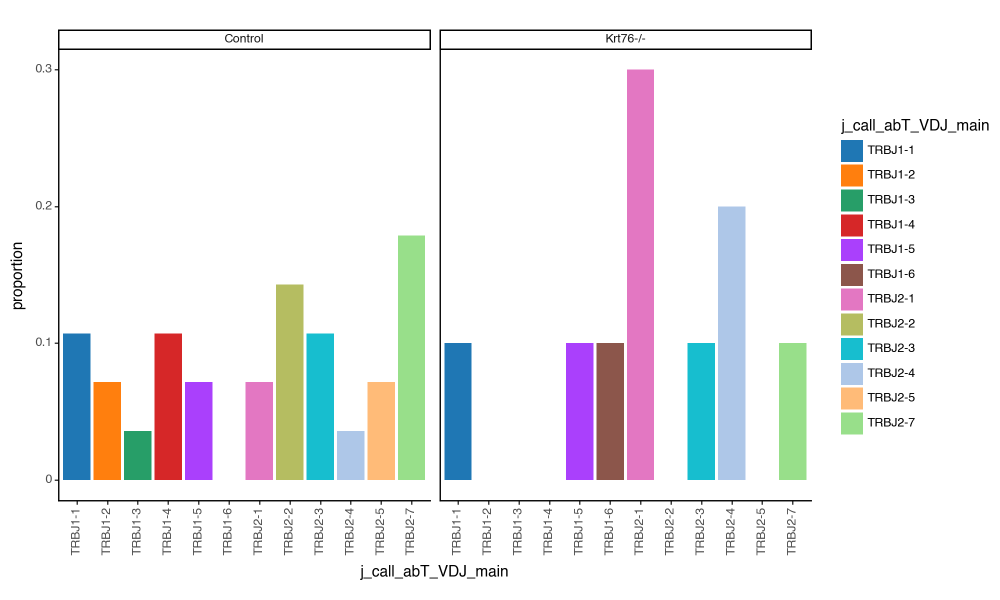

<Figure Size: (1000 x 600)>

In [873]:
options.figure_size = (10, 6)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VDJ_main", y="proportion", fill="j_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN2b2 - J gene beta chain

In [874]:
adata_PF_DN2b2 = adata_PF[adata_PF.obs["leiden"] == "4 DN2b 2"]

In [875]:
adata_PF_DN2b2

View of AnnData object with n_obs × n_vars = 584 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [876]:
working_df = pd.DataFrame(adata_PF_DN2b2.obs.groupby("Sample")["j_call_abT_VDJ_main"].value_counts())
working_df

j_call_abT_VDJ_main
Sample   j_call_abT_VDJ_main                         
Control  TRBJ2-1                                   77
         TRBJ2-7                                   66
         TRBJ2-5                                   64
         TRBJ1-2                                   38
         TRBJ2-4                                   37
         TRBJ1-1                                   34
         TRBJ2-3                                   32
         TRBJ1-4                                   24
         TRBJ1-3                                   19
         TRBJ2-2                                   17
         TRBJ1-5                                   11
         TRBJ1-6                                   10
         TRBJ2-6                                    5
         TRBJ1-6,TRBJ2-7,TRBJ2-2                    1
Krt76-/- TRBJ2-7                                   25
         TRBJ2-5                                   21
         TRBJ1-1                                   19
         TRBJ2-3                                   18
         TRBJ1-5                                   13
         TRBJ2-4                                   11
         TRBJ2-1                                   10
         TRBJ1-2                                    8
         TRBJ2-2                                    8
         TRBJ1-4                                    7
         TRBJ1-3                                    5
         TRBJ1-6                                    3
         TRBJ2-6                                    1
         TRBJ1-6,TRBJ2-7,TRBJ2-2                    0

In [877]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VDJ_main,counts
0,Control,TRBJ2-1,77
1,Control,TRBJ2-7,66
2,Control,TRBJ2-5,64
3,Control,TRBJ1-2,38
4,Control,TRBJ2-4,37
5,Control,TRBJ1-1,34
6,Control,TRBJ2-3,32
7,Control,TRBJ1-4,24
8,Control,TRBJ1-3,19
9,Control,TRBJ2-2,17


In [878]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 435, 'Krt76-/-': 149}

In [879]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [880]:
working_df

,Sample,j_call_abT_VDJ_main,counts,proportion
0,Control,TRBJ2-1,77,0.177011
1,Control,TRBJ2-7,66,0.151724
2,Control,TRBJ2-5,64,0.147126
3,Control,TRBJ1-2,38,0.087356
4,Control,TRBJ2-4,37,0.085057
5,Control,TRBJ1-1,34,0.078161
6,Control,TRBJ2-3,32,0.073563
7,Control,TRBJ1-4,24,0.055172
8,Control,TRBJ1-3,19,0.043678
9,Control,TRBJ2-2,17,0.039080


In [881]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [882]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

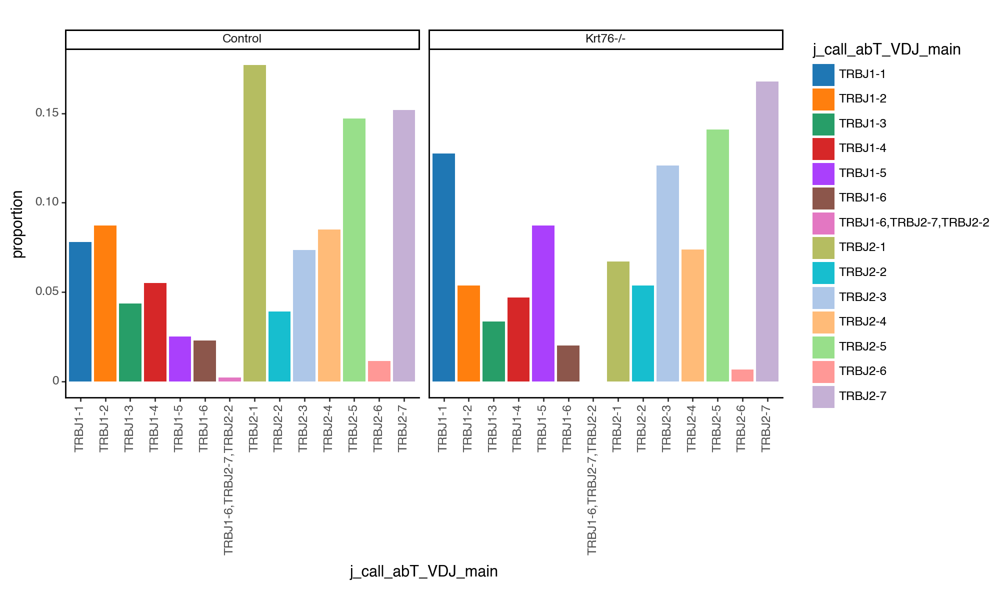

<Figure Size: (1000 x 600)>

In [883]:
options.figure_size = (10, 6)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VDJ_main", y="proportion", fill="j_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN3 - J gene beta chain

In [884]:
adata_PF_DN3 = adata_PF[adata_PF.obs["leiden"] == "10 DN3"]

In [885]:
adata_PF_DN3

View of AnnData object with n_obs × n_vars = 121 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [886]:
working_df = pd.DataFrame(adata_PF_DN3.obs.groupby("Sample")["j_call_abT_VDJ_main"].value_counts())
working_df

j_call_abT_VDJ_main
Sample   j_call_abT_VDJ_main                     
Control  TRBJ2-7                               18
         TRBJ2-1                               13
         TRBJ1-3                                9
         TRBJ1-1                                6
         TRBJ1-2                                6
         TRBJ2-3                                6
         TRBJ2-5                                6
         TRBJ1-4                                5
         TRBJ1-5                                5
         TRBJ2-2                                5
         TRBJ1-6                                3
         TRBJ2-4                                3
Krt76-/- TRBJ2-5                                9
         TRBJ1-1                                6
         TRBJ2-7                                5
         TRBJ2-4                                4
         TRBJ2-1                                3
         TRBJ2-3                                3
         TRBJ1-3                                2
         TRBJ1-4                                2
         TRBJ1-5                                1
         TRBJ1-6                                1
         TRBJ1-2                                0
         TRBJ2-2                                0

In [887]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VDJ_main,counts
0,Control,TRBJ2-7,18
1,Control,TRBJ2-1,13
2,Control,TRBJ1-3,9
3,Control,TRBJ1-1,6
4,Control,TRBJ1-2,6
5,Control,TRBJ2-3,6
6,Control,TRBJ2-5,6
7,Control,TRBJ1-4,5
8,Control,TRBJ1-5,5
9,Control,TRBJ2-2,5


In [888]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 85, 'Krt76-/-': 36}

In [889]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [890]:
working_df

,Sample,j_call_abT_VDJ_main,counts,proportion
0,Control,TRBJ2-7,18,0.211765
1,Control,TRBJ2-1,13,0.152941
2,Control,TRBJ1-3,9,0.105882
3,Control,TRBJ1-1,6,0.070588
4,Control,TRBJ1-2,6,0.070588
5,Control,TRBJ2-3,6,0.070588
6,Control,TRBJ2-5,6,0.070588
7,Control,TRBJ1-4,5,0.058824
8,Control,TRBJ1-5,5,0.058824
9,Control,TRBJ2-2,5,0.058824


In [891]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [892]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

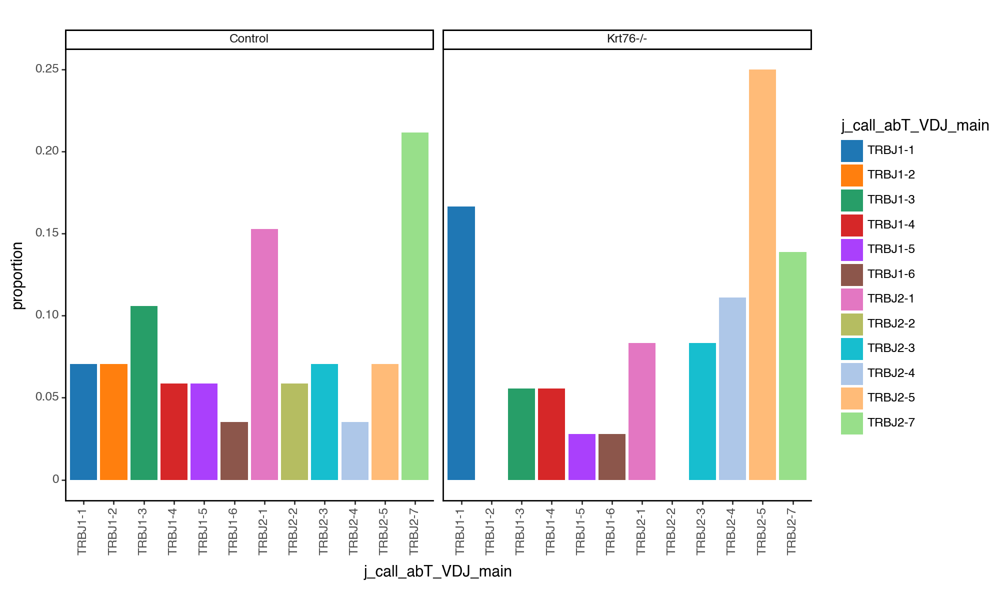

<Figure Size: (1000 x 600)>

In [893]:
options.figure_size = (10, 6)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VDJ_main", y="proportion", fill="j_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN3a - J gene beta chain

In [894]:
adata_PF_DN3a = adata_PF[adata_PF.obs["leiden"] == "0 DN3a"]

In [895]:
adata_PF_DN3a

View of AnnData object with n_obs × n_vars = 621 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [896]:
working_df = pd.DataFrame(adata_PF_DN3a.obs.groupby("Sample")["j_call_abT_VDJ_main"].value_counts())
working_df

j_call_abT_VDJ_main
Sample   j_call_abT_VDJ_main                     
Control  TRBJ2-7                               60
         TRBJ2-5                               54
         TRBJ2-4                               51
         TRBJ1-1                               47
         TRBJ2-1                               41
         TRBJ1-4                               35
         TRBJ1-2                               28
         TRBJ2-2                               23
         TRBJ2-3                               22
         TRBJ1-3                               17
         TRBJ1-6                               14
         TRBJ1-5                               11
         TRBJ2-6                                2
         TRBJ1-5,TRBJ2-2                        1
Krt76-/- TRBJ2-5                               32
         TRBJ2-7                               30
         TRBJ2-4                               29
         TRBJ1-2                               19
         TRBJ2-1                               19
         TRBJ1-1                               18
         TRBJ2-3                               18
         TRBJ2-2                               14
         TRBJ1-5                               12
         TRBJ1-3                                8
         TRBJ1-4                                8
         TRBJ1-6                                7
         TRBJ2-6                                1
         TRBJ1-5,TRBJ2-2                        0

In [897]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VDJ_main,counts
0,Control,TRBJ2-7,60
1,Control,TRBJ2-5,54
2,Control,TRBJ2-4,51
3,Control,TRBJ1-1,47
4,Control,TRBJ2-1,41
5,Control,TRBJ1-4,35
6,Control,TRBJ1-2,28
7,Control,TRBJ2-2,23
8,Control,TRBJ2-3,22
9,Control,TRBJ1-3,17


In [898]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 406, 'Krt76-/-': 215}

In [899]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [900]:
working_df

,Sample,j_call_abT_VDJ_main,counts,proportion
0,Control,TRBJ2-7,60,0.147783
1,Control,TRBJ2-5,54,0.133005
2,Control,TRBJ2-4,51,0.125616
3,Control,TRBJ1-1,47,0.115764
4,Control,TRBJ2-1,41,0.100985
5,Control,TRBJ1-4,35,0.086207
6,Control,TRBJ1-2,28,0.068966
7,Control,TRBJ2-2,23,0.056650
8,Control,TRBJ2-3,22,0.054187
9,Control,TRBJ1-3,17,0.041872


In [901]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [902]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

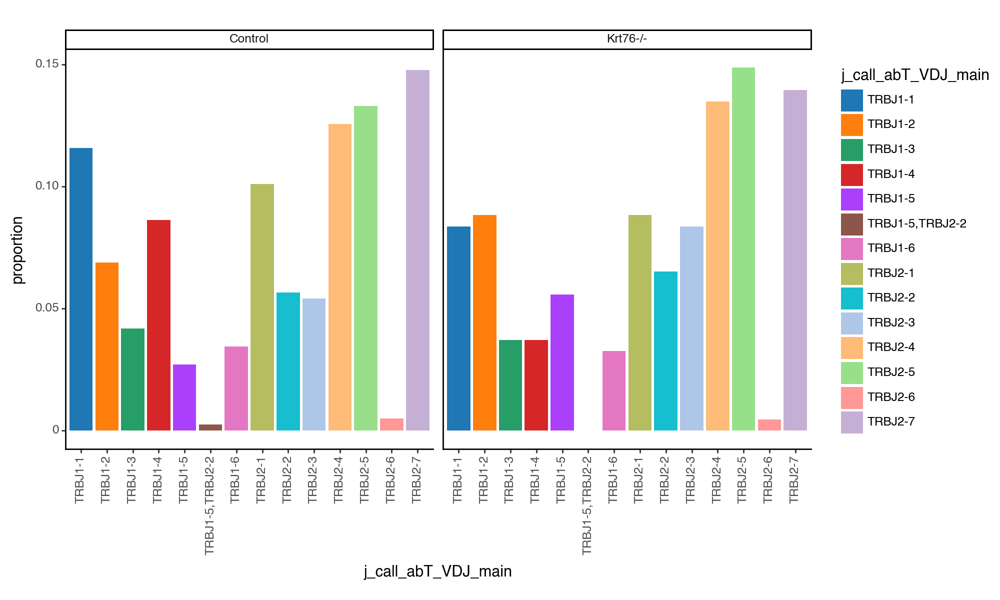

<Figure Size: (1000 x 600)>

In [903]:
options.figure_size = (10, 6)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VDJ_main", y="proportion", fill="j_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN3ab - J gene Beta Chain

In [904]:
adata_PF_DN3ab = adata_PF[adata_PF.obs["leiden"] == "1 DN3a / DN3b"]

In [905]:
adata_PF_DN3ab

View of AnnData object with n_obs × n_vars = 320 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [906]:
working_df = pd.DataFrame(adata_PF_DN3ab.obs.groupby("Sample")["j_call_abT_VDJ_main"].value_counts())
working_df

j_call_abT_VDJ_main
Sample   j_call_abT_VDJ_main                     
Control  TRBJ2-7                               42
         TRBJ2-5                               37
         TRBJ2-1                               30
         TRBJ1-1                               26
         TRBJ1-2                               17
         TRBJ1-4                               15
         TRBJ1-6                               14
         TRBJ2-3                               14
         TRBJ2-4                               14
         TRBJ1-3                               13
         TRBJ2-2                                7
         TRBJ1-5                                6
Krt76-/- TRBJ1-1                               14
         TRBJ2-5                               13
         TRBJ2-7                               13
         TRBJ2-1                                9
         TRBJ1-4                                8
         TRBJ2-4                                7
         TRBJ1-2                                6
         TRBJ1-5                                5
         TRBJ1-6                                5
         TRBJ2-2                                3
         TRBJ2-3                                2
         TRBJ1-3                                0

In [907]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VDJ_main,counts
0,Control,TRBJ2-7,42
1,Control,TRBJ2-5,37
2,Control,TRBJ2-1,30
3,Control,TRBJ1-1,26
4,Control,TRBJ1-2,17
5,Control,TRBJ1-4,15
6,Control,TRBJ1-6,14
7,Control,TRBJ2-3,14
8,Control,TRBJ2-4,14
9,Control,TRBJ1-3,13


In [908]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 235, 'Krt76-/-': 85}

In [909]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [910]:
working_df

,Sample,j_call_abT_VDJ_main,counts,proportion
0,Control,TRBJ2-7,42,0.178723
1,Control,TRBJ2-5,37,0.157447
2,Control,TRBJ2-1,30,0.127660
3,Control,TRBJ1-1,26,0.110638
4,Control,TRBJ1-2,17,0.072340
5,Control,TRBJ1-4,15,0.063830
6,Control,TRBJ1-6,14,0.059574
7,Control,TRBJ2-3,14,0.059574
8,Control,TRBJ2-4,14,0.059574
9,Control,TRBJ1-3,13,0.055319


In [911]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [912]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

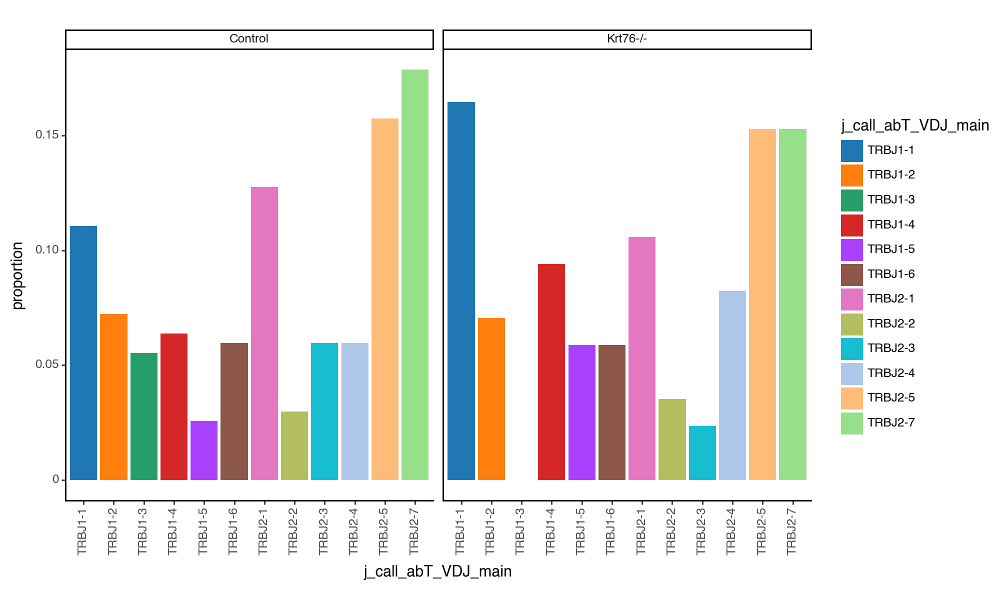

<Figure Size: (1000 x 600)>

In [913]:
options.figure_size = (10, 6)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VDJ_main", y="proportion", fill="j_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN3b - J gene beta chain

In [914]:
adata_PF_DN3b = adata_PF[adata_PF.obs["leiden"] == "6 DN3b"]

In [915]:
adata_PF_DN3b

View of AnnData object with n_obs × n_vars = 608 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [916]:
working_df = pd.DataFrame(adata_PF_DN3b.obs.groupby("Sample")["j_call_abT_VDJ_main"].value_counts())
working_df

j_call_abT_VDJ_main
Sample   j_call_abT_VDJ_main                     
Control  TRBJ2-7                               68
         TRBJ2-1                               61
         TRBJ2-5                               47
         TRBJ2-3                               39
         TRBJ1-1                               32
         TRBJ2-4                               29
         TRBJ1-2                               25
         TRBJ1-3                               22
         TRBJ2-2                               21
         TRBJ1-5                               15
         TRBJ1-6                               14
         TRBJ1-4                               13
         TRBJ2-6                                3
Krt76-/- TRBJ2-7                               34
         TRBJ1-4                               23
         TRBJ2-1                               22
         TRBJ1-1                               20
         TRBJ2-5                               20
         TRBJ2-3                               18
         TRBJ1-5                               16
         TRBJ1-2                               14
         TRBJ1-3                               14
         TRBJ2-4                               14
         TRBJ1-6                               12
         TRBJ2-2                                9
         TRBJ2-6                                3

In [917]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VDJ_main,counts
0,Control,TRBJ2-7,68
1,Control,TRBJ2-1,61
2,Control,TRBJ2-5,47
3,Control,TRBJ2-3,39
4,Control,TRBJ1-1,32
5,Control,TRBJ2-4,29
6,Control,TRBJ1-2,25
7,Control,TRBJ1-3,22
8,Control,TRBJ2-2,21
9,Control,TRBJ1-5,15


In [918]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 389, 'Krt76-/-': 219}

In [919]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [920]:
working_df

,Sample,j_call_abT_VDJ_main,counts,proportion
0,Control,TRBJ2-7,68,0.174807
1,Control,TRBJ2-1,61,0.156812
2,Control,TRBJ2-5,47,0.120823
3,Control,TRBJ2-3,39,0.100257
4,Control,TRBJ1-1,32,0.082262
5,Control,TRBJ2-4,29,0.074550
6,Control,TRBJ1-2,25,0.064267
7,Control,TRBJ1-3,22,0.056555
8,Control,TRBJ2-2,21,0.053985
9,Control,TRBJ1-5,15,0.038560


In [921]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [922]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

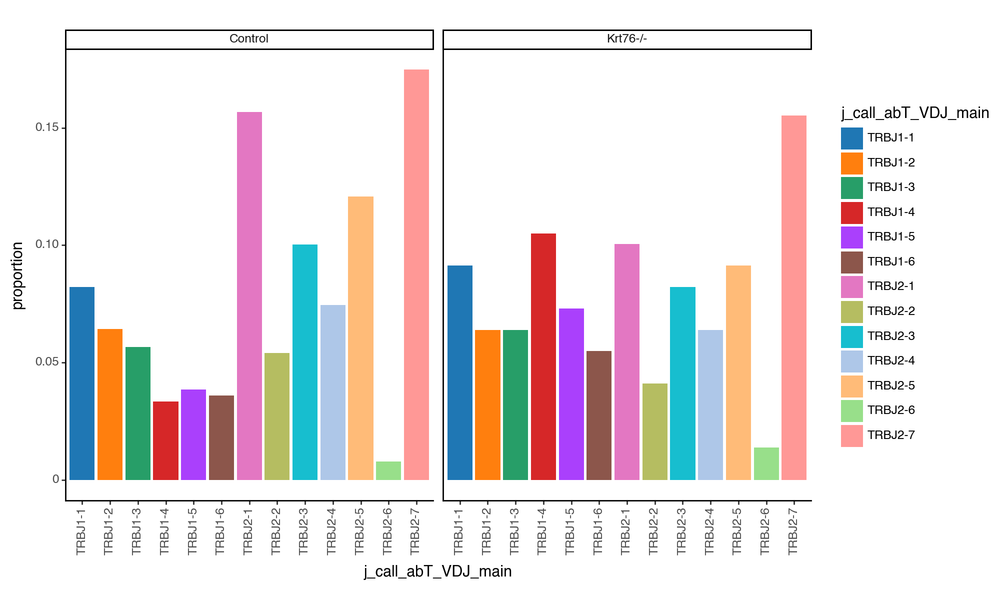

<Figure Size: (1000 x 600)>

In [923]:
options.figure_size = (10, 6)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VDJ_main", y="proportion", fill="j_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN4 - J gene Beta Chain

In [924]:
adata_PF_DN4 = adata_PF[adata_PF.obs["leiden"] == "2 DN4"]

In [925]:
adata_PF_DN4

View of AnnData object with n_obs × n_vars = 2139 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [926]:
working_df = pd.DataFrame(adata_PF_DN4.obs.groupby("Sample")["j_call_abT_VDJ_main"].value_counts())
working_df

j_call_abT_VDJ_main
Sample   j_call_abT_VDJ_main                     
Control  TRBJ2-7                              222
         TRBJ2-5                              167
         TRBJ1-1                              162
         TRBJ2-1                              139
         TRBJ2-4                              128
         TRBJ2-3                              111
         TRBJ1-4                              100
         TRBJ1-2                               95
         TRBJ2-2                               78
         TRBJ1-3                               71
         TRBJ1-5                               54
         TRBJ1-6                               53
         TRBJ2-6                               15
         TRBJ2-4,TRBJ2-3                        1
Krt76-/- TRBJ2-7                              148
         TRBJ2-5                               87
         TRBJ1-1                               74
         TRBJ2-1                               71
         TRBJ2-4                               63
         TRBJ2-3                               56
         TRBJ1-2                               54
         TRBJ1-4                               51
         TRBJ1-6                               36
         TRBJ2-2                               36
         TRBJ1-3                               32
         TRBJ1-5                               32
         TRBJ2-6                                3
         TRBJ2-4,TRBJ2-3                        0

In [927]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VDJ_main,counts
0,Control,TRBJ2-7,222
1,Control,TRBJ2-5,167
2,Control,TRBJ1-1,162
3,Control,TRBJ2-1,139
4,Control,TRBJ2-4,128
5,Control,TRBJ2-3,111
6,Control,TRBJ1-4,100
7,Control,TRBJ1-2,95
8,Control,TRBJ2-2,78
9,Control,TRBJ1-3,71


In [928]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 1396, 'Krt76-/-': 743}

In [929]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [930]:
working_df

,Sample,j_call_abT_VDJ_main,counts,proportion
0,Control,TRBJ2-7,222,0.159026
1,Control,TRBJ2-5,167,0.119628
2,Control,TRBJ1-1,162,0.116046
3,Control,TRBJ2-1,139,0.099570
4,Control,TRBJ2-4,128,0.091691
5,Control,TRBJ2-3,111,0.079513
6,Control,TRBJ1-4,100,0.071633
7,Control,TRBJ1-2,95,0.068052
8,Control,TRBJ2-2,78,0.055874
9,Control,TRBJ1-3,71,0.050860


In [931]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [932]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

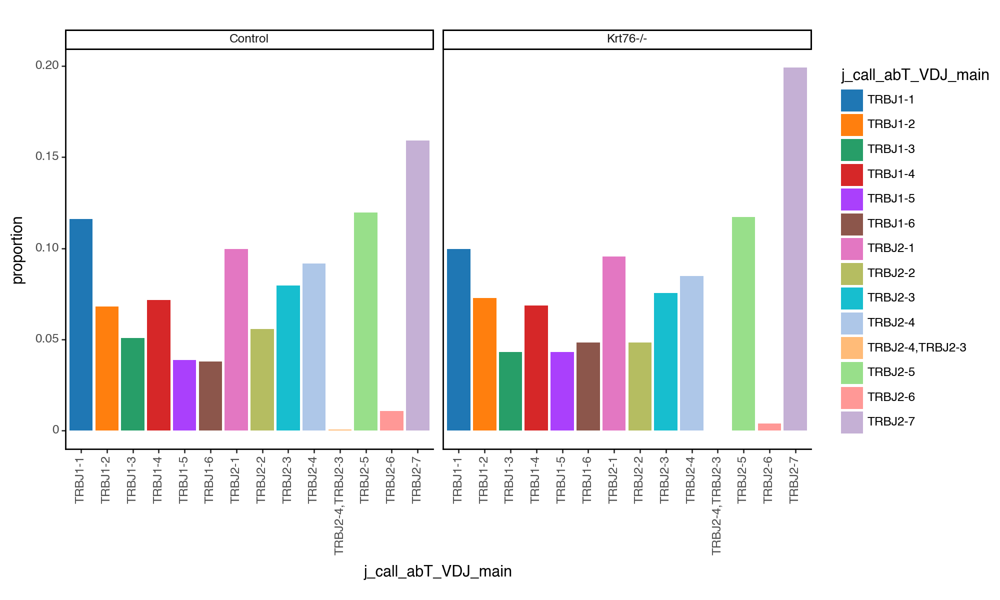

<Figure Size: (1000 x 600)>

In [933]:
options.figure_size = (10, 6)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VDJ_main", y="proportion", fill="j_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### ALL DNs combined- J gene Beta Chain

In [934]:
#adatax_single2 = adatax_single[adatax_single.obs['clone_id_size_max_3'].isin (['1','2'])]
#adata_PF_DN3ab = adata_PF[adata_PF.obs["leiden"] == "1 DN3a / DN3b"]
adatax_PF_DNall = adata_PF[adata_PF.obs['leiden'].isin (['7 DN2a', '12 DN2b 1', '4 DN2b 2', '10 DN3', '0 DN3a', '1 DN3a / DN3b', '6 DN3b', '2 DN4'])]

In [935]:
adatax_PF_DNall.obs['leiden'].value_counts()

2 DN4            2139
0 DN3a            621
6 DN3b            608
4 DN2b 2          584
1 DN3a / DN3b     320
10 DN3            121
7 DN2a             53
12 DN2b 1          38
Name: leiden, dtype: int64

In [936]:
working_df = pd.DataFrame(adatax_PF_DNall.obs.groupby("Sample")["j_call_abT_VDJ_main"].value_counts())
working_df

j_call_abT_VDJ_main
Sample   j_call_abT_VDJ_main                         
Control  TRBJ2-7                                  487
         TRBJ2-5                                  384
         TRBJ2-1                                  366
         TRBJ1-1                                  316
         TRBJ2-4                                  269
         TRBJ2-3                                  229
         TRBJ1-2                                  213
         TRBJ1-4                                  199
         TRBJ2-2                                  155
         TRBJ1-3                                  152
         TRBJ1-6                                  111
         TRBJ1-5                                  105
         TRBJ2-6                                   26
         TRBJ1-5,TRBJ2-2                            1
         TRBJ1-6,TRBJ2-7,TRBJ2-2                    1
         TRBJ2-4,TRBJ2-3                            1
Krt76-/- TRBJ2-7                                  259
         TRBJ2-5                                  183
         TRBJ1-1                                  154
         TRBJ2-1                                  138
         TRBJ2-4                                  131
         TRBJ2-3                                  117
         TRBJ1-2                                  101
         TRBJ1-4                                  100
         TRBJ1-5                                   80
         TRBJ2-2                                   70
         TRBJ1-6                                   67
         TRBJ1-3                                   61
         TRBJ2-6                                    8
         TRBJ1-5,TRBJ2-2                            0
         TRBJ1-6,TRBJ2-7,TRBJ2-2                    0
         TRBJ2-4,TRBJ2-3                            0

In [937]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VDJ_main,counts
0,Control,TRBJ2-7,487
1,Control,TRBJ2-5,384
2,Control,TRBJ2-1,366
3,Control,TRBJ1-1,316
4,Control,TRBJ2-4,269
5,Control,TRBJ2-3,229
6,Control,TRBJ1-2,213
7,Control,TRBJ1-4,199
8,Control,TRBJ2-2,155
9,Control,TRBJ1-3,152


In [938]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 3015, 'Krt76-/-': 1469}

In [939]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [940]:
working_df

,Sample,j_call_abT_VDJ_main,counts,proportion
0,Control,TRBJ2-7,487,0.161526
1,Control,TRBJ2-5,384,0.127363
2,Control,TRBJ2-1,366,0.121393
3,Control,TRBJ1-1,316,0.104809
4,Control,TRBJ2-4,269,0.089221
5,Control,TRBJ2-3,229,0.075954
6,Control,TRBJ1-2,213,0.070647
7,Control,TRBJ1-4,199,0.066003
8,Control,TRBJ2-2,155,0.051410
9,Control,TRBJ1-3,152,0.050415


In [941]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [942]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

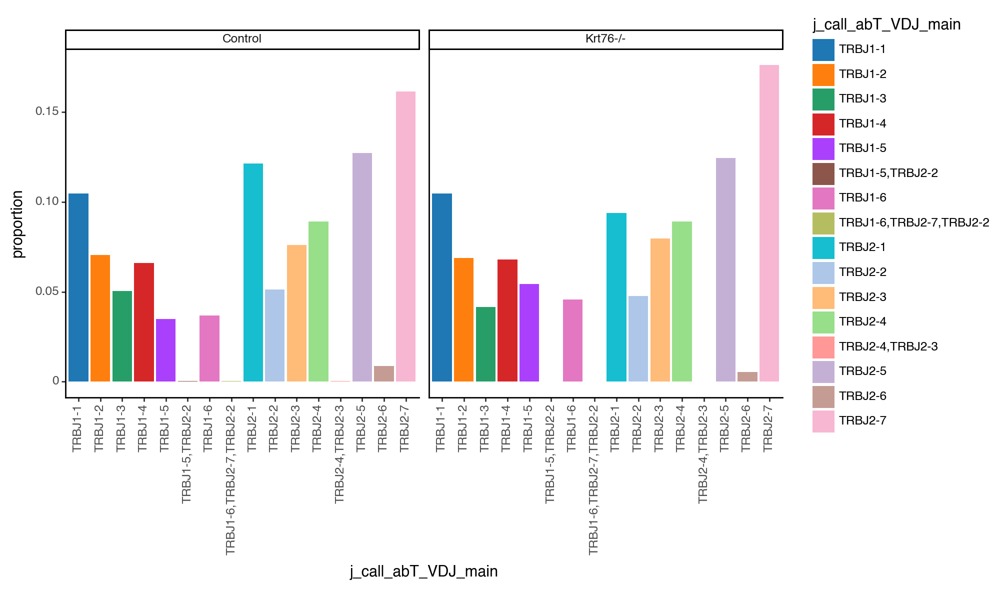

<Figure Size: (1000 x 600)>

In [943]:
options.figure_size = (10, 6)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VDJ_main", y="proportion", fill="j_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DP1 - J gene beta chain

In [944]:
adata_PF_DP1 = adata_PF[adata_PF.obs["leiden"] == "3 DP 1"]

In [945]:
adata_PF_DP1

View of AnnData object with n_obs × n_vars = 2440 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [946]:
working_df = pd.DataFrame(adata_PF_DP1.obs.groupby("Sample")["j_call_abT_VDJ_main"].value_counts())
working_df

j_call_abT_VDJ_main
Sample   j_call_abT_VDJ_main                     
Control  TRBJ2-7                              222
         TRBJ2-5                              161
         TRBJ1-1                              151
         TRBJ2-1                              140
         TRBJ2-3                              128
         TRBJ2-4                              121
         TRBJ1-2                              117
         TRBJ1-4                              108
         TRBJ1-3                               97
         TRBJ2-2                               90
         TRBJ1-6                               68
         TRBJ1-5                               64
         TRBJ2-6                                8
         TRBJ2-5,TRBJ2-4                        1
Krt76-/- TRBJ2-7                              175
         TRBJ2-5                              121
         TRBJ2-4                              103
         TRBJ2-1                              102
         TRBJ1-1                               94
         TRBJ2-3                               79
         TRBJ1-4                               59
         TRBJ1-2                               58
         TRBJ1-5                               48
         TRBJ1-3                               45
         TRBJ1-6                               39
         TRBJ2-2                               35
         TRBJ2-6                                6
         TRBJ2-5,TRBJ2-4                        0

In [947]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VDJ_main,counts
0,Control,TRBJ2-7,222
1,Control,TRBJ2-5,161
2,Control,TRBJ1-1,151
3,Control,TRBJ2-1,140
4,Control,TRBJ2-3,128
5,Control,TRBJ2-4,121
6,Control,TRBJ1-2,117
7,Control,TRBJ1-4,108
8,Control,TRBJ1-3,97
9,Control,TRBJ2-2,90


In [948]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 1476, 'Krt76-/-': 964}

In [949]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [950]:
working_df

,Sample,j_call_abT_VDJ_main,counts,proportion
0,Control,TRBJ2-7,222,0.150407
1,Control,TRBJ2-5,161,0.109079
2,Control,TRBJ1-1,151,0.102304
3,Control,TRBJ2-1,140,0.094851
4,Control,TRBJ2-3,128,0.086721
5,Control,TRBJ2-4,121,0.081978
6,Control,TRBJ1-2,117,0.079268
7,Control,TRBJ1-4,108,0.073171
8,Control,TRBJ1-3,97,0.065718
9,Control,TRBJ2-2,90,0.060976


In [951]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [952]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

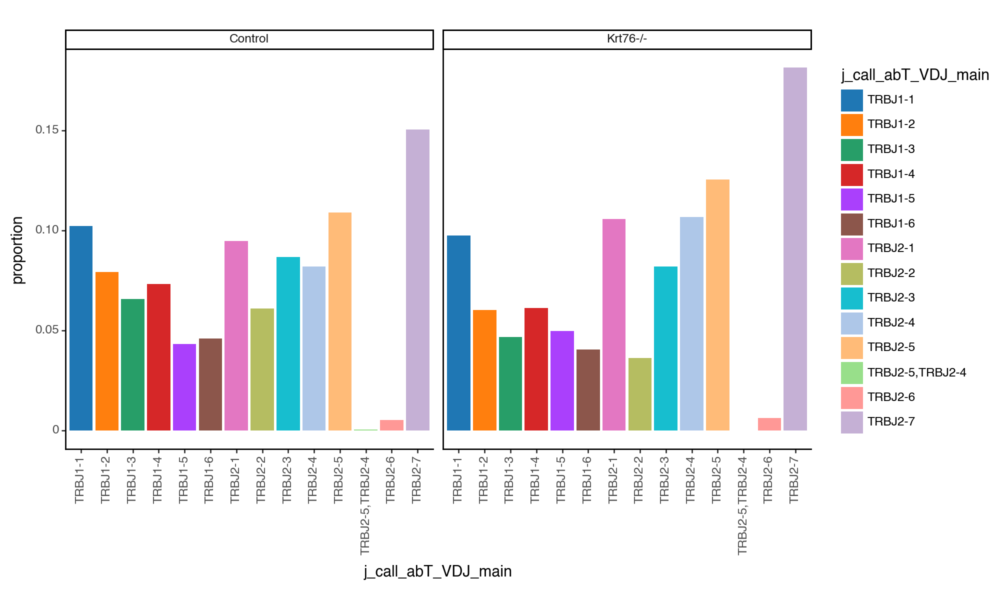

<Figure Size: (1000 x 600)>

In [953]:
options.figure_size = (10, 6)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VDJ_main", y="proportion", fill="j_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DP2 - J gene Beta chain

In [954]:
adata_PF_DP2 = adata_PF[adata_PF.obs["leiden"] == "9 DP 2"]

In [955]:
adata_PF_DP2

View of AnnData object with n_obs × n_vars = 96 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [956]:
working_df = pd.DataFrame(adata_PF_DP2.obs.groupby("Sample")["j_call_abT_VDJ_main"].value_counts())
working_df

j_call_abT_VDJ_main
Sample   j_call_abT_VDJ_main                     
Control  TRBJ2-7                               10
         TRBJ1-4                                8
         TRBJ2-1                                8
         TRBJ2-5                                7
         TRBJ1-1                                5
         TRBJ2-2                                5
         TRBJ2-3                                5
         TRBJ2-4                                5
         TRBJ1-2                                4
         TRBJ1-6                                3
         TRBJ1-3                                2
         TRBJ1-5                                2
Krt76-/- TRBJ2-5                                8
         TRBJ2-3                                6
         TRBJ2-7                                5
         TRBJ1-1                                4
         TRBJ1-4                                2
         TRBJ2-2                                2
         TRBJ2-4                                2
         TRBJ1-2                                1
         TRBJ1-3                                1
         TRBJ1-6                                1
         TRBJ1-5                                0
         TRBJ2-1                                0

In [957]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VDJ_main,counts
0,Control,TRBJ2-7,10
1,Control,TRBJ1-4,8
2,Control,TRBJ2-1,8
3,Control,TRBJ2-5,7
4,Control,TRBJ1-1,5
5,Control,TRBJ2-2,5
6,Control,TRBJ2-3,5
7,Control,TRBJ2-4,5
8,Control,TRBJ1-2,4
9,Control,TRBJ1-6,3


In [958]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 64, 'Krt76-/-': 32}

In [959]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [960]:
working_df

,Sample,j_call_abT_VDJ_main,counts,proportion
0,Control,TRBJ2-7,10,0.156250
1,Control,TRBJ1-4,8,0.125000
2,Control,TRBJ2-1,8,0.125000
3,Control,TRBJ2-5,7,0.109375
4,Control,TRBJ1-1,5,0.078125
5,Control,TRBJ2-2,5,0.078125
6,Control,TRBJ2-3,5,0.078125
7,Control,TRBJ2-4,5,0.078125
8,Control,TRBJ1-2,4,0.062500
9,Control,TRBJ1-6,3,0.046875


In [961]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [962]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

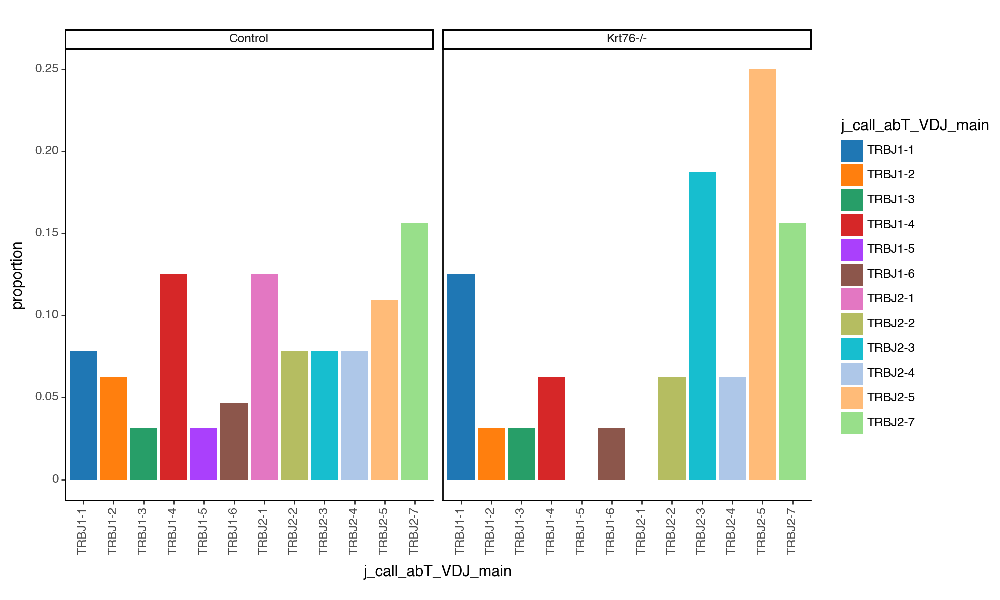

<Figure Size: (1000 x 600)>

In [963]:
options.figure_size = (10, 6)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VDJ_main", y="proportion", fill="j_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### SP & DP - J gene beta chain

In [964]:
adata_PF_SPDP = adata_PF[adata_PF.obs["leiden"] == "5 SP & DP"]

In [965]:
adata_PF_SPDP

View of AnnData object with n_obs × n_vars = 865 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [966]:
working_df = pd.DataFrame(adata_PF_SPDP.obs.groupby("Sample")["j_call_abT_VDJ_main"].value_counts())
working_df

j_call_abT_VDJ_main
Sample   j_call_abT_VDJ_main                         
Control  TRBJ2-7                                  132
         TRBJ2-1                                   79
         TRBJ2-4                                   65
         TRBJ2-5                                   59
         TRBJ1-1                                   54
         TRBJ2-3                                   44
         TRBJ1-4                                   31
         TRBJ2-2                                   30
         TRBJ1-3                                   27
         TRBJ1-2                                   21
         TRBJ1-5                                   18
         TRBJ1-6                                   13
         TRBJ2-6                                    4
         TRBJ1-6,TRBJ2-7,TRBJ2-2                    0
Krt76-/- TRBJ2-7                                   73
         TRBJ2-1                                   35
         TRBJ2-4                                   30
         TRBJ2-5                                   29
         TRBJ1-1                                   26
         TRBJ2-3                                   19
         TRBJ1-3                                   18
         TRBJ1-2                                   15
         TRBJ1-4                                   13
         TRBJ2-2                                   12
         TRBJ1-5                                    9
         TRBJ1-6                                    7
         TRBJ1-6,TRBJ2-7,TRBJ2-2                    1
         TRBJ2-6                                    1

In [967]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VDJ_main,counts
0,Control,TRBJ2-7,132
1,Control,TRBJ2-1,79
2,Control,TRBJ2-4,65
3,Control,TRBJ2-5,59
4,Control,TRBJ1-1,54
5,Control,TRBJ2-3,44
6,Control,TRBJ1-4,31
7,Control,TRBJ2-2,30
8,Control,TRBJ1-3,27
9,Control,TRBJ1-2,21


In [968]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 577, 'Krt76-/-': 288}

In [969]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [970]:
working_df

,Sample,j_call_abT_VDJ_main,counts,proportion
0,Control,TRBJ2-7,132,0.228769
1,Control,TRBJ2-1,79,0.136915
2,Control,TRBJ2-4,65,0.112652
3,Control,TRBJ2-5,59,0.102253
4,Control,TRBJ1-1,54,0.093588
5,Control,TRBJ2-3,44,0.076256
6,Control,TRBJ1-4,31,0.053726
7,Control,TRBJ2-2,30,0.051993
8,Control,TRBJ1-3,27,0.046794
9,Control,TRBJ1-2,21,0.036395


In [971]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [972]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

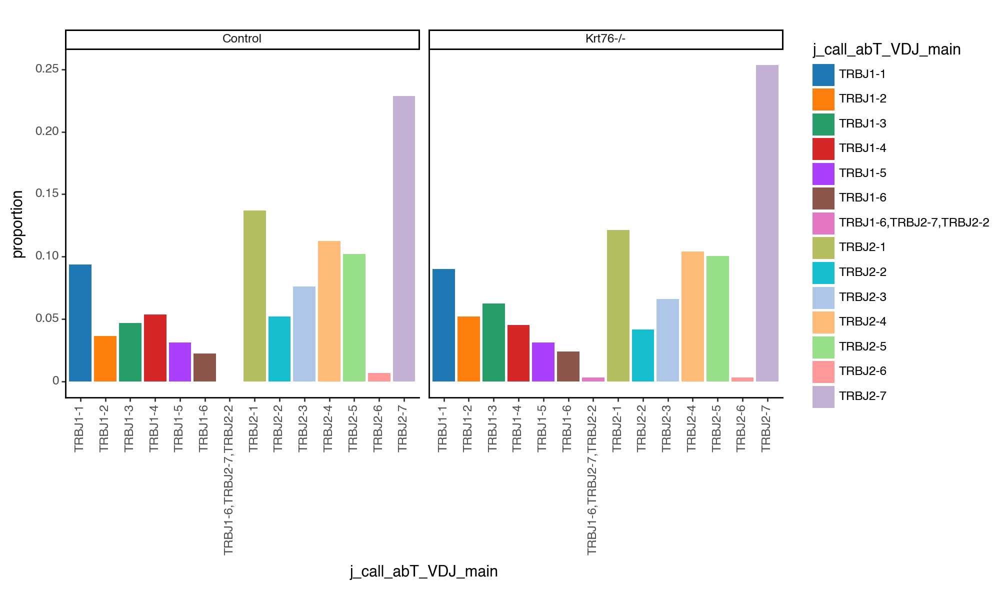

<Figure Size: (1000 x 600)>

In [973]:
options.figure_size = (10, 6)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VDJ_main", y="proportion", fill="j_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### TCRgd - J gene beta chain

In [974]:
adata_PF_gd = adata_PF[adata_PF.obs["leiden"] == "8 TCRgd"]

In [975]:
adata_PF_gd

View of AnnData object with n_obs × n_vars = 62 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [976]:
working_df = pd.DataFrame(adata_PF_gd.obs.groupby("Sample")["j_call_abT_VDJ_main"].value_counts())
working_df

j_call_abT_VDJ_main
Sample   j_call_abT_VDJ_main                     
Control  TRBJ2-1                                8
         TRBJ1-2                                7
         TRBJ2-7                                6
         TRBJ1-6                                4
         TRBJ2-5                                4
         TRBJ1-1                                3
         TRBJ1-4                                3
         TRBJ2-4                                3
         TRBJ1-5                                2
         TRBJ1-3                                1
         TRBJ2-2                                1
         TRBJ2-3                                1
Krt76-/- TRBJ2-7                                5
         TRBJ2-1                                3
         TRBJ2-3                                3
         TRBJ1-1                                2
         TRBJ2-4                                2
         TRBJ1-2                                1
         TRBJ1-4                                1
         TRBJ1-5                                1
         TRBJ2-5                                1
         TRBJ1-3                                0
         TRBJ1-6                                0
         TRBJ2-2                                0

In [977]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VDJ_main,counts
0,Control,TRBJ2-1,8
1,Control,TRBJ1-2,7
2,Control,TRBJ2-7,6
3,Control,TRBJ1-6,4
4,Control,TRBJ2-5,4
5,Control,TRBJ1-1,3
6,Control,TRBJ1-4,3
7,Control,TRBJ2-4,3
8,Control,TRBJ1-5,2
9,Control,TRBJ1-3,1


In [978]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 43, 'Krt76-/-': 19}

In [979]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [980]:
working_df

,Sample,j_call_abT_VDJ_main,counts,proportion
0,Control,TRBJ2-1,8,0.186047
1,Control,TRBJ1-2,7,0.162791
2,Control,TRBJ2-7,6,0.139535
3,Control,TRBJ1-6,4,0.093023
4,Control,TRBJ2-5,4,0.093023
5,Control,TRBJ1-1,3,0.069767
6,Control,TRBJ1-4,3,0.069767
7,Control,TRBJ2-4,3,0.069767
8,Control,TRBJ1-5,2,0.046512
9,Control,TRBJ1-3,1,0.023256


In [981]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [982]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

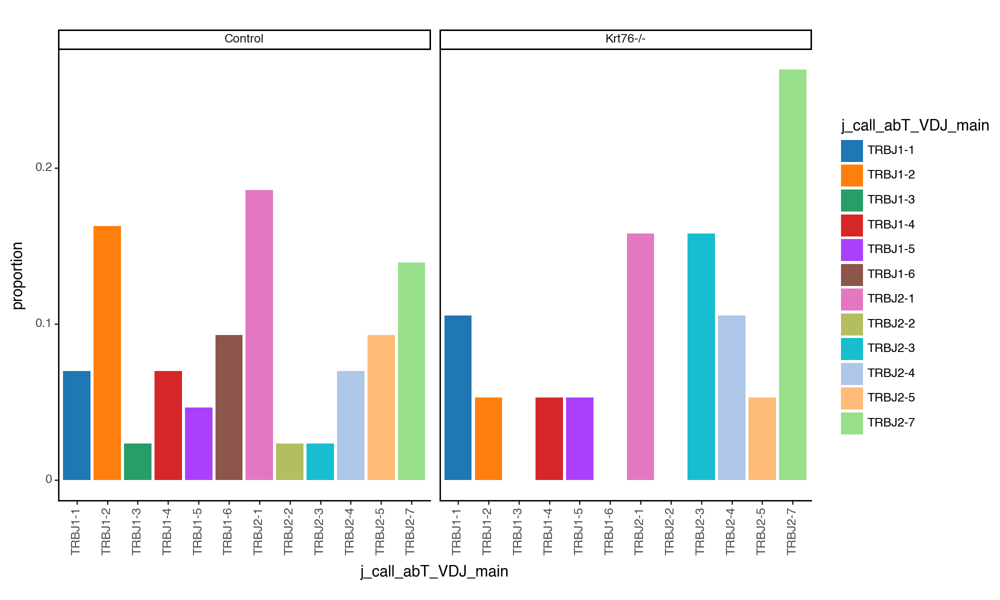

<Figure Size: (1000 x 600)>

In [983]:
options.figure_size = (10, 6)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VDJ_main", y="proportion", fill="j_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### NKT/ NK/ Tregs - J gene beta chain

In [984]:
adata_PF_NK = adata_PF[adata_PF.obs["leiden"] == "11 NKT / NK / Tregs"]

In [985]:
adata_PF_NK

View of AnnData object with n_obs × n_vars = 147 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [986]:
working_df = pd.DataFrame(adata_PF_NK.obs.groupby("Sample")["j_call_abT_VDJ_main"].value_counts())
working_df

j_call_abT_VDJ_main
Sample   j_call_abT_VDJ_main                     
Control  TRBJ2-7                               27
         TRBJ2-1                               16
         TRBJ2-4                               13
         TRBJ1-1                               10
         TRBJ1-2                                8
         TRBJ2-5                                8
         TRBJ1-6                                7
         TRBJ2-2                                7
         TRBJ1-3                                5
         TRBJ2-3                                4
         TRBJ1-4                                3
         TRBJ1-5                                3
         TRBJ2-6                                1
Krt76-/- TRBJ2-7                                6
         TRBJ1-1                                5
         TRBJ1-2                                5
         TRBJ2-3                                4
         TRBJ2-4                                4
         TRBJ1-3                                3
         TRBJ2-5                                3
         TRBJ2-1                                2
         TRBJ2-2                                2
         TRBJ1-4                                1
         TRBJ1-5                                0
         TRBJ1-6                                0
         TRBJ2-6                                0

In [987]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VDJ_main,counts
0,Control,TRBJ2-7,27
1,Control,TRBJ2-1,16
2,Control,TRBJ2-4,13
3,Control,TRBJ1-1,10
4,Control,TRBJ1-2,8
5,Control,TRBJ2-5,8
6,Control,TRBJ1-6,7
7,Control,TRBJ2-2,7
8,Control,TRBJ1-3,5
9,Control,TRBJ2-3,4


In [988]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 112, 'Krt76-/-': 35}

In [989]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [990]:
working_df

,Sample,j_call_abT_VDJ_main,counts,proportion
0,Control,TRBJ2-7,27,0.241071
1,Control,TRBJ2-1,16,0.142857
2,Control,TRBJ2-4,13,0.116071
3,Control,TRBJ1-1,10,0.089286
4,Control,TRBJ1-2,8,0.071429
5,Control,TRBJ2-5,8,0.071429
6,Control,TRBJ1-6,7,0.062500
7,Control,TRBJ2-2,7,0.062500
8,Control,TRBJ1-3,5,0.044643
9,Control,TRBJ2-3,4,0.035714


In [991]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [992]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

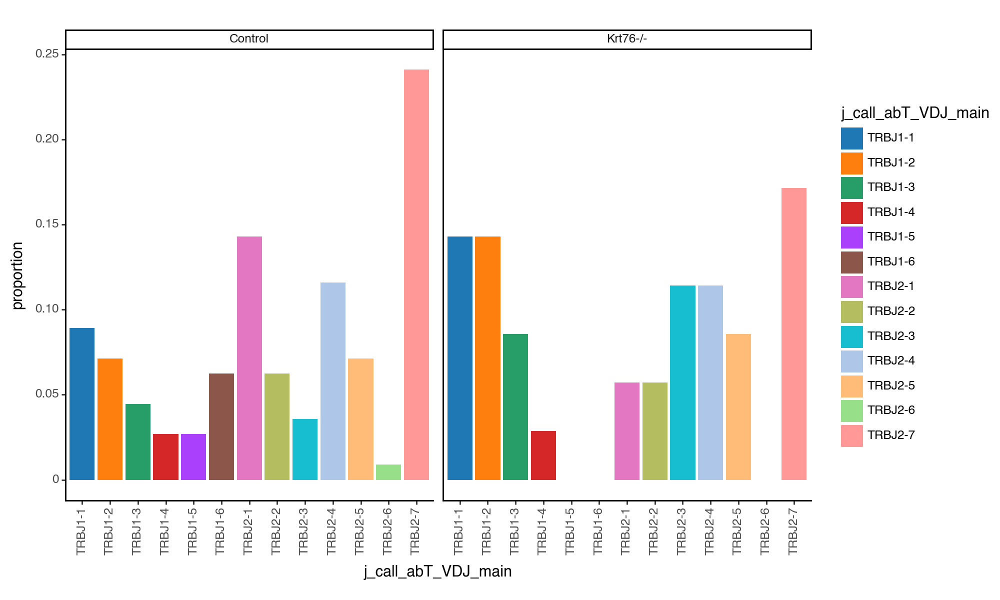

<Figure Size: (1000 x 600)>

In [993]:
options.figure_size = (10, 6)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VDJ_main", y="proportion", fill="j_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

## PRODUCTIVE  -  Split between control vs KO?? V GENE ALPHA CHAIN

In [1305]:
adata_PF = adata_P[adata_P.obs["v_call_abT_VJ_main"] != "None"]
adata_PF = adata_PF[adata_PF.obs["v_call_abT_VJ_main"] != "No_contig"]

In [1306]:
pd.crosstab(adata_PF.obs['Sample'], adata_PF.obs['leiden'])

leiden,0 DN3a,1 DN3a / DN3b,2 DN4,3 DP 1,4 DN2b 2,5 SP & DP,6 DN3b,7 DN2a,8 TCRgd,9 DP 2,10 DN3,11 NKT / NK / Tregs,12 DN2b 1
Sample,,,,,,,,,,,,,
Control,20,26,188,454,55,536,15,12,10,10,6,109,3
Krt76-/-,15,17,205,469,40,276,12,5,3,7,2,30,5


### DN2a - V gene beta chain

In [995]:
adata_PF_DN2a = adata_PF[adata_PF.obs["leiden"] == "7 DN2a"]

In [996]:
adata_PF_DN2a

View of AnnData object with n_obs × n_vars = 17 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [997]:
working_df = pd.DataFrame(adata_PF_DN2a.obs.groupby("Sample")["v_call_abT_VJ_main"].value_counts())
working_df

v_call_abT_VJ_main
Sample   v_call_abT_VJ_main                              
Control  TRAV4D-3,TRAV4-3                               2
         TRAV13N-2,TRAV13-2,TRAV13D-2                   2
         TRAV4D-4,TRAV4-4/DV10                          1
         TRAV6D-3                                       1
         TRAV7-2,TRAV7D-2                               1
         TRAV7D-4,TRAV7-4                               1
         TRAV9-4,TRAV9D-3                               1
         TRAV12-1,TRAV12D-1                             1
         TRAV12-2,TRAV12D-2                             1
         TRAV12N-3,TRAV12D-3                            1
         TRAV4-4/DV10                                   0
         TRAV6-7/DV9                                    0
         TRAV14-3,TRAV14D-3/DV8                         0
Krt76-/- TRAV4-4/DV10                                   1
         TRAV6-7/DV9                                    1
         TRAV12-2,TRAV12D-2                             1
         TRAV13N-2,TRAV13-2,TRAV13D-2                   1
         TRAV14-3,TRAV14D-3/DV8                         1
         TRAV4D-3,TRAV4-3                               0
         TRAV4D-4,TRAV4-4/DV10                          0
         TRAV6D-3                                       0
         TRAV7-2,TRAV7D-2                               0
         TRAV7D-4,TRAV7-4                               0
         TRAV9-4,TRAV9D-3                               0
         TRAV12-1,TRAV12D-1                             0
         TRAV12N-3,TRAV12D-3                            0

In [998]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VJ_main,counts
0,Control,"TRAV4D-3,TRAV4-3",2
1,Control,"TRAV13N-2,TRAV13-2,TRAV13D-2",2
2,Control,"TRAV4D-4,TRAV4-4/DV10",1
3,Control,TRAV6D-3,1
4,Control,"TRAV7-2,TRAV7D-2",1
5,Control,"TRAV7D-4,TRAV7-4",1
6,Control,"TRAV9-4,TRAV9D-3",1
7,Control,"TRAV12-1,TRAV12D-1",1
8,Control,"TRAV12-2,TRAV12D-2",1
9,Control,"TRAV12N-3,TRAV12D-3",1


In [999]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 12, 'Krt76-/-': 5}

In [1000]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1001]:
working_df

,Sample,v_call_abT_VJ_main,counts,proportion
0,Control,"TRAV4D-3,TRAV4-3",2,0.166667
1,Control,"TRAV13N-2,TRAV13-2,TRAV13D-2",2,0.166667
2,Control,"TRAV4D-4,TRAV4-4/DV10",1,0.083333
3,Control,TRAV6D-3,1,0.083333
4,Control,"TRAV7-2,TRAV7D-2",1,0.083333
5,Control,"TRAV7D-4,TRAV7-4",1,0.083333
6,Control,"TRAV9-4,TRAV9D-3",1,0.083333
7,Control,"TRAV12-1,TRAV12D-1",1,0.083333
8,Control,"TRAV12-2,TRAV12D-2",1,0.083333
9,Control,"TRAV12N-3,TRAV12D-3",1,0.083333


In [1002]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1003]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

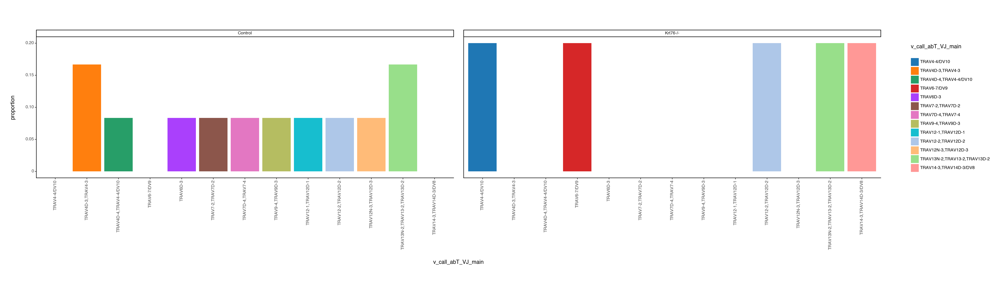

<Figure Size: (2800 x 800)>

In [1004]:
options.figure_size = (28, 8)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VJ_main", y="proportion", fill="v_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN2b1 - V gene Alpha chain

In [1005]:
adata_PF_DN2b1 = adata_PF[adata_PF.obs["leiden"] == "12 DN2b 1"]

In [1006]:
adata_PF_DN2b1

View of AnnData object with n_obs × n_vars = 8 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', '

In [1007]:
working_df = pd.DataFrame(adata_PF_DN2b1.obs.groupby("Sample")["v_call_abT_VJ_main"].value_counts())
working_df

v_call_abT_VJ_main
Sample   v_call_abT_VJ_main                     
Control  TRAV4-4/DV10                          1
         TRAV12-2,TRAV12D-2                    1
         TRAV13-1                              1
         TRAV9N-4                              0
         TRAV13-4/DV7                          0
         TRAV14-2                              0
         TRAV16,TRAV16D/DV11                   0
Krt76-/- TRAV9N-4                              1
         TRAV13-1                              1
         TRAV13-4/DV7                          1
         TRAV14-2                              1
         TRAV16,TRAV16D/DV11                   1
         TRAV4-4/DV10                          0
         TRAV12-2,TRAV12D-2                    0

In [1008]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VJ_main,counts
0,Control,TRAV4-4/DV10,1
1,Control,"TRAV12-2,TRAV12D-2",1
2,Control,TRAV13-1,1
3,Control,TRAV9N-4,0
4,Control,TRAV13-4/DV7,0
5,Control,TRAV14-2,0
6,Control,"TRAV16,TRAV16D/DV11",0
7,Krt76-/-,TRAV9N-4,1
8,Krt76-/-,TRAV13-1,1
9,Krt76-/-,TRAV13-4/DV7,1


In [1009]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 3, 'Krt76-/-': 5}

In [1010]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1011]:
working_df

,Sample,v_call_abT_VJ_main,counts,proportion
0,Control,TRAV4-4/DV10,1,0.333333
1,Control,"TRAV12-2,TRAV12D-2",1,0.333333
2,Control,TRAV13-1,1,0.333333
3,Control,TRAV9N-4,0,0.000000
4,Control,TRAV13-4/DV7,0,0.000000
5,Control,TRAV14-2,0,0.000000
6,Control,"TRAV16,TRAV16D/DV11",0,0.000000
7,Krt76-/-,TRAV9N-4,1,0.200000
8,Krt76-/-,TRAV13-1,1,0.200000
9,Krt76-/-,TRAV13-4/DV7,1,0.200000


In [1012]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1013]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

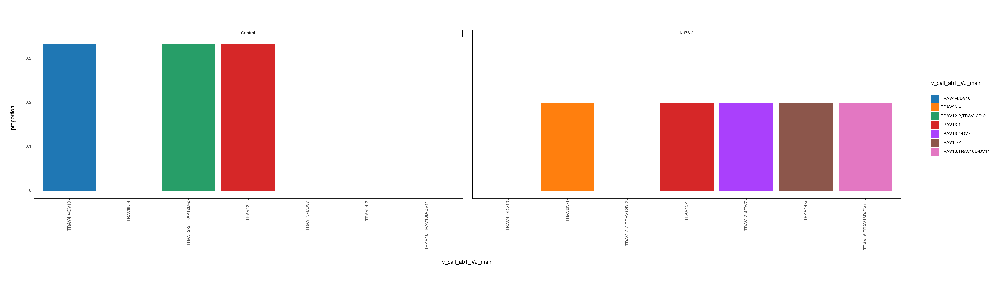

<Figure Size: (2800 x 800)>

In [1014]:
options.figure_size = (28, 8)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VJ_main", y="proportion", fill="v_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN2b2 - V gene alpha chain

In [1015]:
adata_PF_DN2b2 = adata_PF[adata_PF.obs["leiden"] == "4 DN2b 2"]

In [1016]:
adata_PF_DN2b2

View of AnnData object with n_obs × n_vars = 95 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [1017]:
working_df = pd.DataFrame(adata_PF_DN2b2.obs.groupby("Sample")["v_call_abT_VJ_main"].value_counts())
working_df

v_call_abT_VJ_main
Sample   v_call_abT_VJ_main                     
Control  TRAV4N-4,TRAV4D-4                    11
         TRAV16,TRAV16D/DV11                   5
         TRAV13-1                              4
         TRAV5-1                               3
         TRAV10                                3
...                                          ...
Krt76-/- TRAV6N-6                              0
         TRAV10N                               0
         TRAV7-2,TRAV7D-2                      0
         TRAV9D-1                              0
         TRAV13-1                              0

[92 rows x 1 columns]

In [1018]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VJ_main,counts
0,Control,"TRAV4N-4,TRAV4D-4",11
1,Control,"TRAV16,TRAV16D/DV11",5
2,Control,TRAV13-1,4
3,Control,TRAV5-1,3
4,Control,TRAV10,3
...,...,...,...
87,Krt76-/-,TRAV6N-6,0
88,Krt76-/-,TRAV10N,0
89,Krt76-/-,"TRAV7-2,TRAV7D-2",0
90,Krt76-/-,TRAV9D-1,0


In [1019]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 55, 'Krt76-/-': 40}

In [1020]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1021]:
working_df

,Sample,v_call_abT_VJ_main,counts,proportion
0,Control,"TRAV4N-4,TRAV4D-4",11,0.200000
1,Control,"TRAV16,TRAV16D/DV11",5,0.090909
2,Control,TRAV13-1,4,0.072727
3,Control,TRAV5-1,3,0.054545
4,Control,TRAV10,3,0.054545
...,...,...,...,...
87,Krt76-/-,TRAV6N-6,0,0.000000
88,Krt76-/-,TRAV10N,0,0.000000
89,Krt76-/-,"TRAV7-2,TRAV7D-2",0,0.000000
90,Krt76-/-,TRAV9D-1,0,0.000000


In [1022]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1023]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

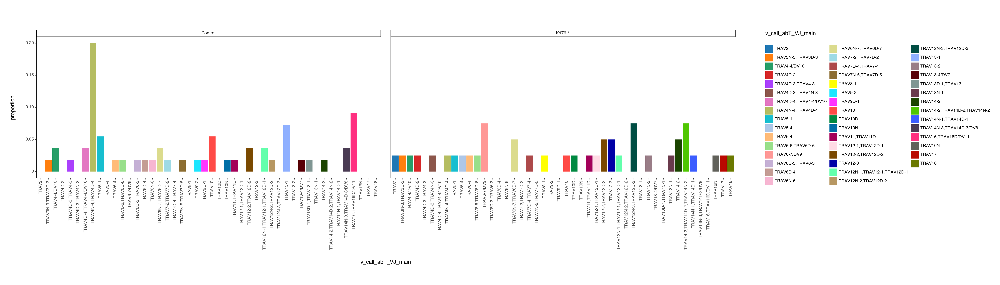

<Figure Size: (2800 x 800)>

In [1024]:
options.figure_size = (28, 8)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VJ_main", y="proportion", fill="v_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN3 - V gene alpha chain

In [1025]:
adata_PF_DN3 = adata_PF[adata_PF.obs["leiden"] == "10 DN3"]

In [1026]:
adata_PF_DN3

View of AnnData object with n_obs × n_vars = 8 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', '

In [1027]:
working_df = pd.DataFrame(adata_PF_DN3.obs.groupby("Sample")["v_call_abT_VJ_main"].value_counts())
working_df

v_call_abT_VJ_main
Sample   v_call_abT_VJ_main                                 
Control  TRAV1                                             1
         TRAV5-4                                           1
         TRAV7-1                                           1
         TRAV8D-2                                          1
         TRAV12-1,TRAV12D-1                                1
         TRAV12-3                                          1
         TRAV13-2                                          0
         TRAV15-2/DV6-2,TRAV15D-2/DV6D-2                   0
Krt76-/- TRAV13-2                                          1
         TRAV15-2/DV6-2,TRAV15D-2/DV6D-2                   1
         TRAV1                                             0
         TRAV5-4                                           0
         TRAV7-1                                           0
         TRAV8D-2                                          0
         TRAV12-1,TRAV12D-1                                0
         TRAV12-3                                          0

In [1028]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VJ_main,counts
0,Control,TRAV1,1
1,Control,TRAV5-4,1
2,Control,TRAV7-1,1
3,Control,TRAV8D-2,1
4,Control,"TRAV12-1,TRAV12D-1",1
5,Control,TRAV12-3,1
6,Control,TRAV13-2,0
7,Control,"TRAV15-2/DV6-2,TRAV15D-2/DV6D-2",0
8,Krt76-/-,TRAV13-2,1
9,Krt76-/-,"TRAV15-2/DV6-2,TRAV15D-2/DV6D-2",1


In [1029]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 6, 'Krt76-/-': 2}

In [1030]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1031]:
working_df

,Sample,v_call_abT_VJ_main,counts,proportion
0,Control,TRAV1,1,0.166667
1,Control,TRAV5-4,1,0.166667
2,Control,TRAV7-1,1,0.166667
3,Control,TRAV8D-2,1,0.166667
4,Control,"TRAV12-1,TRAV12D-1",1,0.166667
5,Control,TRAV12-3,1,0.166667
6,Control,TRAV13-2,0,0.000000
7,Control,"TRAV15-2/DV6-2,TRAV15D-2/DV6D-2",0,0.000000
8,Krt76-/-,TRAV13-2,1,0.500000
9,Krt76-/-,"TRAV15-2/DV6-2,TRAV15D-2/DV6D-2",1,0.500000


In [1032]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1033]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

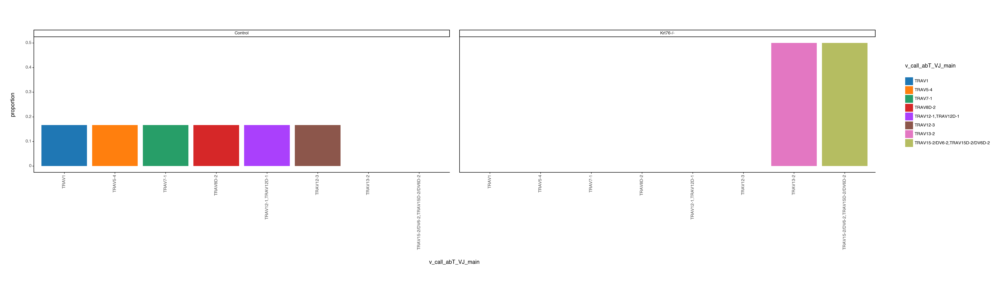

<Figure Size: (2800 x 800)>

In [1034]:
options.figure_size = (28, 8)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VJ_main", y="proportion", fill="v_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN3a - V gene alpha chain

In [1035]:
adata_PF_DN3a = adata_PF[adata_PF.obs["leiden"] == "0 DN3a"]

In [1036]:
adata_PF_DN3a

View of AnnData object with n_obs × n_vars = 35 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [1037]:
working_df = pd.DataFrame(adata_PF_DN3a.obs.groupby("Sample")["v_call_abT_VJ_main"].value_counts())
working_df

v_call_abT_VJ_main
Sample   v_call_abT_VJ_main                         
Control  TRAV6N-7,TRAV6D-7                         2
         TRAV1                                     1
         TRAV7-3                                   1
         TRAV14N-3,TRAV14D-3/DV8                   1
         TRAV13N-2,TRAV13D-2                       1
         TRAV13D-1                                 1
         TRAV13-1                                  1
         TRAV12N-2,TRAV12D-2                       1
         TRAV10N                                   1
         TRAV10                                    1
         TRAV9N-4                                  1
         TRAV7D-4                                  1
         TRAV8-1                                   1
         TRAV7-2,TRAV7D-2                          1
         TRAV6-5                                   1
         TRAV4N-4,TRAV4D-4                         1
         TRAV4D-3,TRAV4N-3                         1
         TRAV4D-3,TRAV4-3                          1
         TRAV15-2/DV6-2                            1
         TRAV4-2                                   0
         TRAV9D-2,TRAV9N-2                         0
         TRAV6N-6                                  0
         TRAV6D-3                                  0
         TRAV6-1                                   0
         TRAV5-1                                   0
         TRAV13-2                                  0
         TRAV13N-1                                 0
         TRAV14N-1,TRAV14D-1                       0
Krt76-/- TRAV13-1                                  2
         TRAV13-2                                  2
         TRAV6N-6                                  1
         TRAV4D-3,TRAV4-3                          1
         TRAV9N-4                                  1
         TRAV14N-1,TRAV14D-1                       1
         TRAV5-1                                   1
         TRAV6-1                                   1
         TRAV9D-2,TRAV9N-2                         1
         TRAV6D-3                                  1
         TRAV10N                                   1
         TRAV13N-1                                 1
         TRAV4-2                                   1
         TRAV1                                     0
         TRAV13D-1                                 0
         TRAV13N-2,TRAV13D-2                       0
         TRAV14N-3,TRAV14D-3/DV8                   0
         TRAV12N-2,TRAV12D-2                       0
         TRAV8-1                                   0
         TRAV10                                    0
         TRAV7D-4                                  0
         TRAV7-3                                   0
         TRAV7-2,TRAV7D-2                          0
         TRAV6N-7,TRAV6D-7                         0
         TRAV6-5                                   0
         TRAV4N-4,TRAV4D-4                         0
         TRAV4D-3,TRAV4N-3                         0
         TRAV15-2/DV6-2                            0

In [1038]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VJ_main,counts
0,Control,"TRAV6N-7,TRAV6D-7",2
1,Control,TRAV1,1
2,Control,TRAV7-3,1
3,Control,"TRAV14N-3,TRAV14D-3/DV8",1
4,Control,"TRAV13N-2,TRAV13D-2",1
5,Control,TRAV13D-1,1
6,Control,TRAV13-1,1
7,Control,"TRAV12N-2,TRAV12D-2",1
8,Control,TRAV10N,1
9,Control,TRAV10,1


In [1039]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 20, 'Krt76-/-': 15}

In [1040]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1041]:
working_df

,Sample,v_call_abT_VJ_main,counts,proportion
0,Control,"TRAV6N-7,TRAV6D-7",2,0.100000
1,Control,TRAV1,1,0.050000
2,Control,TRAV7-3,1,0.050000
3,Control,"TRAV14N-3,TRAV14D-3/DV8",1,0.050000
4,Control,"TRAV13N-2,TRAV13D-2",1,0.050000
5,Control,TRAV13D-1,1,0.050000
6,Control,TRAV13-1,1,0.050000
7,Control,"TRAV12N-2,TRAV12D-2",1,0.050000
8,Control,TRAV10N,1,0.050000
9,Control,TRAV10,1,0.050000


In [1042]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1043]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

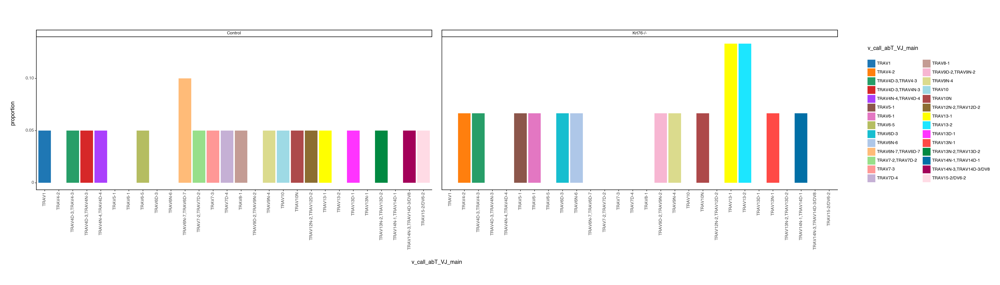

<Figure Size: (2800 x 800)>

In [1044]:
options.figure_size = (28, 8)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VJ_main", y="proportion", fill="v_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN3ab - V gene alpha chain

In [1045]:
adata_PF_DN3ab = adata_PF[adata_PF.obs["leiden"] == "1 DN3a / DN3b"]

In [1046]:
adata_PF_DN3ab

View of AnnData object with n_obs × n_vars = 43 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [1047]:
working_df = pd.DataFrame(adata_PF_DN3ab.obs.groupby("Sample")["v_call_abT_VJ_main"].value_counts())
working_df

v_call_abT_VJ_main
Sample   v_call_abT_VJ_main                            
Control  TRAV4D-3,TRAV4N-3                            2
         TRAV3N-3,TRAV3D-3                            2
         TRAV3-3                                      1
         TRAV7D-4,TRAV7-4                             1
         TRAV15D-2/DV6D-2,TRAV15N-2                   1
...                                                 ...
Krt76-/- TRAV5-4                                      0
         TRAV5-1                                      0
         TRAV4D-3,TRAV4N-3                            0
         TRAV4-4/DV10                                 0
         TRAV7N-4                                     0

[72 rows x 1 columns]

In [1048]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VJ_main,counts
0,Control,"TRAV4D-3,TRAV4N-3",2
1,Control,"TRAV3N-3,TRAV3D-3",2
2,Control,TRAV3-3,1
3,Control,"TRAV7D-4,TRAV7-4",1
4,Control,"TRAV15D-2/DV6D-2,TRAV15N-2",1
...,...,...,...
67,Krt76-/-,TRAV5-4,0
68,Krt76-/-,TRAV5-1,0
69,Krt76-/-,"TRAV4D-3,TRAV4N-3",0
70,Krt76-/-,TRAV4-4/DV10,0


In [1049]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 26, 'Krt76-/-': 17}

In [1050]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1051]:
working_df

,Sample,v_call_abT_VJ_main,counts,proportion
0,Control,"TRAV4D-3,TRAV4N-3",2,0.076923
1,Control,"TRAV3N-3,TRAV3D-3",2,0.076923
2,Control,TRAV3-3,1,0.038462
3,Control,"TRAV7D-4,TRAV7-4",1,0.038462
4,Control,"TRAV15D-2/DV6D-2,TRAV15N-2",1,0.038462
...,...,...,...,...
67,Krt76-/-,TRAV5-4,0,0.000000
68,Krt76-/-,TRAV5-1,0,0.000000
69,Krt76-/-,"TRAV4D-3,TRAV4N-3",0,0.000000
70,Krt76-/-,TRAV4-4/DV10,0,0.000000


In [1052]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1053]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

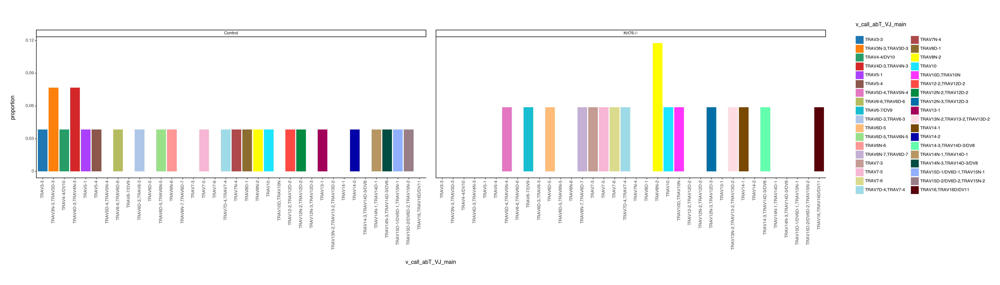

<Figure Size: (2800 x 800)>

In [1054]:
options.figure_size = (28, 8)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VJ_main", y="proportion", fill="v_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN3b - V gene alpha chain

In [1055]:
adata_PF_DN3b = adata_PF[adata_PF.obs["leiden"] == "6 DN3b"]

In [1056]:
adata_PF_DN3b

View of AnnData object with n_obs × n_vars = 27 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [1057]:
working_df = pd.DataFrame(adata_PF_DN3b.obs.groupby("Sample")["v_call_abT_VJ_main"].value_counts())
working_df

v_call_abT_VJ_main
Sample   v_call_abT_VJ_main                               
Control  TRAV7-5                                         2
         TRAV15D-2/DV6D-2,TRAV15N-2                      1
         TRAV7-1                                         1
         TRAV14-2                                        1
         TRAV10                                          1
         TRAV9-2                                         1
         TRAV3N-3,TRAV3D-3                               1
         TRAV6N-7,TRAV6D-7                               1
         TRAV6D-3,TRAV6-3                                1
         TRAV6-7/DV9,TRAV6N-7,TRAV6D-7                   1
         TRAV6-6,TRAV6D-6                                1
         TRAV6-4                                         1
         TRAV4D-3,TRAV4-3                                1
         TRAV13D-1,TRAV13-1                              1
         TRAV13N-2,TRAV13D-2                             0
         TRAV14N-1,TRAV14D-1                             0
         TRAV14-3,TRAV14D-3/DV8                          0
         TRAV1                                           0
         TRAV12N-2,TRAV12D-2                             0
         TRAV11,TRAV11D                                  0
         TRAV4N-4,TRAV4D-4                               0
         TRAV7-6                                         0
Krt76-/- TRAV11,TRAV11D                                  2
         TRAV1                                           1
         TRAV3N-3,TRAV3D-3                               1
         TRAV14N-1,TRAV14D-1                             1
         TRAV14-3,TRAV14D-3/DV8                          1
         TRAV13N-2,TRAV13D-2                             1
         TRAV12N-2,TRAV12D-2                             1
         TRAV10                                          1
         TRAV7-6                                         1
         TRAV6-6,TRAV6D-6                                1
         TRAV4N-4,TRAV4D-4                               1
         TRAV7-1                                         0
         TRAV7-5                                         0
         TRAV6N-7,TRAV6D-7                               0
         TRAV9-2                                         0
         TRAV6D-3,TRAV6-3                                0
         TRAV6-7/DV9,TRAV6N-7,TRAV6D-7                   0
         TRAV13D-1,TRAV13-1                              0
         TRAV6-4                                         0
         TRAV14-2                                        0
         TRAV4D-3,TRAV4-3                                0
         TRAV15D-2/DV6D-2,TRAV15N-2                      0

In [1058]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VJ_main,counts
0,Control,TRAV7-5,2
1,Control,"TRAV15D-2/DV6D-2,TRAV15N-2",1
2,Control,TRAV7-1,1
3,Control,TRAV14-2,1
4,Control,TRAV10,1
5,Control,TRAV9-2,1
6,Control,"TRAV3N-3,TRAV3D-3",1
7,Control,"TRAV6N-7,TRAV6D-7",1
8,Control,"TRAV6D-3,TRAV6-3",1
9,Control,"TRAV6-7/DV9,TRAV6N-7,TRAV6D-7",1


In [1059]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 15, 'Krt76-/-': 12}

In [1060]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1061]:
working_df

,Sample,v_call_abT_VJ_main,counts,proportion
0,Control,TRAV7-5,2,0.133333
1,Control,"TRAV15D-2/DV6D-2,TRAV15N-2",1,0.066667
2,Control,TRAV7-1,1,0.066667
3,Control,TRAV14-2,1,0.066667
4,Control,TRAV10,1,0.066667
5,Control,TRAV9-2,1,0.066667
6,Control,"TRAV3N-3,TRAV3D-3",1,0.066667
7,Control,"TRAV6N-7,TRAV6D-7",1,0.066667
8,Control,"TRAV6D-3,TRAV6-3",1,0.066667
9,Control,"TRAV6-7/DV9,TRAV6N-7,TRAV6D-7",1,0.066667


In [1062]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1063]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

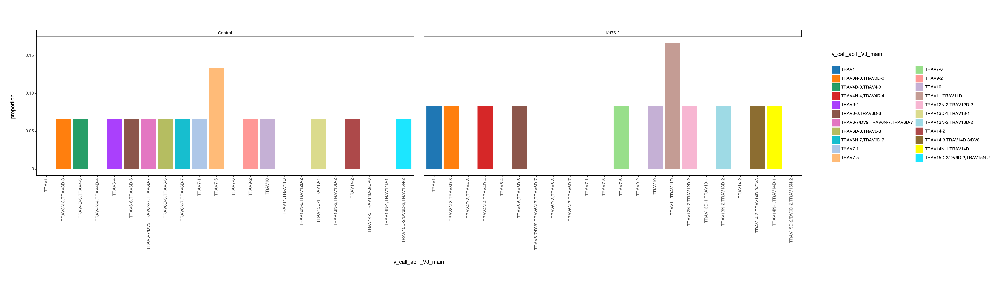

<Figure Size: (2800 x 800)>

In [1064]:
options.figure_size = (28, 8)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VJ_main", y="proportion", fill="v_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN4- V gene alpha chain

In [1065]:
adata_PF_DN4 = adata_PF[adata_PF.obs["leiden"] == "2 DN4"]

In [1066]:
adata_PF_DN4

View of AnnData object with n_obs × n_vars = 393 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [1067]:
working_df = pd.DataFrame(adata_PF_DN4.obs.groupby("Sample")["v_call_abT_VJ_main"].value_counts())
working_df

v_call_abT_VJ_main
Sample   v_call_abT_VJ_main                           
Control  TRAV6N-7,TRAV6D-7                          10
         TRAV12N-2,TRAV12D-2                         9
         TRAV13-1                                    9
         TRAV12N-3,TRAV12D-3                         8
         TRAV12-3                                    7
...                                                ...
Krt76-/- TRAV8D-2                                    0
         TRAV8D-2,TRAV8N-2                           0
         TRAV12D-2                                   0
         TRAV9-1,TRAV9D-1                            0
         TRAV6N-5,TRAV6D-5,TRAV6-5                   0

[174 rows x 1 columns]

In [1068]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VJ_main,counts
0,Control,"TRAV6N-7,TRAV6D-7",10
1,Control,"TRAV12N-2,TRAV12D-2",9
2,Control,TRAV13-1,9
3,Control,"TRAV12N-3,TRAV12D-3",8
4,Control,TRAV12-3,7
...,...,...,...
169,Krt76-/-,TRAV8D-2,0
170,Krt76-/-,"TRAV8D-2,TRAV8N-2",0
171,Krt76-/-,TRAV12D-2,0
172,Krt76-/-,"TRAV9-1,TRAV9D-1",0


In [1069]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 188, 'Krt76-/-': 205}

In [1070]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1071]:
working_df

,Sample,v_call_abT_VJ_main,counts,proportion
0,Control,"TRAV6N-7,TRAV6D-7",10,0.053191
1,Control,"TRAV12N-2,TRAV12D-2",9,0.047872
2,Control,TRAV13-1,9,0.047872
3,Control,"TRAV12N-3,TRAV12D-3",8,0.042553
4,Control,TRAV12-3,7,0.037234
...,...,...,...,...
169,Krt76-/-,TRAV8D-2,0,0.000000
170,Krt76-/-,"TRAV8D-2,TRAV8N-2",0,0.000000
171,Krt76-/-,TRAV12D-2,0,0.000000
172,Krt76-/-,"TRAV9-1,TRAV9D-1",0,0.000000


In [1072]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1073]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

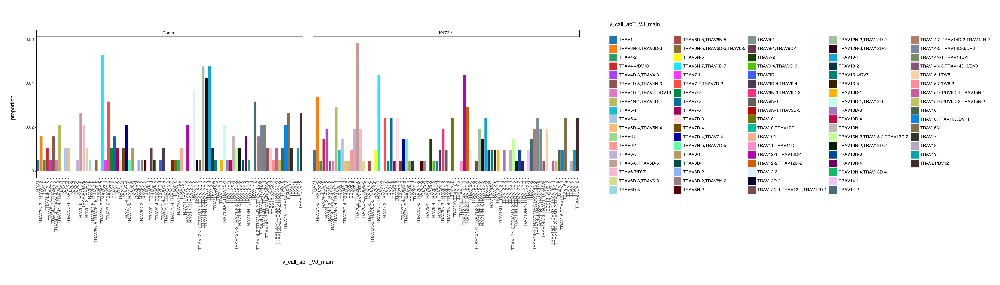

<Figure Size: (2800 x 800)>

In [1074]:
options.figure_size = (28,8)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VJ_main", y="proportion", fill="v_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### ALL DNs combined- V gene Alpha Chain

In [1075]:
#adatax_single2 = adatax_single[adatax_single.obs['clone_id_size_max_3'].isin (['1','2'])]
#adata_PF_DN3ab = adata_PF[adata_PF.obs["leiden"] == "1 DN3a / DN3b"]
adatax_PF_DNall = adata_PF[adata_PF.obs['leiden'].isin (['7 DN2a', '12 DN2b 1', '4 DN2b 2', '10 DN3', '0 DN3a', '1 DN3a / DN3b', '6 DN3b', '2 DN4'])]

In [1076]:
adatax_PF_DNall.obs['leiden'].value_counts()

2 DN4            393
4 DN2b 2          95
1 DN3a / DN3b     43
0 DN3a            35
6 DN3b            27
7 DN2a            17
10 DN3             8
12 DN2b 1          8
Name: leiden, dtype: int64

In [1077]:
working_df = pd.DataFrame(adatax_PF_DNall.obs.groupby("Sample")["v_call_abT_VJ_main"].value_counts())
working_df

v_call_abT_VJ_main
Sample   v_call_abT_VJ_main                     
Control  TRAV4N-4,TRAV4D-4                    16
         TRAV13-1                             16
         TRAV6N-7,TRAV6D-7                    15
         TRAV12N-2,TRAV12D-2                  12
         TRAV14-2                              9
...                                          ...
Krt76-/- TRAV10,TRAV10D                        0
         TRAV13D-1,TRAV13-1                    0
         TRAV12D-2                             0
         TRAV7-1                               0
         TRAV8D-2                              0

[198 rows x 1 columns]

In [1078]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VJ_main,counts
0,Control,"TRAV4N-4,TRAV4D-4",16
1,Control,TRAV13-1,16
2,Control,"TRAV6N-7,TRAV6D-7",15
3,Control,"TRAV12N-2,TRAV12D-2",12
4,Control,TRAV14-2,9
...,...,...,...
193,Krt76-/-,"TRAV10,TRAV10D",0
194,Krt76-/-,"TRAV13D-1,TRAV13-1",0
195,Krt76-/-,TRAV12D-2,0
196,Krt76-/-,TRAV7-1,0


In [1079]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 325, 'Krt76-/-': 301}

In [1080]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1081]:
working_df

,Sample,v_call_abT_VJ_main,counts,proportion
0,Control,"TRAV4N-4,TRAV4D-4",16,0.049231
1,Control,TRAV13-1,16,0.049231
2,Control,"TRAV6N-7,TRAV6D-7",15,0.046154
3,Control,"TRAV12N-2,TRAV12D-2",12,0.036923
4,Control,TRAV14-2,9,0.027692
...,...,...,...,...
193,Krt76-/-,"TRAV10,TRAV10D",0,0.000000
194,Krt76-/-,"TRAV13D-1,TRAV13-1",0,0.000000
195,Krt76-/-,TRAV12D-2,0,0.000000
196,Krt76-/-,TRAV7-1,0,0.000000


In [1082]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1083]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

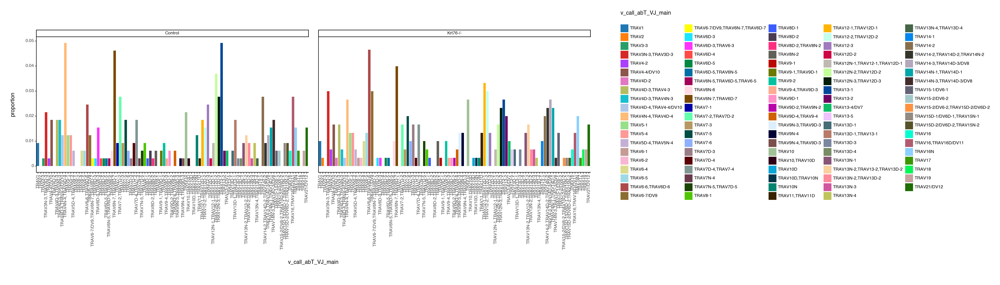

<Figure Size: (2800 x 800)>

In [1084]:
options.figure_size = (28, 8)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VJ_main", y="proportion", fill="v_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DP1 - V gene alpha chain

In [1085]:
adata_PF_DP1 = adata_PF[adata_PF.obs["leiden"] == "3 DP 1"]

In [1086]:
adata_PF_DP1

View of AnnData object with n_obs × n_vars = 923 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [1087]:
working_df = pd.DataFrame(adata_PF_DP1.obs.groupby("Sample")["v_call_abT_VJ_main"].value_counts())
working_df

v_call_abT_VJ_main
Sample   v_call_abT_VJ_main                           
Control  TRAV12N-2,TRAV12D-2                        21
         TRAV3N-3,TRAV3D-3                          18
         TRAV6-7/DV9                                17
         TRAV4-4/DV10                               15
         TRAV12-3                                   13
...                                                ...
Krt76-/- TRAV3-3,TRAV3N-3,TRAV3D-3                   0
         TRAV7-2                                     0
         TRAV13D-4,TRAV13-1                          0
         TRAV20                                      0
         TRAV7N-4                                    0

[208 rows x 1 columns]

In [1088]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VJ_main,counts
0,Control,"TRAV12N-2,TRAV12D-2",21
1,Control,"TRAV3N-3,TRAV3D-3",18
2,Control,TRAV6-7/DV9,17
3,Control,TRAV4-4/DV10,15
4,Control,TRAV12-3,13
...,...,...,...
203,Krt76-/-,"TRAV3-3,TRAV3N-3,TRAV3D-3",0
204,Krt76-/-,TRAV7-2,0
205,Krt76-/-,"TRAV13D-4,TRAV13-1",0
206,Krt76-/-,TRAV20,0


In [1089]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 454, 'Krt76-/-': 469}

In [1090]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1091]:
working_df

,Sample,v_call_abT_VJ_main,counts,proportion
0,Control,"TRAV12N-2,TRAV12D-2",21,0.046256
1,Control,"TRAV3N-3,TRAV3D-3",18,0.039648
2,Control,TRAV6-7/DV9,17,0.037445
3,Control,TRAV4-4/DV10,15,0.033040
4,Control,TRAV12-3,13,0.028634
...,...,...,...,...
203,Krt76-/-,"TRAV3-3,TRAV3N-3,TRAV3D-3",0,0.000000
204,Krt76-/-,TRAV7-2,0,0.000000
205,Krt76-/-,"TRAV13D-4,TRAV13-1",0,0.000000
206,Krt76-/-,TRAV20,0,0.000000


In [1092]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1093]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

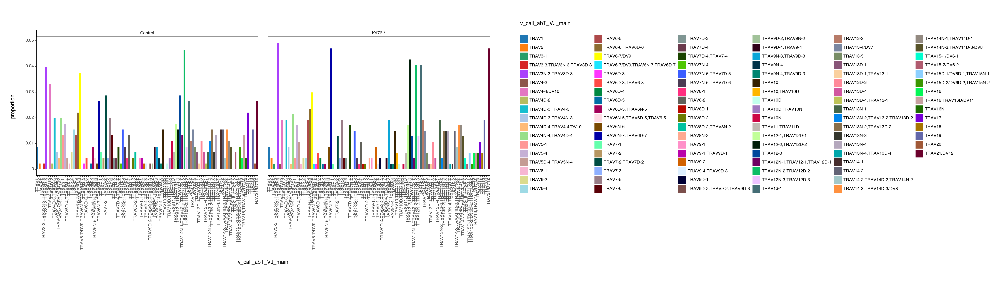

<Figure Size: (2800 x 800)>

In [1094]:
options.figure_size = (28, 8)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VJ_main", y="proportion", fill="v_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DP2 - V gene alpha chain

In [1095]:
adata_PF_DP2 = adata_PF[adata_PF.obs["leiden"] == "9 DP 2"]

In [1096]:
adata_PF_DP2

View of AnnData object with n_obs × n_vars = 17 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [1097]:
working_df = pd.DataFrame(adata_PF_DP2.obs.groupby("Sample")["v_call_abT_VJ_main"].value_counts())
working_df

v_call_abT_VJ_main
Sample   v_call_abT_VJ_main                     
Control  TRAV7D-4,TRAV7-4                      2
         TRAV7-3                               1
         TRAV7-5                               1
         TRAV8-2                               1
         TRAV8D-1                              1
         TRAV12-3                              1
         TRAV12N-2,TRAV12D-2                   1
         TRAV13N-4,TRAV13D-4                   1
         TRAV14-2                              1
         TRAV6-5                               0
         TRAV6-7/DV9                           0
         TRAV12-2,TRAV12D-2                    0
         TRAV13-5                              0
         TRAV13D-3                             0
         TRAV13N-1                             0
Krt76-/- TRAV6-5                               1
         TRAV6-7/DV9                           1
         TRAV7-5                               1
         TRAV12-2,TRAV12D-2                    1
         TRAV13-5                              1
         TRAV13D-3                             1
         TRAV13N-1                             1
         TRAV7-3                               0
         TRAV7D-4,TRAV7-4                      0
         TRAV8-2                               0
         TRAV8D-1                              0
         TRAV12-3                              0
         TRAV12N-2,TRAV12D-2                   0
         TRAV13N-4,TRAV13D-4                   0
         TRAV14-2                              0

In [1098]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VJ_main,counts
0,Control,"TRAV7D-4,TRAV7-4",2
1,Control,TRAV7-3,1
2,Control,TRAV7-5,1
3,Control,TRAV8-2,1
4,Control,TRAV8D-1,1
5,Control,TRAV12-3,1
6,Control,"TRAV12N-2,TRAV12D-2",1
7,Control,"TRAV13N-4,TRAV13D-4",1
8,Control,TRAV14-2,1
9,Control,TRAV6-5,0


In [1099]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 10, 'Krt76-/-': 7}

In [1100]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1101]:
working_df

,Sample,v_call_abT_VJ_main,counts,proportion
0,Control,"TRAV7D-4,TRAV7-4",2,0.200000
1,Control,TRAV7-3,1,0.100000
2,Control,TRAV7-5,1,0.100000
3,Control,TRAV8-2,1,0.100000
4,Control,TRAV8D-1,1,0.100000
5,Control,TRAV12-3,1,0.100000
6,Control,"TRAV12N-2,TRAV12D-2",1,0.100000
7,Control,"TRAV13N-4,TRAV13D-4",1,0.100000
8,Control,TRAV14-2,1,0.100000
9,Control,TRAV6-5,0,0.000000


In [1102]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1103]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

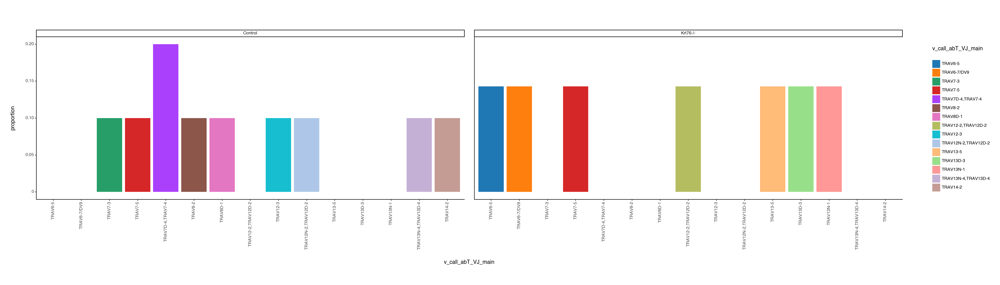

<Figure Size: (2800 x 800)>

In [1104]:
options.figure_size = (28, 8)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VJ_main", y="proportion", fill="v_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### SP & DP - V gene alpha chain

In [1105]:
adata_PF_SPDP = adata_PF[adata_PF.obs["leiden"] == "5 SP & DP"]

In [1106]:
adata_PF_SPDP

View of AnnData object with n_obs × n_vars = 812 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [1107]:
working_df = pd.DataFrame(adata_PF_SPDP.obs.groupby("Sample")["v_call_abT_VJ_main"].value_counts())
working_df

v_call_abT_VJ_main
Sample   v_call_abT_VJ_main                    
Control  TRAV6-6,TRAV6D-6                    26
         TRAV6N-7,TRAV6D-7                   21
         TRAV7-2,TRAV7D-2                    20
         TRAV4N-4,TRAV4D-4                   20
         TRAV3N-3,TRAV3D-3                   18
...                                         ...
Krt76-/- TRAV7N-4                             0
         TRAV10D                              0
         TRAV7N-6,TRAV7D-6                    0
         TRAV9D-2,TRAV9N-2                    0
         TRAV13D-1                            0

[174 rows x 1 columns]

In [1108]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VJ_main,counts
0,Control,"TRAV6-6,TRAV6D-6",26
1,Control,"TRAV6N-7,TRAV6D-7",21
2,Control,"TRAV7-2,TRAV7D-2",20
3,Control,"TRAV4N-4,TRAV4D-4",20
4,Control,"TRAV3N-3,TRAV3D-3",18
...,...,...,...
169,Krt76-/-,TRAV7N-4,0
170,Krt76-/-,TRAV10D,0
171,Krt76-/-,"TRAV7N-6,TRAV7D-6",0
172,Krt76-/-,"TRAV9D-2,TRAV9N-2",0


In [1109]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 536, 'Krt76-/-': 276}

In [1110]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1111]:
working_df

,Sample,v_call_abT_VJ_main,counts,proportion
0,Control,"TRAV6-6,TRAV6D-6",26,0.048507
1,Control,"TRAV6N-7,TRAV6D-7",21,0.039179
2,Control,"TRAV7-2,TRAV7D-2",20,0.037313
3,Control,"TRAV4N-4,TRAV4D-4",20,0.037313
4,Control,"TRAV3N-3,TRAV3D-3",18,0.033582
...,...,...,...,...
169,Krt76-/-,TRAV7N-4,0,0.000000
170,Krt76-/-,TRAV10D,0,0.000000
171,Krt76-/-,"TRAV7N-6,TRAV7D-6",0,0.000000
172,Krt76-/-,"TRAV9D-2,TRAV9N-2",0,0.000000


In [1112]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1113]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

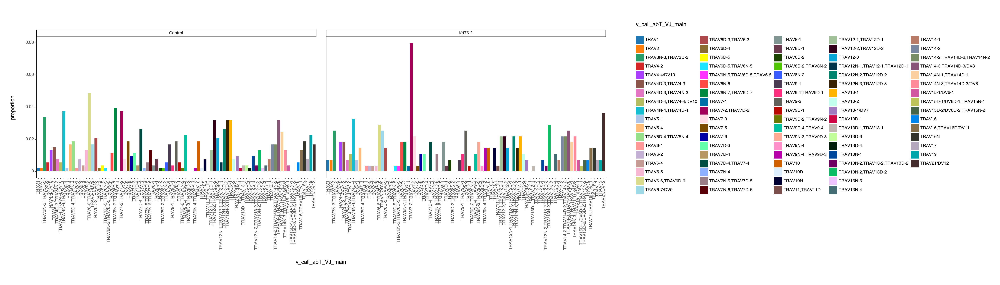

<Figure Size: (2800 x 800)>

In [1114]:
options.figure_size = (28, 8)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VJ_main", y="proportion", fill="v_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### TCRgd - V gene alpha chain

In [1115]:
adata_PF_gd = adata_PF[adata_PF.obs["leiden"] == "8 TCRgd"]

In [1116]:
adata_PF_gd

View of AnnData object with n_obs × n_vars = 13 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [1117]:
working_df = pd.DataFrame(adata_PF_gd.obs.groupby("Sample")["v_call_abT_VJ_main"].value_counts())
working_df

v_call_abT_VJ_main
Sample   v_call_abT_VJ_main                            
Control  TRAV13-1                                     2
         TRAV1                                        1
         TRAV3N-3,TRAV3D-3                            1
         TRAV4D-3,TRAV4-3                             1
         TRAV7N-5,TRAV7D-5                            1
         TRAV12N-2,TRAV12D-2                          1
         TRAV12N-3,TRAV12D-3                          1
         TRAV15D-2/DV6D-2,TRAV15N-2                   1
         TRAV21/DV12                                  1
Krt76-/- TRAV3N-3,TRAV3D-3                            1
         TRAV12N-3,TRAV12D-3                          1
         TRAV15D-2/DV6D-2,TRAV15N-2                   1
         TRAV1                                        0
         TRAV4D-3,TRAV4-3                             0
         TRAV7N-5,TRAV7D-5                            0
         TRAV12N-2,TRAV12D-2                          0
         TRAV13-1                                     0
         TRAV21/DV12                                  0

In [1118]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VJ_main,counts
0,Control,TRAV13-1,2
1,Control,TRAV1,1
2,Control,"TRAV3N-3,TRAV3D-3",1
3,Control,"TRAV4D-3,TRAV4-3",1
4,Control,"TRAV7N-5,TRAV7D-5",1
5,Control,"TRAV12N-2,TRAV12D-2",1
6,Control,"TRAV12N-3,TRAV12D-3",1
7,Control,"TRAV15D-2/DV6D-2,TRAV15N-2",1
8,Control,TRAV21/DV12,1
9,Krt76-/-,"TRAV3N-3,TRAV3D-3",1


In [1119]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 10, 'Krt76-/-': 3}

In [1120]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1121]:
working_df

,Sample,v_call_abT_VJ_main,counts,proportion
0,Control,TRAV13-1,2,0.200000
1,Control,TRAV1,1,0.100000
2,Control,"TRAV3N-3,TRAV3D-3",1,0.100000
3,Control,"TRAV4D-3,TRAV4-3",1,0.100000
4,Control,"TRAV7N-5,TRAV7D-5",1,0.100000
5,Control,"TRAV12N-2,TRAV12D-2",1,0.100000
6,Control,"TRAV12N-3,TRAV12D-3",1,0.100000
7,Control,"TRAV15D-2/DV6D-2,TRAV15N-2",1,0.100000
8,Control,TRAV21/DV12,1,0.100000
9,Krt76-/-,"TRAV3N-3,TRAV3D-3",1,0.333333


In [1122]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1123]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

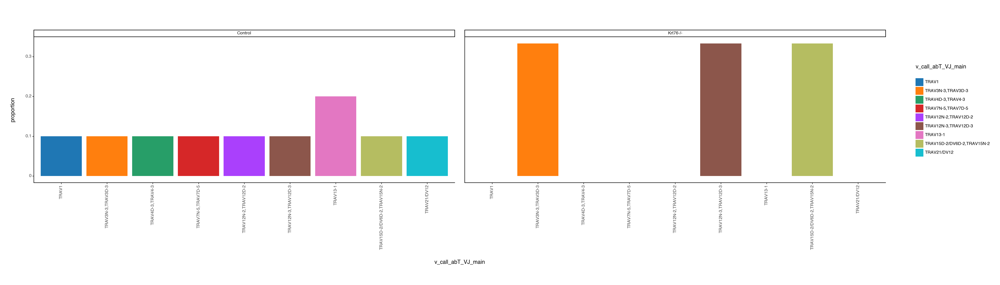

<Figure Size: (2800 x 800)>

In [1124]:
options.figure_size = (28, 8)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VJ_main", y="proportion", fill="v_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### NKT/NK/Tregs - V gene alpha chain

In [1125]:
adata_PF_NK = adata_PF[adata_PF.obs["leiden"] == "11 NKT / NK / Tregs"]

In [1126]:
adata_PF_NK

View of AnnData object with n_obs × n_vars = 139 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [1127]:
working_df = pd.DataFrame(adata_PF_NK.obs.groupby("Sample")["v_call_abT_VJ_main"].value_counts())
working_df

v_call_abT_VJ_main
Sample   v_call_abT_VJ_main                    
Control  TRAV11,TRAV11D                      11
         TRAV6-7/DV9                          7
         TRAV3N-3,TRAV3D-3                    5
         TRAV7D-4,TRAV7-4                     5
         TRAV12-2,TRAV12D-2                   4
...                                         ...
Krt76-/- TRAV9D-1                             0
         TRAV3N-3,TRAV3D-3                    0
         TRAV9N-3,TRAV9D-3                    0
         TRAV9N-4,TRAV9D-3                    0
         TRAV21/DV12                          0

[118 rows x 1 columns]

In [1128]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VJ_main,counts
0,Control,"TRAV11,TRAV11D",11
1,Control,TRAV6-7/DV9,7
2,Control,"TRAV3N-3,TRAV3D-3",5
3,Control,"TRAV7D-4,TRAV7-4",5
4,Control,"TRAV12-2,TRAV12D-2",4
...,...,...,...
113,Krt76-/-,TRAV9D-1,0
114,Krt76-/-,"TRAV3N-3,TRAV3D-3",0
115,Krt76-/-,"TRAV9N-3,TRAV9D-3",0
116,Krt76-/-,"TRAV9N-4,TRAV9D-3",0


In [1129]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 109, 'Krt76-/-': 30}

In [1130]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1131]:
working_df

,Sample,v_call_abT_VJ_main,counts,proportion
0,Control,"TRAV11,TRAV11D",11,0.100917
1,Control,TRAV6-7/DV9,7,0.064220
2,Control,"TRAV3N-3,TRAV3D-3",5,0.045872
3,Control,"TRAV7D-4,TRAV7-4",5,0.045872
4,Control,"TRAV12-2,TRAV12D-2",4,0.036697
...,...,...,...,...
113,Krt76-/-,TRAV9D-1,0,0.000000
114,Krt76-/-,"TRAV3N-3,TRAV3D-3",0,0.000000
115,Krt76-/-,"TRAV9N-3,TRAV9D-3",0,0.000000
116,Krt76-/-,"TRAV9N-4,TRAV9D-3",0,0.000000


In [1132]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1133]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

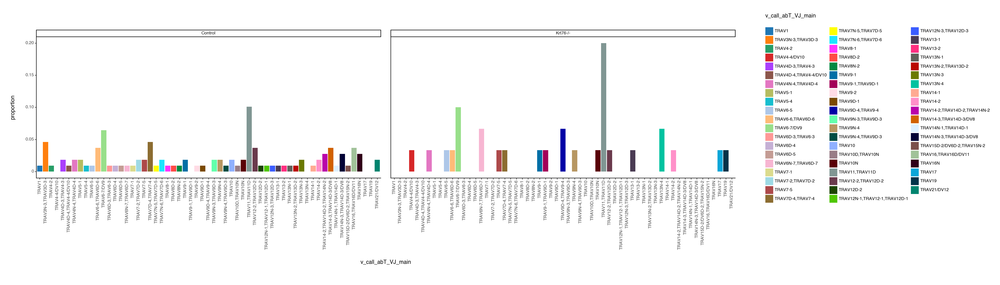

<Figure Size: (2800 x 800)>

In [1134]:
options.figure_size = (28, 8)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VJ_main", y="proportion", fill="v_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

## PRODUCTIVE  -  Split between control vs KO?? J GENE ALPHA CHAIN

In [1307]:
adata_PF = adata_P[adata_P.obs["j_call_abT_VJ_main"] != "None"]
adata_PF = adata_PF[adata_PF.obs["j_call_abT_VJ_main"] != "No_contig"]

In [1308]:
pd.crosstab(adata_PF.obs['Sample'], adata_PF.obs['leiden'])

leiden,0 DN3a,1 DN3a / DN3b,2 DN4,3 DP 1,4 DN2b 2,5 SP & DP,6 DN3b,7 DN2a,8 TCRgd,9 DP 2,10 DN3,11 NKT / NK / Tregs,12 DN2b 1
Sample,,,,,,,,,,,,,
Control,21,27,204,470,62,539,15,12,11,10,7,109,3
Krt76-/-,15,17,214,474,41,277,13,5,3,7,4,30,5


### DN2a - J gene alpha chain

In [1136]:
adata_PF_DN2a = adata_PF[adata_PF.obs["leiden"] == "7 DN2a"]

In [1137]:
adata_PF_DN2a

View of AnnData object with n_obs × n_vars = 17 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [1138]:
working_df = pd.DataFrame(adata_PF_DN2a.obs.groupby("Sample")["j_call_abT_VJ_main"].value_counts())
working_df

j_call_abT_VJ_main
Sample   j_call_abT_VJ_main                    
Control  TRAJ7                                2
         TRAJ2                                1
         TRAJ4                                1
         TRAJ12                               1
         TRAJ15                               1
         TRAJ22                               1
         TRAJ30                               1
         TRAJ38                               1
         TRAJ42                               1
         TRAJ44                               1
         TRAJ52                               1
         TRAJ5                                0
         TRAJ32                               0
         TRAJ34                               0
         TRAJ57                               0
Krt76-/- TRAJ5                                1
         TRAJ32                               1
         TRAJ34                               1
         TRAJ52                               1
         TRAJ57                               1
         TRAJ2                                0
         TRAJ4                                0
         TRAJ7                                0
         TRAJ12                               0
         TRAJ15                               0
         TRAJ22                               0
         TRAJ30                               0
         TRAJ38                               0
         TRAJ42                               0
         TRAJ44                               0

In [1139]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VJ_main,counts
0,Control,TRAJ7,2
1,Control,TRAJ2,1
2,Control,TRAJ4,1
3,Control,TRAJ12,1
4,Control,TRAJ15,1
5,Control,TRAJ22,1
6,Control,TRAJ30,1
7,Control,TRAJ38,1
8,Control,TRAJ42,1
9,Control,TRAJ44,1


In [1140]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 12, 'Krt76-/-': 5}

In [1141]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1142]:
working_df

,Sample,j_call_abT_VJ_main,counts,proportion
0,Control,TRAJ7,2,0.166667
1,Control,TRAJ2,1,0.083333
2,Control,TRAJ4,1,0.083333
3,Control,TRAJ12,1,0.083333
4,Control,TRAJ15,1,0.083333
5,Control,TRAJ22,1,0.083333
6,Control,TRAJ30,1,0.083333
7,Control,TRAJ38,1,0.083333
8,Control,TRAJ42,1,0.083333
9,Control,TRAJ44,1,0.083333


In [1143]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1144]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

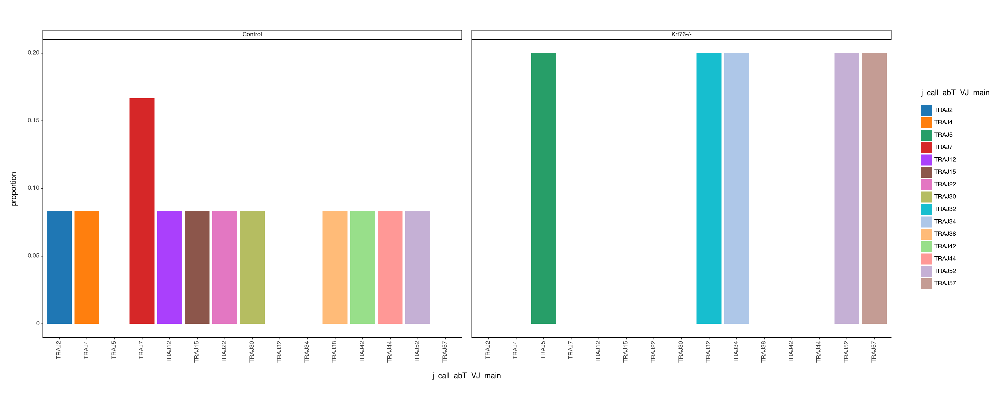

<Figure Size: (2000 x 800)>

In [1145]:
options.figure_size = (20, 8)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VJ_main", y="proportion", fill="j_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN2b1 - J gene alpha chain

In [1146]:
adata_PF_DN2b1 = adata_PF[adata_PF.obs["leiden"] == "12 DN2b 1"]

In [1147]:
adata_PF_DN2b1

View of AnnData object with n_obs × n_vars = 8 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', '

In [1148]:
working_df = pd.DataFrame(adata_PF_DN2b1.obs.groupby("Sample")["j_call_abT_VJ_main"].value_counts())
working_df

j_call_abT_VJ_main
Sample   j_call_abT_VJ_main                    
Control  TRAJ6                                1
         TRAJ42                               1
         TRAJ45                               1
         TRAJ22                               0
         TRAJ37                               0
         TRAJ40                               0
Krt76-/- TRAJ37                               2
         TRAJ22                               1
         TRAJ40                               1
         TRAJ42                               1
         TRAJ6                                0
         TRAJ45                               0

In [1149]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VJ_main,counts
0,Control,TRAJ6,1
1,Control,TRAJ42,1
2,Control,TRAJ45,1
3,Control,TRAJ22,0
4,Control,TRAJ37,0
5,Control,TRAJ40,0
6,Krt76-/-,TRAJ37,2
7,Krt76-/-,TRAJ22,1
8,Krt76-/-,TRAJ40,1
9,Krt76-/-,TRAJ42,1


In [1150]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 3, 'Krt76-/-': 5}

In [1151]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1152]:
working_df

,Sample,j_call_abT_VJ_main,counts,proportion
0,Control,TRAJ6,1,0.333333
1,Control,TRAJ42,1,0.333333
2,Control,TRAJ45,1,0.333333
3,Control,TRAJ22,0,0.000000
4,Control,TRAJ37,0,0.000000
5,Control,TRAJ40,0,0.000000
6,Krt76-/-,TRAJ37,2,0.400000
7,Krt76-/-,TRAJ22,1,0.200000
8,Krt76-/-,TRAJ40,1,0.200000
9,Krt76-/-,TRAJ42,1,0.200000


In [1153]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1154]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

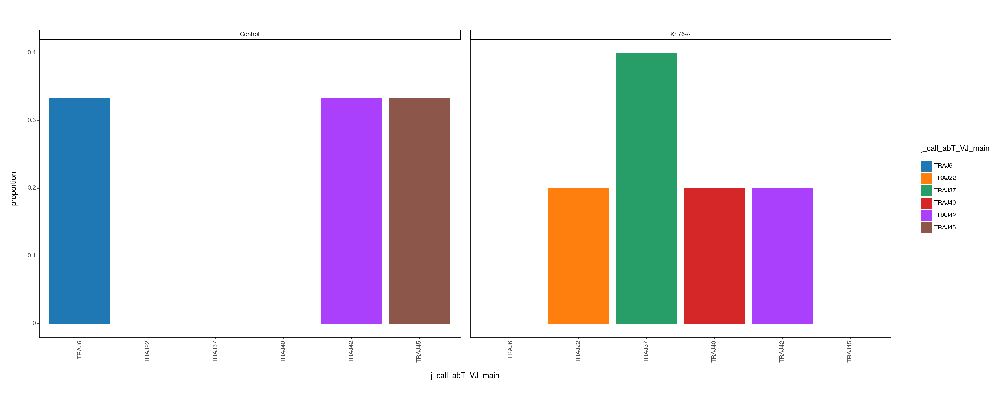

<Figure Size: (2000 x 800)>

In [1155]:
options.figure_size = (20, 8)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VJ_main", y="proportion", fill="j_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN2b2 - J gene alpha chain

In [1156]:
adata_PF_DN2b2 = adata_PF[adata_PF.obs["leiden"] == "4 DN2b 2"]

In [1157]:
adata_PF_DN2b2

View of AnnData object with n_obs × n_vars = 103 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [1158]:
working_df = pd.DataFrame(adata_PF_DN2b2.obs.groupby("Sample")["j_call_abT_VJ_main"].value_counts())
working_df

j_call_abT_VJ_main
Sample   j_call_abT_VJ_main                    
Control  TRAJ58                              10
         TRAJ28                               7
         TRAJ22                               6
         TRAJ16                               5
         TRAJ31                               5
...                                         ...
Krt76-/- TRAJ16                               0
         TRAJ52                               0
         TRAJ13                               0
         TRAJ11                               0
         TRAJ2                                0

[72 rows x 1 columns]

In [1159]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VJ_main,counts
0,Control,TRAJ58,10
1,Control,TRAJ28,7
2,Control,TRAJ22,6
3,Control,TRAJ16,5
4,Control,TRAJ31,5
...,...,...,...
67,Krt76-/-,TRAJ16,0
68,Krt76-/-,TRAJ52,0
69,Krt76-/-,TRAJ13,0
70,Krt76-/-,TRAJ11,0


In [1160]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 62, 'Krt76-/-': 41}

In [1161]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1162]:
working_df

,Sample,j_call_abT_VJ_main,counts,proportion
0,Control,TRAJ58,10,0.161290
1,Control,TRAJ28,7,0.112903
2,Control,TRAJ22,6,0.096774
3,Control,TRAJ16,5,0.080645
4,Control,TRAJ31,5,0.080645
...,...,...,...,...
67,Krt76-/-,TRAJ16,0,0.000000
68,Krt76-/-,TRAJ52,0,0.000000
69,Krt76-/-,TRAJ13,0,0.000000
70,Krt76-/-,TRAJ11,0,0.000000


In [1163]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1164]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

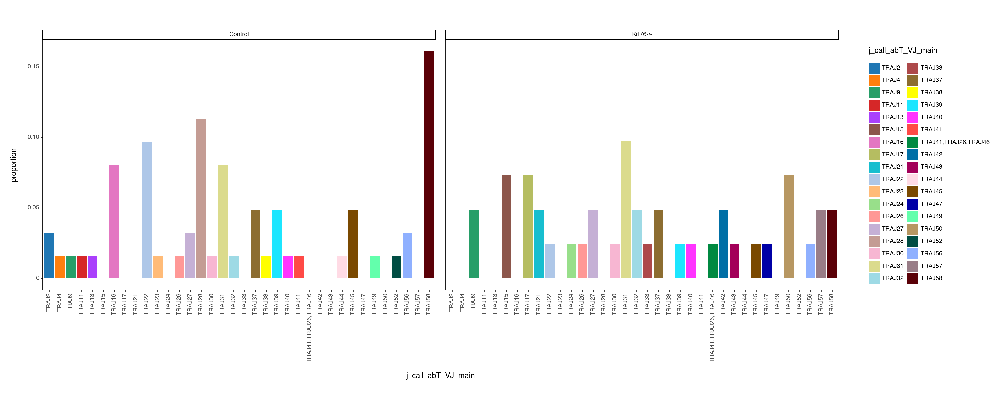

<Figure Size: (2000 x 800)>

In [1165]:
options.figure_size = (20, 8)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VJ_main", y="proportion", fill="j_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN3 - J gene alpha chain

In [1166]:
adata_PF_DN3 = adata_PF[adata_PF.obs["leiden"] == "10 DN3"]

In [1167]:
adata_PF_DN3

View of AnnData object with n_obs × n_vars = 11 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [1168]:
working_df = pd.DataFrame(adata_PF_DN3.obs.groupby("Sample")["j_call_abT_VJ_main"].value_counts())
working_df

j_call_abT_VJ_main
Sample   j_call_abT_VJ_main                    
Control  TRAJ49                               2
         TRAJ17                               1
         TRAJ21                               1
         TRAJ23                               1
         TRAJ40                               1
         TRAJ58                               1
         TRDJ1                                0
Krt76-/- TRAJ58                               3
         TRDJ1                                1
         TRAJ17                               0
         TRAJ21                               0
         TRAJ23                               0
         TRAJ40                               0
         TRAJ49                               0

In [1169]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VJ_main,counts
0,Control,TRAJ49,2
1,Control,TRAJ17,1
2,Control,TRAJ21,1
3,Control,TRAJ23,1
4,Control,TRAJ40,1
5,Control,TRAJ58,1
6,Control,TRDJ1,0
7,Krt76-/-,TRAJ58,3
8,Krt76-/-,TRDJ1,1
9,Krt76-/-,TRAJ17,0


In [1170]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 7, 'Krt76-/-': 4}

In [1171]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1172]:
working_df

,Sample,j_call_abT_VJ_main,counts,proportion
0,Control,TRAJ49,2,0.285714
1,Control,TRAJ17,1,0.142857
2,Control,TRAJ21,1,0.142857
3,Control,TRAJ23,1,0.142857
4,Control,TRAJ40,1,0.142857
5,Control,TRAJ58,1,0.142857
6,Control,TRDJ1,0,0.000000
7,Krt76-/-,TRAJ58,3,0.750000
8,Krt76-/-,TRDJ1,1,0.250000
9,Krt76-/-,TRAJ17,0,0.000000


In [1173]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1174]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

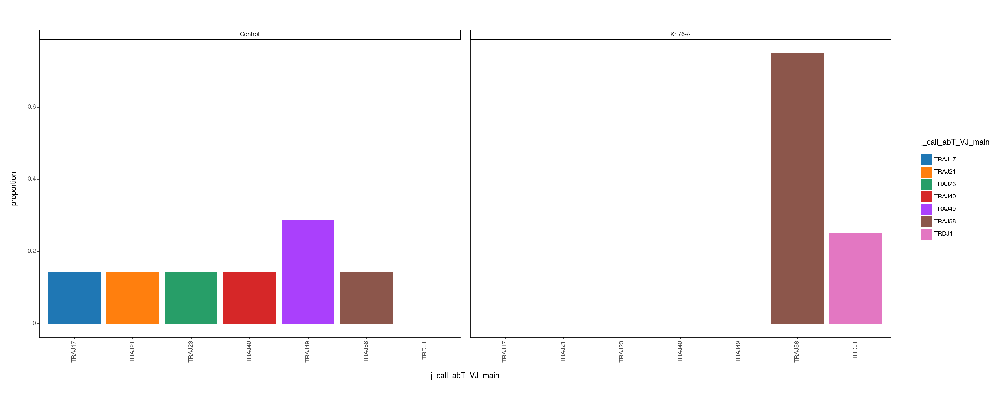

<Figure Size: (2000 x 800)>

In [1175]:
options.figure_size = (20, 8)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VJ_main", y="proportion", fill="j_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN3a - J gene alpha chain

In [1176]:
adata_PF_DN3a = adata_PF[adata_PF.obs["leiden"] == "0 DN3a"]

In [1177]:
adata_PF_DN3a

View of AnnData object with n_obs × n_vars = 36 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [1178]:
working_df = pd.DataFrame(adata_PF_DN3a.obs.groupby("Sample")["j_call_abT_VJ_main"].value_counts())
working_df

j_call_abT_VJ_main
Sample   j_call_abT_VJ_main                    
Control  TRAJ12                               3
         TRAJ40                               2
         TRAJ17                               2
         TRAJ2                                1
         TRAJ4                                1
         TRAJ58                               1
         TRAJ52                               1
         TRAJ37                               1
         TRAJ34                               1
         TRAJ33                               1
         TRAJ23                               1
         TRAJ22                               1
         TRAJ18                               1
         TRAJ16                               1
         TRAJ9                                1
         TRAJ7                                1
         TRDJ1                                1
         TRAJ26                               0
         TRAJ32                               0
         TRAJ15                               0
         TRAJ13                               0
         TRAJ42                               0
Krt76-/- TRAJ13                               3
         TRAJ15                               3
         TRAJ58                               1
         TRAJ42                               1
         TRAJ40                               1
         TRAJ37                               1
         TRAJ18                               1
         TRAJ22                               1
         TRAJ34                               1
         TRAJ26                               1
         TRAJ32                               1
         TRAJ2                                0
         TRAJ33                               0
         TRAJ52                               0
         TRAJ23                               0
         TRAJ4                                0
         TRAJ17                               0
         TRAJ16                               0
         TRAJ12                               0
         TRAJ9                                0
         TRAJ7                                0
         TRDJ1                                0

In [1179]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VJ_main,counts
0,Control,TRAJ12,3
1,Control,TRAJ40,2
2,Control,TRAJ17,2
3,Control,TRAJ2,1
4,Control,TRAJ4,1
5,Control,TRAJ58,1
6,Control,TRAJ52,1
7,Control,TRAJ37,1
8,Control,TRAJ34,1
9,Control,TRAJ33,1


In [1180]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 21, 'Krt76-/-': 15}

In [1181]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1182]:
working_df

,Sample,j_call_abT_VJ_main,counts,proportion
0,Control,TRAJ12,3,0.142857
1,Control,TRAJ40,2,0.095238
2,Control,TRAJ17,2,0.095238
3,Control,TRAJ2,1,0.047619
4,Control,TRAJ4,1,0.047619
5,Control,TRAJ58,1,0.047619
6,Control,TRAJ52,1,0.047619
7,Control,TRAJ37,1,0.047619
8,Control,TRAJ34,1,0.047619
9,Control,TRAJ33,1,0.047619


In [1183]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1184]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

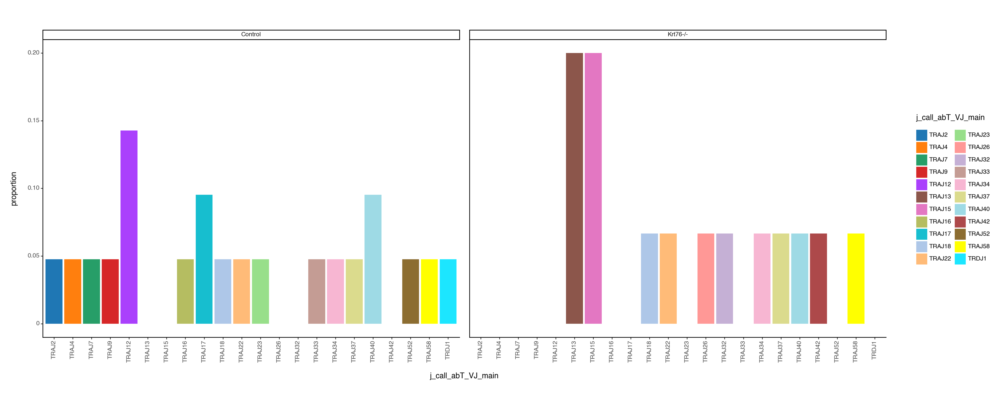

<Figure Size: (2000 x 800)>

In [1185]:
options.figure_size = (20, 8)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VJ_main", y="proportion", fill="j_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN3ab - J gene alpha chain

In [1186]:
adata_PF_DN3ab = adata_PF[adata_PF.obs["leiden"] == "1 DN3a / DN3b"]

In [1187]:
adata_PF_DN3ab

View of AnnData object with n_obs × n_vars = 44 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [1188]:
working_df = pd.DataFrame(adata_PF_DN3ab.obs.groupby("Sample")["j_call_abT_VJ_main"].value_counts())
working_df

j_call_abT_VJ_main
Sample   j_call_abT_VJ_main                    
Control  TRAJ16                               3
         TRAJ22                               3
         TRAJ12                               2
         TRAJ39                               2
         TRAJ31                               2
         TRAJ6                                1
         TRAJ30                               1
         TRAJ49                               1
         TRAJ45                               1
         TRAJ40                               1
         TRAJ33                               1
         TRAJ32                               1
         TRAJ27                               1
         TRAJ7                                1
         TRAJ26                               1
         TRAJ24                               1
         TRAJ15                               1
         TRAJ13                               1
         TRAJ11                               1
         TRAJ56                               1
         TRAJ18                               0
         TRAJ35                               0
         TRAJ17                               0
         TRAJ50                               0
Krt76-/- TRAJ30                               3
         TRAJ31                               3
         TRAJ22                               2
         TRAJ56                               1
         TRAJ50                               1
         TRAJ12                               1
         TRAJ49                               1
         TRAJ17                               1
         TRAJ18                               1
         TRAJ26                               1
         TRAJ7                                1
         TRAJ35                               1
         TRAJ33                               0
         TRAJ45                               0
         TRAJ40                               0
         TRAJ39                               0
         TRAJ6                                0
         TRAJ32                               0
         TRAJ24                               0
         TRAJ16                               0
         TRAJ15                               0
         TRAJ13                               0
         TRAJ11                               0
         TRAJ27                               0

In [1189]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VJ_main,counts
0,Control,TRAJ16,3
1,Control,TRAJ22,3
2,Control,TRAJ12,2
3,Control,TRAJ39,2
4,Control,TRAJ31,2
5,Control,TRAJ6,1
6,Control,TRAJ30,1
7,Control,TRAJ49,1
8,Control,TRAJ45,1
9,Control,TRAJ40,1


In [1190]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 27, 'Krt76-/-': 17}

In [1191]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1192]:
working_df

,Sample,j_call_abT_VJ_main,counts,proportion
0,Control,TRAJ16,3,0.111111
1,Control,TRAJ22,3,0.111111
2,Control,TRAJ12,2,0.074074
3,Control,TRAJ39,2,0.074074
4,Control,TRAJ31,2,0.074074
5,Control,TRAJ6,1,0.037037
6,Control,TRAJ30,1,0.037037
7,Control,TRAJ49,1,0.037037
8,Control,TRAJ45,1,0.037037
9,Control,TRAJ40,1,0.037037


In [1193]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1194]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

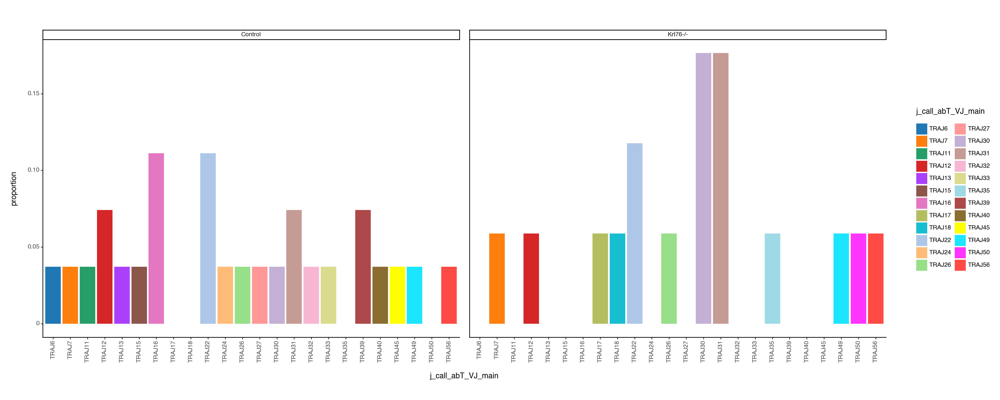

<Figure Size: (2000 x 800)>

In [1195]:
options.figure_size = (20, 8)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VJ_main", y="proportion", fill="j_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN3b - J gene alpha chain

In [1196]:
adata_PF_DN3b = adata_PF[adata_PF.obs["leiden"] == "6 DN3b"]

In [1197]:
adata_PF_DN3b

View of AnnData object with n_obs × n_vars = 28 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [1198]:
working_df = pd.DataFrame(adata_PF_DN3b.obs.groupby("Sample")["j_call_abT_VJ_main"].value_counts())
working_df

j_call_abT_VJ_main
Sample   j_call_abT_VJ_main                      
Control  TRAJ26                                 2
         TRAJ40                                 2
         TRAJ4                                  1
         TRAJ37                                 1
         TRAJ13                                 1
         TRAJ15                                 1
         TRAJ43                                 1
         TRAJ41,TRAJ26,TRAJ46                   1
         TRAJ22                                 1
         TRAJ7                                  1
         TRAJ30                                 1
         TRAJ31                                 1
         TRAJ32                                 1
         TRAJ45                                 0
         TRAJ28                                 0
         TRAJ33                                 0
         TRAJ27                                 0
         TRAJ18                                 0
         TRAJ17                                 0
         TRAJ12                                 0
         TRAJ58                                 0
Krt76-/- TRAJ28                                 1
         TRAJ27                                 1
         TRAJ45                                 1
         TRAJ40                                 1
         TRAJ37                                 1
         TRAJ33                                 1
         TRAJ32                                 1
         TRAJ58                                 1
         TRAJ22                                 1
         TRAJ18                                 1
         TRAJ17                                 1
         TRAJ15                                 1
         TRAJ12                                 1
         TRAJ26                                 0
         TRAJ7                                  0
         TRAJ30                                 0
         TRAJ31                                 0
         TRAJ13                                 0
         TRAJ41,TRAJ26,TRAJ46                   0
         TRAJ43                                 0
         TRAJ4                                  0

In [1199]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VJ_main,counts
0,Control,TRAJ26,2
1,Control,TRAJ40,2
2,Control,TRAJ4,1
3,Control,TRAJ37,1
4,Control,TRAJ13,1
5,Control,TRAJ15,1
6,Control,TRAJ43,1
7,Control,"TRAJ41,TRAJ26,TRAJ46",1
8,Control,TRAJ22,1
9,Control,TRAJ7,1


In [1200]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 15, 'Krt76-/-': 13}

In [1201]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1202]:
working_df

,Sample,j_call_abT_VJ_main,counts,proportion
0,Control,TRAJ26,2,0.133333
1,Control,TRAJ40,2,0.133333
2,Control,TRAJ4,1,0.066667
3,Control,TRAJ37,1,0.066667
4,Control,TRAJ13,1,0.066667
5,Control,TRAJ15,1,0.066667
6,Control,TRAJ43,1,0.066667
7,Control,"TRAJ41,TRAJ26,TRAJ46",1,0.066667
8,Control,TRAJ22,1,0.066667
9,Control,TRAJ7,1,0.066667


In [1203]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1204]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

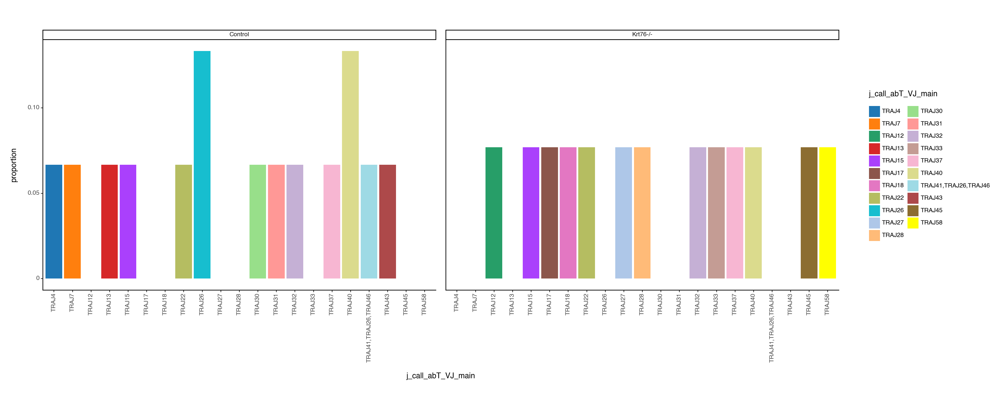

<Figure Size: (2000 x 800)>

In [1205]:
options.figure_size = (20, 8)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VJ_main", y="proportion", fill="j_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DN4 - J gene alpha chain

In [1206]:
adata_PF_DN4= adata_PF[adata_PF.obs["leiden"] == "2 DN4"]

In [1207]:
adata_PF_DN4

View of AnnData object with n_obs × n_vars = 418 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [1208]:
working_df = pd.DataFrame(adata_PF_DN4.obs.groupby("Sample")["j_call_abT_VJ_main"].value_counts())
working_df

j_call_abT_VJ_main
Sample   j_call_abT_VJ_main                    
Control  TRAJ49                              12
         TRAJ15                              12
         TRAJ56                              11
         TRAJ37                              10
         TRAJ31                               9
...                                         ...
Krt76-/- TRAJ18                               1
         TRAJ7                                1
         TRDJ1                                1
         TRAJ41                               0
         TRAJ61                               0

[94 rows x 1 columns]

In [1209]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VJ_main,counts
0,Control,TRAJ49,12
1,Control,TRAJ15,12
2,Control,TRAJ56,11
3,Control,TRAJ37,10
4,Control,TRAJ31,9
...,...,...,...
89,Krt76-/-,TRAJ18,1
90,Krt76-/-,TRAJ7,1
91,Krt76-/-,TRDJ1,1
92,Krt76-/-,TRAJ41,0


In [1210]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 204, 'Krt76-/-': 214}

In [1211]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1212]:
working_df

,Sample,j_call_abT_VJ_main,counts,proportion
0,Control,TRAJ49,12,0.058824
1,Control,TRAJ15,12,0.058824
2,Control,TRAJ56,11,0.053922
3,Control,TRAJ37,10,0.049020
4,Control,TRAJ31,9,0.044118
...,...,...,...,...
89,Krt76-/-,TRAJ18,1,0.004673
90,Krt76-/-,TRAJ7,1,0.004673
91,Krt76-/-,TRDJ1,1,0.004673
92,Krt76-/-,TRAJ41,0,0.000000


In [1213]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1214]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

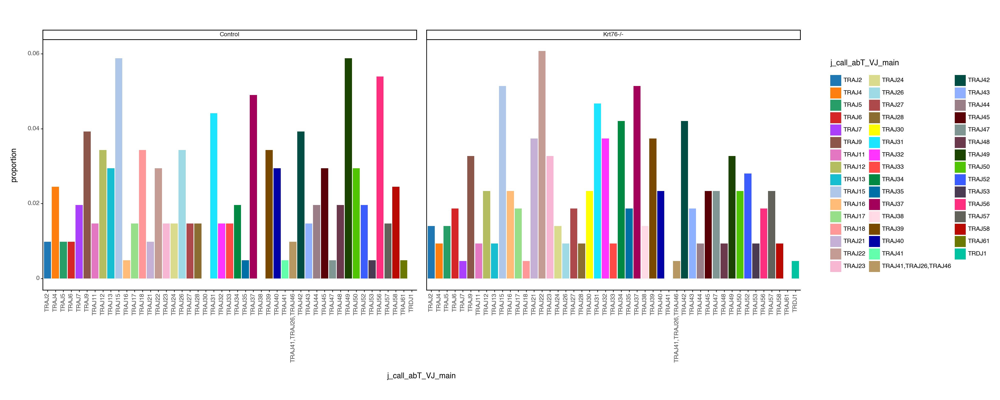

<Figure Size: (2000 x 800)>

In [1215]:
options.figure_size = (20, 8)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VJ_main", y="proportion", fill="j_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### ALL DNs combined- V gene Alpha Chain

In [1216]:
#adatax_single2 = adatax_single[adatax_single.obs['clone_id_size_max_3'].isin (['1','2'])]
#adata_PF_DN3ab = adata_PF[adata_PF.obs["leiden"] == "1 DN3a / DN3b"]
adatax_PF_DNall = adata_PF[adata_PF.obs['leiden'].isin (['7 DN2a', '12 DN2b 1', '4 DN2b 2', '10 DN3', '0 DN3a', '1 DN3a / DN3b', '6 DN3b', '2 DN4'])]

In [1217]:
adatax_PF_DNall.obs['leiden'].value_counts()

2 DN4            418
4 DN2b 2         103
1 DN3a / DN3b     44
0 DN3a            36
6 DN3b            28
7 DN2a            17
10 DN3            11
12 DN2b 1          8
Name: leiden, dtype: int64

In [1218]:
working_df = pd.DataFrame(adatax_PF_DNall.obs.groupby("Sample")["j_call_abT_VJ_main"].value_counts())
working_df

j_call_abT_VJ_main
Sample   j_call_abT_VJ_main                    
Control  TRAJ22                              18
         TRAJ58                              17
         TRAJ31                              17
         TRAJ49                              16
         TRAJ15                              15
...                                         ...
Krt76-/- TRAJ11                               2
         TRAJ7                                2
         TRDJ1                                2
         TRAJ41                               0
         TRAJ61                               0

[94 rows x 1 columns]

In [1219]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VJ_main,counts
0,Control,TRAJ22,18
1,Control,TRAJ58,17
2,Control,TRAJ31,17
3,Control,TRAJ49,16
4,Control,TRAJ15,15
...,...,...,...
89,Krt76-/-,TRAJ11,2
90,Krt76-/-,TRAJ7,2
91,Krt76-/-,TRDJ1,2
92,Krt76-/-,TRAJ41,0


In [1220]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 351, 'Krt76-/-': 314}

In [1221]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1222]:
working_df

,Sample,j_call_abT_VJ_main,counts,proportion
0,Control,TRAJ22,18,0.051282
1,Control,TRAJ58,17,0.048433
2,Control,TRAJ31,17,0.048433
3,Control,TRAJ49,16,0.045584
4,Control,TRAJ15,15,0.042735
...,...,...,...,...
89,Krt76-/-,TRAJ11,2,0.006369
90,Krt76-/-,TRAJ7,2,0.006369
91,Krt76-/-,TRDJ1,2,0.006369
92,Krt76-/-,TRAJ41,0,0.000000


In [1223]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1224]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

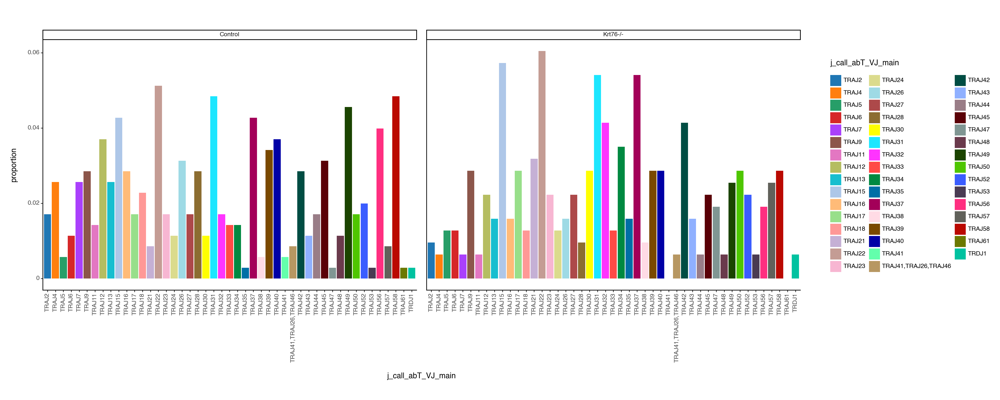

<Figure Size: (2000 x 800)>

In [1225]:
options.figure_size = (20, 8)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VJ_main", y="proportion", fill="j_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DP1 - J gene ALpha Chain

In [1226]:
adata_PF_DP1

View of AnnData object with n_obs × n_vars = 923 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [1227]:
working_df = pd.DataFrame(adata_PF_DP1.obs.groupby("Sample")["j_call_abT_VJ_main"].value_counts())
working_df

j_call_abT_VJ_main
Sample   j_call_abT_VJ_main                    
Control  TRAJ31                              23
         TRAJ58                              19
         TRAJ32                              19
         TRAJ27                              19
         TRAJ57                              18
...                                         ...
Krt76-/- TRAJ5                                2
         TRDJ1                                1
         TRAJ47                               0
         TRAJ24                               0
         TRBJ2-4                              0

[92 rows x 1 columns]

In [1228]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VJ_main,counts
0,Control,TRAJ31,23
1,Control,TRAJ58,19
2,Control,TRAJ32,19
3,Control,TRAJ27,19
4,Control,TRAJ57,18
...,...,...,...
87,Krt76-/-,TRAJ5,2
88,Krt76-/-,TRDJ1,1
89,Krt76-/-,TRAJ47,0
90,Krt76-/-,TRAJ24,0


In [1229]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 454, 'Krt76-/-': 469}

In [1230]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1231]:
working_df

,Sample,j_call_abT_VJ_main,counts,proportion
0,Control,TRAJ31,23,0.050661
1,Control,TRAJ58,19,0.041850
2,Control,TRAJ32,19,0.041850
3,Control,TRAJ27,19,0.041850
4,Control,TRAJ57,18,0.039648
...,...,...,...,...
87,Krt76-/-,TRAJ5,2,0.004264
88,Krt76-/-,TRDJ1,1,0.002132
89,Krt76-/-,TRAJ47,0,0.000000
90,Krt76-/-,TRAJ24,0,0.000000


In [1232]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1233]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

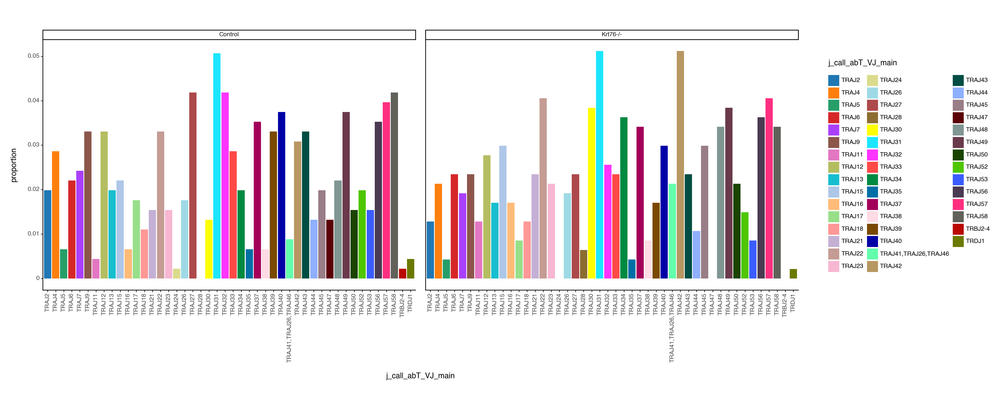

<Figure Size: (2000 x 800)>

In [1234]:
options.figure_size = (20, 8)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VJ_main", y="proportion", fill="j_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### DP2 - J gene alpha chain

In [1235]:
adata_PF_DP2= adata_PF[adata_PF.obs["leiden"] == "9 DP 2"]

In [1236]:
adata_PF_DP2

View of AnnData object with n_obs × n_vars = 17 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [1237]:
working_df = pd.DataFrame(adata_PF_DP2.obs.groupby("Sample")["j_call_abT_VJ_main"].value_counts())
working_df

j_call_abT_VJ_main
Sample   j_call_abT_VJ_main                    
Control  TRAJ37                               2
         TRAJ53                               2
         TRAJ15                               1
         TRAJ23                               1
         TRAJ26                               1
         TRAJ42                               1
         TRAJ49                               1
         TRAJ52                               1
         TRAJ21                               0
         TRAJ27                               0
         TRAJ31,TRAJ7                         0
         TRAJ33                               0
         TRAJ47                               0
Krt76-/- TRAJ21                               1
         TRAJ27                               1
         TRAJ31,TRAJ7                         1
         TRAJ33                               1
         TRAJ42                               1
         TRAJ47                               1
         TRAJ53                               1
         TRAJ15                               0
         TRAJ23                               0
         TRAJ26                               0
         TRAJ37                               0
         TRAJ49                               0
         TRAJ52                               0

In [1238]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VJ_main,counts
0,Control,TRAJ37,2
1,Control,TRAJ53,2
2,Control,TRAJ15,1
3,Control,TRAJ23,1
4,Control,TRAJ26,1
5,Control,TRAJ42,1
6,Control,TRAJ49,1
7,Control,TRAJ52,1
8,Control,TRAJ21,0
9,Control,TRAJ27,0


In [1239]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 10, 'Krt76-/-': 7}

In [1240]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1241]:
working_df

,Sample,j_call_abT_VJ_main,counts,proportion
0,Control,TRAJ37,2,0.200000
1,Control,TRAJ53,2,0.200000
2,Control,TRAJ15,1,0.100000
3,Control,TRAJ23,1,0.100000
4,Control,TRAJ26,1,0.100000
5,Control,TRAJ42,1,0.100000
6,Control,TRAJ49,1,0.100000
7,Control,TRAJ52,1,0.100000
8,Control,TRAJ21,0,0.000000
9,Control,TRAJ27,0,0.000000


In [1242]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1243]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

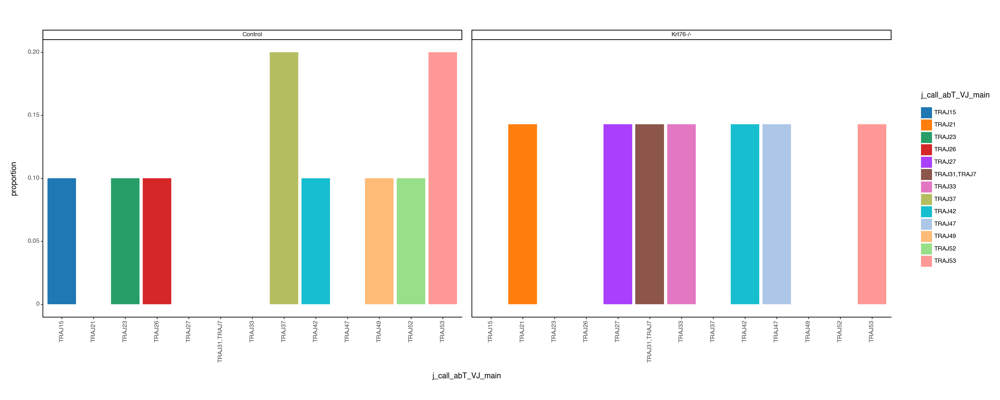

<Figure Size: (2000 x 800)>

In [1244]:
options.figure_size = (20, 8)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VJ_main", y="proportion", fill="j_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### SPDP - J gene alpha chain

In [1245]:
adata_PF_SPDP= adata_PF[adata_PF.obs["leiden"] == "5 SP & DP"]

In [1246]:
adata_PF_SPDP

View of AnnData object with n_obs × n_vars = 816 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [1247]:
working_df = pd.DataFrame(adata_PF_SPDP.obs.groupby("Sample")["j_call_abT_VJ_main"].value_counts())
working_df

j_call_abT_VJ_main
Sample   j_call_abT_VJ_main                    
Control  TRAJ21                              32
         TRAJ22                              30
         TRAJ31                              30
         TRAJ23                              27
         TRAJ15                              26
...                                         ...
Krt76-/- TRAJ24                               1
         TRAJ16                               1
         TRAJ5                                1
         TRAJ41                               0
         TRAJ19                               0

[92 rows x 1 columns]

In [1248]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VJ_main,counts
0,Control,TRAJ21,32
1,Control,TRAJ22,30
2,Control,TRAJ31,30
3,Control,TRAJ23,27
4,Control,TRAJ15,26
...,...,...,...
87,Krt76-/-,TRAJ24,1
88,Krt76-/-,TRAJ16,1
89,Krt76-/-,TRAJ5,1
90,Krt76-/-,TRAJ41,0


In [1249]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 539, 'Krt76-/-': 277}

In [1250]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1251]:
working_df

,Sample,j_call_abT_VJ_main,counts,proportion
0,Control,TRAJ21,32,0.059369
1,Control,TRAJ22,30,0.055659
2,Control,TRAJ31,30,0.055659
3,Control,TRAJ23,27,0.050093
4,Control,TRAJ15,26,0.048237
...,...,...,...,...
87,Krt76-/-,TRAJ24,1,0.003610
88,Krt76-/-,TRAJ16,1,0.003610
89,Krt76-/-,TRAJ5,1,0.003610
90,Krt76-/-,TRAJ41,0,0.000000


In [1252]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1253]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

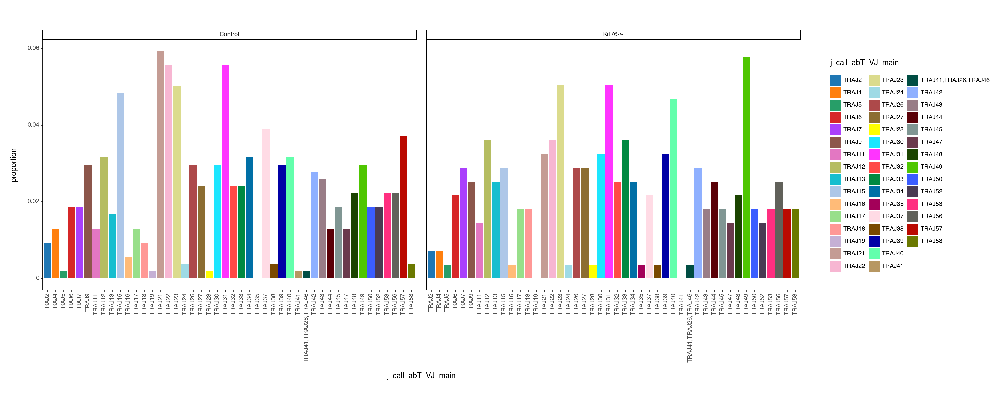

<Figure Size: (2000 x 800)>

In [1254]:
options.figure_size = (20, 8)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VJ_main", y="proportion", fill="j_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### TCRgd - J gene alpha chain

In [1255]:
adata_PF_gd= adata_PF[adata_PF.obs["leiden"] == "8 TCRgd"]

In [1256]:
adata_PF_gd

View of AnnData object with n_obs × n_vars = 14 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [1257]:
working_df = pd.DataFrame(adata_PF_gd.obs.groupby("Sample")["j_call_abT_VJ_main"].value_counts())
working_df

j_call_abT_VJ_main
Sample   j_call_abT_VJ_main                    
Control  TRAJ5                                1
         TRAJ6                                1
         TRAJ12                               1
         TRAJ21                               1
         TRAJ23                               1
         TRAJ27                               1
         TRAJ32                               1
         TRAJ35                               1
         TRAJ37                               1
         TRAJ40                               1
         TRAJ58                               1
         TRAJ4                                0
         TRAJ33                               0
         TRDJ1                                0
Krt76-/- TRAJ4                                1
         TRAJ33                               1
         TRDJ1                                1
         TRAJ5                                0
         TRAJ6                                0
         TRAJ12                               0
         TRAJ21                               0
         TRAJ23                               0
         TRAJ27                               0
         TRAJ32                               0
         TRAJ35                               0
         TRAJ37                               0
         TRAJ40                               0
         TRAJ58                               0

In [1258]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VJ_main,counts
0,Control,TRAJ5,1
1,Control,TRAJ6,1
2,Control,TRAJ12,1
3,Control,TRAJ21,1
4,Control,TRAJ23,1
5,Control,TRAJ27,1
6,Control,TRAJ32,1
7,Control,TRAJ35,1
8,Control,TRAJ37,1
9,Control,TRAJ40,1


In [1259]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 11, 'Krt76-/-': 3}

In [1260]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1261]:
working_df

,Sample,j_call_abT_VJ_main,counts,proportion
0,Control,TRAJ5,1,0.090909
1,Control,TRAJ6,1,0.090909
2,Control,TRAJ12,1,0.090909
3,Control,TRAJ21,1,0.090909
4,Control,TRAJ23,1,0.090909
5,Control,TRAJ27,1,0.090909
6,Control,TRAJ32,1,0.090909
7,Control,TRAJ35,1,0.090909
8,Control,TRAJ37,1,0.090909
9,Control,TRAJ40,1,0.090909


In [1262]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1263]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

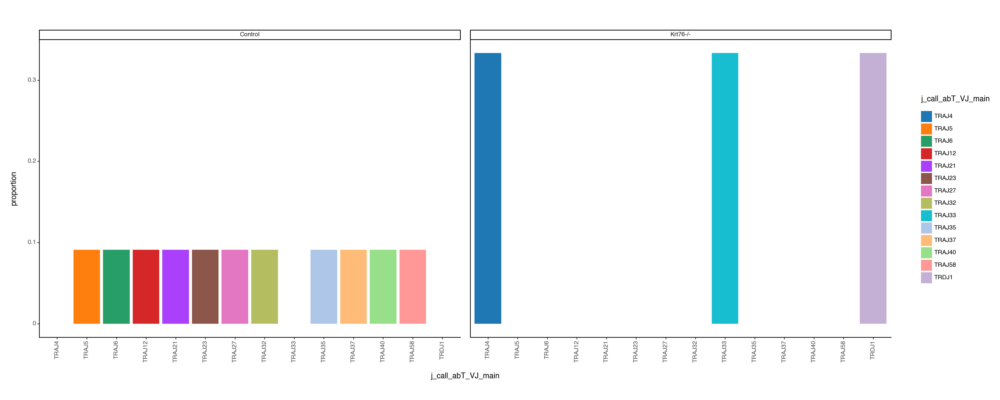

<Figure Size: (2000 x 800)>

In [1264]:
options.figure_size = (20, 8)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VJ_main", y="proportion", fill="j_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### NKT/NK/Tregs - J gene alpha chain

In [1265]:
adata_PF_NK= adata_PF[adata_PF.obs["leiden"] == "11 NKT / NK / Tregs"]

In [1266]:
adata_PF_NK

View of AnnData object with n_obs × n_vars = 139 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main',

In [1267]:
working_df = pd.DataFrame(adata_PF_NK.obs.groupby("Sample")["j_call_abT_VJ_main"].value_counts())
working_df

j_call_abT_VJ_main
Sample   j_call_abT_VJ_main                    
Control  TRAJ18                              13
         TRAJ30                               9
         TRAJ21                               7
         TRAJ26                               7
         TRAJ23                               6
...                                         ...
Krt76-/- TRAJ22                               0
         TRAJ24                               0
         TRAJ5                                0
         TRAJ26                               0
         TRAJ58                               0

[72 rows x 1 columns]

In [1268]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,j_call_abT_VJ_main,counts
0,Control,TRAJ18,13
1,Control,TRAJ30,9
2,Control,TRAJ21,7
3,Control,TRAJ26,7
4,Control,TRAJ23,6
...,...,...,...
67,Krt76-/-,TRAJ22,0
68,Krt76-/-,TRAJ24,0
69,Krt76-/-,TRAJ5,0
70,Krt76-/-,TRAJ26,0


In [1269]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 109, 'Krt76-/-': 30}

In [1270]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [1271]:
working_df

,Sample,j_call_abT_VJ_main,counts,proportion
0,Control,TRAJ18,13,0.119266
1,Control,TRAJ30,9,0.082569
2,Control,TRAJ21,7,0.064220
3,Control,TRAJ26,7,0.064220
4,Control,TRAJ23,6,0.055046
...,...,...,...,...
67,Krt76-/-,TRAJ22,0,0.000000
68,Krt76-/-,TRAJ24,0,0.000000
69,Krt76-/-,TRAJ5,0,0.000000
70,Krt76-/-,TRAJ26,0,0.000000


In [1272]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1273]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

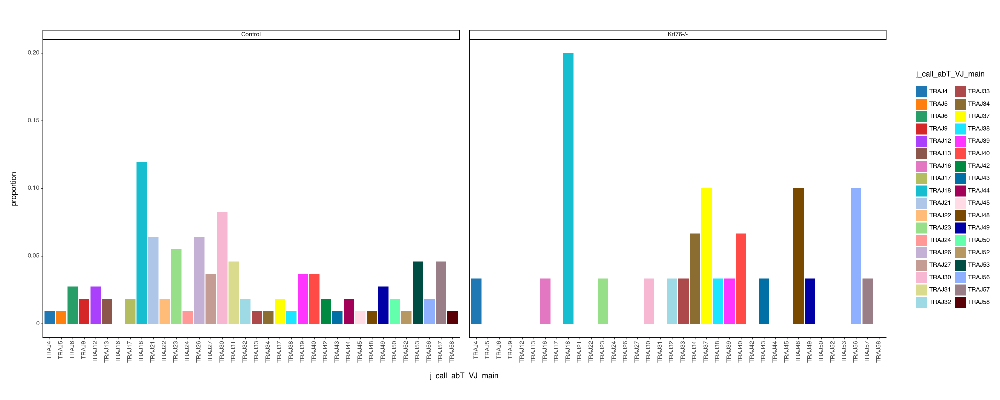

<Figure Size: (2000 x 800)>

In [1274]:
options.figure_size = (20, 8)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VJ_main", y="proportion", fill="j_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

# NOW LOOK AT NON-PRODUCTIVE (ALL FIRST)

In [1309]:
adata_NP.obs["Sample"].value_counts()

Control     9832
Krt76-/-    5569
Name: Sample, dtype: int64

/Users/uqssoon/anaconda3/envs/Jaz2023_env/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
/Users/uqssoon/anaconda3/envs/Jaz2023_env/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


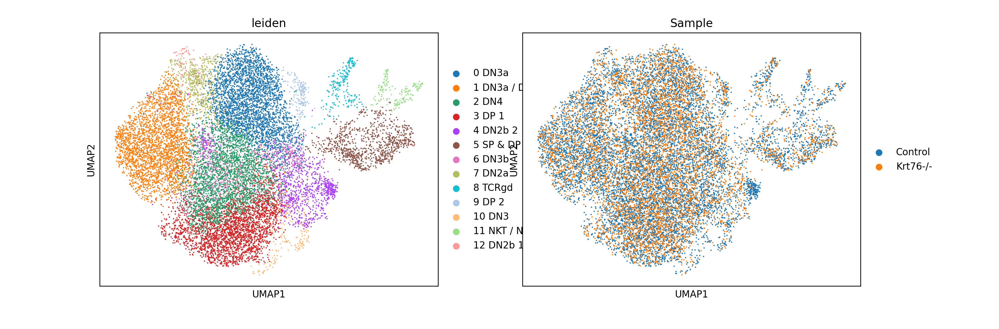

In [1310]:
sc.pl.umap(adata_NP, color=["leiden", "Sample"])

/Users/uqssoon/anaconda3/envs/Jaz2023_env/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


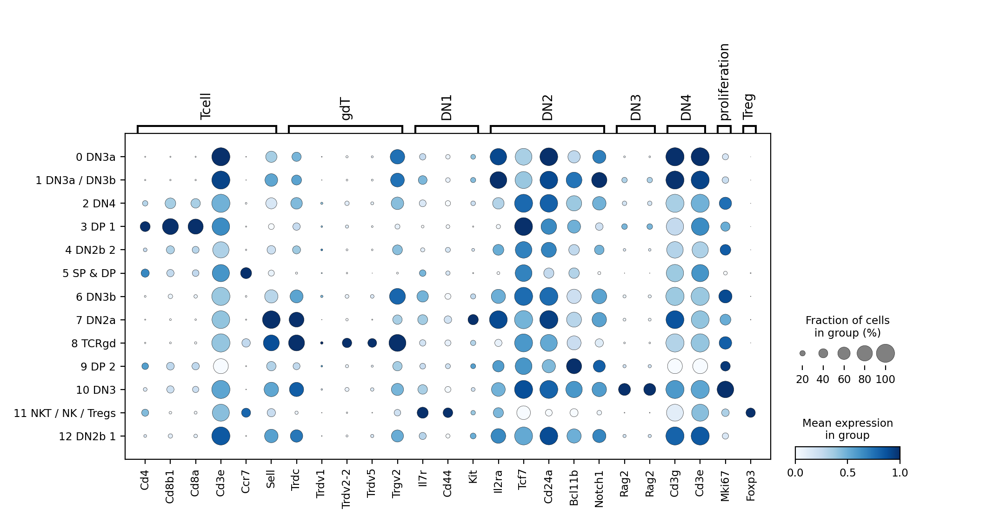

In [1311]:
sc.pl.dotplot(
    adata_NP,
    {
        "Tcell": [
            "Cd4",
            "Cd8b1",
            "Cd8a",
            "Cd3e",
            "Ccr7",
            "Sell",
        ],
        "gdT": [
            "Trdc",
            "Trdv1",
            "Trdv2-2",
            "Trdv5",
            "Trgv2",
        ],
        "DN1": [
            "Il7r",
            "Cd44",
            "Kit",
        ],
        "DN2": [
            "Il2ra",
            "Tcf7",
            "Cd24a",
            "Bcl11b",
            "Notch1",
        ],
        "DN3": [
            "Rag2",
            "Rag2",
        ],
        "DN4": [
            "Cd3g",
            "Cd3e",
        ],
        "proliferation": [
            "Mki67",
        ],
        "Treg": [
            "Foxp3",
        ],
    },
    groupby="leiden",
    standard_scale="var",
    color_map="Blues",
)

In [1312]:
#### If you have done up scanpy's plotting defaults, you can reset it before going forward further.

import matplotlib.pyplot as plt

plt.rcParams.update(plt.rcParamsDefault)
%matplotlib inline

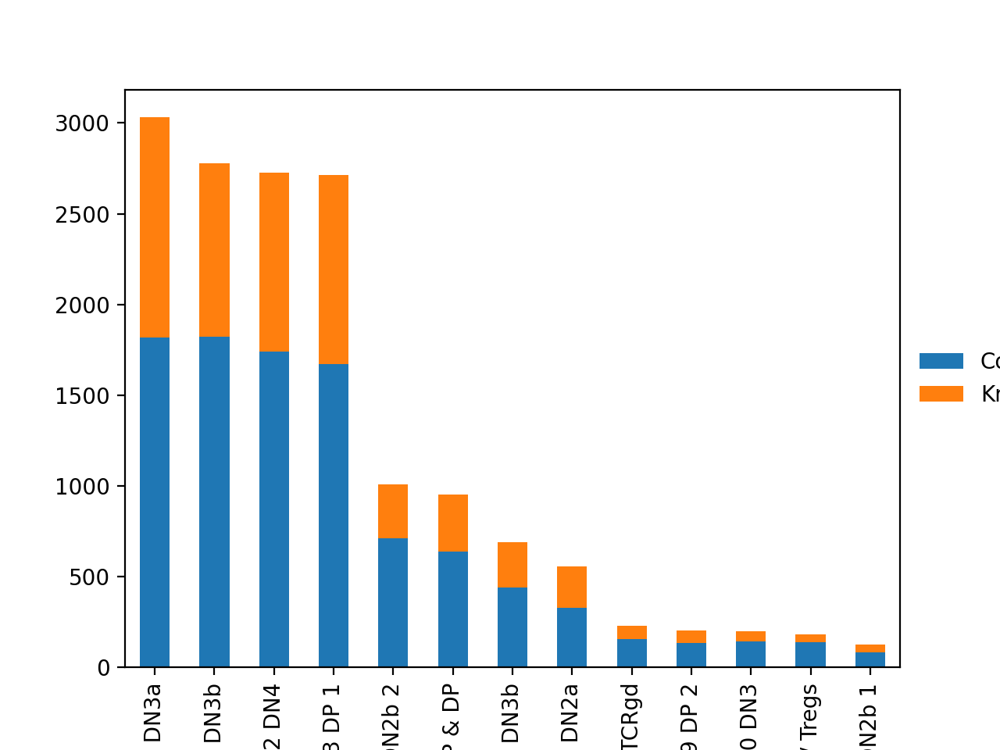

In [1313]:
pd.crosstab(
    adata_NP.obs["leiden"],
    adata_NP.obs["Sample"],
).plot.bar(stacked=True)
plt.legend(bbox_to_anchor=(1, 0.5), loc="center left", frameon=False)

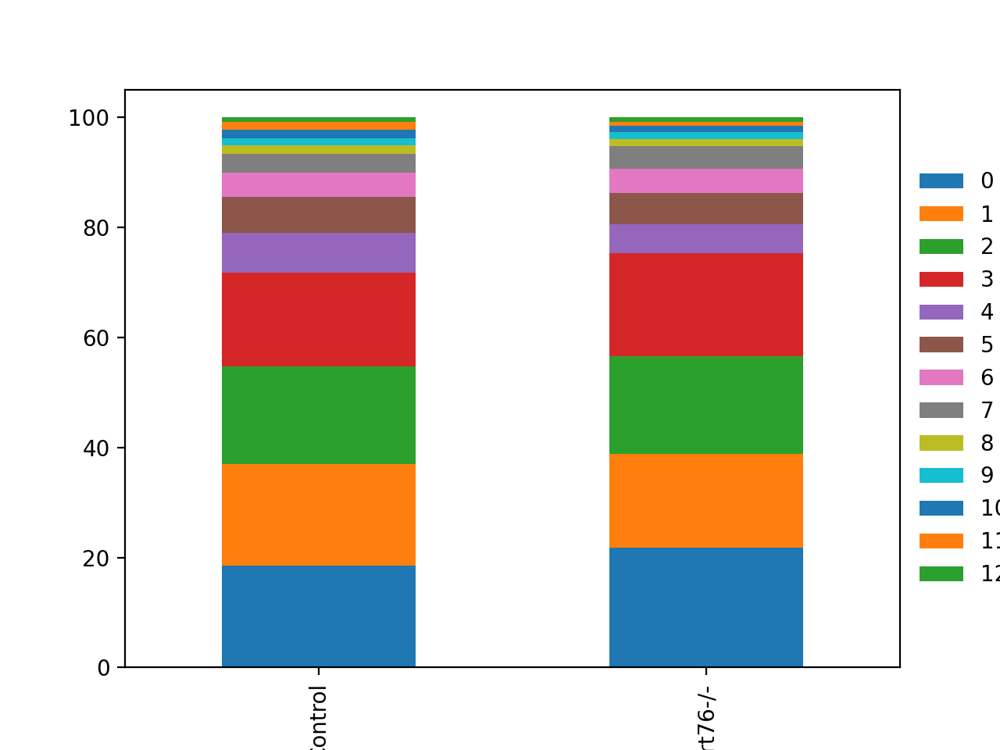

In [1314]:
pd.crosstab(adata_NP.obs["Sample"], adata_NP.obs["leiden"]).apply(lambda r: r/r.sum()*100,axis = 1).plot.bar(stacked=True)
plt.legend(bbox_to_anchor=(1,.5), loc = "center left", frameon=False)

In [1315]:
import pandas as pd

pd.crosstab(adata_NP.obs["leiden"], adata_NP.obs["productive_VDJ"])

productive_VDJ,F,F|F,F|F|F,F|F|F|F,F|F|F|F|F,F|F|F|F|F|F,F|F|F|F|F|F|F,No_contig,None,T,...,T|T,T|T|F,T|T|F|F,T|T|F|F|F,T|T|F|F|F|F,T|T|F|F|F|F|F,T|T|F|F|F|F|F|F,T|T|T|F,T|T|T|F|F,T|T|T|F|F|F|F|F
leiden,,,,,,,,,,,,,,,,,,,,,
0 DN3a,264,243,100,27,10,2,0,1878,1,4,...,0,7,1,4,2,0,0,0,0,0
1 DN3a / DN3b,198,192,85,30,9,1,0,1989,1,9,...,1,4,0,0,0,0,0,0,0,0
2 DN4,54,86,51,27,8,5,1,644,6,49,...,5,31,44,23,22,2,4,0,0,1
3 DP 1,67,32,17,6,1,0,0,594,15,198,...,7,32,26,8,5,1,0,2,1,0
4 DN2b 2,40,20,15,9,2,1,0,551,1,18,...,0,11,8,4,2,2,0,1,0,0
5 SP & DP,26,9,4,2,0,0,0,325,8,106,...,2,13,14,3,0,1,0,0,1,0
6 DN3b,16,15,8,6,0,0,0,124,1,5,...,0,10,7,2,2,0,0,0,1,0
7 DN2a,3,8,9,8,2,1,2,473,0,0,...,0,0,0,1,0,0,0,0,0,0
8 TCRgd,7,22,23,10,3,1,0,112,1,0,...,0,1,2,1,0,0,0,0,0,0


/Users/uqssoon/anaconda3/envs/Jaz2023_env/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


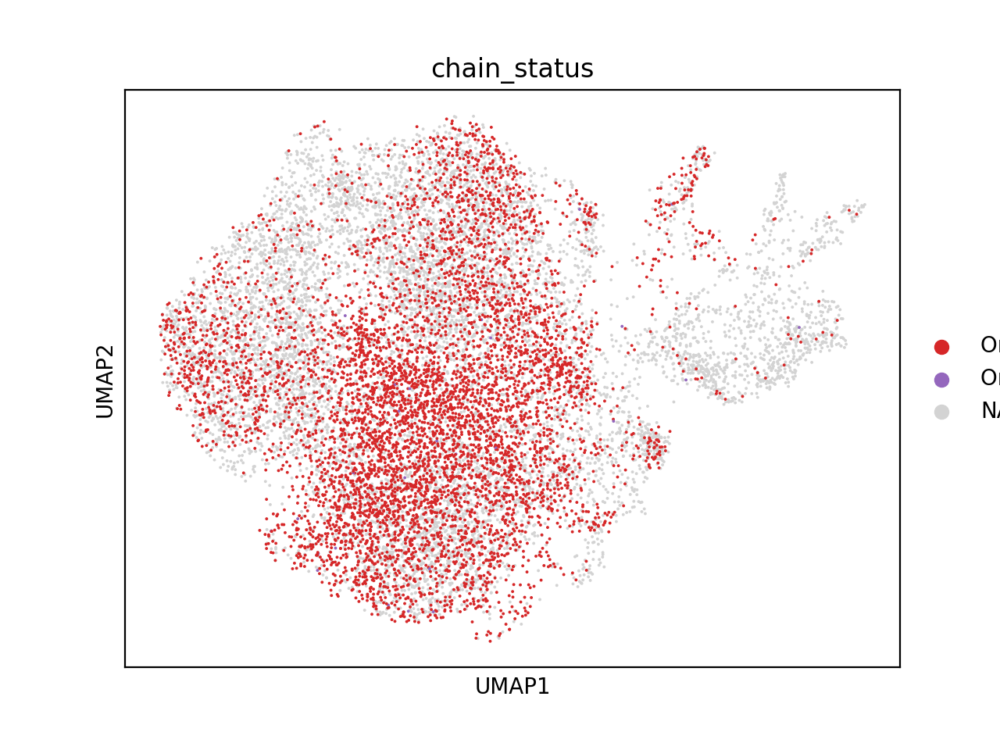

In [1317]:
sc.pl.umap(adata_NP, color="chain_status", groups=["Orphan VDJ", "Orphan VDJ-exception"])

In [1318]:
adata_NP.obs["chain_status"].value_counts()

No_contig               7065
Orphan VDJ              6210
Extra pair              1792
Single pair              266
Orphan VJ                 37
Orphan VDJ-exception      26
Extra pair-exception       5
Name: chain_status, dtype: int64

/Users/uqssoon/anaconda3/envs/Jaz2023_env/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


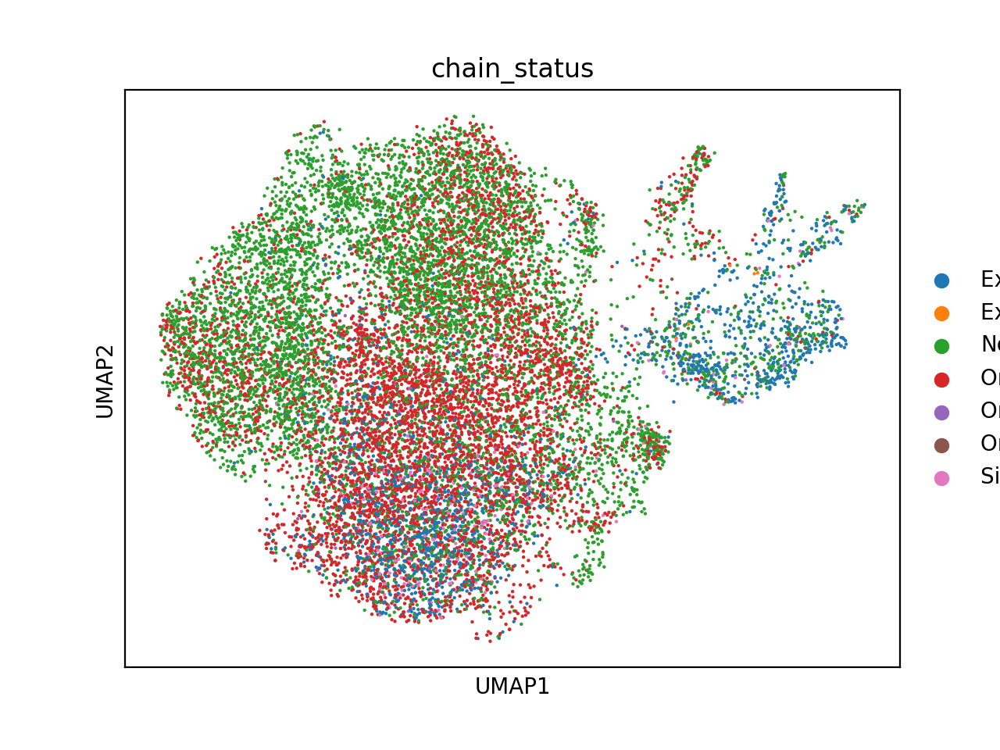

In [1319]:
sc.pl.umap(adata_NP, color=["chain_status"], size = 10)

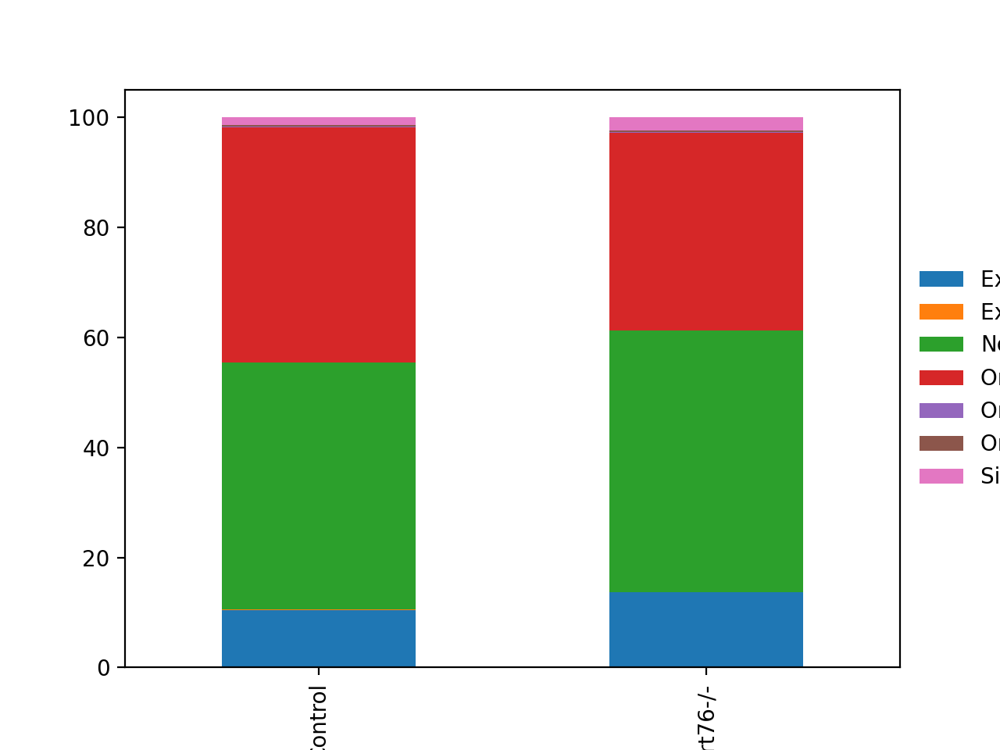

In [1320]:
pd.crosstab(
    adata_NP.obs["Sample"],
    adata_NP.obs["chain_status"],
).apply(
    lambda r: r / r.sum() * 100, axis=1
).plot.bar(stacked=True)
plt.legend(bbox_to_anchor=(1, 0.5), loc="center left", frameon=False)

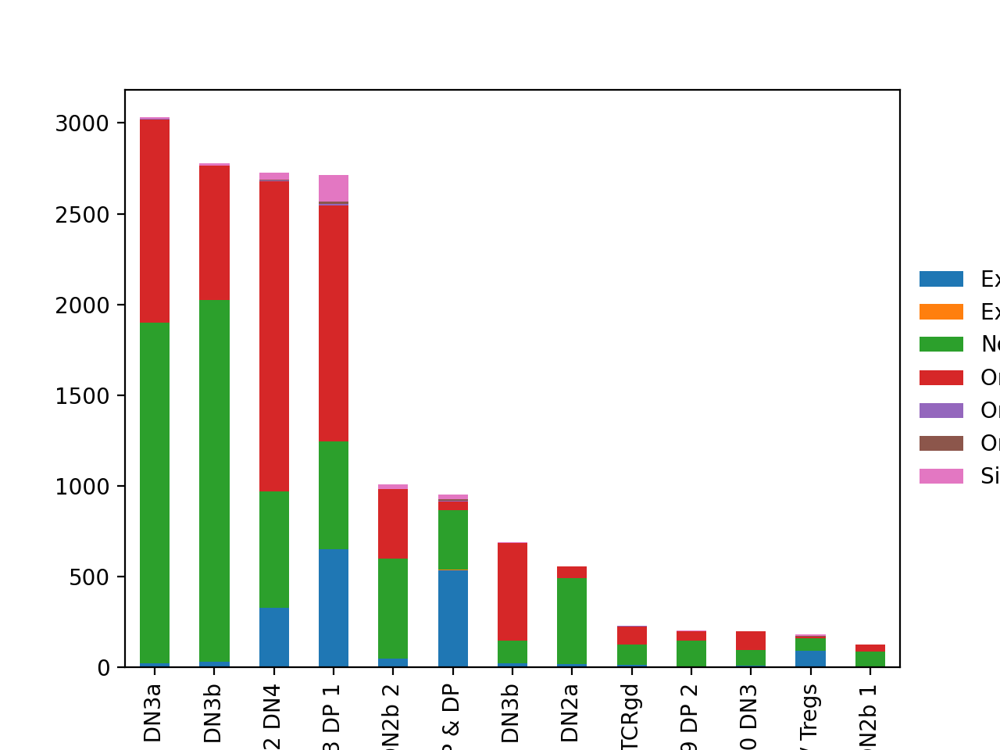

In [1321]:
pd.crosstab(
    adata_NP.obs["leiden"],
    adata_NP.obs["chain_status"],
).plot.bar(stacked=True)
plt.legend(bbox_to_anchor=(1, 0.5), loc="center left", frameon=False)

## V/J gene usage 

### V gene Beta Chain (ALL Samples)

In [1322]:
adata_NPF = adata_NP[adata_NP.obs["v_call_abT_VDJ_main"] != "None"]
adata_NPF = adata_NPF[adata_NPF.obs["v_call_abT_VDJ_main"] != "No_contig"]

In [1323]:
adata_NPF

View of AnnData object with n_obs × n_vars = 7571 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [1324]:
adata_NPF.obs.groupby(["leiden"]).apply(len)

leiden
0 DN3a                  952
1 DN3a / DN3b           608
2 DN4                  1968
3 DP 1                 2031
4 DN2b 2                411
5 SP & DP               591
6 DN3b                  541
7 DN2a                   60
8 TCRgd                  97
9 DP 2                   55
10 DN3                  107
11 NKT / NK / Tregs     104
12 DN2b 1                46
dtype: int64

In [1325]:
pd.crosstab(adata_NPF.obs['Sample'], adata_NPF.obs['leiden'])

leiden,0 DN3a,1 DN3a / DN3b,2 DN4,3 DP 1,4 DN2b 2,5 SP & DP,6 DN3b,7 DN2a,8 TCRgd,9 DP 2,10 DN3,11 NKT / NK / Tregs,12 DN2b 1
Sample,,,,,,,,,,,,,
Control,556,403,1294,1251,296,387,341,44,63,40,79,84,32
Krt76-/-,396,205,674,780,115,204,200,16,34,15,28,20,14


In [1339]:
working_df = pd.DataFrame(adata_NPF.obs.groupby("leiden")["v_call_abT_VDJ_main"].value_counts())
working_df

v_call_abT_VDJ_main
leiden    v_call_abT_VDJ_main                     
0 DN3a    TRBV13-1                              81
          TRBV15                                74
          TRBV19                                72
          TRBV5                                 69
          TRBV13-2                              66
...                                            ...
12 DN2b 1 TRBV21                                 0
          TRBV24,TRBV26                          0
          TRBV13-1                               0
          TRBV12-2                               0
          TRBV4                                  0

[325 rows x 1 columns]

In [1340]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,leiden,v_call_abT_VDJ_main,counts
0,0 DN3a,TRBV13-1,81
1,0 DN3a,TRBV15,74
2,0 DN3a,TRBV19,72
3,0 DN3a,TRBV5,69
4,0 DN3a,TRBV13-2,66
...,...,...,...
320,12 DN2b 1,TRBV21,0
321,12 DN2b 1,"TRBV24,TRBV26",0
322,12 DN2b 1,TRBV13-1,0
323,12 DN2b 1,TRBV12-2,0


In [1342]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.leiden.unique():
    tmp = working_df[working_df["leiden"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'0 DN3a': 952,
 '1 DN3a / DN3b': 608,
 '2 DN4': 1968,
 '3 DP 1': 2031,
 '4 DN2b 2': 411,
 '5 SP & DP': 591,
 '6 DN3b': 541,
 '7 DN2a': 60,
 '8 TCRgd': 97,
 '9 DP 2': 55,
 '10 DN3': 107,
 '11 NKT / NK / Tregs': 104,
 '12 DN2b 1': 46}

In [1343]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["leiden"]]
    except:
        pass

In [1344]:
working_df

,leiden,v_call_abT_VDJ_main,counts,proportion
0,0 DN3a,TRBV13-1,81,0.085084
1,0 DN3a,TRBV15,74,0.077731
2,0 DN3a,TRBV19,72,0.075630
3,0 DN3a,TRBV5,69,0.072479
4,0 DN3a,TRBV13-2,66,0.069328
...,...,...,...,...
320,12 DN2b 1,TRBV21,0,0.000000
321,12 DN2b 1,"TRBV24,TRBV26",0,0.000000
322,12 DN2b 1,TRBV13-1,0,0.000000
323,12 DN2b 1,TRBV12-2,0,0.000000


In [1345]:
## Reordering
working_df["leiden"] = working_df[
    "leiden"
].cat.reorder_categories(
    [
        "7 DN2a",
        "12 DN2b 1",
        "4 DN2b 2",
        "10 DN3",
        "0 DN3a",
        "1 DN3a / DN3b",
        "6 DN3b",
        "2 DN4",
        "3 DP 1",
        "9 DP 2",
        "5 SP & DP",
        "8 TCRgd",
        "11 NKT / NK / Tregs",
    ]
)

In [1346]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1347]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

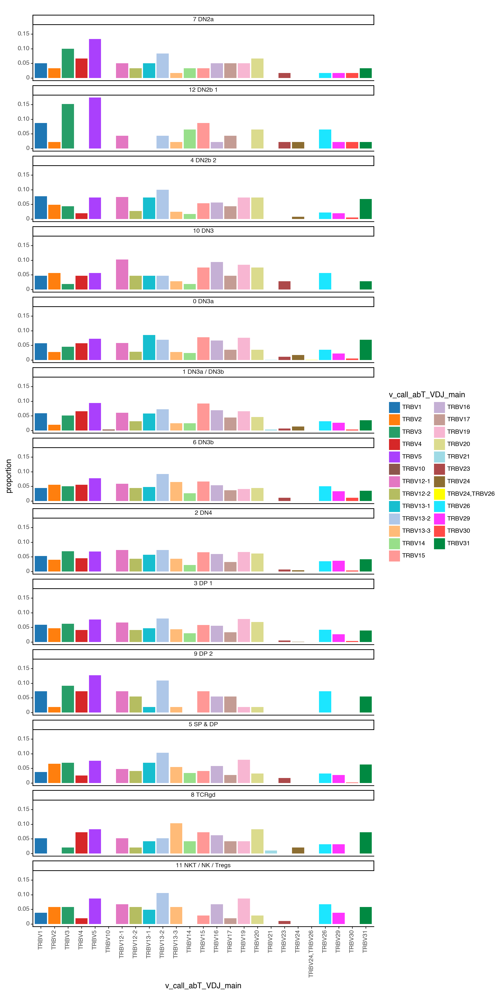

<Figure Size: (1000 x 2000)>

In [1348]:
options.figure_size = (10, 20)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VDJ_main", y="proportion", fill="v_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~leiden", ncol=1)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### J gene Beta Chain (ALL Samples)

In [1349]:
adata_NPF = adata_NP[adata_NP.obs["j_call_abT_VDJ_main"] != "None"]
adata_NPF = adata_NPF[adata_NPF.obs["j_call_abT_VDJ_main"] != "No_contig"]

In [1350]:
adata_NPF

View of AnnData object with n_obs × n_vars = 8299 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [1351]:
adata_NPF.obs.groupby(["leiden"]).apply(len)

leiden
0 DN3a                 1151
1 DN3a / DN3b           786
2 DN4                  2077
3 DP 1                 2106
4 DN2b 2                455
5 SP & DP               621
6 DN3b                  564
7 DN2a                   85
8 TCRgd                 117
9 DP 2                   65
10 DN3                  112
11 NKT / NK / Tregs     112
12 DN2b 1                48
dtype: int64

In [1352]:
pd.crosstab(adata_NPF.obs['Sample'], adata_NPF.obs['leiden'])

leiden,0 DN3a,1 DN3a / DN3b,2 DN4,3 DP 1,4 DN2b 2,5 SP & DP,6 DN3b,7 DN2a,8 TCRgd,9 DP 2,10 DN3,11 NKT / NK / Tregs,12 DN2b 1
Sample,,,,,,,,,,,,,
Control,681,539,1372,1304,332,410,358,66,79,47,82,92,34
Krt76-/-,470,247,705,802,123,211,206,19,38,18,30,20,14


In [1353]:
working_df = pd.DataFrame(adata_NPF.obs.groupby("leiden")["j_call_abT_VDJ_main"].value_counts())
working_df

j_call_abT_VDJ_main
leiden    j_call_abT_VDJ_main                         
0 DN3a    TRBJ2-1                                  162
          TRBJ2-6                                  153
          TRBJ2-7                                  151
          TRBJ2-5                                  139
          TRBJ2-4                                  102
...                                                ...
12 DN2b 1 TRBJ1-3                                    1
          TRBJ1-5,TRBJ2-2                            0
          TRBJ1-6,TRBJ2-7,TRBJ2-2                    0
          TRBJ2-4,TRBJ2-3                            0
          TRBJ2-5,TRBJ2-4                            0

[221 rows x 1 columns]

In [1354]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,leiden,j_call_abT_VDJ_main,counts
0,0 DN3a,TRBJ2-1,162
1,0 DN3a,TRBJ2-6,153
2,0 DN3a,TRBJ2-7,151
3,0 DN3a,TRBJ2-5,139
4,0 DN3a,TRBJ2-4,102
...,...,...,...
216,12 DN2b 1,TRBJ1-3,1
217,12 DN2b 1,"TRBJ1-5,TRBJ2-2",0
218,12 DN2b 1,"TRBJ1-6,TRBJ2-7,TRBJ2-2",0
219,12 DN2b 1,"TRBJ2-4,TRBJ2-3",0


In [1355]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.leiden.unique():
    tmp = working_df[working_df["leiden"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'0 DN3a': 1151,
 '1 DN3a / DN3b': 786,
 '2 DN4': 2077,
 '3 DP 1': 2106,
 '4 DN2b 2': 455,
 '5 SP & DP': 621,
 '6 DN3b': 564,
 '7 DN2a': 85,
 '8 TCRgd': 117,
 '9 DP 2': 65,
 '10 DN3': 112,
 '11 NKT / NK / Tregs': 112,
 '12 DN2b 1': 48}

In [1356]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["leiden"]]
    except:
        pass

In [1357]:
working_df

,leiden,j_call_abT_VDJ_main,counts,proportion
0,0 DN3a,TRBJ2-1,162,0.140747
1,0 DN3a,TRBJ2-6,153,0.132928
2,0 DN3a,TRBJ2-7,151,0.131190
3,0 DN3a,TRBJ2-5,139,0.120765
4,0 DN3a,TRBJ2-4,102,0.088619
...,...,...,...,...
216,12 DN2b 1,TRBJ1-3,1,0.020833
217,12 DN2b 1,"TRBJ1-5,TRBJ2-2",0,0.000000
218,12 DN2b 1,"TRBJ1-6,TRBJ2-7,TRBJ2-2",0,0.000000
219,12 DN2b 1,"TRBJ2-4,TRBJ2-3",0,0.000000


In [1358]:
## Reordering
working_df["leiden"] = working_df[
    "leiden"
].cat.reorder_categories(
    [
        "7 DN2a",
        "12 DN2b 1",
        "4 DN2b 2",
        "10 DN3",
        "0 DN3a",
        "1 DN3a / DN3b",
        "6 DN3b",
        "2 DN4",
        "3 DP 1",
        "9 DP 2",
        "5 SP & DP",
        "8 TCRgd",
        "11 NKT / NK / Tregs",
    ]
)

In [1359]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1360]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

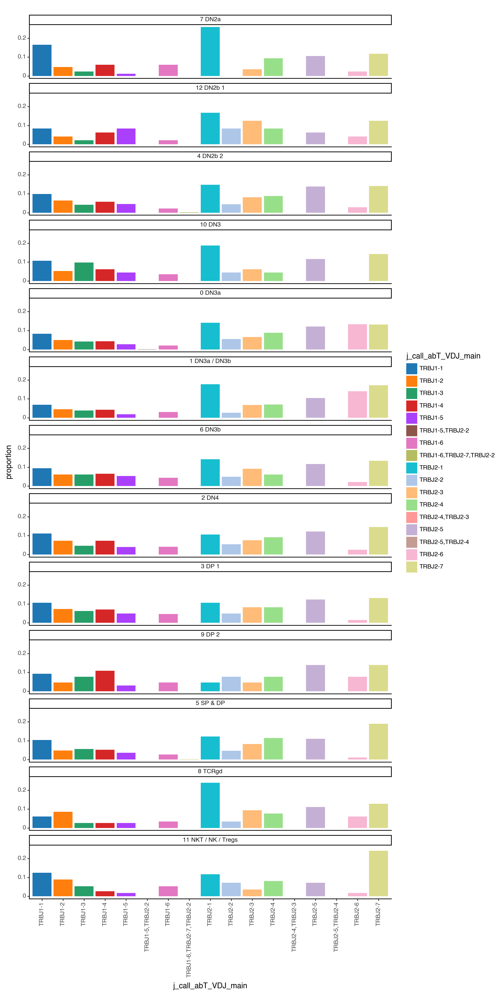

<Figure Size: (1000 x 2000)>

In [1361]:
options.figure_size = (10, 20)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VDJ_main", y="proportion", fill="j_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~leiden", ncol=1)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### V gene Alpha Chain (ALL Samples)

In [1362]:
adata_NPF = adata_NP[adata_NP.obs["v_call_abT_VJ_main"] != "None"]
adata_NPF = adata_NPF[adata_NPF.obs["v_call_abT_VJ_main"] != "No_contig"]

In [1363]:
adata_NPF

View of AnnData object with n_obs × n_vars = 2031 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [1364]:
adata_NPF.obs.groupby(["leiden"]).apply(len)

leiden
0 DN3a                  30
1 DN3a / DN3b           43
2 DN4                  348
3 DP 1                 790
4 DN2b 2                65
5 SP & DP              571
6 DN3b                  24
7 DN2a                  18
8 TCRgd                 11
9 DP 2                  12
10 DN3                   7
11 NKT / NK / Tregs    104
12 DN2b 1                8
dtype: int64

In [1365]:
pd.crosstab(adata_NPF.obs['Sample'], adata_NPF.obs['leiden'])

leiden,0 DN3a,1 DN3a / DN3b,2 DN4,3 DP 1,4 DN2b 2,5 SP & DP,6 DN3b,7 DN2a,8 TCRgd,9 DP 2,10 DN3,11 NKT / NK / Tregs,12 DN2b 1
Sample,,,,,,,,,,,,,
Control,17,26,169,388,34,373,14,13,8,8,5,86,3
Krt76-/-,13,17,179,402,31,198,10,5,3,4,2,18,5


In [1366]:
working_df = pd.DataFrame(adata_NPF.obs.groupby("leiden")["v_call_abT_VJ_main"].value_counts())
working_df

v_call_abT_VJ_main
leiden    v_call_abT_VJ_main                    
0 DN3a    TRAV13-1                             3
          TRAV4D-3,TRAV4-3                     2
          TRAV10N                              2
          TRAV9N-4                             2
          TRAV13D-1                            1
...                                          ...
12 DN2b 1 TRAV7-2,TRAV7D-2                     0
          TRAV7-2                              0
          TRAV7-1                              0
          TRAV6N-7,TRAV6D-7                    0
          TRAV21/DV12                          0

[1391 rows x 1 columns]

In [1367]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,leiden,v_call_abT_VJ_main,counts
0,0 DN3a,TRAV13-1,3
1,0 DN3a,"TRAV4D-3,TRAV4-3",2
2,0 DN3a,TRAV10N,2
3,0 DN3a,TRAV9N-4,2
4,0 DN3a,TRAV13D-1,1
...,...,...,...
1386,12 DN2b 1,"TRAV7-2,TRAV7D-2",0
1387,12 DN2b 1,TRAV7-2,0
1388,12 DN2b 1,TRAV7-1,0
1389,12 DN2b 1,"TRAV6N-7,TRAV6D-7",0


In [1368]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.leiden.unique():
    tmp = working_df[working_df["leiden"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'0 DN3a': 30,
 '1 DN3a / DN3b': 43,
 '2 DN4': 348,
 '3 DP 1': 790,
 '4 DN2b 2': 65,
 '5 SP & DP': 571,
 '6 DN3b': 24,
 '7 DN2a': 18,
 '8 TCRgd': 11,
 '9 DP 2': 12,
 '10 DN3': 7,
 '11 NKT / NK / Tregs': 104,
 '12 DN2b 1': 8}

In [1369]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["leiden"]]
    except:
        pass

In [1370]:
working_df

,leiden,v_call_abT_VJ_main,counts,proportion
0,0 DN3a,TRAV13-1,3,0.100000
1,0 DN3a,"TRAV4D-3,TRAV4-3",2,0.066667
2,0 DN3a,TRAV10N,2,0.066667
3,0 DN3a,TRAV9N-4,2,0.066667
4,0 DN3a,TRAV13D-1,1,0.033333
...,...,...,...,...
1386,12 DN2b 1,"TRAV7-2,TRAV7D-2",0,0.000000
1387,12 DN2b 1,TRAV7-2,0,0.000000
1388,12 DN2b 1,TRAV7-1,0,0.000000
1389,12 DN2b 1,"TRAV6N-7,TRAV6D-7",0,0.000000


In [1371]:
## Reordering
working_df["leiden"] = working_df[
    "leiden"
].cat.reorder_categories(
    [
        "7 DN2a",
        "12 DN2b 1",
        "4 DN2b 2",
        "10 DN3",
        "0 DN3a",
        "1 DN3a / DN3b",
        "6 DN3b",
        "2 DN4",
        "3 DP 1",
        "9 DP 2",
        "5 SP & DP",
        "8 TCRgd",
        "11 NKT / NK / Tregs",
    ]
)

In [1372]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1373]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

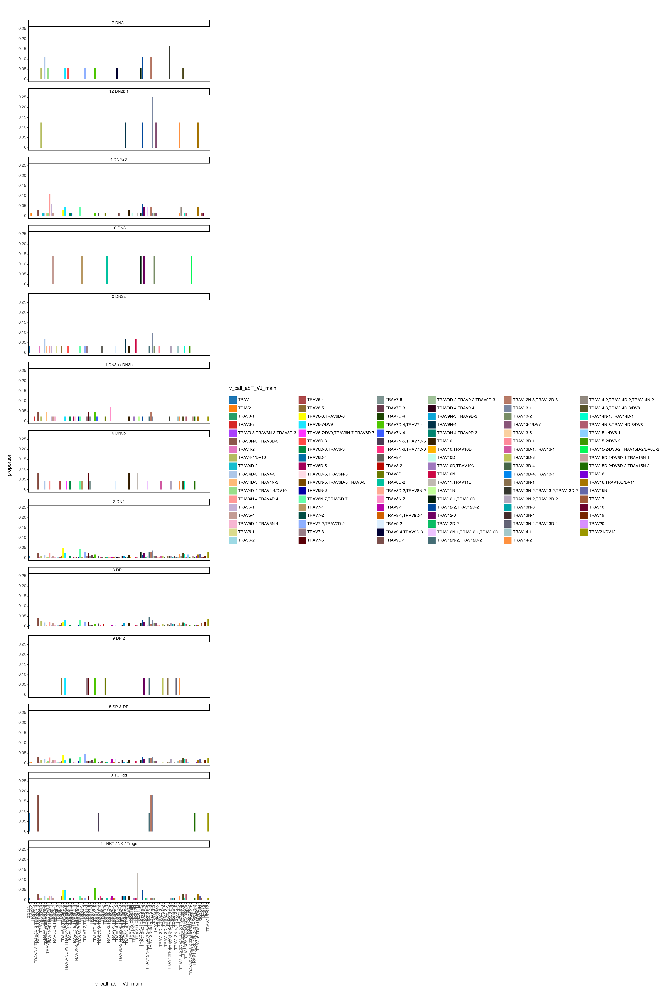

<Figure Size: (2000 x 3000)>

In [1375]:
options.figure_size = (20, 30)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VJ_main", y="proportion", fill="v_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~leiden", ncol=1)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### J gene Alpha Chain (ALL Samples)

In [1376]:
adata_NPF = adata_NP[adata_NP.obs["j_call_abT_VJ_main"] != "None"]
adata_NPF = adata_NPF[adata_NPF.obs["j_call_abT_VJ_main"] != "No_contig"]

In [1377]:
adata_NPF

View of AnnData object with n_obs × n_vars = 2100 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [1378]:
adata_NPF.obs.groupby(["leiden"]).apply(len)

leiden
0 DN3a                  31
1 DN3a / DN3b           44
2 DN4                  373
3 DP 1                 811
4 DN2b 2                73
5 SP & DP              575
6 DN3b                  25
7 DN2a                  18
8 TCRgd                 15
9 DP 2                  12
10 DN3                  10
11 NKT / NK / Tregs    105
12 DN2b 1                8
dtype: int64

In [1379]:
pd.crosstab(adata_NPF.obs['Sample'], adata_NPF.obs['leiden'])

leiden,0 DN3a,1 DN3a / DN3b,2 DN4,3 DP 1,4 DN2b 2,5 SP & DP,6 DN3b,7 DN2a,8 TCRgd,9 DP 2,10 DN3,11 NKT / NK / Tregs,12 DN2b 1
Sample,,,,,,,,,,,,,
Control,18,27,185,404,41,376,14,13,11,8,6,87,3
Krt76-/-,13,17,188,407,32,199,11,5,4,4,4,18,5


In [1380]:
working_df = pd.DataFrame(adata_NPF.obs.groupby("leiden")["j_call_abT_VJ_main"].value_counts())
working_df

j_call_abT_VJ_main
leiden    j_call_abT_VJ_main                    
0 DN3a    TRAJ40                               3
          TRAJ22                               2
          TRAJ58                               2
          TRAJ12                               2
          TRAJ13                               2
...                                          ...
12 DN2b 1 TRAJ28                               0
          TRAJ30                               0
          TRAJ31                               0
          TRAJ31,TRAJ7                         0
          TRDJ1                                0

[650 rows x 1 columns]

In [1381]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,leiden,j_call_abT_VJ_main,counts
0,0 DN3a,TRAJ40,3
1,0 DN3a,TRAJ22,2
2,0 DN3a,TRAJ58,2
3,0 DN3a,TRAJ12,2
4,0 DN3a,TRAJ13,2
...,...,...,...
645,12 DN2b 1,TRAJ28,0
646,12 DN2b 1,TRAJ30,0
647,12 DN2b 1,TRAJ31,0
648,12 DN2b 1,"TRAJ31,TRAJ7",0


In [1382]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.leiden.unique():
    tmp = working_df[working_df["leiden"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'0 DN3a': 31,
 '1 DN3a / DN3b': 44,
 '2 DN4': 373,
 '3 DP 1': 811,
 '4 DN2b 2': 73,
 '5 SP & DP': 575,
 '6 DN3b': 25,
 '7 DN2a': 18,
 '8 TCRgd': 15,
 '9 DP 2': 12,
 '10 DN3': 10,
 '11 NKT / NK / Tregs': 105,
 '12 DN2b 1': 8}

In [1383]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["leiden"]]
    except:
        pass

In [1384]:
working_df

,leiden,j_call_abT_VJ_main,counts,proportion
0,0 DN3a,TRAJ40,3,0.096774
1,0 DN3a,TRAJ22,2,0.064516
2,0 DN3a,TRAJ58,2,0.064516
3,0 DN3a,TRAJ12,2,0.064516
4,0 DN3a,TRAJ13,2,0.064516
...,...,...,...,...
645,12 DN2b 1,TRAJ28,0,0.000000
646,12 DN2b 1,TRAJ30,0,0.000000
647,12 DN2b 1,TRAJ31,0,0.000000
648,12 DN2b 1,"TRAJ31,TRAJ7",0,0.000000


In [1385]:
## Reordering
working_df["leiden"] = working_df[
    "leiden"
].cat.reorder_categories(
    [
        "7 DN2a",
        "12 DN2b 1",
        "4 DN2b 2",
        "10 DN3",
        "0 DN3a",
        "1 DN3a / DN3b",
        "6 DN3b",
        "2 DN4",
        "3 DP 1",
        "9 DP 2",
        "5 SP & DP",
        "8 TCRgd",
        "11 NKT / NK / Tregs",
    ]
)

In [1386]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [1387]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

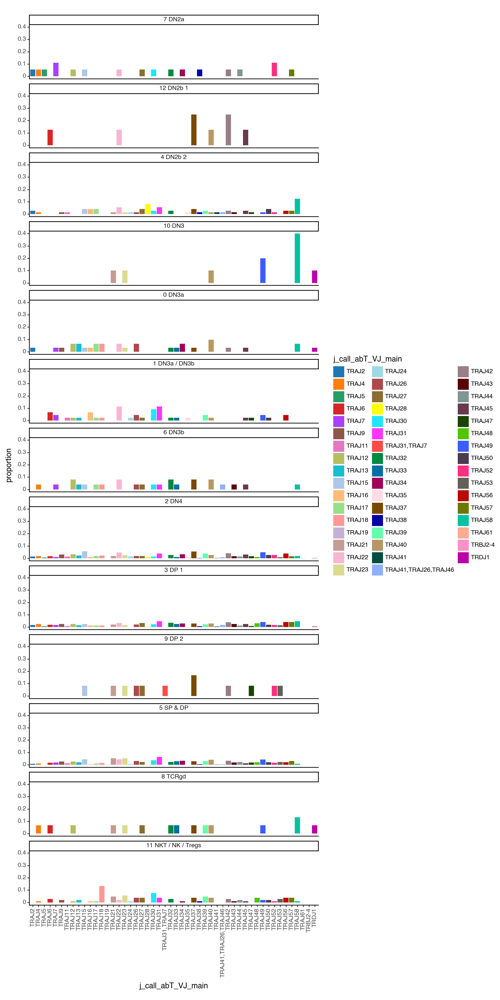

<Figure Size: (1000 x 2000)>

In [1388]:
options.figure_size = (10, 20)
(
    ggplot(
        working_df,
        aes(x="j_call_abT_VJ_main", y="proportion", fill="j_call_abT_VJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~leiden", ncol=1)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)

### V gene Beta Chain (ALL Samples)

In [162]:
adata_NPF = adata_NP[adata_NP.obs["v_call_abT_VDJ_main"] != "None"]
adata_NPF = adata_NPF[adata_NPF.obs["v_call_abT_VDJ_main"] != "No_contig"]

In [163]:
adata_NPF

View of AnnData object with n_obs × n_vars = 7571 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [164]:
adata_NPF.obs.groupby(["leiden"]).apply(len)

leiden
0 DN3a                  952
1 DN3a / DN3b           608
2 DN4                  1968
3 DP 1                 2031
4 DN2b 2                411
5 SP & DP               591
6 DN3b                  541
7 DN2a                   60
8 TCRgd                  97
9 DP 2                   55
10 DN3                  107
11 NKT / NK / Tregs     104
12 DN2b 1                46
dtype: int64

In [165]:
pd.crosstab(adata_NPF.obs['Sample'], adata_NPF.obs['leiden'])

leiden,0 DN3a,1 DN3a / DN3b,2 DN4,3 DP 1,4 DN2b 2,5 SP & DP,6 DN3b,7 DN2a,8 TCRgd,9 DP 2,10 DN3,11 NKT / NK / Tregs,12 DN2b 1
Sample,,,,,,,,,,,,,
Control,556,403,1294,1251,296,387,341,44,63,40,79,84,32
Krt76-/-,396,205,674,780,115,204,200,16,34,15,28,20,14


In [166]:
working_df = pd.DataFrame(adata_NPF.obs.groupby("leiden")["v_call_abT_VDJ_main"].value_counts())
working_df

v_call_abT_VDJ_main
leiden    v_call_abT_VDJ_main                     
0 DN3a    TRBV13-1                              81
          TRBV15                                74
          TRBV19                                72
          TRBV5                                 69
          TRBV13-2                              66
...                                            ...
12 DN2b 1 TRBV23                                 1
          TRBV24                                 1
          TRBV29                                 1
          TRBV30                                 1
          TRBV31                                 1

[269 rows x 1 columns]

In [167]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,leiden,v_call_abT_VDJ_main,counts
0,0 DN3a,TRBV13-1,81
1,0 DN3a,TRBV15,74
2,0 DN3a,TRBV19,72
3,0 DN3a,TRBV5,69
4,0 DN3a,TRBV13-2,66
...,...,...,...
264,12 DN2b 1,TRBV23,1
265,12 DN2b 1,TRBV24,1
266,12 DN2b 1,TRBV29,1
267,12 DN2b 1,TRBV30,1


In [168]:
import numpy as np
import matplotlib.pyplot as plt

In [169]:
from pandas import DataFrame

In [170]:
new_df = working_df[["leiden", "v_call_abT_VDJ_main"]].copy()

In [171]:
print(new_df)

        leiden v_call_abT_VDJ_main
0       0 DN3a            TRBV13-1
1       0 DN3a              TRBV15
2       0 DN3a              TRBV19
3       0 DN3a               TRBV5
4       0 DN3a            TRBV13-2
..         ...                 ...
264  12 DN2b 1              TRBV23
265  12 DN2b 1              TRBV24
266  12 DN2b 1              TRBV29
267  12 DN2b 1              TRBV30
268  12 DN2b 1              TRBV31

[269 rows x 2 columns]


In [172]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.leiden.unique():
    tmp = working_df[working_df["leiden"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'0 DN3a': 952,
 '1 DN3a / DN3b': 608,
 '2 DN4': 1968,
 '3 DP 1': 2031,
 '4 DN2b 2': 411,
 '5 SP & DP': 591,
 '6 DN3b': 541,
 '7 DN2a': 60,
 '8 TCRgd': 97,
 '9 DP 2': 55,
 '10 DN3': 107,
 '11 NKT / NK / Tregs': 104,
 '12 DN2b 1': 46}

In [173]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["leiden"]]
    except:
        pass

In [174]:
working_df

,leiden,v_call_abT_VDJ_main,counts,proportion
0,0 DN3a,TRBV13-1,81,0.085084
1,0 DN3a,TRBV15,74,0.077731
2,0 DN3a,TRBV19,72,0.075630
3,0 DN3a,TRBV5,69,0.072479
4,0 DN3a,TRBV13-2,66,0.069328
...,...,...,...,...
264,12 DN2b 1,TRBV23,1,0.021739
265,12 DN2b 1,TRBV24,1,0.021739
266,12 DN2b 1,TRBV29,1,0.021739
267,12 DN2b 1,TRBV30,1,0.021739


In [175]:
## Reordering
working_df["leiden"] = working_df[
    "leiden"
].cat.reorder_categories(
    [
        "7 DN2a",
        "12 DN2b 1",
        "4 DN2b 2",
        "10 DN3",
        "0 DN3a",
        "1 DN3a / DN3b",
        "6 DN3b",
        "2 DN4",
        "3 DP 1",
        "9 DP 2",
        "5 SP & DP",
        "8 TCRgd",
        "11 NKT / NK / Tregs",
    ]
)

In [176]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [177]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

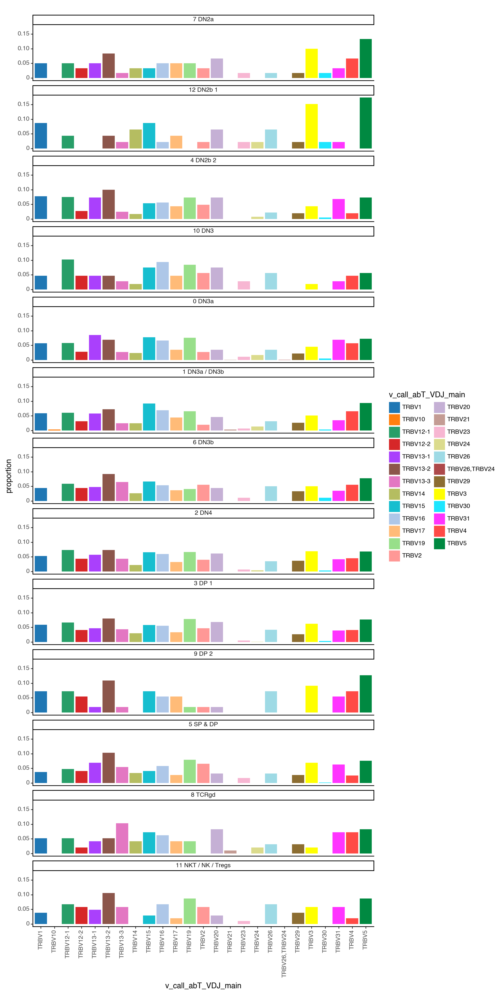

<Figure Size: (1000 x 2000)>

In [179]:
options.figure_size = (10, 20)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VDJ_main", y="proportion", fill="v_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~leiden", ncol=1)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)




In [180]:
options.figure_size = (10, 20)
p = (
    ggplot(
        working_df,
        aes(x="v_call_abT_VDJ_main", y="proportion", fill="v_call_abT_VDJ_main"),
    )
    + geom_bar(stat="identity")
    + facet_wrap("~leiden", ncol=1)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
    )


## IMPORTANT: HOW TO SAVE PLOTS AS PDF: https://stackoverflow.com/questions/48331994/saving-high-resolution-images-with-plotnine

In [185]:
p.save("test2.pdf", height = 20, width = 40, limitsize=False)

/Users/uqssoon/anaconda3/envs/Jaz2023_env/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 40 x 20 in image.
/Users/uqssoon/anaconda3/envs/Jaz2023_env/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: test2.pdf


# Create heatmap

## First... get matrix - work with control first.. 

In [10]:
adata_PF = adata_P[adata_P.obs["v_call_abT_VDJ_main"] != "None"]
adata_PF = adata_PF[adata_PF.obs["v_call_abT_VDJ_main"] != "No_contig"]

In [11]:
adata_PF

View of AnnData object with n_obs × n_vars = 7896 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [42]:
adata_PF_C = adata_PF[adata_PF.obs["Sample"] == "Control"]
adata_PF_C

View of AnnData object with n_obs × n_vars = 5141 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [43]:
working_df1C = pd.DataFrame(adata_PF_C.obs.groupby("leiden")["v_call_abT_VDJ_main"].value_counts())
working_df1C

v_call_abT_VDJ_main
leiden    v_call_abT_VDJ_main                     
0 DN3a    TRBV13-2                              33
          TRBV15                                30
          TRBV13-1                              30
          TRBV5                                 27
          TRBV3                                 24
...                                            ...
12 DN2b 1 TRBV23                                 0
          TRBV21                                 0
          TRBV10                                 0
          TRBV13-3                               0
          TRBV19                                 0

[312 rows x 1 columns]

In [44]:
working_df1C.columns =["counts"]
working_df1C

counts
leiden    v_call_abT_VDJ_main        
0 DN3a    TRBV13-2                 33
          TRBV15                   30
          TRBV13-1                 30
          TRBV5                    27
          TRBV3                    24
...                               ...
12 DN2b 1 TRBV23                    0
          TRBV21                    0
          TRBV10                    0
          TRBV13-3                  0
          TRBV19                    0

[312 rows x 1 columns]

In [45]:
working_df1C.reset_index(inplace = True)
working_df1C

,leiden,v_call_abT_VDJ_main,counts
0,0 DN3a,TRBV13-2,33
1,0 DN3a,TRBV15,30
2,0 DN3a,TRBV13-1,30
3,0 DN3a,TRBV5,27
4,0 DN3a,TRBV3,24
...,...,...,...
307,12 DN2b 1,TRBV23,0
308,12 DN2b 1,TRBV21,0
309,12 DN2b 1,TRBV10,0
310,12 DN2b 1,TRBV13-3,0


In [46]:
newdf1 = working_df1C.pivot(index='leiden', columns='v_call_abT_VDJ_main', values='counts')
print(newdf1)

v_call_abT_VDJ_main  TRBV1  TRBV2  TRBV3  TRBV4  TRBV5  TRBV10  TRBV12-1  \
leiden                                                                     
0 DN3a                  19     18     24     23     27       0        24   
1 DN3a / DN3b           11     11      9      5     22       2        13   
2 DN4                   82     56    103     61    103       0        91   
3 DP 1                  79     71     90     63    119       0        87   
4 DN2b 2                27     17     19      9     32       0        30   
5 SP & DP               23     29     34     18     44       0        26   
6 DN3b                  19     17     17     20     29       0        25   
7 DN2a                   2      2      3      4      5       0         3   
8 TCRgd                  1      0      1      3      5       0         1   
9 DP 2                   4      1      5      4      8       0         4   
10 DN3                   5      6      1      4      7       0        10   
11 NKT / NK 

## Get the J gene too.. 

In [47]:
adata_PF = adata_P[adata_P.obs["j_call_abT_VDJ_main"] != "None"]
adata_PF = adata_PF[adata_PF.obs["j_call_abT_VDJ_main"] != "No_contig"]

In [48]:
adata_PF

View of AnnData object with n_obs × n_vars = 8094 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [49]:
adata_PF_C = adata_PF[adata_PF.obs["Sample"] == "Control"]
adata_PF_C

View of AnnData object with n_obs × n_vars = 5287 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [50]:
working_df2C = pd.DataFrame(adata_PF_C.obs.groupby("leiden")["j_call_abT_VDJ_main"].value_counts())
working_df2C

j_call_abT_VDJ_main
leiden    j_call_abT_VDJ_main                         
0 DN3a    TRBJ2-7                                   60
          TRBJ2-5                                   54
          TRBJ2-4                                   51
          TRBJ1-1                                   47
          TRBJ2-1                                   41
...                                                ...
12 DN2b 1 TRBJ1-6                                    0
          TRBJ1-6,TRBJ2-2,TRBJ2-7                    0
          TRBJ2-3,TRBJ2-4                            0
          TRBJ2-5,TRBJ2-4                            0
          TRBJ2-6                                    0

[221 rows x 1 columns]

In [51]:
working_df2C.columns =["counts"]
working_df2C

counts
leiden    j_call_abT_VDJ_main            
0 DN3a    TRBJ2-7                      60
          TRBJ2-5                      54
          TRBJ2-4                      51
          TRBJ1-1                      47
          TRBJ2-1                      41
...                                   ...
12 DN2b 1 TRBJ1-6                       0
          TRBJ1-6,TRBJ2-2,TRBJ2-7       0
          TRBJ2-3,TRBJ2-4               0
          TRBJ2-5,TRBJ2-4               0
          TRBJ2-6                       0

[221 rows x 1 columns]

In [52]:
working_df2C.reset_index(inplace = True)
working_df2C

,leiden,j_call_abT_VDJ_main,counts
0,0 DN3a,TRBJ2-7,60
1,0 DN3a,TRBJ2-5,54
2,0 DN3a,TRBJ2-4,51
3,0 DN3a,TRBJ1-1,47
4,0 DN3a,TRBJ2-1,41
...,...,...,...
216,12 DN2b 1,TRBJ1-6,0
217,12 DN2b 1,"TRBJ1-6,TRBJ2-2,TRBJ2-7",0
218,12 DN2b 1,"TRBJ2-3,TRBJ2-4",0
219,12 DN2b 1,"TRBJ2-5,TRBJ2-4",0


In [53]:
newdf2 = working_df2C.pivot(index='leiden', columns='j_call_abT_VDJ_main', values='counts')
print(newdf2)

j_call_abT_VDJ_main  TRBJ1-1  TRBJ1-2  TRBJ1-3  TRBJ1-4  TRBJ1-5  \
leiden                                                             
0 DN3a                    47       28       17       35       11   
1 DN3a / DN3b             26       17       13       15        6   
2 DN4                    162       95       71      100       54   
3 DP 1                   151      117       97      108       64   
4 DN2b 2                  34       38       19       24       11   
5 SP & DP                 54       21       27       31       18   
6 DN3b                    32       25       22       13       15   
7 DN2a                     6        2        0        4        1   
8 TCRgd                    3        7        1        3        2   
9 DP 2                     5        4        2        8        2   
10 DN3                     6        6        9        5        5   
11 NKT / NK / Tregs       10        8        5        3        3   
12 DN2b 1                  3        2        1  

In [54]:
newdf1.info()

<class 'pandas.core.frame.DataFrame'>
CategoricalIndex: 13 entries, 0 DN3a to 12 DN2b 1
Data columns (total 24 columns):
 #   Column    Non-Null Count  Dtype
---  ------    --------------  -----
 0   TRBV1     13 non-null     int64
 1   TRBV2     13 non-null     int64
 2   TRBV3     13 non-null     int64
 3   TRBV4     13 non-null     int64
 4   TRBV5     13 non-null     int64
 5   TRBV10    13 non-null     int64
 6   TRBV12-1  13 non-null     int64
 7   TRBV12-2  13 non-null     int64
 8   TRBV13-1  13 non-null     int64
 9   TRBV13-2  13 non-null     int64
 10  TRBV13-3  13 non-null     int64
 11  TRBV14    13 non-null     int64
 12  TRBV15    13 non-null     int64
 13  TRBV16    13 non-null     int64
 14  TRBV17    13 non-null     int64
 15  TRBV19    13 non-null     int64
 16  TRBV20    13 non-null     int64
 17  TRBV21    13 non-null     int64
 18  TRBV23    13 non-null     int64
 19  TRBV24    13 non-null     int64
 20  TRBV26    13 non-null     int64
 21  TRBV29    13 non-null  

In [55]:
newdf2.info()

<class 'pandas.core.frame.DataFrame'>
CategoricalIndex: 13 entries, 0 DN3a to 12 DN2b 1
Data columns (total 17 columns):
 #   Column                   Non-Null Count  Dtype
---  ------                   --------------  -----
 0   TRBJ1-1                  13 non-null     int64
 1   TRBJ1-2                  13 non-null     int64
 2   TRBJ1-3                  13 non-null     int64
 3   TRBJ1-4                  13 non-null     int64
 4   TRBJ1-5                  13 non-null     int64
 5   TRBJ1-5,TRBJ2-2          13 non-null     int64
 6   TRBJ1-6                  13 non-null     int64
 7   TRBJ1-6,TRBJ2-2,TRBJ2-7  13 non-null     int64
 8   TRBJ2-1                  13 non-null     int64
 9   TRBJ2-2                  13 non-null     int64
 10  TRBJ2-3                  13 non-null     int64
 11  TRBJ2-3,TRBJ2-4          13 non-null     int64
 12  TRBJ2-4                  13 non-null     int64
 13  TRBJ2-5                  13 non-null     int64
 14  TRBJ2-5,TRBJ2-4          13 non-null     i

In [56]:
frames = [newdf1,newdf2]
join_df = pd.concat(frames)

In [57]:
join_df


,TRBV1,TRBV2,TRBV3,TRBV4,TRBV5,TRBV10,TRBV12-1,TRBV12-2,TRBV13-1,TRBV13-2,...,"TRBJ1-6,TRBJ2-2,TRBJ2-7",TRBJ2-1,TRBJ2-2,TRBJ2-3,"TRBJ2-3,TRBJ2-4",TRBJ2-4,TRBJ2-5,"TRBJ2-5,TRBJ2-4",TRBJ2-6,TRBJ2-7
leiden,,,,,,,,,,,,,,,,,,,,,
0 DN3a,19.0,18.0,24.0,23.0,27.0,0.0,24.0,13.0,30.0,33.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1 DN3a / DN3b,11.0,11.0,9.0,5.0,22.0,2.0,13.0,7.0,10.0,19.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2 DN4,82.0,56.0,103.0,61.0,103.0,0.0,91.0,56.0,73.0,98.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3 DP 1,79.0,71.0,90.0,63.0,119.0,0.0,87.0,60.0,58.0,125.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4 DN2b 2,27.0,17.0,19.0,9.0,32.0,0.0,30.0,11.0,34.0,44.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5 SP & DP,23.0,29.0,34.0,18.0,44.0,0.0,26.0,21.0,45.0,54.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6 DN3b,19.0,17.0,17.0,20.0,29.0,0.0,25.0,16.0,20.0,35.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7 DN2a,2.0,2.0,3.0,4.0,5.0,0.0,3.0,2.0,1.0,4.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8 TCRgd,1.0,0.0,1.0,3.0,5.0,0.0,1.0,2.0,1.0,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [58]:
import seaborn as sns
%matplotlib inline

<Axes: ylabel='leiden'>

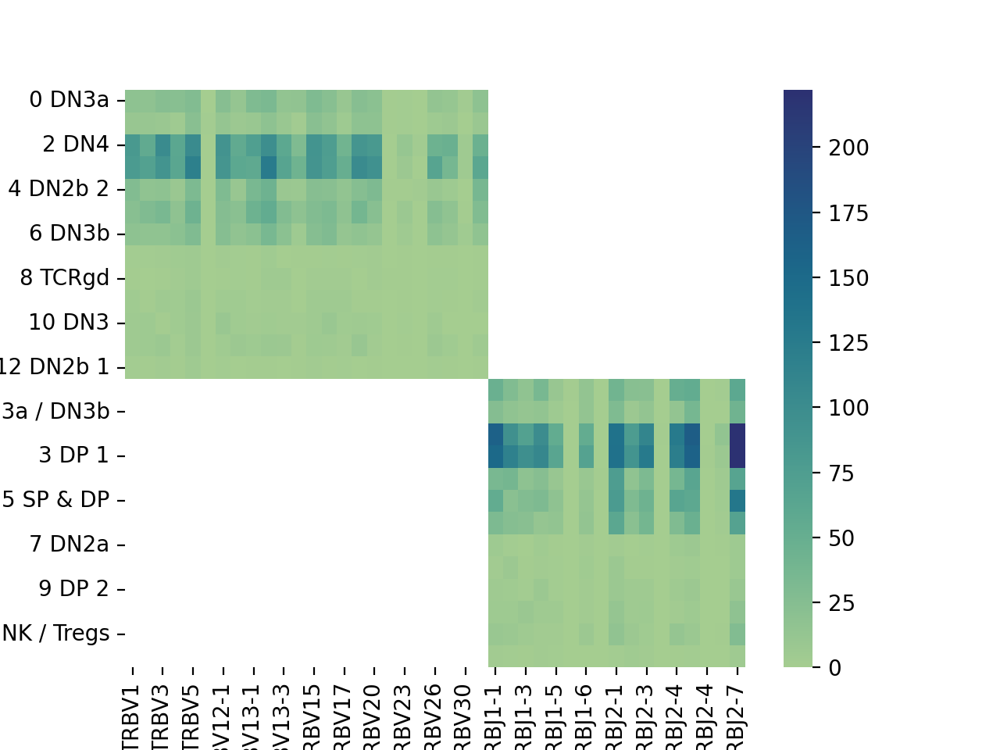

In [59]:
sns.heatmap(join_df, cmap="crest")


In [60]:
result = pd.merge(newdf1, newdf2, on=["leiden"])

In [61]:
print(result)

                     TRBV1  TRBV2  TRBV3  TRBV4  TRBV5  TRBV10  TRBV12-1  \
leiden                                                                     
0 DN3a                  19     18     24     23     27       0        24   
1 DN3a / DN3b           11     11      9      5     22       2        13   
2 DN4                   82     56    103     61    103       0        91   
3 DP 1                  79     71     90     63    119       0        87   
4 DN2b 2                27     17     19      9     32       0        30   
5 SP & DP               23     29     34     18     44       0        26   
6 DN3b                  19     17     17     20     29       0        25   
7 DN2a                   2      2      3      4      5       0         3   
8 TCRgd                  1      0      1      3      5       0         1   
9 DP 2                   4      1      5      4      8       0         4   
10 DN3                   5      6      1      4      7       0        10   
11 NKT / NK 

In [62]:
result.info()

<class 'pandas.core.frame.DataFrame'>
CategoricalIndex: 13 entries, 0 DN3a to 12 DN2b 1
Data columns (total 41 columns):
 #   Column                   Non-Null Count  Dtype
---  ------                   --------------  -----
 0   TRBV1                    13 non-null     int64
 1   TRBV2                    13 non-null     int64
 2   TRBV3                    13 non-null     int64
 3   TRBV4                    13 non-null     int64
 4   TRBV5                    13 non-null     int64
 5   TRBV10                   13 non-null     int64
 6   TRBV12-1                 13 non-null     int64
 7   TRBV12-2                 13 non-null     int64
 8   TRBV13-1                 13 non-null     int64
 9   TRBV13-2                 13 non-null     int64
 10  TRBV13-3                 13 non-null     int64
 11  TRBV14                   13 non-null     int64
 12  TRBV15                   13 non-null     int64
 13  TRBV16                   13 non-null     int64
 14  TRBV17                   13 non-null     i

<Axes: ylabel='leiden'>

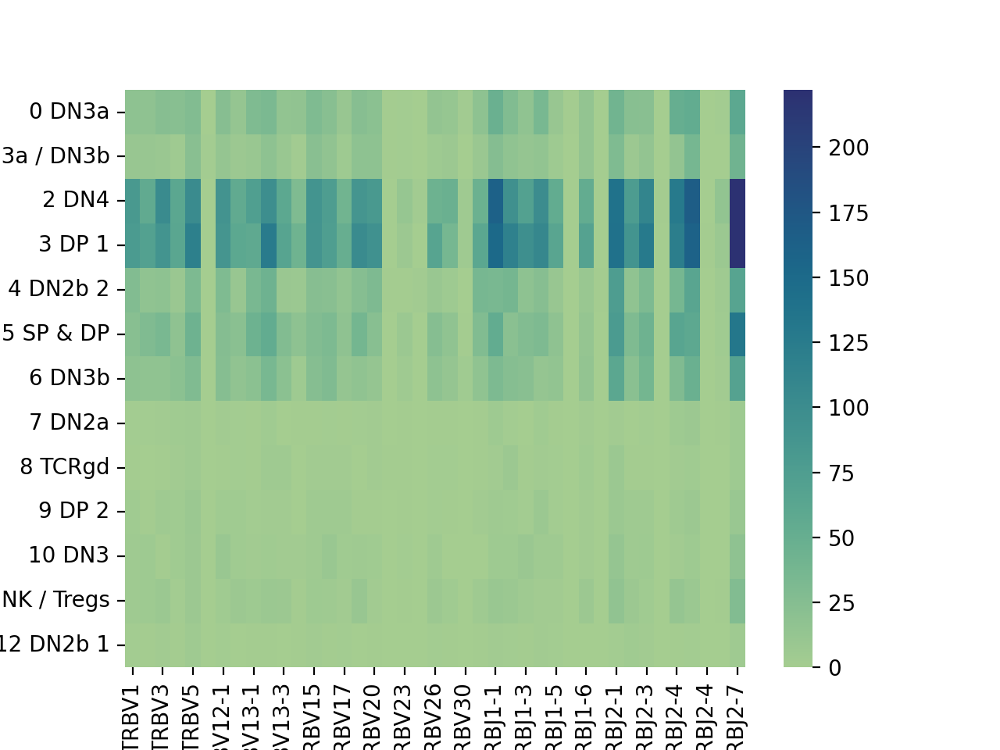

In [63]:
sns.heatmap(result, cmap="crest")

### Redo as proportion

In [12]:
adata_PF = adata_P[adata_P.obs["v_call_abT_VDJ_main"] != "None"]
adata_PF = adata_PF[adata_PF.obs["v_call_abT_VDJ_main"] != "No_contig"]

In [13]:
adata_PF

View of AnnData object with n_obs × n_vars = 7896 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [14]:
adata_PF_C = adata_PF[adata_PF.obs["Sample"] == "Control"]
adata_PF_C

View of AnnData object with n_obs × n_vars = 5141 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [15]:
working_df1C = pd.DataFrame(adata_PF_C.obs.groupby("leiden")["v_call_abT_VDJ_main"].value_counts())
working_df1C

v_call_abT_VDJ_main
leiden    v_call_abT_VDJ_main                     
0 DN3a    TRBV13-2                              33
          TRBV15                                30
          TRBV13-1                              30
          TRBV5                                 27
          TRBV3                                 24
...                                            ...
12 DN2b 1 TRBV23                                 0
          TRBV21                                 0
          TRBV10                                 0
          TRBV13-3                               0
          TRBV19                                 0

[312 rows x 1 columns]

In [16]:
working_df1C.columns =["counts"]
working_df1C

counts
leiden    v_call_abT_VDJ_main        
0 DN3a    TRBV13-2                 33
          TRBV15                   30
          TRBV13-1                 30
          TRBV5                    27
          TRBV3                    24
...                               ...
12 DN2b 1 TRBV23                    0
          TRBV21                    0
          TRBV10                    0
          TRBV13-3                  0
          TRBV19                    0

[312 rows x 1 columns]

In [17]:
working_df1C.reset_index(inplace = True)
working_df1C

,leiden,v_call_abT_VDJ_main,counts
0,0 DN3a,TRBV13-2,33
1,0 DN3a,TRBV15,30
2,0 DN3a,TRBV13-1,30
3,0 DN3a,TRBV5,27
4,0 DN3a,TRBV3,24
...,...,...,...
307,12 DN2b 1,TRBV23,0
308,12 DN2b 1,TRBV21,0
309,12 DN2b 1,TRBV10,0
310,12 DN2b 1,TRBV13-3,0


In [18]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df1C.leiden.unique():
    tmp = working_df1C[working_df1C["leiden"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'0 DN3a': 401,
 '1 DN3a / DN3b': 229,
 '2 DN4': 1348,
 '3 DP 1': 1448,
 '4 DN2b 2': 414,
 '5 SP & DP': 558,
 '6 DN3b': 379,
 '7 DN2a': 40,
 '8 TCRgd': 43,
 '9 DP 2': 62,
 '10 DN3': 85,
 '11 NKT / NK / Tregs': 106,
 '12 DN2b 1': 28}

In [19]:
working_df1C["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df1C.iterrows():
    try:
        working_df1C.at[i, "proportion"] = row["counts"] / total_count_dict[row["leiden"]]
    except:
        pass

In [20]:
working_df1C

,leiden,v_call_abT_VDJ_main,counts,proportion
0,0 DN3a,TRBV13-2,33,0.082294
1,0 DN3a,TRBV15,30,0.074813
2,0 DN3a,TRBV13-1,30,0.074813
3,0 DN3a,TRBV5,27,0.067332
4,0 DN3a,TRBV3,24,0.059850
...,...,...,...,...
307,12 DN2b 1,TRBV23,0,0.000000
308,12 DN2b 1,TRBV21,0,0.000000
309,12 DN2b 1,TRBV10,0,0.000000
310,12 DN2b 1,TRBV13-3,0,0.000000


In [21]:
newdf1 = working_df1C.pivot(index='leiden', columns='v_call_abT_VDJ_main', values='proportion')
print(newdf1)

v_call_abT_VDJ_main     TRBV1     TRBV2     TRBV3     TRBV4     TRBV5  \
leiden                                                                  
0 DN3a               0.047382  0.044888  0.059850  0.057357  0.067332   
1 DN3a / DN3b        0.048035  0.048035  0.039301  0.021834  0.096070   
2 DN4                0.060831  0.041543  0.076409  0.045252  0.076409   
3 DP 1               0.054558  0.049033  0.062155  0.043508  0.082182   
4 DN2b 2             0.065217  0.041063  0.045894  0.021739  0.077295   
5 SP & DP            0.041219  0.051971  0.060932  0.032258  0.078853   
6 DN3b               0.050132  0.044855  0.044855  0.052770  0.076517   
7 DN2a               0.050000  0.050000  0.075000  0.100000  0.125000   
8 TCRgd              0.023256  0.000000  0.023256  0.069767  0.116279   
9 DP 2               0.064516  0.016129  0.080645  0.064516  0.129032   
10 DN3               0.058824  0.070588  0.011765  0.047059  0.082353   
11 NKT / NK / Tregs  0.047170  0.056604  0.075472  

In [22]:
import seaborn as sns
%matplotlib inline

<Axes: xlabel='v_call_abT_VDJ_main', ylabel='leiden'>

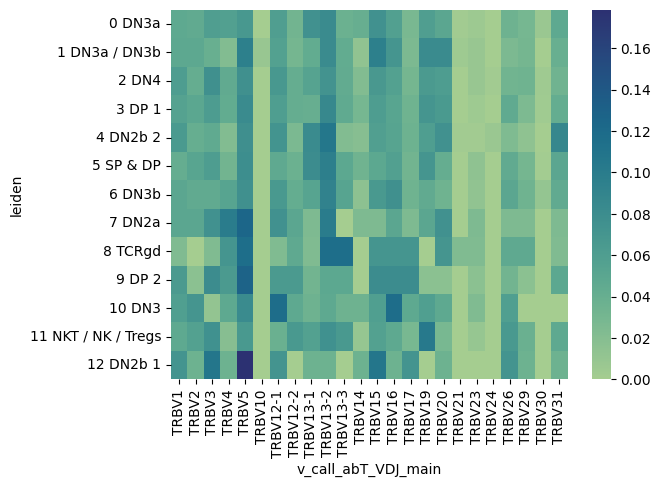

In [23]:
sns.heatmap(newdf1, cmap="crest")

#### Now get the rest of the VJ genes...
#### Here, J gene Beta Chain 

In [24]:
adata_PF = adata_P[adata_P.obs["j_call_abT_VDJ_main"] != "None"]
adata_PF = adata_PF[adata_PF.obs["j_call_abT_VDJ_main"] != "No_contig"]

In [25]:
adata_PF

View of AnnData object with n_obs × n_vars = 8094 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [26]:
adata_PF_C = adata_PF[adata_PF.obs["Sample"] == "Control"]
adata_PF_C

View of AnnData object with n_obs × n_vars = 5287 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [27]:
working_df2C = pd.DataFrame(adata_PF_C.obs.groupby("leiden")["j_call_abT_VDJ_main"].value_counts())
working_df2C

j_call_abT_VDJ_main
leiden    j_call_abT_VDJ_main                         
0 DN3a    TRBJ2-7                                   60
          TRBJ2-5                                   54
          TRBJ2-4                                   51
          TRBJ1-1                                   47
          TRBJ2-1                                   41
...                                                ...
12 DN2b 1 TRBJ1-6                                    0
          TRBJ1-6,TRBJ2-2,TRBJ2-7                    0
          TRBJ2-3,TRBJ2-4                            0
          TRBJ2-5,TRBJ2-4                            0
          TRBJ2-6                                    0

[221 rows x 1 columns]

In [28]:
working_df2C.columns =["counts"]
working_df2C

counts
leiden    j_call_abT_VDJ_main            
0 DN3a    TRBJ2-7                      60
          TRBJ2-5                      54
          TRBJ2-4                      51
          TRBJ1-1                      47
          TRBJ2-1                      41
...                                   ...
12 DN2b 1 TRBJ1-6                       0
          TRBJ1-6,TRBJ2-2,TRBJ2-7       0
          TRBJ2-3,TRBJ2-4               0
          TRBJ2-5,TRBJ2-4               0
          TRBJ2-6                       0

[221 rows x 1 columns]

In [29]:
working_df2C.reset_index(inplace = True)
working_df2C

,leiden,j_call_abT_VDJ_main,counts
0,0 DN3a,TRBJ2-7,60
1,0 DN3a,TRBJ2-5,54
2,0 DN3a,TRBJ2-4,51
3,0 DN3a,TRBJ1-1,47
4,0 DN3a,TRBJ2-1,41
...,...,...,...
216,12 DN2b 1,TRBJ1-6,0
217,12 DN2b 1,"TRBJ1-6,TRBJ2-2,TRBJ2-7",0
218,12 DN2b 1,"TRBJ2-3,TRBJ2-4",0
219,12 DN2b 1,"TRBJ2-5,TRBJ2-4",0


In [30]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df2C.leiden.unique():
    tmp = working_df2C[working_df1C["leiden"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

/var/folders/x6/w5mj53710kqfd0s039gvbv880000gs/T/ipykernel_2883/2365146967.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.


{'0 DN3a': 587,
 '1 DN3a / DN3b': 1450,
 '2 DN4': 1721,
 '3 DP 1': 750,
 '4 DN2b 2': 413,
 '5 SP & DP': 72,
 '6 DN3b': 69,
 '7 DN2a': 159,
 '8 TCRgd': 66,
 '9 DP 2': 0,
 '10 DN3': 0,
 '11 NKT / NK / Tregs': 0,
 '12 DN2b 1': 0}

In [31]:
working_df2C["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df2C.iterrows():
    try:
        working_df2C.at[i, "proportion"] = row["counts"] / total_count_dict[row["leiden"]]
    except:
        pass

/var/folders/x6/w5mj53710kqfd0s039gvbv880000gs/T/ipykernel_2883/915408193.py:5: RuntimeWarning: divide by zero encountered in scalar divide
/var/folders/x6/w5mj53710kqfd0s039gvbv880000gs/T/ipykernel_2883/915408193.py:5: RuntimeWarning: invalid value encountered in scalar divide


In [32]:
working_df2C

,leiden,j_call_abT_VDJ_main,counts,proportion
0,0 DN3a,TRBJ2-7,60,0.102215
1,0 DN3a,TRBJ2-5,54,0.091993
2,0 DN3a,TRBJ2-4,51,0.086882
3,0 DN3a,TRBJ1-1,47,0.080068
4,0 DN3a,TRBJ2-1,41,0.069847
...,...,...,...,...
216,12 DN2b 1,TRBJ1-6,0,NaN
217,12 DN2b 1,"TRBJ1-6,TRBJ2-2,TRBJ2-7",0,NaN
218,12 DN2b 1,"TRBJ2-3,TRBJ2-4",0,NaN
219,12 DN2b 1,"TRBJ2-5,TRBJ2-4",0,NaN


In [33]:
newdf2 = working_df2C.pivot(index='leiden', columns='j_call_abT_VDJ_main', values='proportion')
print(newdf2)

j_call_abT_VDJ_main   TRBJ1-1   TRBJ1-2   TRBJ1-3   TRBJ1-4   TRBJ1-5  \
leiden                                                                  
0 DN3a               0.080068  0.047700  0.028961  0.059625  0.018739   
1 DN3a / DN3b        0.017931  0.011724  0.008966  0.010345  0.004138   
2 DN4                0.094131  0.055200  0.041255  0.058106  0.031377   
3 DP 1               0.201333  0.156000  0.129333  0.144000  0.085333   
4 DN2b 2             0.082324  0.092010  0.046005  0.058111  0.026634   
5 SP & DP            0.750000  0.291667  0.375000  0.430556  0.250000   
6 DN3b               0.463768  0.362319  0.318841  0.188406  0.217391   
7 DN2a               0.037736  0.012579  0.000000  0.025157  0.006289   
8 TCRgd              0.045455  0.106061  0.015152  0.045455  0.030303   
9 DP 2                    inf       inf       inf       inf       inf   
10 DN3                    inf       inf       inf       inf       inf   
11 NKT / NK / Tregs       inf       inf       inf  

#### Now get V gene Alpha chain

In [34]:
adata_PF = adata_P[adata_P.obs["v_call_abT_VJ_main"] != "None"]
adata_PF = adata_PF[adata_PF.obs["v_call_abT_VJ_main"] != "No_contig"]

In [35]:
adata_PF

View of AnnData object with n_obs × n_vars = 2530 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [36]:
adata_PF_C = adata_PF[adata_PF.obs["Sample"] == "Control"]
adata_PF_C

View of AnnData object with n_obs × n_vars = 1444 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [37]:
working_df3C = pd.DataFrame(adata_PF_C.obs.groupby("leiden")["v_call_abT_VJ_main"].value_counts())
working_df3C

v_call_abT_VJ_main
leiden    v_call_abT_VJ_main                         
0 DN3a    TRAV6D-7,TRAV6N-7                         2
          TRAV14D-3/DV8,TRAV14N-3                   1
          TRAV10                                    1
          TRAV10N                                   1
          TRAV12D-2,TRAV12N-2                       1
...                                               ...
12 DN2b 1 TRAV7-3                                   0
          TRAV7-2                                   0
          TRAV7-1                                   0
          TRAV6N-6                                  0
          TRAV21/DV12                               0

[1352 rows x 1 columns]

In [38]:
working_df3C.columns =["counts"]
working_df3C

counts
leiden    v_call_abT_VJ_main             
0 DN3a    TRAV6D-7,TRAV6N-7             2
          TRAV14D-3/DV8,TRAV14N-3       1
          TRAV10                        1
          TRAV10N                       1
          TRAV12D-2,TRAV12N-2           1
...                                   ...
12 DN2b 1 TRAV7-3                       0
          TRAV7-2                       0
          TRAV7-1                       0
          TRAV6N-6                      0
          TRAV21/DV12                   0

[1352 rows x 1 columns]

In [39]:
working_df3C.reset_index(inplace = True)
working_df3C

,leiden,v_call_abT_VJ_main,counts
0,0 DN3a,"TRAV6D-7,TRAV6N-7",2
1,0 DN3a,"TRAV14D-3/DV8,TRAV14N-3",1
2,0 DN3a,TRAV10,1
3,0 DN3a,TRAV10N,1
4,0 DN3a,"TRAV12D-2,TRAV12N-2",1
...,...,...,...
1347,12 DN2b 1,TRAV7-3,0
1348,12 DN2b 1,TRAV7-2,0
1349,12 DN2b 1,TRAV7-1,0
1350,12 DN2b 1,TRAV6N-6,0


In [40]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df3C.leiden.unique():
    tmp = working_df3C[working_df3C["leiden"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'0 DN3a': 20,
 '1 DN3a / DN3b': 26,
 '2 DN4': 188,
 '3 DP 1': 454,
 '4 DN2b 2': 55,
 '5 SP & DP': 536,
 '6 DN3b': 15,
 '7 DN2a': 12,
 '8 TCRgd': 10,
 '9 DP 2': 10,
 '10 DN3': 6,
 '11 NKT / NK / Tregs': 109,
 '12 DN2b 1': 3}

In [41]:
working_df3C["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df3C.iterrows():
    try:
        working_df3C.at[i, "proportion"] = row["counts"] / total_count_dict[row["leiden"]]
    except:
        pass

In [42]:
working_df3C

,leiden,v_call_abT_VJ_main,counts,proportion
0,0 DN3a,"TRAV6D-7,TRAV6N-7",2,0.10
1,0 DN3a,"TRAV14D-3/DV8,TRAV14N-3",1,0.05
2,0 DN3a,TRAV10,1,0.05
3,0 DN3a,TRAV10N,1,0.05
4,0 DN3a,"TRAV12D-2,TRAV12N-2",1,0.05
...,...,...,...,...
1347,12 DN2b 1,TRAV7-3,0,0.00
1348,12 DN2b 1,TRAV7-2,0,0.00
1349,12 DN2b 1,TRAV7-1,0,0.00
1350,12 DN2b 1,TRAV6N-6,0,0.00


In [43]:
newdf3 = working_df3C.pivot(index='leiden', columns='v_call_abT_VJ_main', values='proportion')
print(newdf3)

v_call_abT_VJ_main      TRAV1     TRAV2   TRAV3-3  TRAV3-3,TRAV3D-3,TRAV3N-3  \
leiden                                                                         
0 DN3a               0.050000  0.000000  0.000000                   0.000000   
1 DN3a / DN3b        0.000000  0.000000  0.038462                   0.000000   
2 DN4                0.005319  0.000000  0.000000                   0.000000   
3 DP 1               0.008811  0.002203  0.000000                   0.002203   
4 DN2b 2             0.000000  0.000000  0.000000                   0.000000   
5 SP & DP            0.001866  0.001866  0.000000                   0.000000   
6 DN3b               0.000000  0.000000  0.000000                   0.000000   
7 DN2a               0.000000  0.000000  0.000000                   0.000000   
8 TCRgd              0.100000  0.000000  0.000000                   0.000000   
9 DP 2               0.000000  0.000000  0.000000                   0.000000   
10 DN3               0.166667  0.000000 

#### Now get J gene Alpha chain

In [44]:
adata_PF = adata_P[adata_P.obs["j_call_abT_VJ_main"] != "None"]
adata_PF = adata_PF[adata_PF.obs["j_call_abT_VJ_main"] != "No_contig"]

In [45]:
adata_PF

View of AnnData object with n_obs × n_vars = 2595 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [46]:
adata_PF_C = adata_PF[adata_PF.obs["Sample"] == "Control"]
adata_PF_C

View of AnnData object with n_obs × n_vars = 1490 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [47]:
working_df4C = pd.DataFrame(adata_PF_C.obs.groupby("leiden")["j_call_abT_VJ_main"].value_counts())
working_df4C

j_call_abT_VJ_main
leiden    j_call_abT_VJ_main                    
0 DN3a    TRAJ12                               3
          TRAJ40                               2
          TRAJ17                               2
          TRAJ2                                1
          TRAJ18                               1
...                                          ...
12 DN2b 1 TRAJ27                               0
          TRAJ28                               0
          TRAJ30                               0
          TRAJ31                               0
          TRDJ1                                0

[637 rows x 1 columns]

In [48]:
working_df4C.columns =["counts"]
working_df4C

counts
leiden    j_call_abT_VJ_main        
0 DN3a    TRAJ12                   3
          TRAJ40                   2
          TRAJ17                   2
          TRAJ2                    1
          TRAJ18                   1
...                              ...
12 DN2b 1 TRAJ27                   0
          TRAJ28                   0
          TRAJ30                   0
          TRAJ31                   0
          TRDJ1                    0

[637 rows x 1 columns]

In [49]:
working_df4C.reset_index(inplace = True)
working_df4C

,leiden,j_call_abT_VJ_main,counts
0,0 DN3a,TRAJ12,3
1,0 DN3a,TRAJ40,2
2,0 DN3a,TRAJ17,2
3,0 DN3a,TRAJ2,1
4,0 DN3a,TRAJ18,1
...,...,...,...
632,12 DN2b 1,TRAJ27,0
633,12 DN2b 1,TRAJ28,0
634,12 DN2b 1,TRAJ30,0
635,12 DN2b 1,TRAJ31,0


In [50]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df4C.leiden.unique():
    tmp = working_df4C[working_df4C["leiden"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'0 DN3a': 21,
 '1 DN3a / DN3b': 27,
 '2 DN4': 204,
 '3 DP 1': 470,
 '4 DN2b 2': 62,
 '5 SP & DP': 539,
 '6 DN3b': 15,
 '7 DN2a': 12,
 '8 TCRgd': 11,
 '9 DP 2': 10,
 '10 DN3': 7,
 '11 NKT / NK / Tregs': 109,
 '12 DN2b 1': 3}

In [51]:
working_df4C["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df4C.iterrows():
    try:
        working_df4C.at[i, "proportion"] = row["counts"] / total_count_dict[row["leiden"]]
    except:
        pass

In [52]:
working_df4C

,leiden,j_call_abT_VJ_main,counts,proportion
0,0 DN3a,TRAJ12,3,0.142857
1,0 DN3a,TRAJ40,2,0.095238
2,0 DN3a,TRAJ17,2,0.095238
3,0 DN3a,TRAJ2,1,0.047619
4,0 DN3a,TRAJ18,1,0.047619
...,...,...,...,...
632,12 DN2b 1,TRAJ27,0,0.000000
633,12 DN2b 1,TRAJ28,0,0.000000
634,12 DN2b 1,TRAJ30,0,0.000000
635,12 DN2b 1,TRAJ31,0,0.000000


In [53]:
newdf4 = working_df4C.pivot(index='leiden', columns='j_call_abT_VJ_main', values='proportion')
print(newdf4)

j_call_abT_VJ_main      TRAJ2     TRAJ4     TRAJ5     TRAJ6     TRAJ7  \
leiden                                                                  
0 DN3a               0.047619  0.047619  0.000000  0.000000  0.047619   
1 DN3a / DN3b        0.000000  0.000000  0.000000  0.037037  0.037037   
2 DN4                0.009804  0.024510  0.009804  0.009804  0.019608   
3 DP 1               0.019149  0.027660  0.006383  0.021277  0.023404   
4 DN2b 2             0.032258  0.016129  0.000000  0.000000  0.000000   
5 SP & DP            0.009276  0.012987  0.001855  0.018553  0.018553   
6 DN3b               0.000000  0.066667  0.000000  0.000000  0.066667   
7 DN2a               0.083333  0.083333  0.000000  0.000000  0.166667   
8 TCRgd              0.000000  0.000000  0.090909  0.090909  0.000000   
9 DP 2               0.000000  0.000000  0.000000  0.000000  0.000000   
10 DN3               0.000000  0.000000  0.000000  0.000000  0.000000   
11 NKT / NK / Tregs  0.000000  0.009174  0.009174  

### Now do the merging and create heatmap

In [192]:
# 24, 17, 104, 13 - NUMBER OF COLUMNS for each dataframe

<class 'pandas.core.frame.DataFrame'>
CategoricalIndex: 13 entries, 0 DN3a to 12 DN2b 1
Data columns (total 49 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   TRAJ2                 13 non-null     float64
 1   TRAJ4                 13 non-null     float64
 2   TRAJ5                 13 non-null     float64
 3   TRAJ6                 13 non-null     float64
 4   TRAJ7                 13 non-null     float64
 5   TRAJ9                 13 non-null     float64
 6   TRAJ11                13 non-null     float64
 7   TRAJ12                13 non-null     float64
 8   TRAJ13                13 non-null     float64
 9   TRAJ15                13 non-null     float64
 10  TRAJ16                13 non-null     float64
 11  TRAJ17                13 non-null     float64
 12  TRAJ18                13 non-null     float64
 13  TRAJ19                13 non-null     float64
 14  TRAJ21                13 non-null     float64
 15  TRAJ22 

In [54]:
newdf2.info()

<class 'pandas.core.frame.DataFrame'>
CategoricalIndex: 13 entries, 0 DN3a to 12 DN2b 1
Data columns (total 17 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   TRBJ1-1                  13 non-null     float64
 1   TRBJ1-2                  13 non-null     float64
 2   TRBJ1-3                  13 non-null     float64
 3   TRBJ1-4                  13 non-null     float64
 4   TRBJ1-5                  13 non-null     float64
 5   TRBJ1-5,TRBJ2-2          9 non-null      float64
 6   TRBJ1-6                  12 non-null     float64
 7   TRBJ1-6,TRBJ2-2,TRBJ2-7  9 non-null      float64
 8   TRBJ2-1                  13 non-null     float64
 9   TRBJ2-2                  13 non-null     float64
 10  TRBJ2-3                  13 non-null     float64
 11  TRBJ2-3,TRBJ2-4          9 non-null      float64
 12  TRBJ2-4                  13 non-null     float64
 13  TRBJ2-5                  13 non-null     float64
 14  TRBJ2-5,TR

In [55]:
result = pd.merge(newdf1, newdf2, on='leiden').merge(newdf3, on='leiden').merge(newdf4, on='leiden')

In [56]:
print(result)

                        TRBV1     TRBV2     TRBV3     TRBV4     TRBV5  \
leiden                                                                  
0 DN3a               0.047382  0.044888  0.059850  0.057357  0.067332   
1 DN3a / DN3b        0.048035  0.048035  0.039301  0.021834  0.096070   
2 DN4                0.060831  0.041543  0.076409  0.045252  0.076409   
3 DP 1               0.054558  0.049033  0.062155  0.043508  0.082182   
4 DN2b 2             0.065217  0.041063  0.045894  0.021739  0.077295   
5 SP & DP            0.041219  0.051971  0.060932  0.032258  0.078853   
6 DN3b               0.050132  0.044855  0.044855  0.052770  0.076517   
7 DN2a               0.050000  0.050000  0.075000  0.100000  0.125000   
8 TCRgd              0.023256  0.000000  0.023256  0.069767  0.116279   
9 DP 2               0.064516  0.016129  0.080645  0.064516  0.129032   
10 DN3               0.058824  0.070588  0.011765  0.047059  0.082353   
11 NKT / NK / Tregs  0.047170  0.056604  0.075472  

In [174]:
result.to_csv("result_control_111223.csv")

In [57]:
# convert NA values to 0
result[pd.isnull(result)] = 0

In [58]:
# convert inf to 0
result[np.isinf(result)] = 0

In [59]:
result.info()

<class 'pandas.core.frame.DataFrame'>
CategoricalIndex: 13 entries, 0 DN3a to 12 DN2b 1
Columns: 194 entries, TRBV1 to TRDJ1
dtypes: float64(194)
memory usage: 20.4 KB


<Axes: ylabel='leiden'>

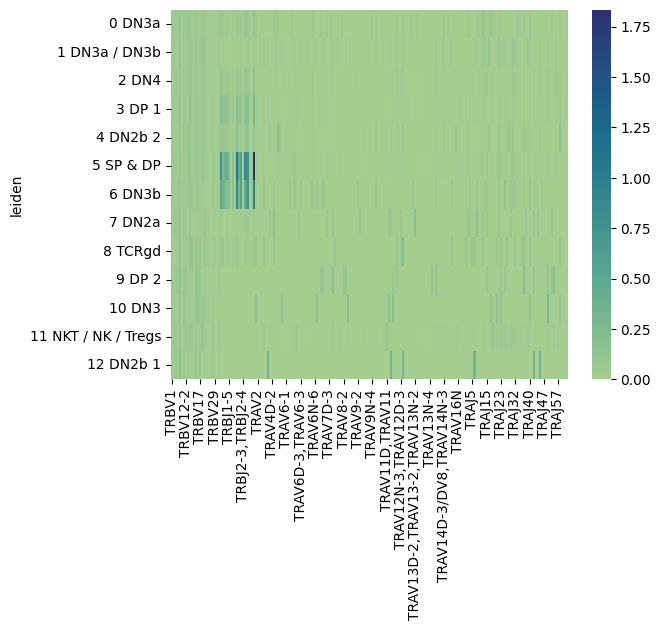

In [60]:
#options.figure_size = (20,30)
sns.heatmap(result, cmap="crest")

<Axes: ylabel='leiden'>

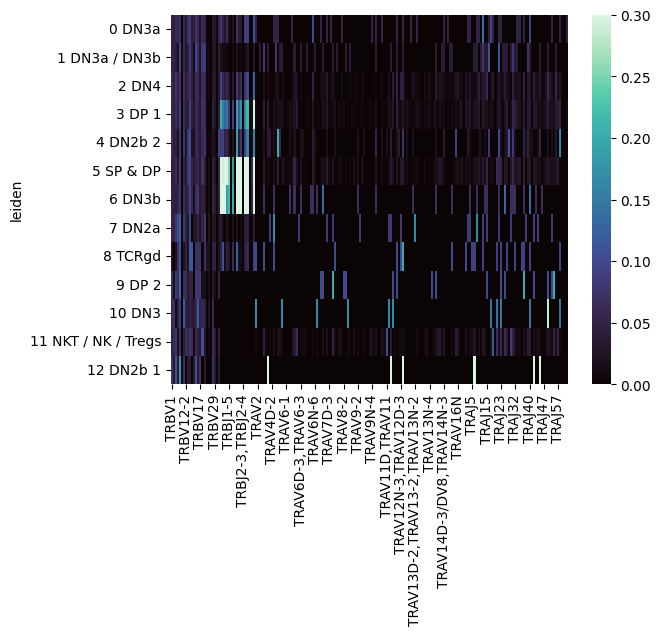

In [61]:
#options.figure_size = (20, 30)
sns.heatmap(result, cmap="mako", yticklabels=True, vmin =0, vmax = 0.3)

#plt.savefig("tests.pdf")


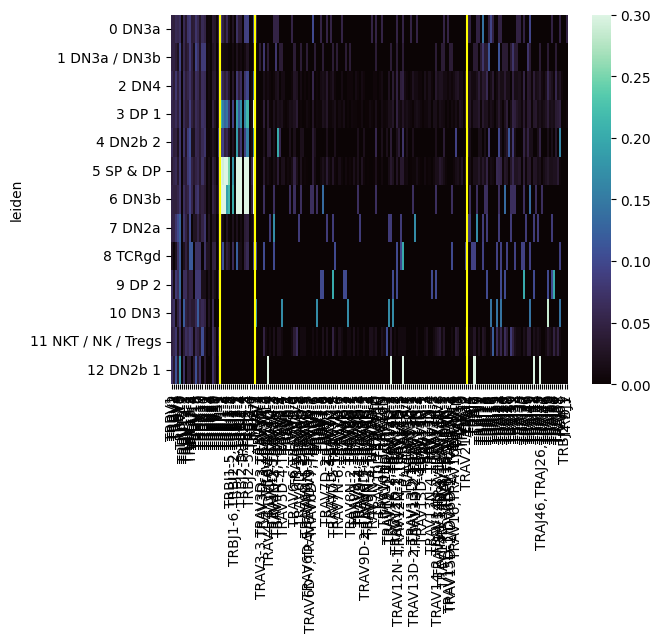

In [63]:
#options.figure_size = (20, 30)
ax = sns.heatmap(result, cmap="mako", xticklabels=True, vmin =0, vmax = 0.3)
ax.axvline(x = 24, ymin = 0, ymax = 1.0, color = "yellow")
ax.axvline(x = 24+17, ymin = 0, ymax = 1.0, color = "yellow")
ax.axvline(x = 24+17+104, ymin = 0, ymax = 1.0, color = "yellow")
plt.savefig("Heatmap_VJgeneusage_Control_Final_111223.pdf")


In [64]:
result = result.reindex([
        "7 DN2a",
        "12 DN2b 1",
        "4 DN2b 2",
        "10 DN3",
        "0 DN3a",
        "1 DN3a / DN3b",
        "6 DN3b",
        "2 DN4",
        "3 DP 1",
        "9 DP 2",
        "5 SP & DP",
        "8 TCRgd",
        "11 NKT / NK / Tregs",
    ])

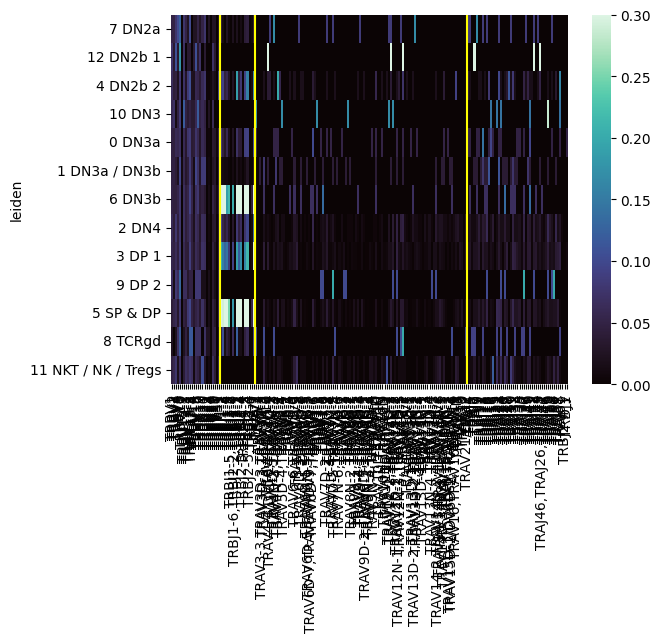

In [66]:
ax = sns.heatmap(result, cmap="mako", xticklabels=True, vmin =0, vmax = 0.3)
ax.axvline(x = 24, ymin = 0, ymax = 1.0, color = "yellow")
ax.axvline(x = 24+17, ymin = 0, ymax = 1.0, color = "yellow")
ax.axvline(x = 24+17+104, ymin = 0, ymax = 1.0, color = "yellow")
plt.savefig("Heatmap_VJgeneusage_Control_Final_111223_v2.pdf")


In [67]:
import matplotlib.pyplot as plt
fig = plt.gcf()

<Figure size 640x480 with 0 Axes>

In [68]:
# Change seaborn plot size
fig.set_size_inches(20, 30)

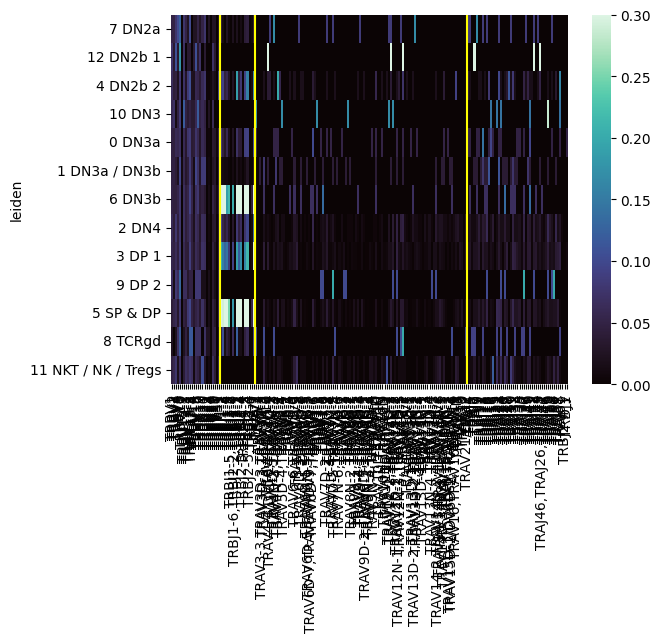

In [69]:
#options.figure_size = (40, 40)
ax = sns.heatmap(result, cmap="mako", xticklabels=True, vmin =0, vmax = 0.3)
ax.axvline(x = 24, ymin = 0, ymax = 1.0, color = "yellow")
ax.axvline(x = 24+17, ymin = 0, ymax = 1.0, color = "yellow")
ax.axvline(x = 24+17+104, ymin = 0, ymax = 1.0, color = "yellow")
plt.savefig("Heatmap_VJgeneusage_Control_Final_111223_v3.pdf")
#plt.savefig(".pdf")

## Do for KO

In [117]:
adata_PF = adata_P[adata_P.obs["v_call_abT_VDJ_main"] != "None"]
adata_PF = adata_PF[adata_PF.obs["v_call_abT_VDJ_main"] != "No_contig"]

In [118]:
adata_PF

View of AnnData object with n_obs × n_vars = 7896 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [119]:
adata_PF_KO = adata_PF[adata_PF.obs["Sample"] == "Krt76-/-"]
adata_PF_KO

View of AnnData object with n_obs × n_vars = 2755 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [120]:
working_df1KO = pd.DataFrame(adata_PF_KO.obs.groupby("leiden")["v_call_abT_VDJ_main"].value_counts())
working_df1KO

v_call_abT_VDJ_main
leiden    v_call_abT_VDJ_main                     
0 DN3a    TRBV5                                 20
          TRBV19                                19
          TRBV13-2                              19
          TRBV13-1                              16
          TRBV3                                 15
...                                            ...
12 DN2b 1 TRBV13-1                               0
          TRBV12-2                               0
          TRBV12-1                               0
          TRBV4                                  0
          TRBV31                                 0

[273 rows x 1 columns]

In [121]:
working_df1KO.columns =["counts"]
working_df1KO

counts
leiden    v_call_abT_VDJ_main        
0 DN3a    TRBV5                    20
          TRBV19                   19
          TRBV13-2                 19
          TRBV13-1                 16
          TRBV3                    15
...                               ...
12 DN2b 1 TRBV13-1                  0
          TRBV12-2                  0
          TRBV12-1                  0
          TRBV4                     0
          TRBV31                    0

[273 rows x 1 columns]

In [122]:
working_df1KO.reset_index(inplace = True)
working_df1KO

,leiden,v_call_abT_VDJ_main,counts
0,0 DN3a,TRBV5,20
1,0 DN3a,TRBV19,19
2,0 DN3a,TRBV13-2,19
3,0 DN3a,TRBV13-1,16
4,0 DN3a,TRBV3,15
...,...,...,...
268,12 DN2b 1,TRBV13-1,0
269,12 DN2b 1,TRBV12-2,0
270,12 DN2b 1,TRBV12-1,0
271,12 DN2b 1,TRBV4,0


In [123]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df1KO.leiden.unique():
    tmp = working_df1KO[working_df1KO["leiden"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'0 DN3a': 210,
 '1 DN3a / DN3b': 84,
 '2 DN4': 728,
 '3 DP 1': 950,
 '4 DN2b 2': 144,
 '5 SP & DP': 283,
 '6 DN3b': 215,
 '7 DN2a': 12,
 '8 TCRgd': 17,
 '9 DP 2': 32,
 '10 DN3': 35,
 '11 NKT / NK / Tregs': 35,
 '12 DN2b 1': 10}

In [124]:
working_df1KO["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df1KO.iterrows():
    try:
        working_df1KO.at[i, "proportion"] = row["counts"] / total_count_dict[row["leiden"]]
    except:
        pass

In [125]:
working_df1KO

,leiden,v_call_abT_VDJ_main,counts,proportion
0,0 DN3a,TRBV5,20,0.095238
1,0 DN3a,TRBV19,19,0.090476
2,0 DN3a,TRBV13-2,19,0.090476
3,0 DN3a,TRBV13-1,16,0.076190
4,0 DN3a,TRBV3,15,0.071429
...,...,...,...,...
268,12 DN2b 1,TRBV13-1,0,0.000000
269,12 DN2b 1,TRBV12-2,0,0.000000
270,12 DN2b 1,TRBV12-1,0,0.000000
271,12 DN2b 1,TRBV4,0,0.000000


In [126]:
KOdf1 = working_df1KO.pivot(index='leiden', columns='v_call_abT_VDJ_main', values='proportion')
print(KOdf1)

v_call_abT_VDJ_main     TRBV1     TRBV2     TRBV3     TRBV4     TRBV5  \
leiden                                                                  
0 DN3a               0.052381  0.047619  0.071429  0.023810  0.095238   
1 DN3a / DN3b        0.083333  0.023810  0.095238  0.035714  0.095238   
2 DN4                0.046703  0.038462  0.054945  0.050824  0.065934   
3 DP 1               0.065263  0.048421  0.064211  0.041053  0.076842   
4 DN2b 2             0.111111  0.034722  0.062500  0.006944  0.062500   
5 SP & DP            0.035336  0.095406  0.056537  0.024735  0.081272   
6 DN3b               0.041860  0.065116  0.065116  0.046512  0.069767   
7 DN2a               0.083333  0.000000  0.166667  0.000000  0.083333   
8 TCRgd              0.058824  0.000000  0.000000  0.000000  0.058824   
9 DP 2               0.031250  0.000000  0.093750  0.031250  0.125000   
10 DN3               0.028571  0.000000  0.000000  0.028571  0.085714   
11 NKT / NK / Tregs  0.028571  0.085714  0.028571  

In [127]:
adata_PF = adata_P[adata_P.obs["j_call_abT_VDJ_main"] != "None"]
adata_PF = adata_PF[adata_PF.obs["j_call_abT_VDJ_main"] != "No_contig"]

In [128]:
adata_PF

View of AnnData object with n_obs × n_vars = 8094 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [129]:
adata_PF_KO = adata_PF[adata_PF.obs["Sample"] == "Krt76-/-"]
adata_PF_KO

View of AnnData object with n_obs × n_vars = 2807 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [130]:
working_df2KO = pd.DataFrame(adata_PF_KO.obs.groupby("leiden")["j_call_abT_VDJ_main"].value_counts())
working_df2KO

j_call_abT_VDJ_main
leiden    j_call_abT_VDJ_main                         
0 DN3a    TRBJ2-5                                   32
          TRBJ2-7                                   30
          TRBJ2-4                                   29
          TRBJ1-2                                   19
          TRBJ2-1                                   19
...                                                ...
12 DN2b 1 TRBJ1-4                                    0
          TRBJ1-6,TRBJ2-2,TRBJ2-7                    0
          TRBJ2-2                                    0
          TRBJ2-5                                    0
          TRBJ2-6                                    0

[182 rows x 1 columns]

In [131]:
working_df2KO.columns =["counts"]
working_df2KO

counts
leiden    j_call_abT_VDJ_main            
0 DN3a    TRBJ2-5                      32
          TRBJ2-7                      30
          TRBJ2-4                      29
          TRBJ1-2                      19
          TRBJ2-1                      19
...                                   ...
12 DN2b 1 TRBJ1-4                       0
          TRBJ1-6,TRBJ2-2,TRBJ2-7       0
          TRBJ2-2                       0
          TRBJ2-5                       0
          TRBJ2-6                       0

[182 rows x 1 columns]

In [132]:
working_df2KO.reset_index(inplace = True)
working_df2KO

,leiden,j_call_abT_VDJ_main,counts
0,0 DN3a,TRBJ2-5,32
1,0 DN3a,TRBJ2-7,30
2,0 DN3a,TRBJ2-4,29
3,0 DN3a,TRBJ1-2,19
4,0 DN3a,TRBJ2-1,19
...,...,...,...
177,12 DN2b 1,TRBJ1-4,0
178,12 DN2b 1,"TRBJ1-6,TRBJ2-2,TRBJ2-7",0
179,12 DN2b 1,TRBJ2-2,0
180,12 DN2b 1,TRBJ2-5,0


In [133]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df2KO.leiden.unique():
    tmp = working_df2KO[working_df2KO["leiden"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'0 DN3a': 215,
 '1 DN3a / DN3b': 85,
 '2 DN4': 743,
 '3 DP 1': 964,
 '4 DN2b 2': 149,
 '5 SP & DP': 288,
 '6 DN3b': 219,
 '7 DN2a': 12,
 '8 TCRgd': 19,
 '9 DP 2': 32,
 '10 DN3': 36,
 '11 NKT / NK / Tregs': 35,
 '12 DN2b 1': 10}

In [134]:
working_df2KO["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df2KO.iterrows():
    try:
        working_df2KO.at[i, "proportion"] = row["counts"] / total_count_dict[row["leiden"]]
    except:
        pass

In [135]:
working_df2KO

,leiden,j_call_abT_VDJ_main,counts,proportion
0,0 DN3a,TRBJ2-5,32,0.148837
1,0 DN3a,TRBJ2-7,30,0.139535
2,0 DN3a,TRBJ2-4,29,0.134884
3,0 DN3a,TRBJ1-2,19,0.088372
4,0 DN3a,TRBJ2-1,19,0.088372
...,...,...,...,...
177,12 DN2b 1,TRBJ1-4,0,0.000000
178,12 DN2b 1,"TRBJ1-6,TRBJ2-2,TRBJ2-7",0,0.000000
179,12 DN2b 1,TRBJ2-2,0,0.000000
180,12 DN2b 1,TRBJ2-5,0,0.000000


In [136]:
KOdf2 = working_df2KO.pivot(index='leiden', columns='j_call_abT_VDJ_main', values='proportion')
print(KOdf1)

v_call_abT_VDJ_main     TRBV1     TRBV2     TRBV3     TRBV4     TRBV5  \
leiden                                                                  
0 DN3a               0.052381  0.047619  0.071429  0.023810  0.095238   
1 DN3a / DN3b        0.083333  0.023810  0.095238  0.035714  0.095238   
2 DN4                0.046703  0.038462  0.054945  0.050824  0.065934   
3 DP 1               0.065263  0.048421  0.064211  0.041053  0.076842   
4 DN2b 2             0.111111  0.034722  0.062500  0.006944  0.062500   
5 SP & DP            0.035336  0.095406  0.056537  0.024735  0.081272   
6 DN3b               0.041860  0.065116  0.065116  0.046512  0.069767   
7 DN2a               0.083333  0.000000  0.166667  0.000000  0.083333   
8 TCRgd              0.058824  0.000000  0.000000  0.000000  0.058824   
9 DP 2               0.031250  0.000000  0.093750  0.031250  0.125000   
10 DN3               0.028571  0.000000  0.000000  0.028571  0.085714   
11 NKT / NK / Tregs  0.028571  0.085714  0.028571  

In [137]:
adata_PF = adata_P[adata_P.obs["v_call_abT_VJ_main"] != "None"]
adata_PF = adata_PF[adata_PF.obs["v_call_abT_VJ_main"] != "No_contig"]

In [138]:
adata_PF

View of AnnData object with n_obs × n_vars = 2530 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [139]:
adata_PF_KO = adata_PF[adata_PF.obs["Sample"] == "Krt76-/-"]
adata_PF_KO

View of AnnData object with n_obs × n_vars = 1086 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [140]:
working_df3KO = pd.DataFrame(adata_PF_KO.obs.groupby("leiden")["v_call_abT_VJ_main"].value_counts())
working_df3KO

v_call_abT_VJ_main
leiden    v_call_abT_VJ_main                    
0 DN3a    TRAV13-2                             2
          TRAV13-1                             2
          TRAV9N-4                             1
          TRAV6N-6                             1
          TRAV9N-2,TRAV9D-2                    1
...                                          ...
12 DN2b 1 TRAV7-3                              0
          TRAV7-1                              0
          TRAV6N-6                             0
          TRAV6D-7,TRAV6N-7                    0
          TRAV21/DV12                          0

[1274 rows x 1 columns]

In [141]:
working_df3KO.columns =["counts"]
working_df3KO

counts
leiden    v_call_abT_VJ_main        
0 DN3a    TRAV13-2                 2
          TRAV13-1                 2
          TRAV9N-4                 1
          TRAV6N-6                 1
          TRAV9N-2,TRAV9D-2        1
...                              ...
12 DN2b 1 TRAV7-3                  0
          TRAV7-1                  0
          TRAV6N-6                 0
          TRAV6D-7,TRAV6N-7        0
          TRAV21/DV12              0

[1274 rows x 1 columns]

In [142]:
working_df3KO.reset_index(inplace = True)
working_df3KO

,leiden,v_call_abT_VJ_main,counts
0,0 DN3a,TRAV13-2,2
1,0 DN3a,TRAV13-1,2
2,0 DN3a,TRAV9N-4,1
3,0 DN3a,TRAV6N-6,1
4,0 DN3a,"TRAV9N-2,TRAV9D-2",1
...,...,...,...
1269,12 DN2b 1,TRAV7-3,0
1270,12 DN2b 1,TRAV7-1,0
1271,12 DN2b 1,TRAV6N-6,0
1272,12 DN2b 1,"TRAV6D-7,TRAV6N-7",0


In [143]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df3KO.leiden.unique():
    tmp = working_df3KO[working_df3KO["leiden"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'0 DN3a': 15,
 '1 DN3a / DN3b': 17,
 '2 DN4': 205,
 '3 DP 1': 469,
 '4 DN2b 2': 40,
 '5 SP & DP': 276,
 '6 DN3b': 12,
 '7 DN2a': 5,
 '8 TCRgd': 3,
 '9 DP 2': 7,
 '10 DN3': 2,
 '11 NKT / NK / Tregs': 30,
 '12 DN2b 1': 5}

In [144]:
working_df3KO["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df3KO.iterrows():
    try:
        working_df3KO.at[i, "proportion"] = row["counts"] / total_count_dict[row["leiden"]]
    except:
        pass

In [145]:
working_df3KO

,leiden,v_call_abT_VJ_main,counts,proportion
0,0 DN3a,TRAV13-2,2,0.133333
1,0 DN3a,TRAV13-1,2,0.133333
2,0 DN3a,TRAV9N-4,1,0.066667
3,0 DN3a,TRAV6N-6,1,0.066667
4,0 DN3a,"TRAV9N-2,TRAV9D-2",1,0.066667
...,...,...,...,...
1269,12 DN2b 1,TRAV7-3,0,0.000000
1270,12 DN2b 1,TRAV7-1,0,0.000000
1271,12 DN2b 1,TRAV6N-6,0,0.000000
1272,12 DN2b 1,"TRAV6D-7,TRAV6N-7",0,0.000000


In [146]:
KOdf3 = working_df3KO.pivot(index='leiden', columns='v_call_abT_VJ_main', values='proportion')
print(KOdf3)

v_call_abT_VJ_main      TRAV1     TRAV2   TRAV3-1  TRAV3D-3,TRAV3N-3  \
leiden                                                                 
0 DN3a               0.000000  0.000000  0.000000           0.000000   
1 DN3a / DN3b        0.000000  0.000000  0.000000           0.000000   
2 DN4                0.009756  0.000000  0.000000           0.034146   
3 DP 1               0.008529  0.004264  0.002132           0.049041   
4 DN2b 2             0.000000  0.025000  0.000000           0.025000   
5 SP & DP            0.007246  0.007246  0.000000           0.025362   
6 DN3b               0.083333  0.000000  0.000000           0.083333   
7 DN2a               0.000000  0.000000  0.000000           0.000000   
8 TCRgd              0.000000  0.000000  0.000000           0.333333   
9 DP 2               0.000000  0.000000  0.000000           0.000000   
10 DN3               0.000000  0.000000  0.000000           0.000000   
11 NKT / NK / Tregs  0.000000  0.000000  0.000000           0.00

In [147]:
adata_PF = adata_P[adata_P.obs["j_call_abT_VJ_main"] != "None"]
adata_PF = adata_PF[adata_PF.obs["j_call_abT_VJ_main"] != "No_contig"]

In [148]:
adata_PF

View of AnnData object with n_obs × n_vars = 2595 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [149]:
adata_PF_KO = adata_PF[adata_PF.obs["Sample"] == "Krt76-/-"]
adata_PF_KO

View of AnnData object with n_obs × n_vars = 1105 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main'

In [150]:
working_df4KO = pd.DataFrame(adata_PF_KO.obs.groupby("leiden")["j_call_abT_VJ_main"].value_counts())
working_df4KO

j_call_abT_VJ_main
leiden    j_call_abT_VJ_main                    
0 DN3a    TRAJ13                               3
          TRAJ15                               3
          TRAJ32                               1
          TRAJ37                               1
          TRAJ40                               1
...                                          ...
12 DN2b 1 TRAJ26                               0
          TRAJ27                               0
          TRAJ28                               0
          TRAJ30                               0
          TRDJ1                                0

[624 rows x 1 columns]

In [151]:
working_df4KO.columns =["counts"]
working_df4KO

counts
leiden    j_call_abT_VJ_main        
0 DN3a    TRAJ13                   3
          TRAJ15                   3
          TRAJ32                   1
          TRAJ37                   1
          TRAJ40                   1
...                              ...
12 DN2b 1 TRAJ26                   0
          TRAJ27                   0
          TRAJ28                   0
          TRAJ30                   0
          TRDJ1                    0

[624 rows x 1 columns]

In [152]:
working_df4KO.reset_index(inplace = True)
working_df4KO

,leiden,j_call_abT_VJ_main,counts
0,0 DN3a,TRAJ13,3
1,0 DN3a,TRAJ15,3
2,0 DN3a,TRAJ32,1
3,0 DN3a,TRAJ37,1
4,0 DN3a,TRAJ40,1
...,...,...,...
619,12 DN2b 1,TRAJ26,0
620,12 DN2b 1,TRAJ27,0
621,12 DN2b 1,TRAJ28,0
622,12 DN2b 1,TRAJ30,0


In [154]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df4KO.leiden.unique():
    tmp = working_df4KO[working_df4KO["leiden"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'0 DN3a': 15,
 '1 DN3a / DN3b': 17,
 '2 DN4': 214,
 '3 DP 1': 474,
 '4 DN2b 2': 41,
 '5 SP & DP': 277,
 '6 DN3b': 13,
 '7 DN2a': 5,
 '8 TCRgd': 3,
 '9 DP 2': 7,
 '10 DN3': 4,
 '11 NKT / NK / Tregs': 30,
 '12 DN2b 1': 5}

In [155]:
working_df4KO["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df4KO.iterrows():
    try:
        working_df4KO.at[i, "proportion"] = row["counts"] / total_count_dict[row["leiden"]]
    except:
        pass

In [156]:
working_df4KO

,leiden,j_call_abT_VJ_main,counts,proportion
0,0 DN3a,TRAJ13,3,0.200000
1,0 DN3a,TRAJ15,3,0.200000
2,0 DN3a,TRAJ32,1,0.066667
3,0 DN3a,TRAJ37,1,0.066667
4,0 DN3a,TRAJ40,1,0.066667
...,...,...,...,...
619,12 DN2b 1,TRAJ26,0,0.000000
620,12 DN2b 1,TRAJ27,0,0.000000
621,12 DN2b 1,TRAJ28,0,0.000000
622,12 DN2b 1,TRAJ30,0,0.000000


In [157]:
KOdf4 = working_df4KO.pivot(index='leiden', columns='j_call_abT_VJ_main', values='proportion')
print(KOdf1)

v_call_abT_VDJ_main     TRBV1     TRBV2     TRBV3     TRBV4     TRBV5  \
leiden                                                                  
0 DN3a               0.052381  0.047619  0.071429  0.023810  0.095238   
1 DN3a / DN3b        0.083333  0.023810  0.095238  0.035714  0.095238   
2 DN4                0.046703  0.038462  0.054945  0.050824  0.065934   
3 DP 1               0.065263  0.048421  0.064211  0.041053  0.076842   
4 DN2b 2             0.111111  0.034722  0.062500  0.006944  0.062500   
5 SP & DP            0.035336  0.095406  0.056537  0.024735  0.081272   
6 DN3b               0.041860  0.065116  0.065116  0.046512  0.069767   
7 DN2a               0.083333  0.000000  0.166667  0.000000  0.083333   
8 TCRgd              0.058824  0.000000  0.000000  0.000000  0.058824   
9 DP 2               0.031250  0.000000  0.093750  0.031250  0.125000   
10 DN3               0.028571  0.000000  0.000000  0.028571  0.085714   
11 NKT / NK / Tregs  0.028571  0.085714  0.028571  

### Now do the merging and create heatmap

In [158]:
resultKO = pd.merge(KOdf1, KOdf2, on='leiden').merge(KOdf3, on='leiden').merge(KOdf4, on='leiden')

In [159]:
print(resultKO)

                        TRBV1     TRBV2     TRBV3     TRBV4     TRBV5  \
leiden                                                                  
0 DN3a               0.052381  0.047619  0.071429  0.023810  0.095238   
1 DN3a / DN3b        0.083333  0.023810  0.095238  0.035714  0.095238   
2 DN4                0.046703  0.038462  0.054945  0.050824  0.065934   
3 DP 1               0.065263  0.048421  0.064211  0.041053  0.076842   
4 DN2b 2             0.111111  0.034722  0.062500  0.006944  0.062500   
5 SP & DP            0.035336  0.095406  0.056537  0.024735  0.081272   
6 DN3b               0.041860  0.065116  0.065116  0.046512  0.069767   
7 DN2a               0.083333  0.000000  0.166667  0.000000  0.083333   
8 TCRgd              0.058824  0.000000  0.000000  0.000000  0.058824   
9 DP 2               0.031250  0.000000  0.093750  0.031250  0.125000   
10 DN3               0.028571  0.000000  0.000000  0.028571  0.085714   
11 NKT / NK / Tregs  0.028571  0.085714  0.028571  

In [160]:
resultKO.info()

<class 'pandas.core.frame.DataFrame'>
CategoricalIndex: 13 entries, 0 DN3a to 12 DN2b 1
Columns: 181 entries, TRBV1 to TRDJ1
dtypes: float64(181)
memory usage: 19.0 KB


In [161]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


<Axes: ylabel='leiden'>

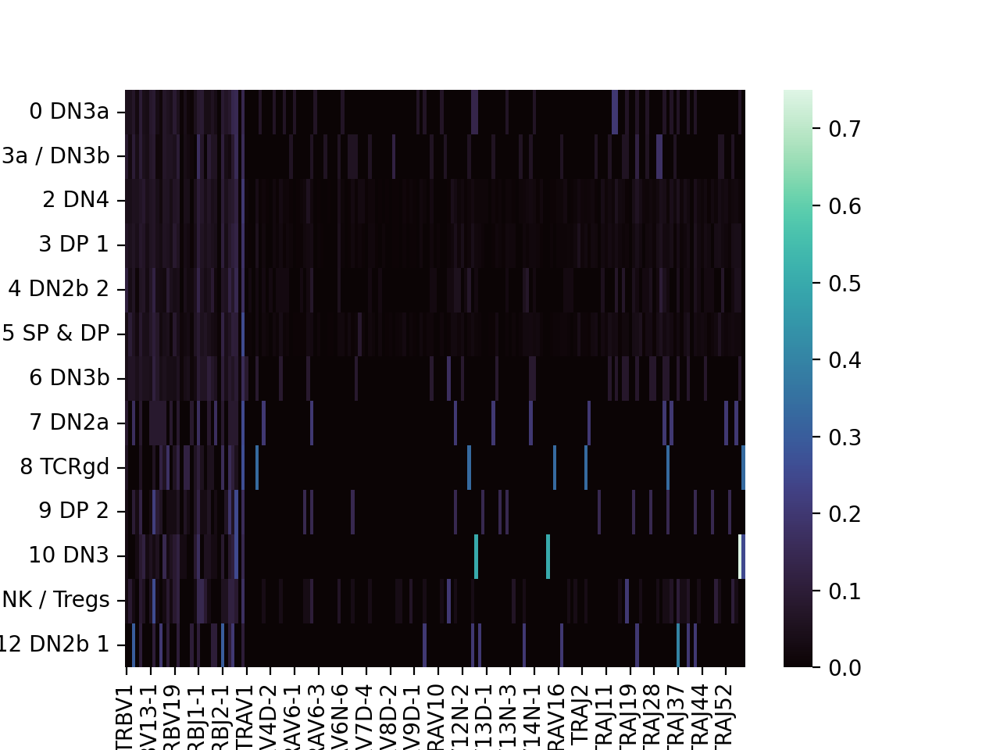

In [162]:
options.figure_size = (20, 30)
sns.heatmap(resultKO, cmap="mako", yticklabels=True)

#plt.savefig("tests.pdf")


In [163]:
resultKO = resultKO.reindex([
        "7 DN2a",
        "12 DN2b 1",
        "4 DN2b 2",
        "10 DN3",
        "0 DN3a",
        "1 DN3a / DN3b",
        "6 DN3b",
        "2 DN4",
        "3 DP 1",
        "9 DP 2",
        "5 SP & DP",
        "8 TCRgd",
        "11 NKT / NK / Tregs",
    ])

In [164]:
import seaborn as sns
%matplotlib inline

<Axes: ylabel='leiden'>

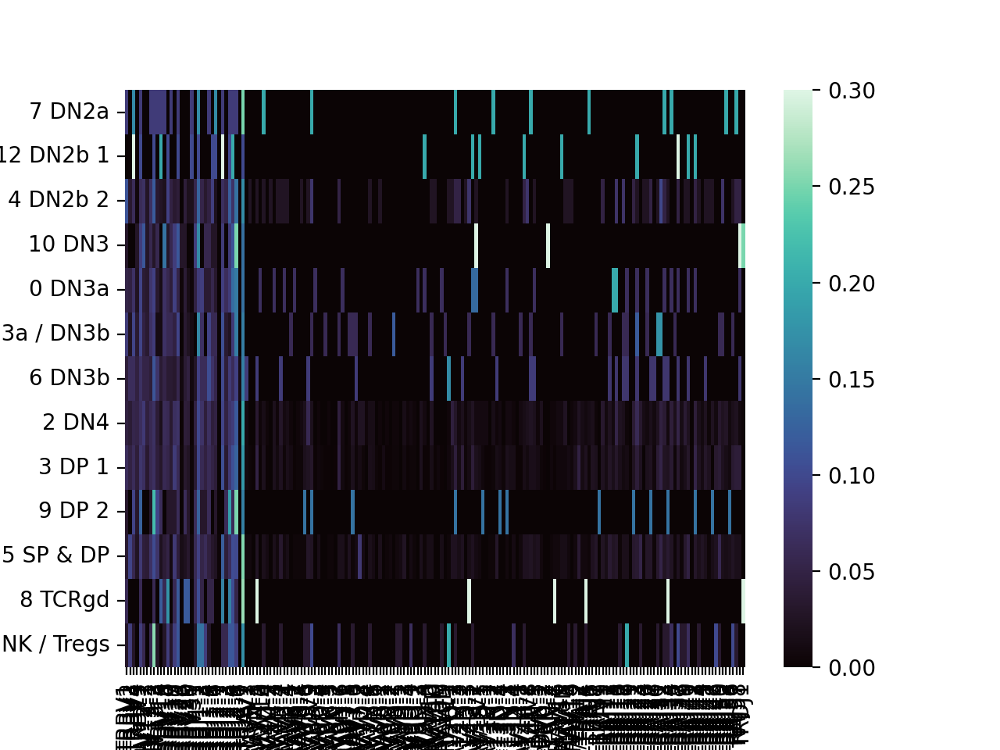

In [186]:
#options.figure_size = (40, 40)
g = sns.heatmap(resultKO, cmap="mako", xticklabels=True, vmin=0, vmax=0.3)
#g.set_xticklabels(g.get_xticklabels(), rotation = 0, fontsize = 7)
g
#plt.savefig("test3.pdf")

# Re-plotting differences in V/J gene usage between control and KO

## V gene Beta Chain

In [17]:
adata_PF = adata_P[adata_P.obs["v_call_abT_VDJ_main"] != "None"]
adata_PF = adata_PF[adata_PF.obs["v_call_abT_VDJ_main"] != "No_contig"]

### DN2a - V gene beta chain

In [18]:
adata_PF_DN2a = adata_PF[adata_PF.obs["leiden"] == "7 DN2a"]

In [19]:
adata_PF_DN2a

View of AnnData object with n_obs × n_vars = 52 × 2631
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_hemo', 'pct_counts_hemo', 'total_counts_ribo', 'pct_counts_ribo', 'doublet_score', 'predicted_doublet', 'Sample', 'S_score', 'G2M_score', 'phase', 'leiden', 'batch', 'locus_VDJ', 'locus_VJ', 'productive_VDJ', 'productive_VJ', 'v_call_VDJ', 'd_call_VDJ', 'j_call_VDJ', 'v_call_VJ', 'j_call_VJ', 'c_call_VDJ', 'c_call_VJ', 'junction_VDJ', 'junction_VJ', 'junction_aa_VDJ', 'junction_aa_VJ', 'v_call_abT_VDJ', 'd_call_abT_VDJ', 'j_call_abT_VDJ', 'v_call_abT_VJ', 'j_call_abT_VJ', 'c_call_abT_VDJ', 'c_call_abT_VJ', 'productive_abT_VDJ', 'productive_abT_VJ', 'v_call_gdT_VDJ', 'd_call_gdT_VDJ', 'j_call_gdT_VDJ', 'c_call_gdT_VDJ', 'productive_gdT_VDJ', 'duplicate_count_abT_VDJ', 'duplicate_count_abT_VJ', 'duplicate_count_gdT_VDJ', 'v_call_VDJ_main', 'v_call_VJ_main', 'd_call_VDJ_main', 'j_call_VDJ_main', 'j_call_VJ_main', 

In [22]:
working_df = pd.DataFrame(adata_PF_DN2a.obs.groupby("Sample")["v_call_abT_VJ_main"].value_counts())
working_df

v_call_abT_VJ_main
Sample   v_call_abT_VJ_main                              
Control  None                                          29
         TRAV4D-3,TRAV4-3                               2
         TRAV4-4/DV10,TRAV4D-4                          1
         TRAV6D-3                                       1
         TRAV7D-2,TRAV7-2                               1
         TRAV7D-4,TRAV7-4                               1
         TRAV9-4,TRAV9D-3                               1
         TRAV12-1,TRAV12D-1                             1
         TRAV12-2,TRAV12D-2                             1
         TRAV12N-3,TRAV12D-3                            1
         TRAV13D-2,TRAV13-2,TRAV13N-2                   1
         TRAV4-4/DV10                                   0
         TRAV6-7/DV9                                    0
         TRAV14-3,TRAV14D-3/DV8                         0
Krt76-/- None                                           7
         TRAV4-4/DV10                                   1
         TRAV6-7/DV9                                    1
         TRAV12-2,TRAV12D-2                             1
         TRAV13D-2,TRAV13-2,TRAV13N-2                   1
         TRAV14-3,TRAV14D-3/DV8                         1
         TRAV4-4/DV10,TRAV4D-4                          0
         TRAV4D-3,TRAV4-3                               0
         TRAV6D-3                                       0
         TRAV7D-2,TRAV7-2                               0
         TRAV7D-4,TRAV7-4                               0
         TRAV9-4,TRAV9D-3                               0
         TRAV12-1,TRAV12D-1                             0
         TRAV12N-3,TRAV12D-3                            0

In [23]:
working_df.columns =["counts"]
#need to make it into each row, so just reset index.. inplace = Trus is a shortcut to assign the change to the current object.
working_df.reset_index(inplace = True)
working_df

,Sample,v_call_abT_VJ_main,counts
0,Control,None,29
1,Control,"TRAV4D-3,TRAV4-3",2
2,Control,"TRAV4-4/DV10,TRAV4D-4",1
3,Control,TRAV6D-3,1
4,Control,"TRAV7D-2,TRAV7-2",1
5,Control,"TRAV7D-4,TRAV7-4",1
6,Control,"TRAV9-4,TRAV9D-3",1
7,Control,"TRAV12-1,TRAV12D-1",1
8,Control,"TRAV12-2,TRAV12D-2",1
9,Control,"TRAV12N-3,TRAV12D-3",1


In [25]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 40, 'Krt76-/-': 12}

In [26]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [27]:
working_df

,Sample,v_call_abT_VJ_main,counts,proportion
0,Control,None,29,0.725000
1,Control,"TRAV4D-3,TRAV4-3",2,0.050000
2,Control,"TRAV4-4/DV10,TRAV4D-4",1,0.025000
3,Control,TRAV6D-3,1,0.025000
4,Control,"TRAV7D-2,TRAV7-2",1,0.025000
5,Control,"TRAV7D-4,TRAV7-4",1,0.025000
6,Control,"TRAV9-4,TRAV9D-3",1,0.025000
7,Control,"TRAV12-1,TRAV12D-1",1,0.025000
8,Control,"TRAV12-2,TRAV12D-2",1,0.025000
9,Control,"TRAV12N-3,TRAV12D-3",1,0.025000


In [28]:
## Now get the number of cells per celltype

total_count_dict = {}
for x in working_df.Sample.unique():
    tmp = working_df[working_df["Sample"] == x]
    total_count_dict[x] = tmp["counts"].sum()
total_count_dict

{'Control': 40, 'Krt76-/-': 12}

In [29]:
working_df["proportion"] = 0
# normalise VDJ counts ie how many cells use each gene per total count per group.
for i, row in working_df.iterrows():
    try:
        working_df.at[i, "proportion"] = row["counts"] / total_count_dict[row["Sample"]]
    except:
        pass

In [30]:
working_df

,Sample,v_call_abT_VJ_main,counts,proportion
0,Control,None,29,0.725000
1,Control,"TRAV4D-3,TRAV4-3",2,0.050000
2,Control,"TRAV4-4/DV10,TRAV4D-4",1,0.025000
3,Control,TRAV6D-3,1,0.025000
4,Control,"TRAV7D-2,TRAV7-2",1,0.025000
5,Control,"TRAV7D-4,TRAV7-4",1,0.025000
6,Control,"TRAV9-4,TRAV9D-3",1,0.025000
7,Control,"TRAV12-1,TRAV12D-1",1,0.025000
8,Control,"TRAV12-2,TRAV12D-2",1,0.025000
9,Control,"TRAV12N-3,TRAV12D-3",1,0.025000


In [31]:
working_control = working_df[working_df["Sample"] == "Control"]

In [32]:
working_KO = working_df[working_df["Sample"] == "Krt76-/-"]

In [33]:
working_control.set_index("v_call_abT_VJ_main", inplace=True)

In [34]:
working_KO.set_index("v_call_abT_VJ_main", inplace=True)

In [35]:
dict1 = dict(working_KO.proportion/ working_control.proportion)
dict1

{'None': 0.8045977011494254,
 'TRAV4-4/DV10': inf,
 'TRAV4-4/DV10,TRAV4D-4': 0.0,
 'TRAV4D-3,TRAV4-3': 0.0,
 'TRAV6-7/DV9': inf,
 'TRAV6D-3': 0.0,
 'TRAV7D-2,TRAV7-2': 0.0,
 'TRAV7D-4,TRAV7-4': 0.0,
 'TRAV9-4,TRAV9D-3': 0.0,
 'TRAV12-1,TRAV12D-1': 0.0,
 'TRAV12-2,TRAV12D-2': 3.333333333333333,
 'TRAV12N-3,TRAV12D-3': 0.0,
 'TRAV13D-2,TRAV13-2,TRAV13N-2': 3.333333333333333,
 'TRAV14-3,TRAV14D-3/DV8': inf}

In [36]:
working_df["foldchange"] = [dict1[x] for x in working_df["v_call_abT_VJ_main"]]
working_df

,Sample,v_call_abT_VJ_main,counts,proportion,foldchange
0,Control,None,29,0.725000,0.804598
1,Control,"TRAV4D-3,TRAV4-3",2,0.050000,0.000000
2,Control,"TRAV4-4/DV10,TRAV4D-4",1,0.025000,0.000000
3,Control,TRAV6D-3,1,0.025000,0.000000
4,Control,"TRAV7D-2,TRAV7-2",1,0.025000,0.000000
5,Control,"TRAV7D-4,TRAV7-4",1,0.025000,0.000000
6,Control,"TRAV9-4,TRAV9D-3",1,0.025000,0.000000
7,Control,"TRAV12-1,TRAV12D-1",1,0.025000,0.000000
8,Control,"TRAV12-2,TRAV12D-2",1,0.025000,3.333333
9,Control,"TRAV12N-3,TRAV12D-3",1,0.025000,0.000000


In [47]:
working_df = working_df.copy()
working_df["transparency"] = 0.8
for i, j in working_df.iterrows():
    if abs(working_df.at[i, "foldchange"]) >= 1.2:
        working_df.at[i, "transparency"] = 1

# working_df[abs(working_df["foldchange"]) > 1.25 ]["transparency"] = 1


In [38]:
from plotnine import ggplot, aes, facet_grid, geom_bar, theme_bw, facet_wrap, theme_classic, options, theme, element_text, scale_fill_manual


In [39]:
from scanpy.plotting.palettes import default_20, default_28, default_102
# https://github.com/scverse/scanpy/blob/master/scanpy/plotting/palettes.py
col_palette = default_20 +  default_102
col_palette

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31',
 '#FFFF00',
 '#1CE6FF',
 '#FF34FF',
 '#FF4A46',
 '#008941',
 '#006FA6',
 '#A30059',
 '#FFDBE5',
 '#7A4900',
 '#0000A6',
 '#63FFAC',
 '#B79762',
 '#004D43',
 '#8FB0FF',
 '#997D87',
 '#5A0007',
 '#809693',
 '#6A3A4C',
 '#1B4400',
 '#4FC601',
 '#3B5DFF',
 '#4A3B53',
 '#FF2F80',
 '#61615A',
 '#BA0900',
 '#6B7900',
 '#00C2A0',
 '#FFAA92',
 '#FF90C9',
 '#B903AA',
 '#D16100',
 '#DDEFFF',
 '#000035',
 '#7B4F4B',
 '#A1C299',
 '#300018',
 '#0AA6D8',
 '#013349',
 '#00846F',
 '#372101',
 '#FFB500',
 '#C2FFED',
 '#A079BF',
 '#CC0744',
 '#C0B9B2',
 '#C2FF99',
 '#001E09',
 '#00489C',
 '#6F0062',
 '#0CBD66',
 '#EEC3FF',
 '#456D75',
 '#B77B68',
 '#7A87A1',
 '#788D66',
 '#885578',
 '#FAD09F',
 '#FF8A9A',
 '#D157A0',
 '#BEC459',
 '#456648',
 '#0086ED',
 '#886F4C',
 '#3

In [53]:
options.figure_size = (8,6)
p = (
    ggplot(
        working_df,
        aes(x="v_call_abT_VJ_main", y="proportion", fill="Sample", alpha = "transparency"),
    )
    + geom_bar(stat ="identity", position = "dodge")
    #+ facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90)))

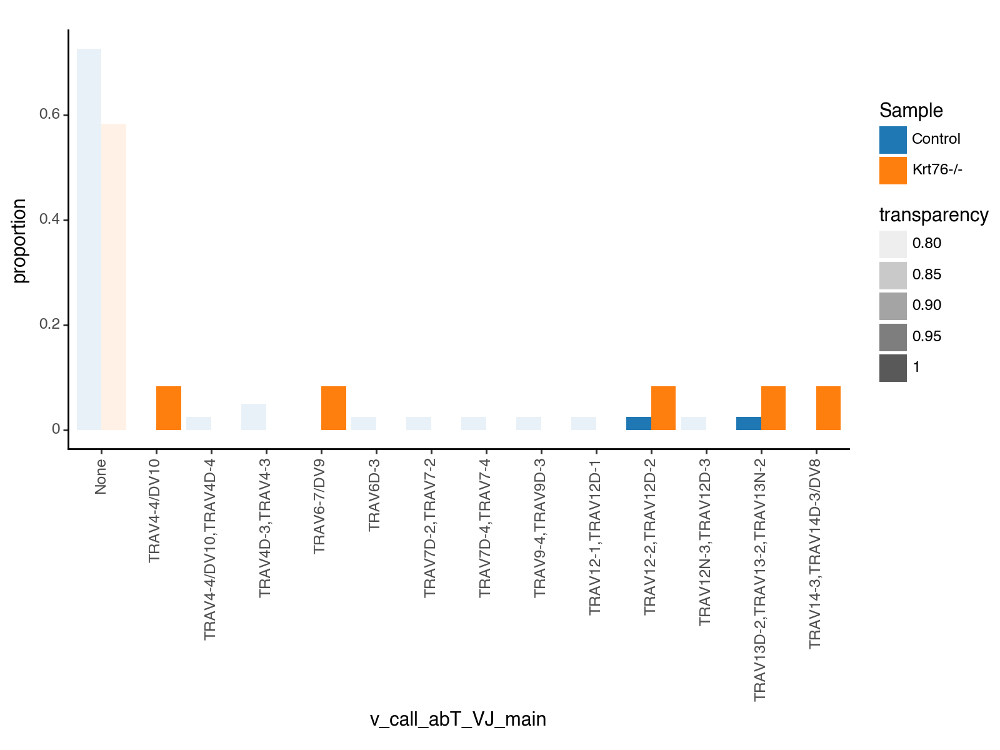

<Figure Size: (800 x 600)>

In [54]:
p

In [55]:
p.save("VgeneBetaChain_DN2a_111223.pdf", height = 6, width = 8, limitsize=False)

/Users/uqssoon/anaconda3/envs/Jaz2023_env/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 8 x 6 in image.
/Users/uqssoon/anaconda3/envs/Jaz2023_env/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: VgeneBetaChain_DN2a_111223.pdf


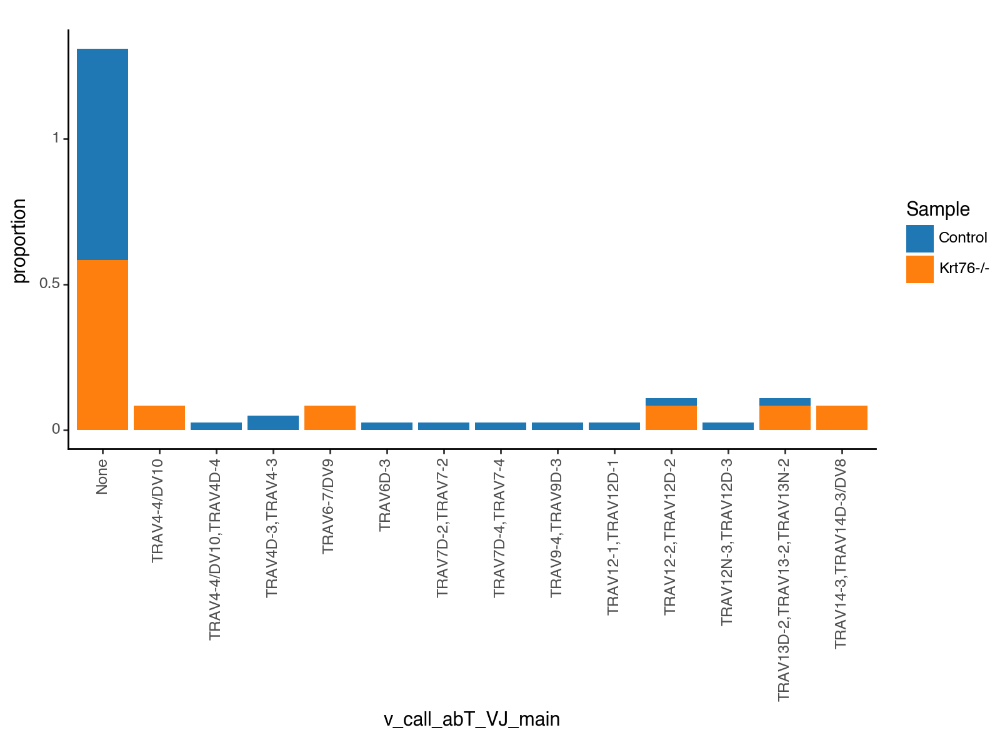

<Figure Size: (800 x 600)>

In [52]:
# another option - but don't use this. 
options.figure_size = (8,6)
(
    ggplot(
        working_df,
        aes(x="v_call_abT_VJ_main", y="proportion", fill="Sample"),
    )
    + geom_bar(stat ="identity", position = "stack")
    #+ facet_wrap("~Sample", ncol=2)
    + scale_fill_manual(values=col_palette)
    + theme_classic()
    + theme(axis_text_x=element_text(angle=90))
)